In [1]:
# -------------------------------
# Phase 1: Data Preprocessing and Visualization
# -------------------------------

In [2]:
import pandas as pd


dataset_path = '../Dataset/Almond.csv'  
data = pd.read_csv(dataset_path) 

print(data.head())  

print(data.describe()) 
print(data.info())  


/Users/frankoswanepoel/anaconda3/lib/python3.11/site-packages/pandas/core/arrays/masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (


   Unnamed: 0  Length (major axis)  Width (minor axis)  Thickness (depth)  \
0           0                  NaN          227.940628         127.759132   
1           1                  NaN          234.188126         128.199509   
2           2                  NaN          229.418610         125.796547   
3           3                  NaN          232.763153         125.918808   
4           4                  NaN          230.150742         107.253448   

      Area   Perimeter  Roundness  Solidity  Compactness  Aspect Ratio  \
0  22619.0  643.813269        NaN  0.973384     1.458265           NaN   
1  23038.0  680.984841        NaN  0.957304     1.601844           NaN   
2  22386.5  646.943212        NaN  0.967270     1.487772           NaN   
3  22578.5  661.227483        NaN  0.965512     1.540979           NaN   
4  19068.0  624.842706        NaN  0.951450     1.629395           NaN   

   Eccentricity    Extent  Convex hull(convex area)   Type  
0           NaN  0.681193      

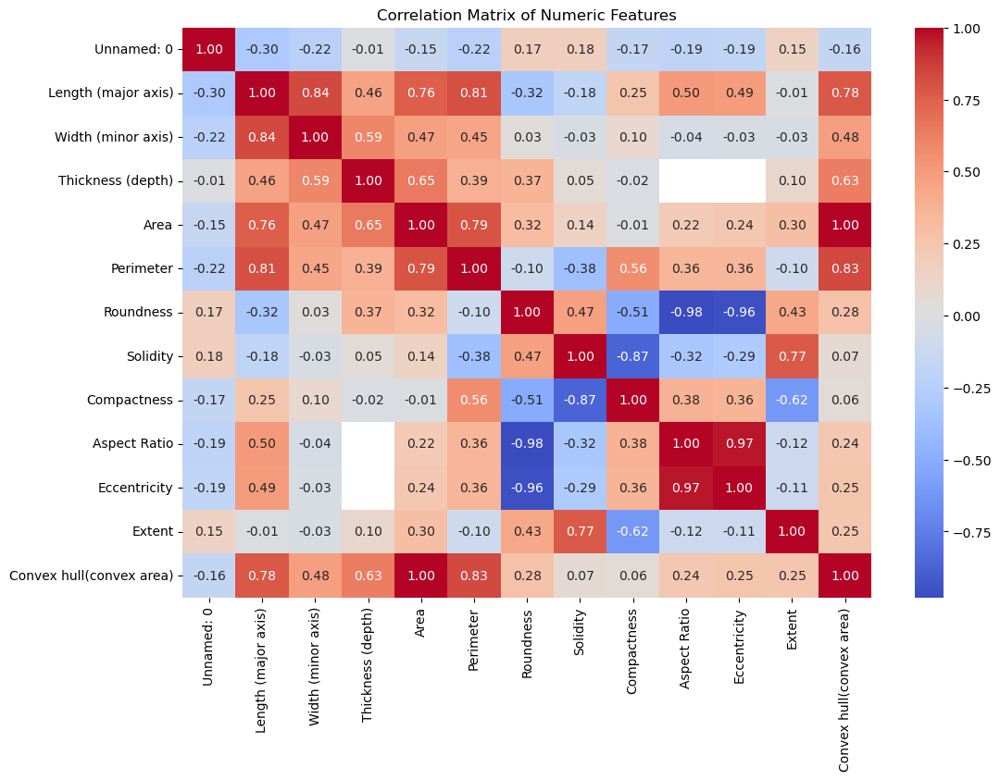

In [3]:

import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

numeric_data = data.select_dtypes(include=[np.number])

corr_matrix = numeric_data.corr()

plt.figure(figsize=(12, 8))
sns.heatmap(corr_matrix, annot=True, fmt=".2f", cmap='coolwarm', cbar=True)
plt.title('Correlation Matrix of Numeric Features')
plt.show()


In [4]:
import pandas as pd
from sklearn.impute import KNNImputer
import numpy as np


features = ['Length (major axis)', 'Width (minor axis)', 'Thickness (depth)']

for feature in features:
    data[feature] = pd.to_numeric(data[feature], errors='coerce')

print("Missing values before imputation:")
print(data[features].isnull().sum())

imputer = KNNImputer(n_neighbors=5)

data_imputed = data.copy()
data_imputed[features] = imputer.fit_transform(data[features])

print("\nMissing values after imputation:")
print(data_imputed[features].isnull().sum())

print("\nSummary statistics after imputation:")
print(data_imputed[features].describe())


Missing values before imputation:
Length (major axis)     857
Width (minor axis)      942
Thickness (depth)      1004
dtype: int64

Missing values after imputation:
Length (major axis)    0
Width (minor axis)     0
Thickness (depth)      0
dtype: int64

Summary statistics after imputation:
       Length (major axis)  Width (minor axis)  Thickness (depth)
count          2803.000000         2803.000000        2803.000000
mean            292.497698          170.727837         109.413514
std              56.550857           26.825223          16.693958
min             151.335266           88.050529          59.494278
25%             255.065697          152.291969          99.212789
50%             285.399719          170.185760         109.839104
75%             325.160995          187.810918         119.257737
max             515.352478          258.569794         181.845200


Descriptive Statistics of Original Data:
        Unnamed: 0  Length (major axis)  Width (minor axis)  \
count  2803.000000          2803.000000         2803.000000   
mean   1401.000000           292.497698          170.727837   
std     809.300727            56.550857           26.825223   
min       0.000000           151.335266           88.050529   
25%     700.500000           255.065697          152.291969   
50%    1401.000000           285.399719          170.185760   
75%    2101.500000           325.160995          187.810918   
max    2802.000000           515.352478          258.569794   

       Thickness (depth)          Area    Perimeter    Roundness     Solidity  \
count        2803.000000   2803.000000  2803.000000  1946.000000  2803.000000   
mean          109.413514  26511.117374   743.863770     0.470466     0.955828   
std            16.693958  13782.561344   230.632076     0.118673     0.039596   
min            59.494278   6037.000000   311.563489     0.173748   

/Users/frankoswanepoel/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/frankoswanepoel/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/frankoswanepoel/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


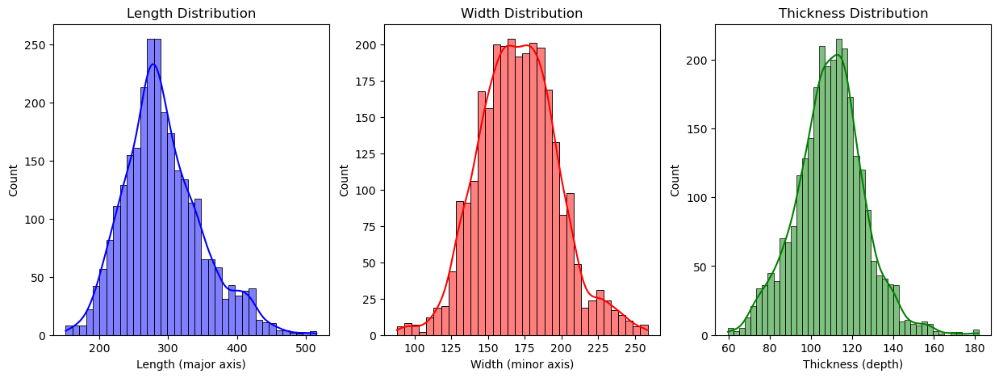

/Users/frankoswanepoel/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/frankoswanepoel/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/frankoswanepoel/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/frankoswanepoel/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self

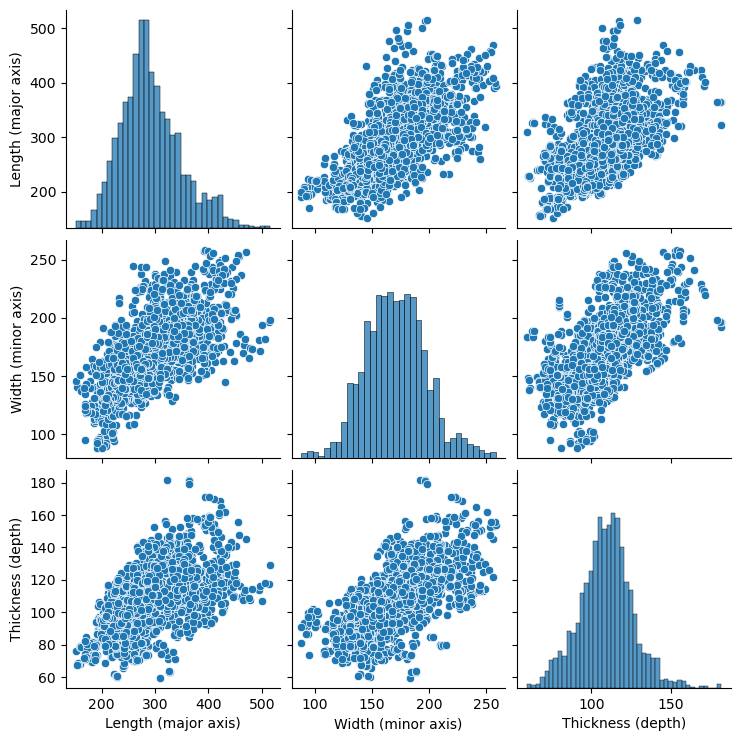

In [5]:
import matplotlib.pyplot as plt
import seaborn as sns

print("Descriptive Statistics of Original Data:")
print(data_imputed.describe())

fig, ax = plt.subplots(1, 3, figsize=(15, 5))
sns.histplot(data_imputed['Length (major axis)'], kde=True, ax=ax[0], color='blue').set_title('Length Distribution')
sns.histplot(data_imputed['Width (minor axis)'], kde=True, ax=ax[1], color='red').set_title('Width Distribution')
sns.histplot(data_imputed['Thickness (depth)'], kde=True, ax=ax[2], color='green').set_title('Thickness Distribution')
plt.show()

sns.pairplot(data_imputed[['Length (major axis)', 'Width (minor axis)', 'Thickness (depth)']])
plt.show()


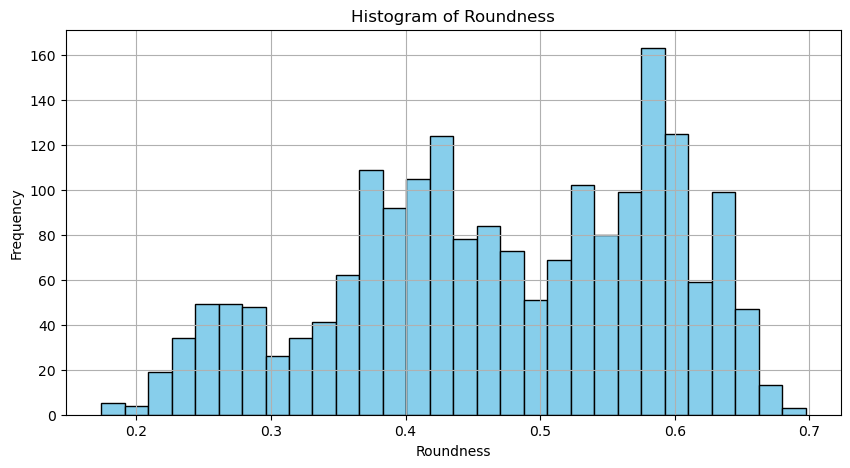

In [6]:
# This code block visualizes the frequency distribution of the 'Roundness' feature using a histogram.

import matplotlib.pyplot as plt

# Histogram of Roundness
plt.figure(figsize=(10, 5))
plt.hist(data_imputed['Roundness'].dropna(), bins=30, color='skyblue', edgecolor='black')
plt.title('Histogram of Roundness')
plt.xlabel('Roundness')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()


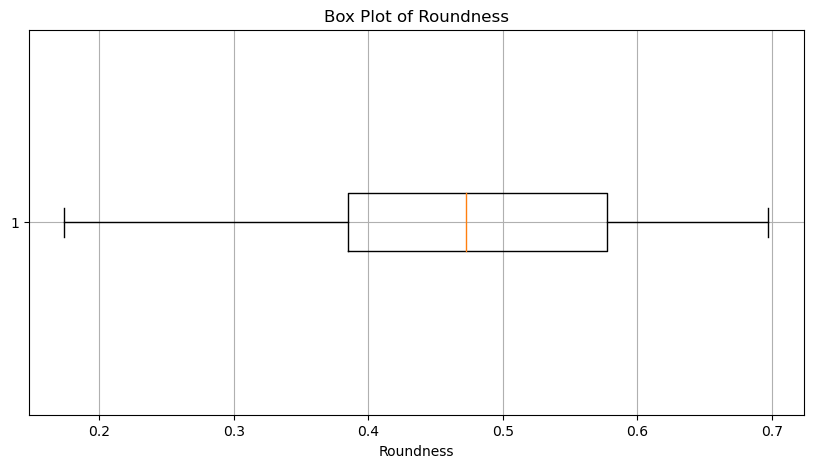

In [7]:
plt.figure(figsize=(10, 5))
plt.boxplot(data_imputed['Roundness'].dropna(), vert=False)
plt.title('Box Plot of Roundness')
plt.xlabel('Roundness')
plt.grid(True)
plt.show()


In [8]:
import pandas as pd
from sklearn.impute import SimpleImputer

median_imputer = SimpleImputer(strategy='median')

data_imputed['Roundness'] = median_imputer.fit_transform(data[['Roundness']])

print(data_imputed['Roundness'].describe()) 
print(data_imputed.isnull().sum()) 


count    2803.000000
mean        0.471154
std         0.098878
min         0.173748
25%         0.422593
50%         0.472718
75%         0.538321
max         0.697293
Name: Roundness, dtype: float64
Unnamed: 0                     0
Length (major axis)            0
Width (minor axis)             0
Thickness (depth)              0
Area                           0
Perimeter                      0
Roundness                      0
Solidity                       0
Compactness                    0
Aspect Ratio                1799
Eccentricity                1799
Extent                         0
Convex hull(convex area)       0
Type                           0
dtype: int64


Descriptive Statistics:
       Aspect Ratio  Eccentricity
count   1004.000000   1004.000000
mean       1.753216      0.813114
std        0.206616      0.041312
min        1.400082      0.699897
25%        1.612490      0.784476
50%        1.705716      0.810120
75%        1.833339      0.838141
max        2.731251      0.930563


/Users/frankoswanepoel/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/frankoswanepoel/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


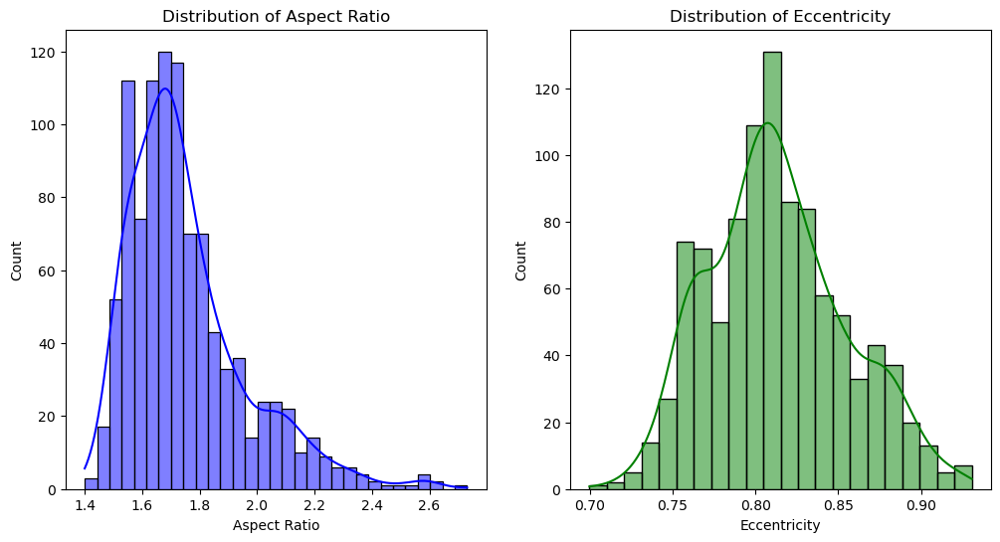

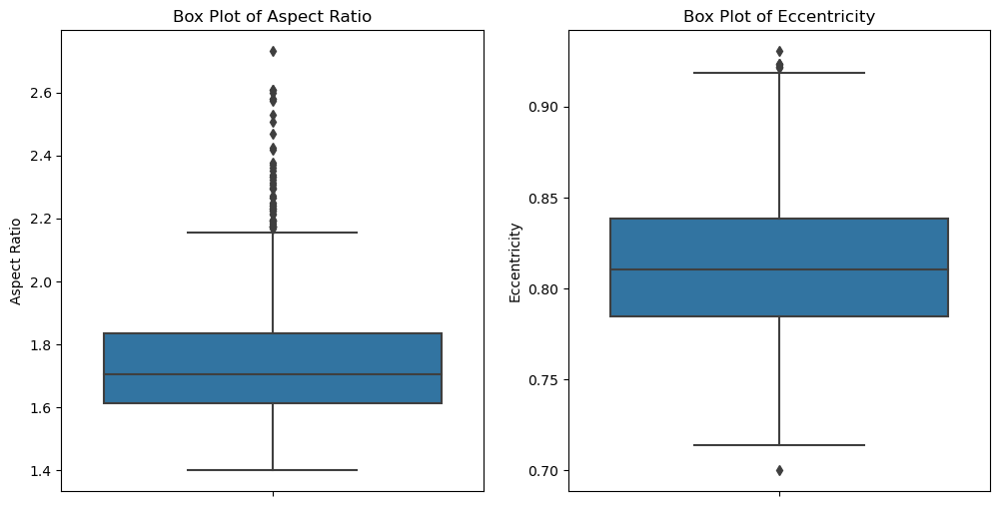

Correlation Matrix:
                          Aspect Ratio  Eccentricity
Unnamed: 0                   -0.194671     -0.185988
Length (major axis)           0.500352      0.490871
Width (minor axis)           -0.044345     -0.034087
Thickness (depth)             0.074980      0.093183
Area                          0.216451      0.235172
Perimeter                     0.357160      0.357425
Roundness                    -0.979051     -0.961953
Solidity                     -0.316187     -0.290617
Compactness                   0.380014      0.358555
Aspect Ratio                  1.000000      0.967328
Eccentricity                  0.967328      1.000000
Extent                       -0.120752     -0.113370
Convex hull(convex area)      0.236102      0.252841


/Users/frankoswanepoel/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/frankoswanepoel/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/frankoswanepoel/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


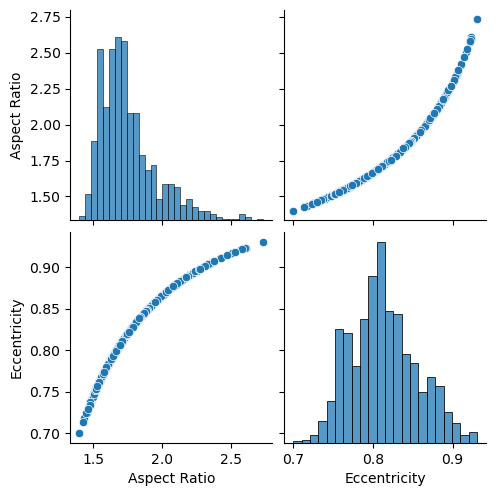

<bound method NDFrame.head of       Unnamed: 0  Length (major axis)  Width (minor axis)  Thickness (depth)  \
0              0           291.852063          227.940628         127.759132   
1              1           326.147974          234.188126         128.199509   
2              2           368.496790          229.418610         125.796547   
3              3           371.668274          232.763153         125.918808   
4              4           323.279550          230.150742         107.253448   
...          ...                  ...                 ...                ...   
2798        2798           341.279993          192.709366         122.356506   
2799        2799           285.745139          186.254745         118.708961   
2800        2800           284.730188          186.196182         119.147224   
2801        2801           335.413007          188.660828         120.634438   
2802        2802           269.356903          176.023636         112.384001   

         

In [9]:
# 
data_imputed['Aspect Ratio'] = pd.to_numeric(data_imputed['Aspect Ratio'], errors='coerce')
data_imputed['Eccentricity'] = pd.to_numeric(data_imputed['Eccentricity'], errors='coerce')

print("Descriptive Statistics:")
print(data_imputed[['Aspect Ratio', 'Eccentricity']].describe())

plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
sns.histplot(data_imputed['Aspect Ratio'].dropna(), kde=True, color='blue')  
plt.title('Distribution of Aspect Ratio')

plt.subplot(1, 2, 2)
sns.histplot(data_imputed['Eccentricity'].dropna(), kde=True, color='green')  
plt.title('Distribution of Eccentricity')
plt.show()

# Box plots
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
sns.boxplot(y=data_imputed['Aspect Ratio'].dropna()) 
plt.title('Box Plot of Aspect Ratio')

plt.subplot(1, 2, 2)
sns.boxplot(y=data_imputed['Eccentricity'].dropna())  
plt.title('Box Plot of Eccentricity')
plt.show()

numeric_data = data_imputed.select_dtypes(include=[np.number])  
correlation_matrix = numeric_data.corr()
print("Correlation Matrix:")
print(correlation_matrix[['Aspect Ratio', 'Eccentricity']])

sns.pairplot(numeric_data[['Aspect Ratio', 'Eccentricity']])  
plt.show()

data_imputed.head

In [10]:
import pandas as pd
from sklearn.impute import SimpleImputer
from sklearn.linear_model import LinearRegression

data = data_imputed

median_imputer = SimpleImputer(strategy='median')
model_aspect_to_ecc = LinearRegression()
model_ecc_to_aspect = LinearRegression()

complete_data = data.dropna(subset=['Aspect Ratio', 'Eccentricity'])

if not complete_data.empty:
    model_aspect_to_ecc.fit(complete_data[['Eccentricity']], complete_data['Aspect Ratio'])
    model_ecc_to_aspect.fit(complete_data[['Aspect Ratio']], complete_data['Eccentricity'])

    condition_aspect_missing = data['Aspect Ratio'].isnull() & data['Eccentricity'].notnull()
    if condition_aspect_missing.any():
        data.loc[condition_aspect_missing, 'Aspect Ratio'] = model_aspect_to_ecc.predict(
            data.loc[condition_aspect_missing, ['Eccentricity']]
        )

    condition_eccentricity_missing = data['Eccentricity'].isnull() & data['Aspect Ratio'].notnull()
    if condition_eccentricity_missing.any():
        data.loc[condition_eccentricity_missing, 'Eccentricity'] = model_ecc_to_aspect.predict(
            data.loc[condition_eccentricity_missing, ['Aspect Ratio']]
        )
else:
    print("No complete data available for training models.")

condition_both_missing = data['Aspect Ratio'].isnull() & data['Eccentricity'].isnull()
if condition_both_missing.any():
    data.loc[condition_both_missing, 'Aspect Ratio'] = median_imputer.fit_transform(
        data[['Aspect Ratio']]).ravel()[condition_both_missing]
    data.loc[condition_both_missing, 'Eccentricity'] = median_imputer.fit_transform(
        data[['Eccentricity']]).ravel()[condition_both_missing]

print(data.isnull().sum())
print(data[['Aspect Ratio', 'Eccentricity']].describe())


Unnamed: 0                  0
Length (major axis)         0
Width (minor axis)          0
Thickness (depth)           0
Area                        0
Perimeter                   0
Roundness                   0
Solidity                    0
Compactness                 0
Aspect Ratio                0
Eccentricity                0
Extent                      0
Convex hull(convex area)    0
Type                        0
dtype: int64
       Aspect Ratio  Eccentricity
count   2803.000000   2803.000000
mean       1.722729      0.811193
std        0.125699      0.024758
min        1.400082      0.699897
25%        1.705716      0.810120
50%        1.705716      0.810120
75%        1.705716      0.810120
max        2.731251      0.930563


In [11]:
# -------------------------------
# Phase 2: Training the Models
# -------------------------------

In [12]:

from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()

features_to_normalize = ['Length (major axis)', 'Width (minor axis)', 'Thickness (depth)', 'Aspect Ratio', 'Eccentricity']

data[features_to_normalize] = scaler.fit_transform(data[features_to_normalize])

print(data[features_to_normalize].head())


   Length (major axis)  Width (minor axis)  Thickness (depth)  Aspect Ratio  \
0             0.386017            0.820377           0.557943      0.229598   
1             0.480232            0.857015           0.561542      0.229598   
2             0.596569            0.829045           0.541902      0.229598   
3             0.605282            0.848659           0.542902      0.229598   
4             0.472352            0.833338           0.390346      0.229598   

   Eccentricity  
0      0.477848  
1      0.477848  
2      0.477848  
3      0.477848  
4      0.477848  


Statistics for Aspect Ratio before imputation and normalization:
count    2803.000000
mean        0.242379
std         0.094427
min         0.000000
25%         0.229598
50%         0.229598
75%         0.229598
max         1.000000
Name: Aspect Ratio, dtype: float64

Statistics for Eccentricity before imputation and normalization:
count    2803.000000
mean        0.482498
std         0.107334
min         0.000000
25%         0.477848
50%         0.477848
75%         0.477848
max         1.000000
Name: Eccentricity, dtype: float64


/Users/frankoswanepoel/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/frankoswanepoel/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


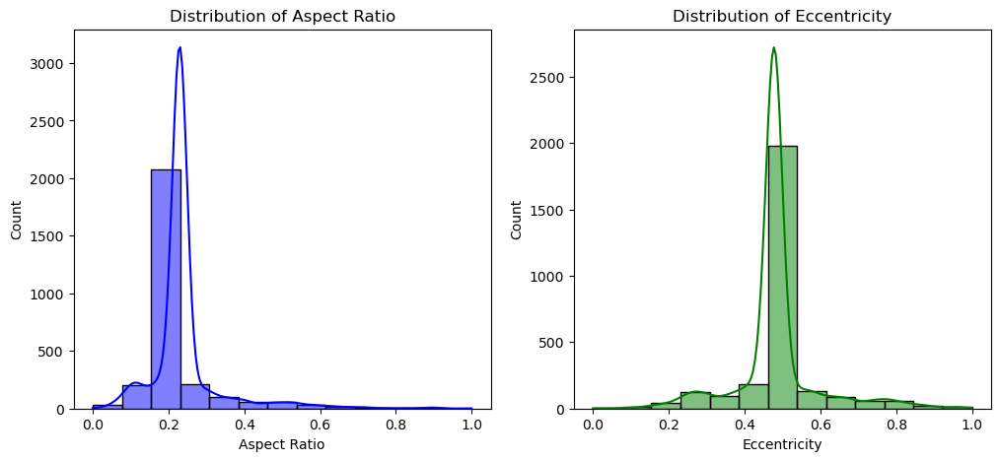

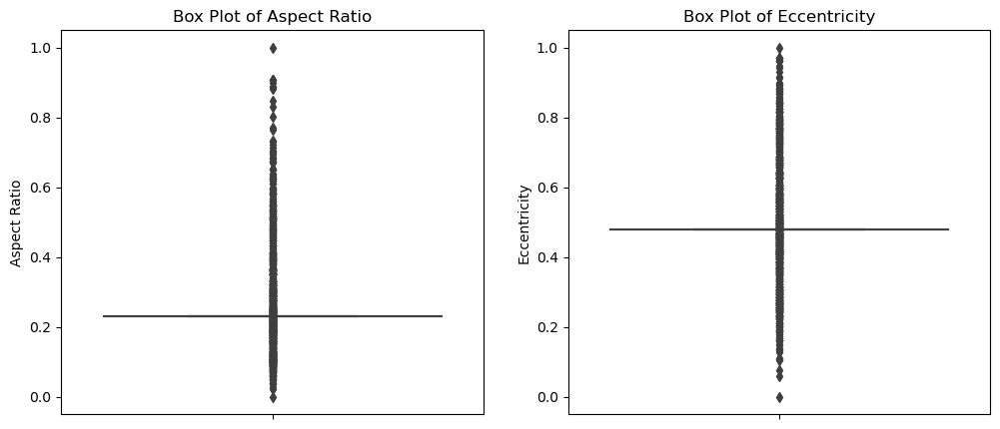

In [13]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd


print("Statistics for Aspect Ratio before imputation and normalization:")
print(data['Aspect Ratio'].describe())
print("\nStatistics for Eccentricity before imputation and normalization:")
print(data['Eccentricity'].describe())

plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
sns.histplot(data['Aspect Ratio'].dropna(), kde=True, color='blue')
plt.title('Distribution of Aspect Ratio')

plt.subplot(1, 2, 2)
sns.histplot(data['Eccentricity'].dropna(), kde=True, color='green')
plt.title('Distribution of Eccentricity')

plt.show()

plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
sns.boxplot(y=data['Aspect Ratio'])
plt.title('Box Plot of Aspect Ratio')

plt.subplot(1, 2, 2)
sns.boxplot(y=data['Eccentricity'])
plt.title('Box Plot of Eccentricity')

plt.show()


In [14]:
from sklearn.model_selection import train_test_split

X = data_imputed.drop('Type', axis=1)  # or whatever your target column is
y = data_imputed['Type']

X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.3, random_state=42)

X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)



In [15]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.utils import plot_model
import matplotlib.pyplot as plt
from sklearn.preprocessing import LabelEncoder
import numpy as np
import pandas as pd
import seaborn as sns


tf.config.run_functions_eagerly(True)

tf.data.experimental.enable_debug_mode()



X = data_imputed.drop('Type', axis=1)
y = data_imputed['Type']

from sklearn.model_selection import train_test_split
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.3, random_state=42)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)

label_encoder = LabelEncoder()
y_train_encoded = label_encoder.fit_transform(y_train)
y_val_encoded = label_encoder.transform(y_val)
y_test_encoded = label_encoder.transform(y_test)

X_train = X_train.values
X_val = X_val.values
X_test = X_test.values


2024-10-02 10:47:14.769862: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [72]:
import tensorflow as tf

class RPropOptimizer(tf.keras.optimizers.Optimizer):
    def __init__(self, learning_rate=0.01, eta_plus=1.2, eta_minus=0.5, delta_max=50.0, delta_min=1e-6, name="RProp", **kwargs):
        super().__init__(name=name, learning_rate=learning_rate, **kwargs)
        self.learning_rate = learning_rate
        self.eta_plus = eta_plus
        self.eta_minus = eta_minus
        self.delta_max = delta_max
        self.delta_min = delta_min
        self.slots = {}  # Dictionary to store slots

    @tf.function
    def _create_slots(self, var_list):
        """Create slots for each variable."""
        for var in var_list:
            self.slots[var.ref()] = {
                'prev_grad': tf.zeros_like(var),
                'delta': tf.ones_like(var) * 0.1
            }

    @tf.function
    def get_slot(self, var, name):
        """Retrieve slot variable."""
        return self.slots[var.ref()][name]

    @tf.function
    def update_step(self, gradient, variable, learning_rate=None):
        """Perform the RProp update step."""
        if learning_rate is None:
            learning_rate = self.learning_rate

        # Create slots for the variable if not already created
        if variable.ref() not in self.slots:
            self._create_slots([variable])

        prev_grad = self.get_slot(variable, 'prev_grad')
        delta = self.get_slot(variable, 'delta')

        grad_sign = tf.sign(gradient * prev_grad)

        delta_t = tf.where(
            grad_sign > 0, tf.minimum(delta * self.eta_plus, self.delta_max),
            tf.where(grad_sign < 0, tf.maximum(delta * self.eta_minus, self.delta_min), delta)
        )

        var_update = -tf.sign(gradient) * delta_t * learning_rate
        variable.assign_add(var_update)

        # Update the slots
        self.slots[variable.ref()]['prev_grad'] = gradient
        self.slots[variable.ref()]['delta'] = delta_t

    def get_config(self):
        """Return the optimizer configuration."""
        base_config = super().get_config()
        return {
            **base_config,
            "learning_rate": self.learning_rate,
            "eta_plus": self.eta_plus,
            "eta_minus": self.eta_minus,
            "delta_max": self.delta_max,
            "delta_min": self.delta_min
        }



[INFO] Imputing missing values for 'Roundness' column using median.


[INFO] Training Adam optimizer with 4 first hidden neurons, 4 second hidden neurons, and 0.0001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3287 - loss: 519.5256 - val_accuracy: 0.3405 - val_loss: 450.1230
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3366 - loss: 491.5531 - val_accuracy: 0.3405 - val_loss: 424.8539
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3528 - loss: 459.0690 - val_accuracy: 0.3405 - val_loss: 399.8874
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 58ms/step - accuracy: 0.3209 - loss: 454.4426 - val_accuracy: 0.3405 - val_loss: 375.8320
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 58ms/step - accuracy: 0.3209 - loss: 428.6944 - val_accuracy: 0.3405 - val_loss: 353.0311
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 58ms/step - accuracy: 0.3424 - loss: 346.9319 - val_accuracy: 0.3214 - val_loss: 334.1707
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━

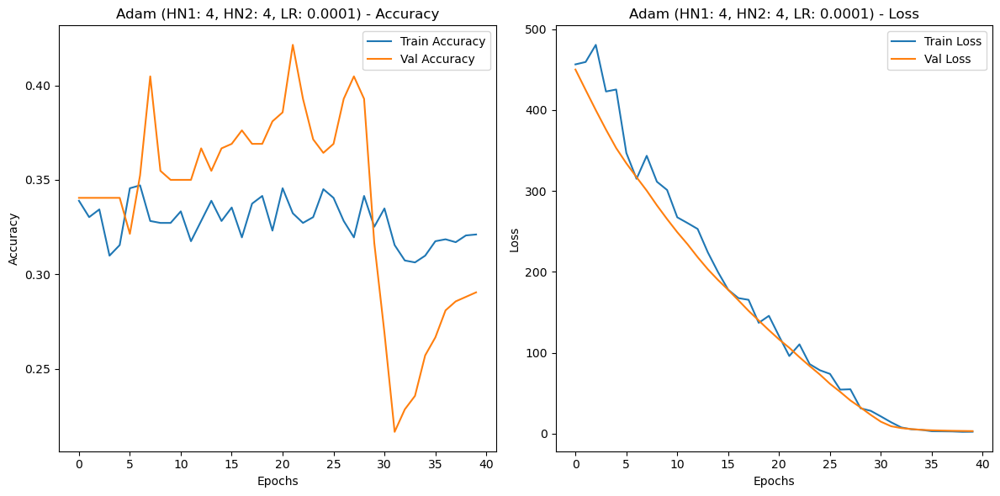


[INFO] Training RProp optimizer with 4 first hidden neurons, 4 second hidden neurons, and 0.0001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3265 - loss: 27229.8652 - val_accuracy: 0.3214 - val_loss: 20992.8594
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 40ms/step - accuracy: 0.3330 - loss: 17860.7422 - val_accuracy: 0.3214 - val_loss: 7006.6641
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3063 - loss: 5227.1348 - val_accuracy: 0.3214 - val_loss: 1015.2873
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3207 - loss: 609.3257 - val_accuracy: 0.3405 - val_loss: 43.5579
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 40ms/step - accuracy: 0.3278 - loss: 15.1502 - val_accuracy: 0.3571 - val_loss: 1.8510
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3409 - loss: 1.8870 - val_accuracy: 0.3571 - val_loss: 1.8103
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3326 - loss: 1.8002 - val_accuracy:

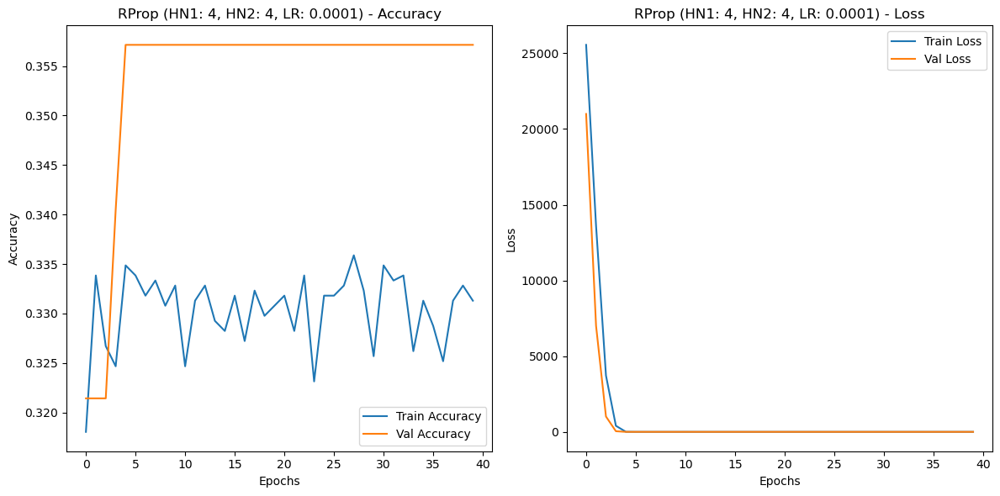


[INFO] Training Adam optimizer with 4 first hidden neurons, 4 second hidden neurons, and 0.001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 4s 115ms/step - accuracy: 0.3230 - loss: 32.7069 - val_accuracy: 0.3119 - val_loss: 5.6776
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3285 - loss: 4.4911 - val_accuracy: 0.3286 - val_loss: 2.9243
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3411 - loss: 1.7046 - val_accuracy: 0.3286 - val_loss: 2.1835
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3181 - loss: 2.0721 - val_accuracy: 0.3381 - val_loss: 1.6585
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3339 - loss: 1.1213 - val_accuracy: 0.3357 - val_loss: 1.4718
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 58ms/step - accuracy: 0.3577 - loss: 1.0979 - val_accuracy: 0.3357 - val_loss: 1.4472
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3515 - loss: 1.1262 - val_accuracy: 0.3357 - val_loss: 1.442

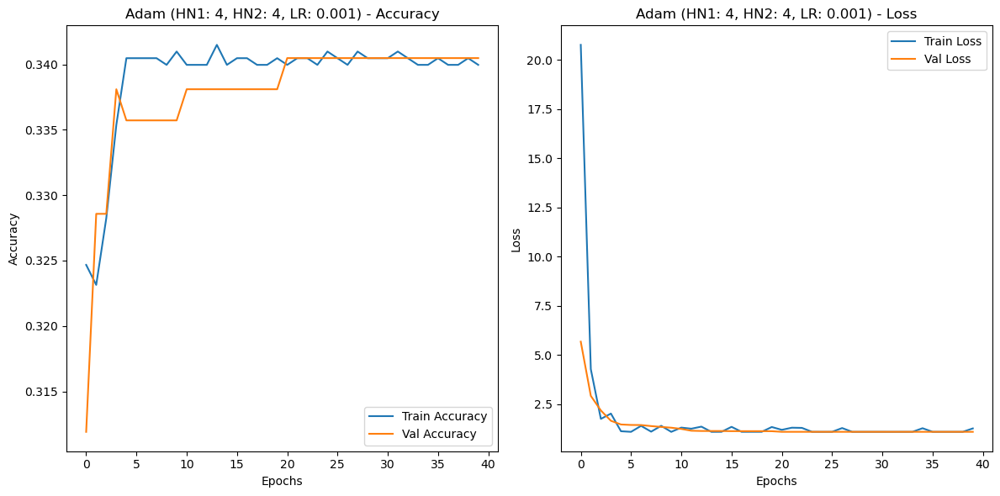


[INFO] Training RProp optimizer with 4 first hidden neurons, 4 second hidden neurons, and 0.001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 56ms/step - accuracy: 0.3312 - loss: 22259.0684 - val_accuracy: 0.3405 - val_loss: 3758.0066
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3562 - loss: 1290.2068 - val_accuracy: 0.3214 - val_loss: 1.1017
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 50ms/step - accuracy: 0.3616 - loss: 1.0967 - val_accuracy: 0.3214 - val_loss: 1.1017
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 50ms/step - accuracy: 0.3271 - loss: 1.1009 - val_accuracy: 0.3214 - val_loss: 1.1017
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3435 - loss: 1.0992 - val_accuracy: 0.3214 - val_loss: 1.1017
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 58ms/step - accuracy: 0.3332 - loss: 1.1002 - val_accuracy: 0.3214 - val_loss: 1.1017
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3192 - loss: 1.1019 - val_accuracy: 0.3214 - val_lo

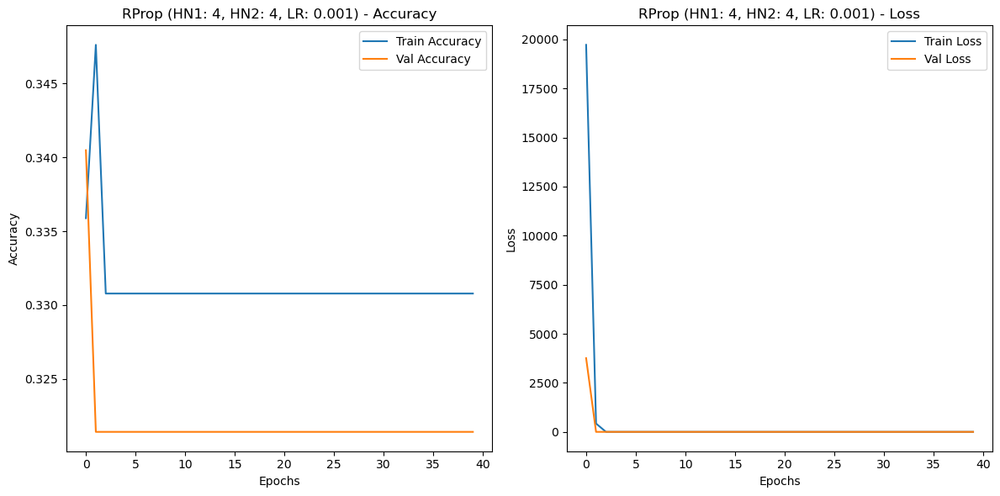


[INFO] Training Adam optimizer with 4 first hidden neurons, 4 second hidden neurons, and 0.01 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 83ms/step - accuracy: 0.3501 - loss: 4694.8208 - val_accuracy: 0.3214 - val_loss: 1.1116
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 78ms/step - accuracy: 0.3248 - loss: 1.1098 - val_accuracy: 0.3214 - val_loss: 1.1014
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 76ms/step - accuracy: 0.3362 - loss: 1.0989 - val_accuracy: 0.3214 - val_loss: 1.0990
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 74ms/step - accuracy: 0.3405 - loss: 1.0986 - val_accuracy: 0.3405 - val_loss: 1.0985
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3386 - loss: 1.0987 - val_accuracy: 0.3405 - val_loss: 1.0986
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3343 - loss: 1.0988 - val_accuracy: 0.3405 - val_loss: 1.0987
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3206 - loss: 1.0988 - val_accuracy: 0.3405 - val_loss: 1.098

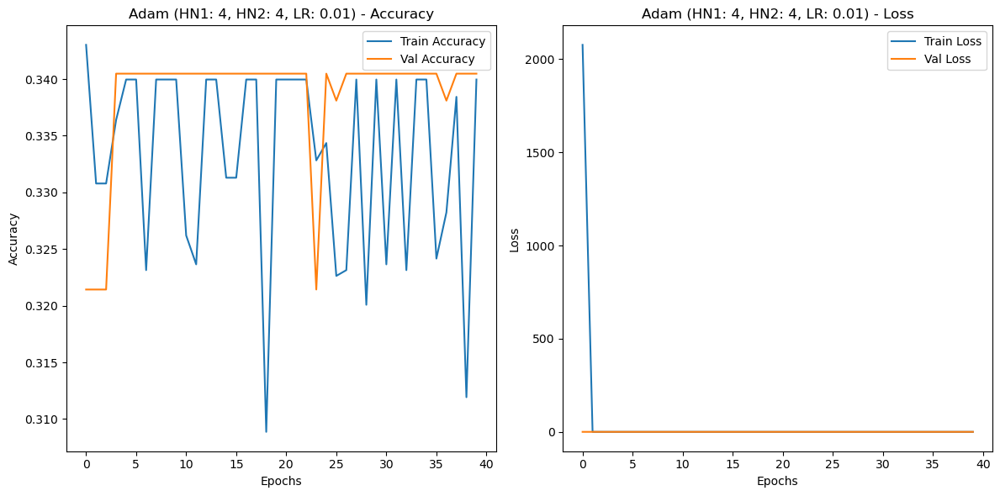


[INFO] Training RProp optimizer with 4 first hidden neurons, 4 second hidden neurons, and 0.01 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 49ms/step - accuracy: 0.3505 - loss: 11958.9150 - val_accuracy: 0.3405 - val_loss: 1.1094
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3250 - loss: 222.5886 - val_accuracy: 0.3405 - val_loss: 1.0986
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3418 - loss: 1.0987 - val_accuracy: 0.3405 - val_loss: 1.0986
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 48ms/step - accuracy: 0.3405 - loss: 1.0986 - val_accuracy: 0.3405 - val_loss: 1.0986
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3469 - loss: 1.0985 - val_accuracy: 0.3405 - val_loss: 1.0986
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3452 - loss: 1.0986 - val_accuracy: 0.3405 - val_loss: 1.0986
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3472 - loss: 1.0986 - val_accuracy: 0.3405 - val_loss: 1

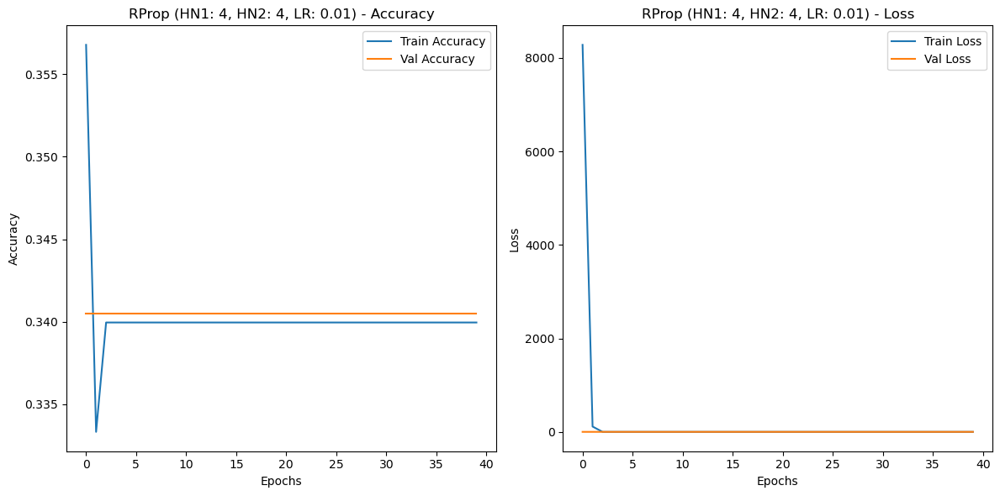


[INFO] Training Adam optimizer with 4 first hidden neurons, 4 second hidden neurons, and 0.1 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 70ms/step - accuracy: 0.3411 - loss: 12.3510 - val_accuracy: 0.3214 - val_loss: 1.1043
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - accuracy: 0.3341 - loss: 1.1043 - val_accuracy: 0.3381 - val_loss: 1.0998
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 68ms/step - accuracy: 0.3413 - loss: 1.1014 - val_accuracy: 0.3214 - val_loss: 1.1114
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - accuracy: 0.3198 - loss: 1.1095 - val_accuracy: 0.3214 - val_loss: 1.1035
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 68ms/step - accuracy: 0.3259 - loss: 1.1025 - val_accuracy: 0.3214 - val_loss: 1.1067
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3273 - loss: 1.1027 - val_accuracy: 0.3214 - val_loss: 1.1022
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3215 - loss: 1.1023 - val_accuracy: 0.3214 - val_loss: 1.1005
E

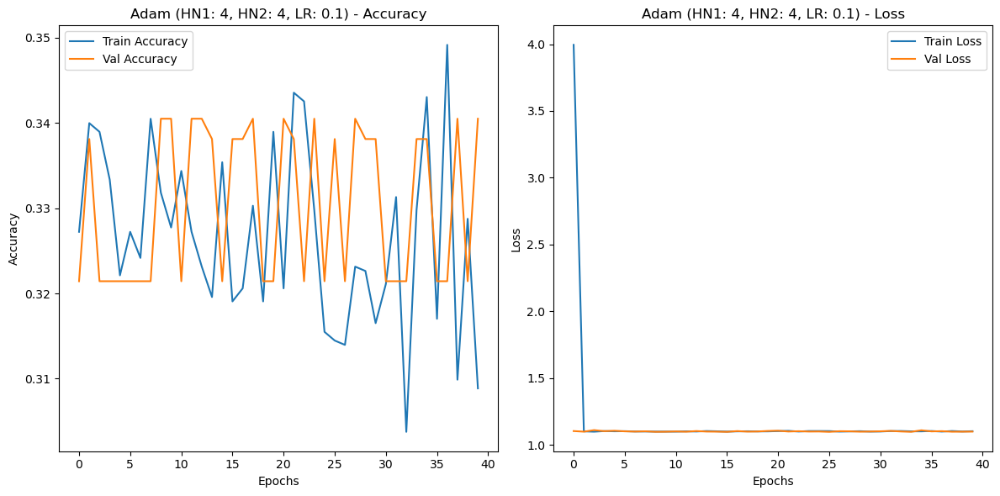


[INFO] Training RProp optimizer with 4 first hidden neurons, 4 second hidden neurons, and 0.1 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3118 - loss: 3139.4597 - val_accuracy: 0.3214 - val_loss: 1.1008
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3343 - loss: 1.0993 - val_accuracy: 0.3214 - val_loss: 1.1008
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3189 - loss: 1.1005 - val_accuracy: 0.3214 - val_loss: 1.1008
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3321 - loss: 1.1000 - val_accuracy: 0.3214 - val_loss: 1.1008
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3424 - loss: 1.0994 - val_accuracy: 0.3214 - val_loss: 1.1008
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3495 - loss: 1.0993 - val_accuracy: 0.3214 - val_loss: 1.1008
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3400 - loss: 1.1001 - val_accuracy: 0.3214 - val_loss: 1.100

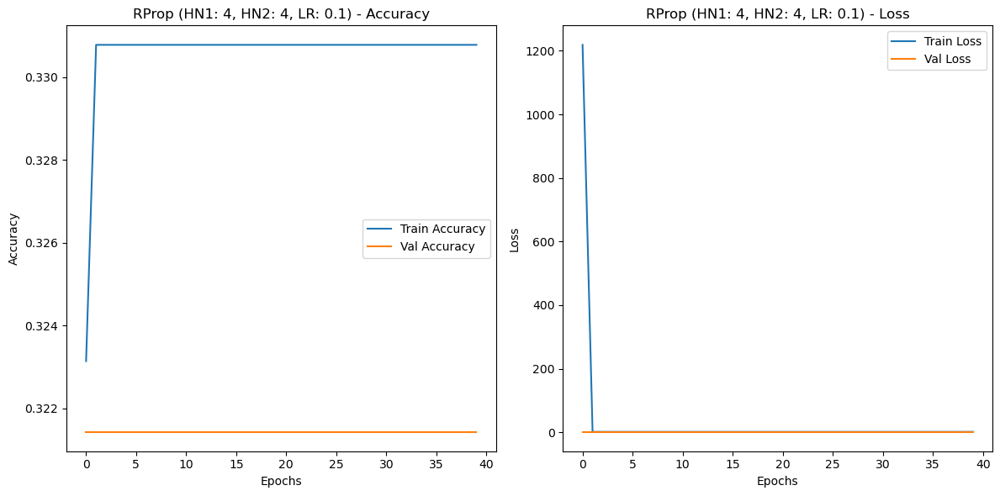


[INFO] Training Adam optimizer with 4 first hidden neurons, 8 second hidden neurons, and 0.0001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 70ms/step - accuracy: 0.3450 - loss: 15021.5068 - val_accuracy: 0.3214 - val_loss: 12283.4131
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 69ms/step - accuracy: 0.3305 - loss: 15656.5303 - val_accuracy: 0.3214 - val_loss: 11989.8574
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - accuracy: 0.3573 - loss: 15165.7754 - val_accuracy: 0.3214 - val_loss: 11690.0557
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 68ms/step - accuracy: 0.3486 - loss: 13236.8125 - val_accuracy: 0.3214 - val_loss: 11404.6592
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - accuracy: 0.3176 - loss: 13065.0684 - val_accuracy: 0.3214 - val_loss: 11130.9336
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 70ms/step - accuracy: 0.3331 - loss: 13914.4277 - val_accuracy: 0.3214 - val_loss: 10837.3311
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3308 - loss: 

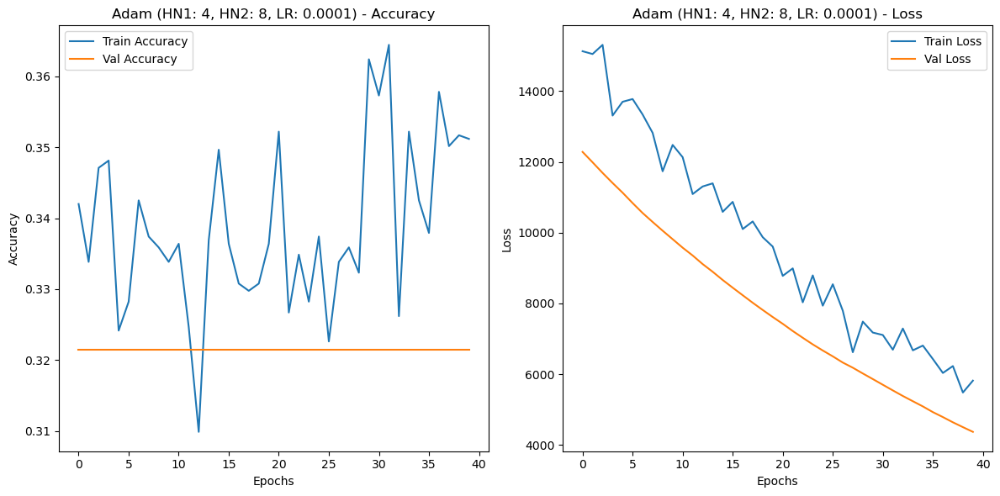


[INFO] Training RProp optimizer with 4 first hidden neurons, 8 second hidden neurons, and 0.0001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3243 - loss: 9644.1963 - val_accuracy: 0.3214 - val_loss: 1810.4771
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3343 - loss: 8221.1396 - val_accuracy: 0.3405 - val_loss: 498.7393
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 50ms/step - accuracy: 0.3306 - loss: 2368.8989 - val_accuracy: 0.3643 - val_loss: 1.7910
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 58ms/step - accuracy: 0.3419 - loss: 3.1458 - val_accuracy: 0.3214 - val_loss: 1.0986
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 84ms/step - accuracy: 0.3224 - loss: 1.0986 - val_accuracy: 0.3214 - val_loss: 1.0986
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 56ms/step - accuracy: 0.3238 - loss: 1.0986 - val_accuracy: 0.3214 - val_loss: 1.0986
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3251 - loss: 1.0986 - val_accuracy: 0.3214 - v

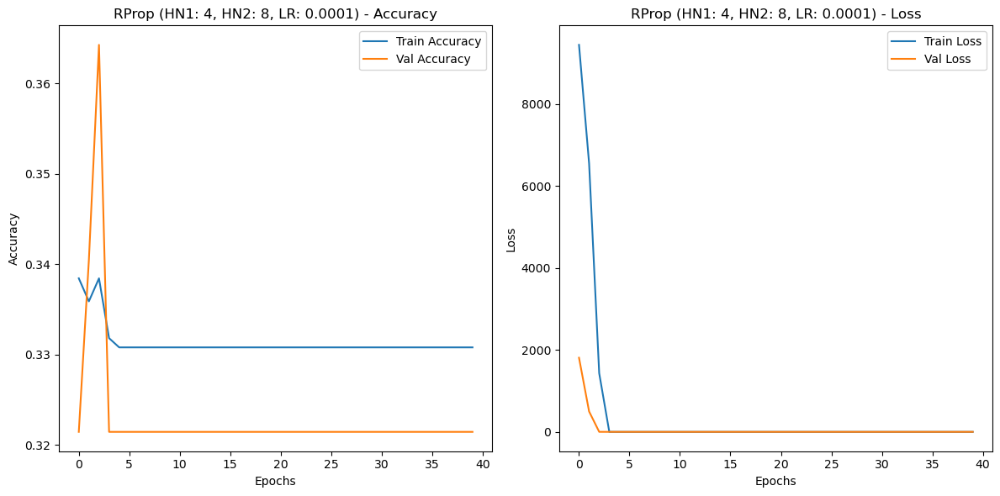


[INFO] Training Adam optimizer with 4 first hidden neurons, 8 second hidden neurons, and 0.001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 73ms/step - accuracy: 0.3312 - loss: 3050.3789 - val_accuracy: 0.2548 - val_loss: 116.1430
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 74ms/step - accuracy: 0.3269 - loss: 2012.0328 - val_accuracy: 0.2571 - val_loss: 125.9273
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3283 - loss: 1485.0546 - val_accuracy: 0.2571 - val_loss: 116.8972
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3410 - loss: 1020.9569 - val_accuracy: 0.3095 - val_loss: 98.6053
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3337 - loss: 776.8314 - val_accuracy: 0.2405 - val_loss: 76.3006
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 58ms/step - accuracy: 0.3337 - loss: 469.9900 - val_accuracy: 0.2952 - val_loss: 61.7761
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3119 - loss: 294.5066 - val_accuracy:

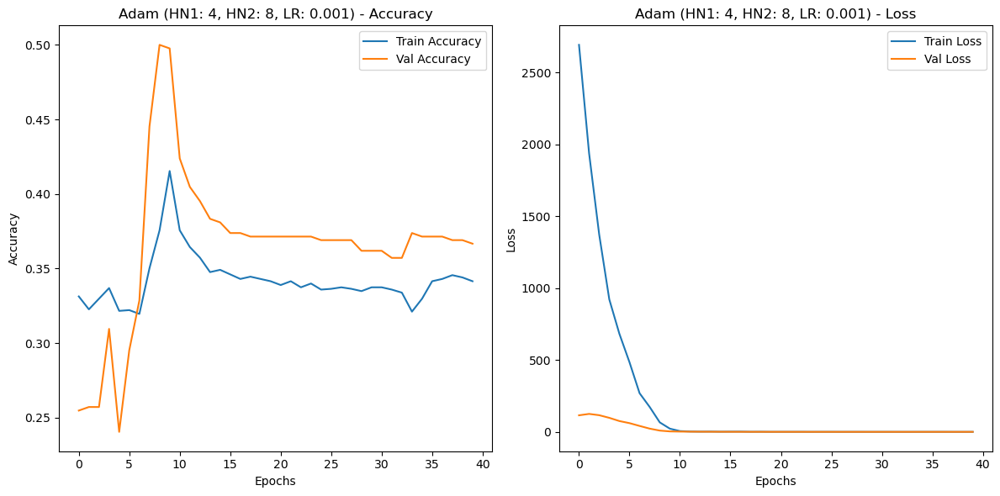


[INFO] Training RProp optimizer with 4 first hidden neurons, 8 second hidden neurons, and 0.001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3237 - loss: 4742.5601 - val_accuracy: 0.3381 - val_loss: 851.2849
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3364 - loss: 731.6844 - val_accuracy: 0.3381 - val_loss: 3.5896
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 54ms/step - accuracy: 0.3323 - loss: 3.6191 - val_accuracy: 0.3381 - val_loss: 3.5376
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 50ms/step - accuracy: 0.3243 - loss: 1.8026 - val_accuracy: 0.3381 - val_loss: 3.5177
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3136 - loss: 6.5566 - val_accuracy: 0.3381 - val_loss: 3.4366
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3189 - loss: 3.5067 - val_accuracy: 0.3381 - val_loss: 3.3880
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3088 - loss: 6.8231 - val_accuracy: 0.3381 - val_loss:

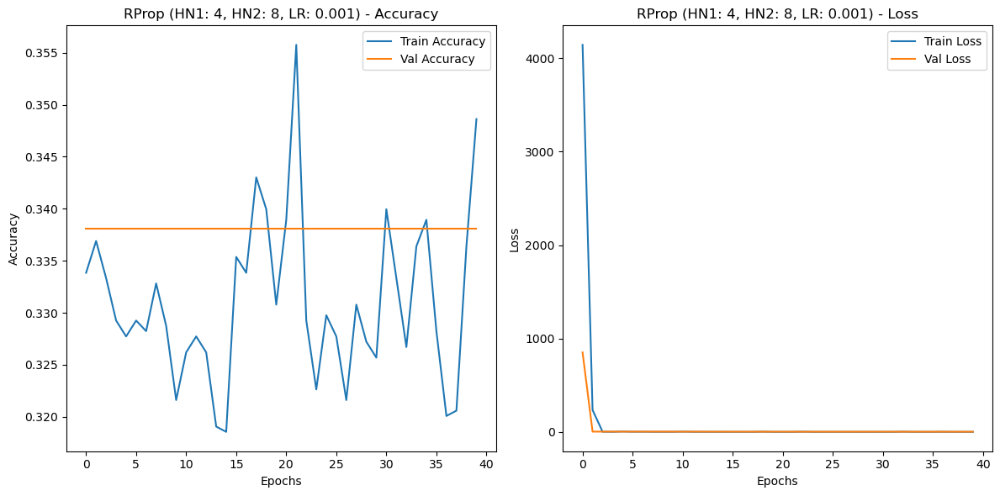


[INFO] Training Adam optimizer with 4 first hidden neurons, 8 second hidden neurons, and 0.01 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - accuracy: 0.3196 - loss: 7626.8892 - val_accuracy: 0.3214 - val_loss: 442.2284
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - accuracy: 0.3090 - loss: 687.2773 - val_accuracy: 0.3381 - val_loss: 1.1007
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3230 - loss: 1.1009 - val_accuracy: 0.3405 - val_loss: 1.0987
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3318 - loss: 1.0987 - val_accuracy: 0.3405 - val_loss: 1.0985
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 69ms/step - accuracy: 0.3218 - loss: 1.0991 - val_accuracy: 0.3405 - val_loss: 1.0984
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 76ms/step - accuracy: 0.3432 - loss: 1.0984 - val_accuracy: 0.3405 - val_loss: 1.0985
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 73ms/step - accuracy: 0.3514 - loss: 1.0982 - val_accuracy: 0.3405 - val_loss: 1

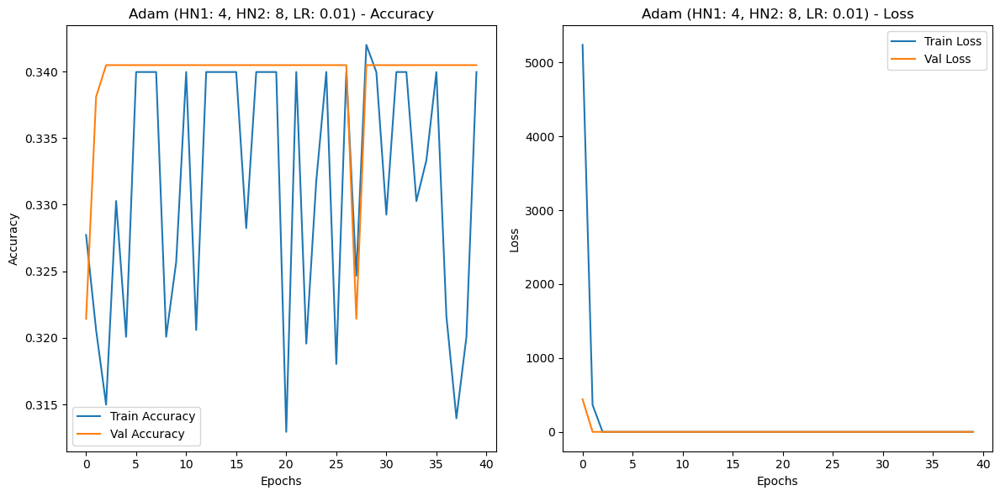


[INFO] Training RProp optimizer with 4 first hidden neurons, 8 second hidden neurons, and 0.01 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 57ms/step - accuracy: 0.3374 - loss: 1381.5435 - val_accuracy: 0.3405 - val_loss: 1.6845
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 55ms/step - accuracy: 0.3387 - loss: 19.6532 - val_accuracy: 0.3405 - val_loss: 1.2630
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 53ms/step - accuracy: 0.3351 - loss: 2.6829 - val_accuracy: 0.3452 - val_loss: 1.0938
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3466 - loss: 1.1458 - val_accuracy: 0.3452 - val_loss: 1.0933
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 50ms/step - accuracy: 0.3362 - loss: 1.1022 - val_accuracy: 0.3452 - val_loss: 1.0933
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3298 - loss: 1.1008 - val_accuracy: 0.3452 - val_loss: 1.0933
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 50ms/step - accuracy: 0.3422 - loss: 1.1064 - val_accuracy: 0.3571 - val_loss: 1.0

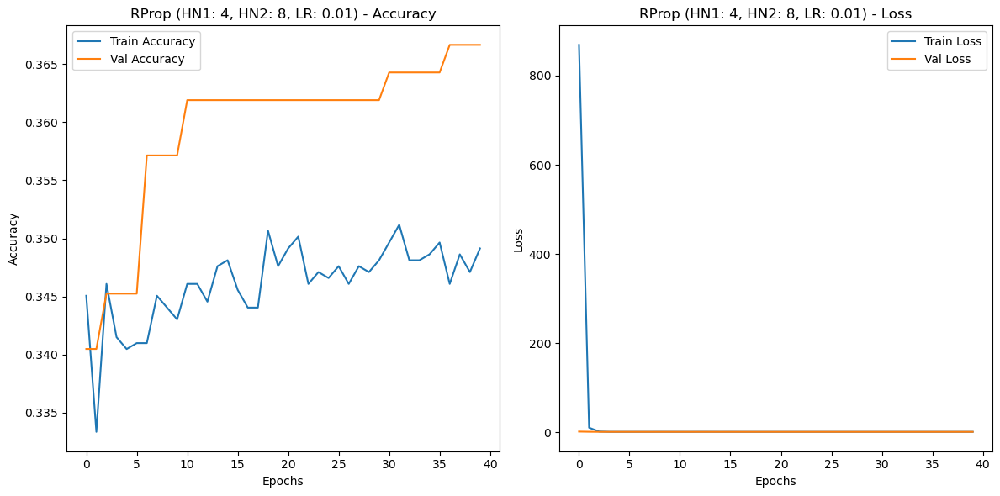


[INFO] Training Adam optimizer with 4 first hidden neurons, 8 second hidden neurons, and 0.1 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 107ms/step - accuracy: 0.3352 - loss: 442.1828 - val_accuracy: 0.3405 - val_loss: 1.1023
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 101ms/step - accuracy: 0.3540 - loss: 1.0990 - val_accuracy: 0.3214 - val_loss: 1.1025
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 4s 117ms/step - accuracy: 0.3523 - loss: 1.0987 - val_accuracy: 0.3214 - val_loss: 1.1013
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 96ms/step - accuracy: 0.3318 - loss: 1.1002 - val_accuracy: 0.3405 - val_loss: 1.1005
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 77ms/step - accuracy: 0.3497 - loss: 1.0992 - val_accuracy: 0.3405 - val_loss: 1.1012
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 72ms/step - accuracy: 0.3310 - loss: 1.1042 - val_accuracy: 0.3405 - val_loss: 1.0991
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 72ms/step - accuracy: 0.3327 - loss: 1.1031 - val_accuracy: 0.3405 - val_loss: 1.09

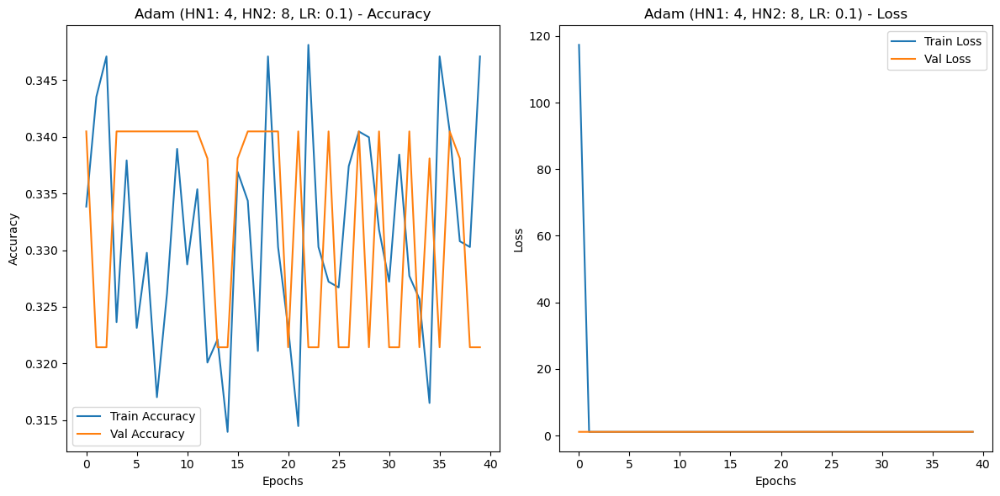


[INFO] Training RProp optimizer with 4 first hidden neurons, 8 second hidden neurons, and 0.1 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 50ms/step - accuracy: 0.3073 - loss: 15280.8848 - val_accuracy: 0.3381 - val_loss: 1.0986
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3476 - loss: 1.0978 - val_accuracy: 0.3381 - val_loss: 1.0986
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3389 - loss: 1.0991 - val_accuracy: 0.3381 - val_loss: 1.0986
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3291 - loss: 1.1019 - val_accuracy: 0.3381 - val_loss: 1.0991
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3368 - loss: 1.0984 - val_accuracy: 0.3381 - val_loss: 1.0991
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3315 - loss: 1.0997 - val_accuracy: 0.3381 - val_loss: 1.0991
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3118 - loss: 1.1017 - val_accuracy: 0.3381 - val_loss: 1.09

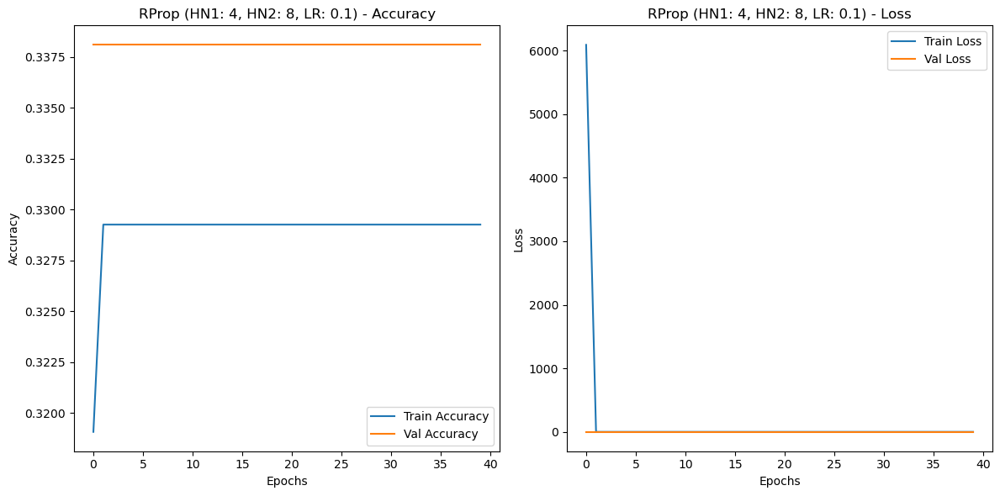


[INFO] Training Adam optimizer with 4 first hidden neurons, 16 second hidden neurons, and 0.0001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3344 - loss: 4563.0732 - val_accuracy: 0.3405 - val_loss: 2633.0452
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3337 - loss: 4612.0752 - val_accuracy: 0.3405 - val_loss: 2450.2351
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3542 - loss: 4365.6494 - val_accuracy: 0.3405 - val_loss: 2283.1143
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3204 - loss: 4591.2285 - val_accuracy: 0.3405 - val_loss: 2129.3828
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 58ms/step - accuracy: 0.3181 - loss: 4449.0342 - val_accuracy: 0.3405 - val_loss: 2003.6274
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 56ms/step - accuracy: 0.3038 - loss: 3911.3315 - val_accuracy: 0.3405 - val_loss: 1868.8761
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3436 - loss: 3756.3916 -

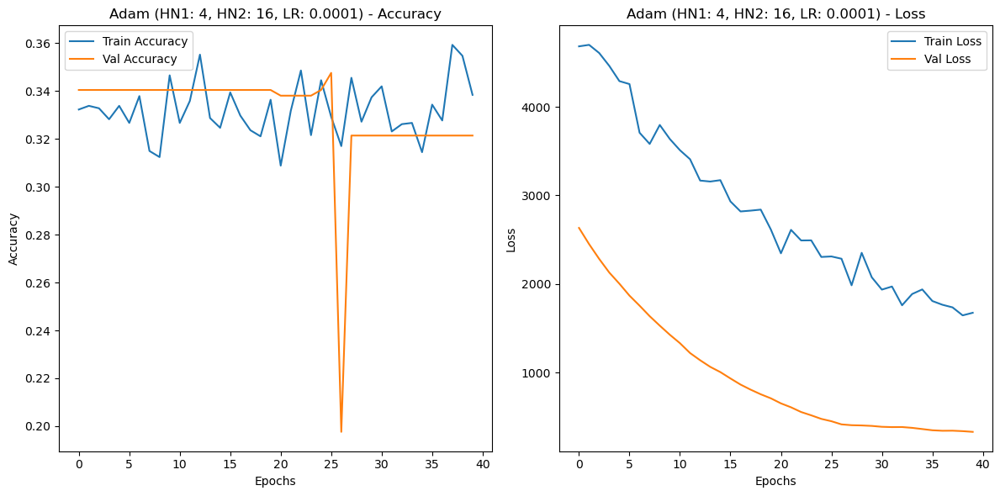


[INFO] Training RProp optimizer with 4 first hidden neurons, 16 second hidden neurons, and 0.0001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3196 - loss: 914.3162 - val_accuracy: 0.3405 - val_loss: 424.4984
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3252 - loss: 486.7444 - val_accuracy: 0.3381 - val_loss: 1.0987
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3213 - loss: 1.0987 - val_accuracy: 0.3381 - val_loss: 1.0987
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3157 - loss: 1.0987 - val_accuracy: 0.3381 - val_loss: 1.0987
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3280 - loss: 1.0987 - val_accuracy: 0.3381 - val_loss: 1.0987
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3201 - loss: 1.0986 - val_accuracy: 0.3381 - val_loss: 1.0987
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 40ms/step - accuracy: 0.3405 - loss: 1.0986 - val_accuracy: 0.3381 - val_loss

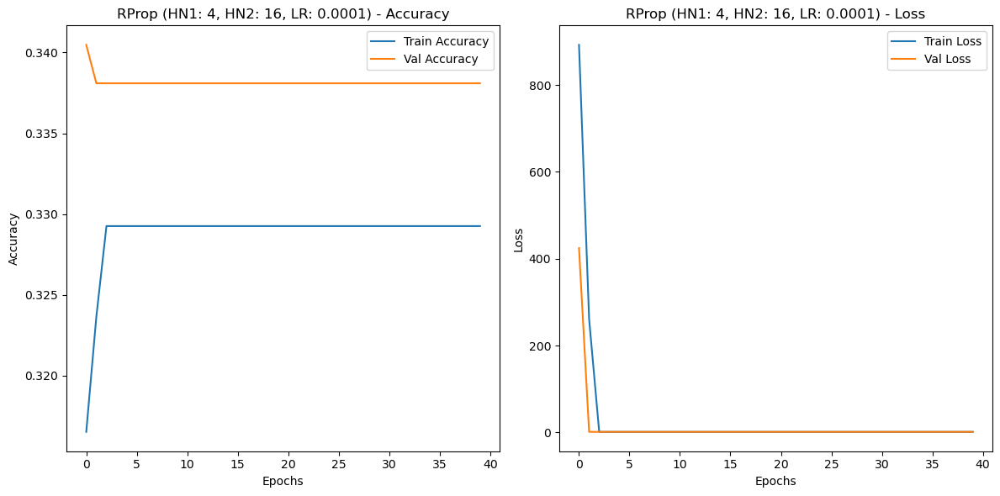


[INFO] Training Adam optimizer with 4 first hidden neurons, 16 second hidden neurons, and 0.001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 72ms/step - accuracy: 0.3296 - loss: 5830.9707 - val_accuracy: 0.3214 - val_loss: 3110.4512
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 80ms/step - accuracy: 0.3335 - loss: 3712.9226 - val_accuracy: 0.3214 - val_loss: 1735.0538
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 84ms/step - accuracy: 0.3495 - loss: 2253.5706 - val_accuracy: 0.3214 - val_loss: 942.5707
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 111ms/step - accuracy: 0.3377 - loss: 1811.4894 - val_accuracy: 0.3214 - val_loss: 576.6248
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 96ms/step - accuracy: 0.3371 - loss: 1286.3590 - val_accuracy: 0.3214 - val_loss: 300.0244
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.3123 - loss: 918.3242 - val_accuracy: 0.3405 - val_loss: 192.0772
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 74ms/step - accuracy: 0.3219 - loss: 775.2494 - val_a

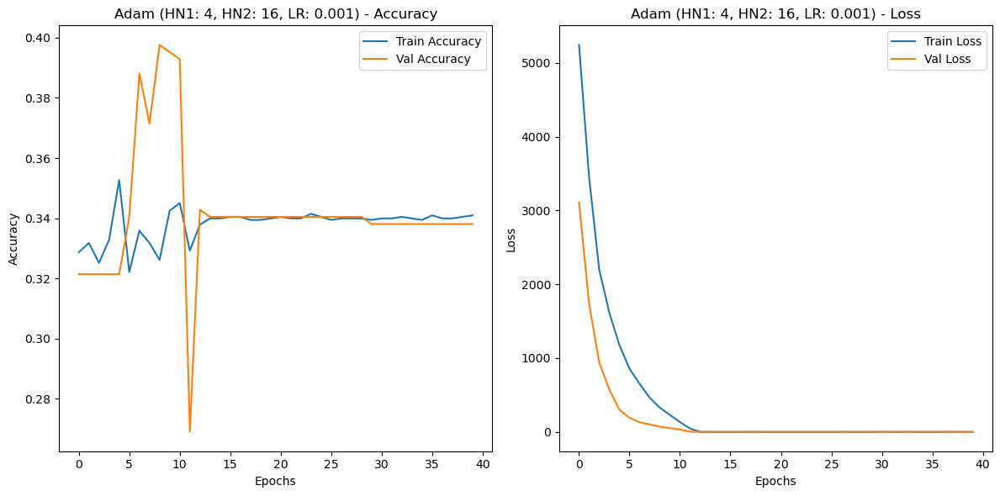


[INFO] Training RProp optimizer with 4 first hidden neurons, 16 second hidden neurons, and 0.001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3277 - loss: 9637.6738 - val_accuracy: 0.3476 - val_loss: 116.5575
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3085 - loss: 562.6187 - val_accuracy: 0.3405 - val_loss: 1.0989
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3471 - loss: 1.0985 - val_accuracy: 0.3405 - val_loss: 1.0989
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3448 - loss: 1.0992 - val_accuracy: 0.3405 - val_loss: 1.0989
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3432 - loss: 1.0997 - val_accuracy: 0.3405 - val_loss: 1.0989
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3509 - loss: 1.0989 - val_accuracy: 0.3405 - val_loss: 1.0989
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3536 - loss: 1.0979 - val_accuracy: 0.3405 - val_loss

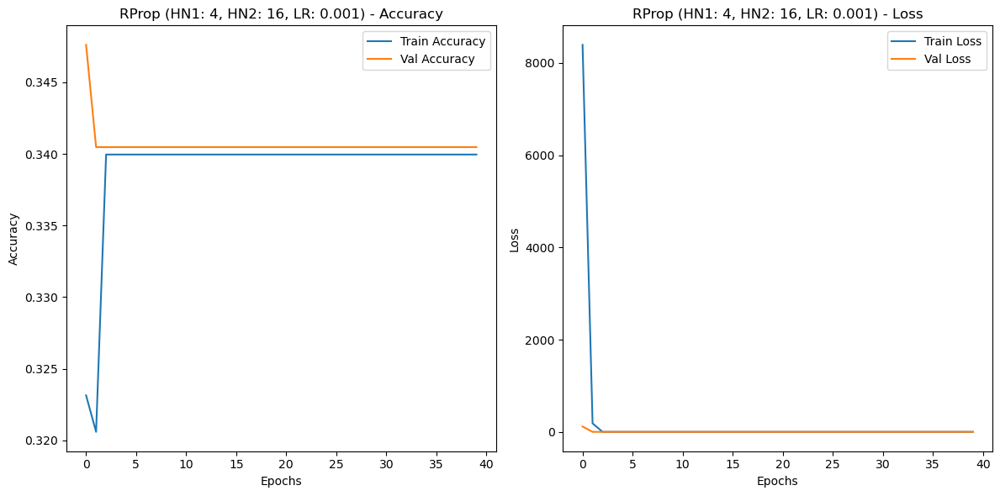


[INFO] Training Adam optimizer with 4 first hidden neurons, 16 second hidden neurons, and 0.01 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3307 - loss: 1882.7173 - val_accuracy: 0.4786 - val_loss: 0.9676
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3369 - loss: 1.2521 - val_accuracy: 0.3214 - val_loss: 1.1044
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3466 - loss: 1.0982 - val_accuracy: 0.3214 - val_loss: 1.0992
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3333 - loss: 1.0988 - val_accuracy: 0.3405 - val_loss: 1.0986
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 58ms/step - accuracy: 0.3245 - loss: 1.0990 - val_accuracy: 0.3405 - val_loss: 1.0986
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3355 - loss: 1.0988 - val_accuracy: 0.3405 - val_loss: 1.0985
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3570 - loss: 1.0980 - val_accuracy: 0.3405 - val_loss: 1.09

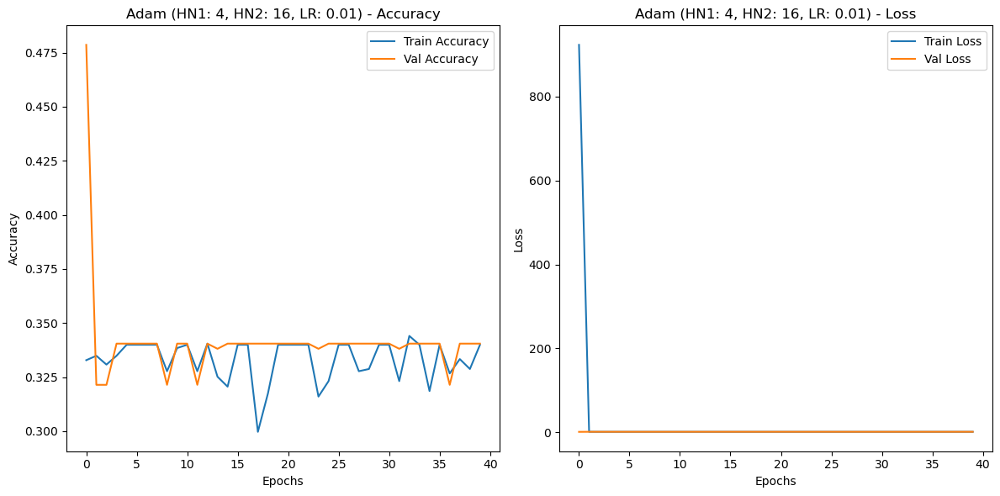


[INFO] Training RProp optimizer with 4 first hidden neurons, 16 second hidden neurons, and 0.01 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3436 - loss: 4575.1201 - val_accuracy: 0.3405 - val_loss: 1.0989
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3473 - loss: 1.0981 - val_accuracy: 0.3405 - val_loss: 1.0988
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3272 - loss: 1.0997 - val_accuracy: 0.3405 - val_loss: 1.0988
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3312 - loss: 1.0997 - val_accuracy: 0.3405 - val_loss: 1.0988
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 53ms/step - accuracy: 0.3535 - loss: 1.0978 - val_accuracy: 0.3405 - val_loss: 1.0988
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3407 - loss: 1.0989 - val_accuracy: 0.3405 - val_loss: 1.0988
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3545 - loss: 1.0978 - val_accuracy: 0.3405 - val_loss: 1.0

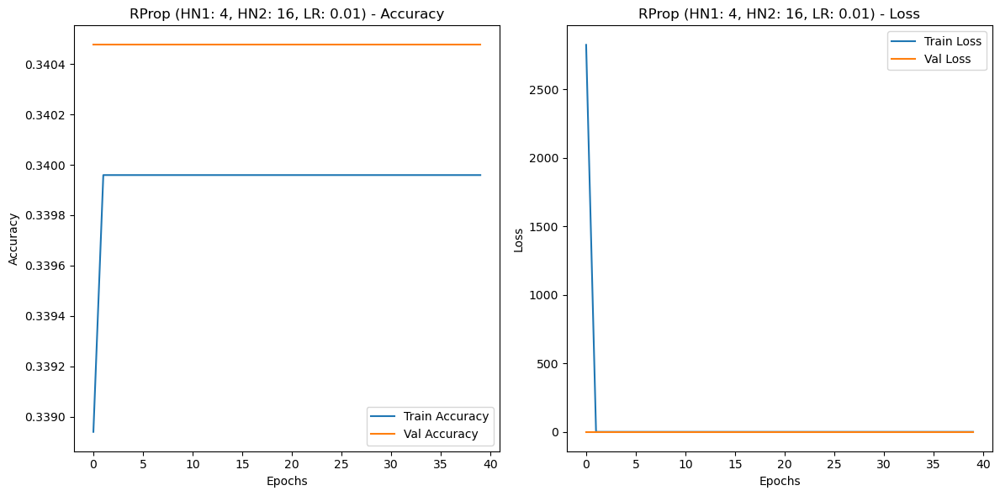


[INFO] Training Adam optimizer with 4 first hidden neurons, 16 second hidden neurons, and 0.1 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 71ms/step - accuracy: 0.3319 - loss: 59.4664 - val_accuracy: 0.3381 - val_loss: 1.1025
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 68ms/step - accuracy: 0.3260 - loss: 1.1035 - val_accuracy: 0.3381 - val_loss: 1.1056
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 69ms/step - accuracy: 0.3225 - loss: 1.1075 - val_accuracy: 0.3381 - val_loss: 1.1016
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 68ms/step - accuracy: 0.3099 - loss: 1.1046 - val_accuracy: 0.3381 - val_loss: 1.1005
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 69ms/step - accuracy: 0.3149 - loss: 1.1010 - val_accuracy: 0.3381 - val_loss: 1.1030
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 68ms/step - accuracy: 0.3262 - loss: 1.1026 - val_accuracy: 0.3381 - val_loss: 1.0997
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - accuracy: 0.3315 - loss: 1.1009 - val_accuracy: 0.3381 - val_loss: 1.1001


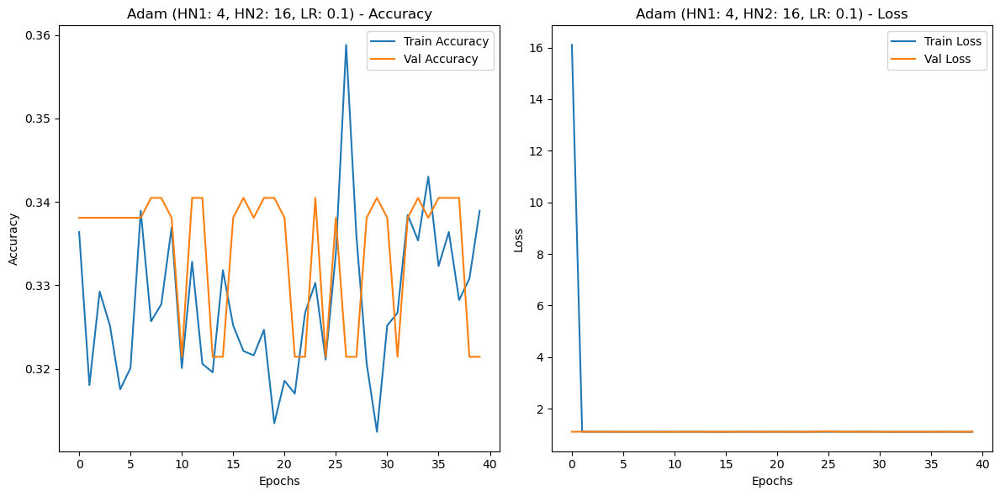


[INFO] Training RProp optimizer with 4 first hidden neurons, 16 second hidden neurons, and 0.1 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 50ms/step - accuracy: 0.3445 - loss: 2511.3721 - val_accuracy: 0.3381 - val_loss: 1.3117
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 48ms/step - accuracy: 0.3585 - loss: 1.1338 - val_accuracy: 0.3381 - val_loss: 1.1462
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 52ms/step - accuracy: 0.3433 - loss: 1.0980 - val_accuracy: 0.3381 - val_loss: 1.1511
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3460 - loss: 1.0984 - val_accuracy: 0.3381 - val_loss: 1.1511
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3269 - loss: 1.0971 - val_accuracy: 0.3381 - val_loss: 1.2656
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 49ms/step - accuracy: 0.3517 - loss: 1.2106 - val_accuracy: 0.3381 - val_loss: 1.0984
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3277 - loss: 1.0992 - val_accuracy: 0.3381 - val_loss: 1.09

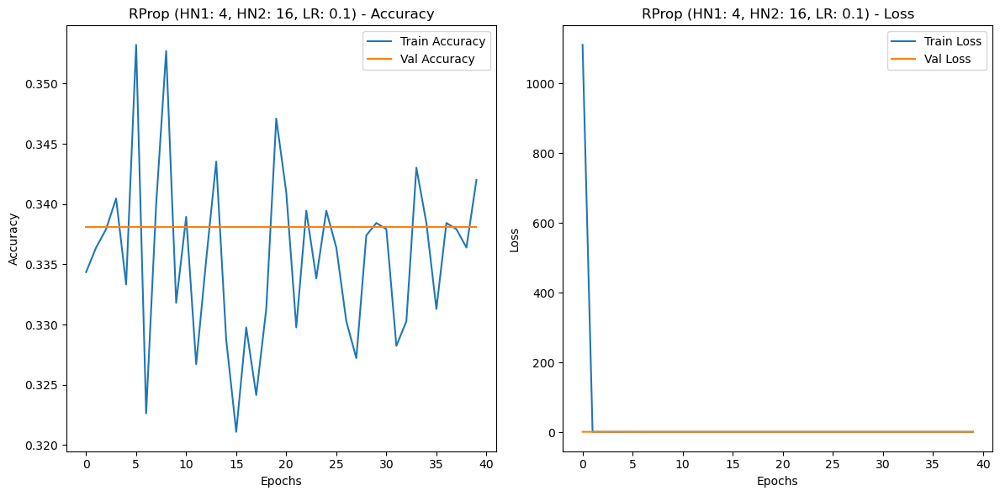


[INFO] Training Adam optimizer with 4 first hidden neurons, 32 second hidden neurons, and 0.0001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 68ms/step - accuracy: 0.3399 - loss: 1570.8789 - val_accuracy: 0.3381 - val_loss: 1194.1467
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3377 - loss: 1339.5474 - val_accuracy: 0.3381 - val_loss: 1069.3215
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 69ms/step - accuracy: 0.3441 - loss: 1343.3514 - val_accuracy: 0.3381 - val_loss: 948.4009
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 70ms/step - accuracy: 0.3292 - loss: 1226.2434 - val_accuracy: 0.3381 - val_loss: 842.8680
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 69ms/step - accuracy: 0.3295 - loss: 1170.3444 - val_accuracy: 0.3381 - val_loss: 741.7455
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 69ms/step - accuracy: 0.3219 - loss: 1025.8529 - val_accuracy: 0.3381 - val_loss: 658.2679
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 69ms/step - accuracy: 0.3529 - loss: 924.6132 - val_

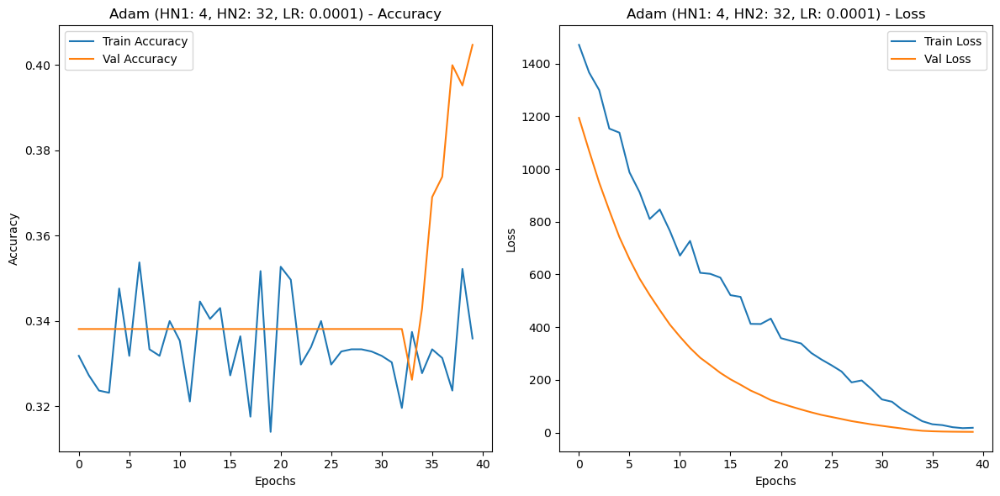


[INFO] Training RProp optimizer with 4 first hidden neurons, 32 second hidden neurons, and 0.0001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3387 - loss: 4882.2549 - val_accuracy: 0.3381 - val_loss: 2334.3069
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3105 - loss: 3592.4822 - val_accuracy: 0.3405 - val_loss: 323.9795
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3043 - loss: 767.7839 - val_accuracy: 0.4071 - val_loss: 37.3874
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3550 - loss: 180.5671 - val_accuracy: 0.3714 - val_loss: 14.0521
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3486 - loss: 128.4100 - val_accuracy: 0.3214 - val_loss: 20.7007
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3464 - loss: 38.8333 - val_accuracy: 0.3381 - val_loss: 2.2929
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3430 - loss: 1.9187 - val_accuracy: 0.

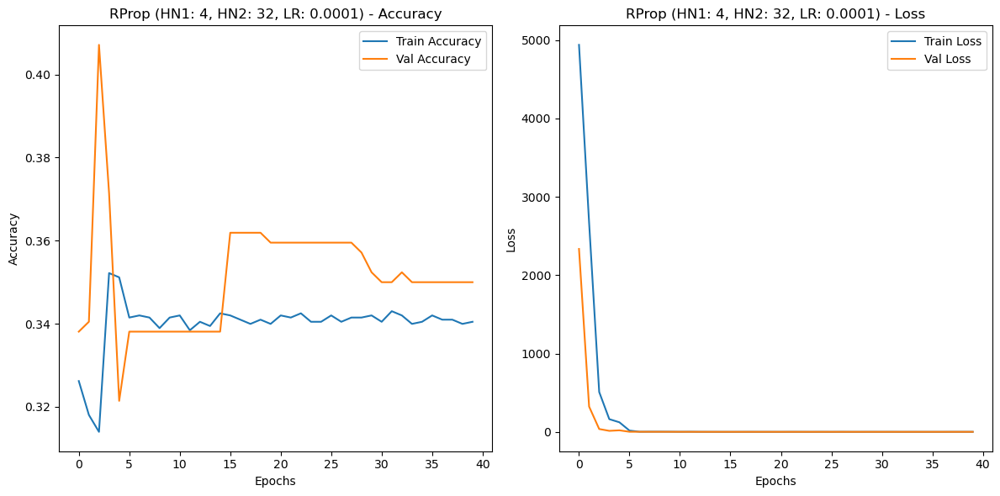


[INFO] Training Adam optimizer with 4 first hidden neurons, 32 second hidden neurons, and 0.001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 70ms/step - accuracy: 0.3168 - loss: 8026.5786 - val_accuracy: 0.3214 - val_loss: 479.1517
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - accuracy: 0.3585 - loss: 3903.3237 - val_accuracy: 0.3405 - val_loss: 569.5784
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 71ms/step - accuracy: 0.3238 - loss: 3578.0605 - val_accuracy: 0.3262 - val_loss: 542.0215
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 68ms/step - accuracy: 0.3430 - loss: 2531.7500 - val_accuracy: 0.2738 - val_loss: 235.1918
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 72ms/step - accuracy: 0.3473 - loss: 2048.8950 - val_accuracy: 0.3405 - val_loss: 322.9297
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3323 - loss: 1518.1365 - val_accuracy: 0.3405 - val_loss: 224.8725
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3375 - loss: 1142.5067 - val_ac

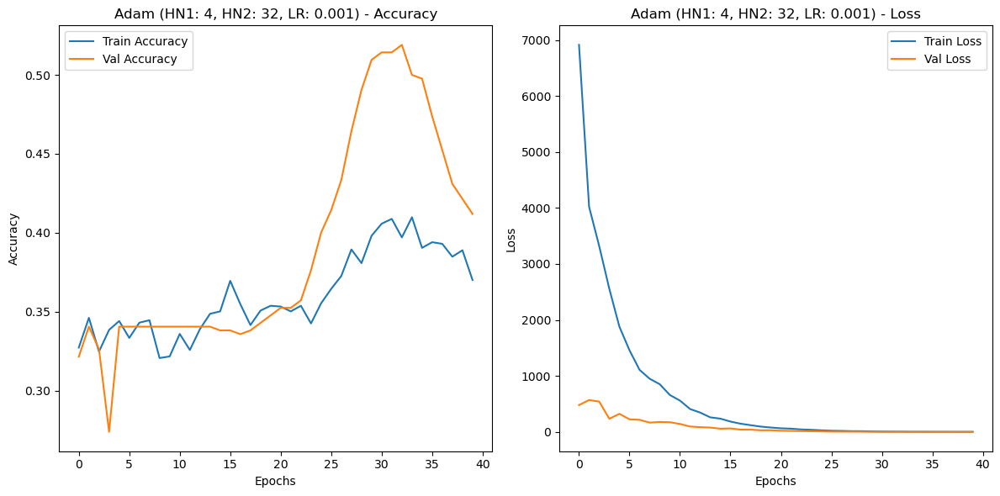


[INFO] Training RProp optimizer with 4 first hidden neurons, 32 second hidden neurons, and 0.001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3559 - loss: 11140.5635 - val_accuracy: 0.3405 - val_loss: 356.5350
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3418 - loss: 2699.4014 - val_accuracy: 0.3405 - val_loss: 1.1376
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3509 - loss: 1.4453 - val_accuracy: 0.3357 - val_loss: 1.1148
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3416 - loss: 1.0986 - val_accuracy: 0.3381 - val_loss: 1.1319
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3390 - loss: 1.1415 - val_accuracy: 0.3405 - val_loss: 1.0987
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3587 - loss: 1.0976 - val_accuracy: 0.3405 - val_loss: 1.0987
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 51ms/step - accuracy: 0.3539 - loss: 1.0979 - val_accuracy: 0.3405 - val_lo

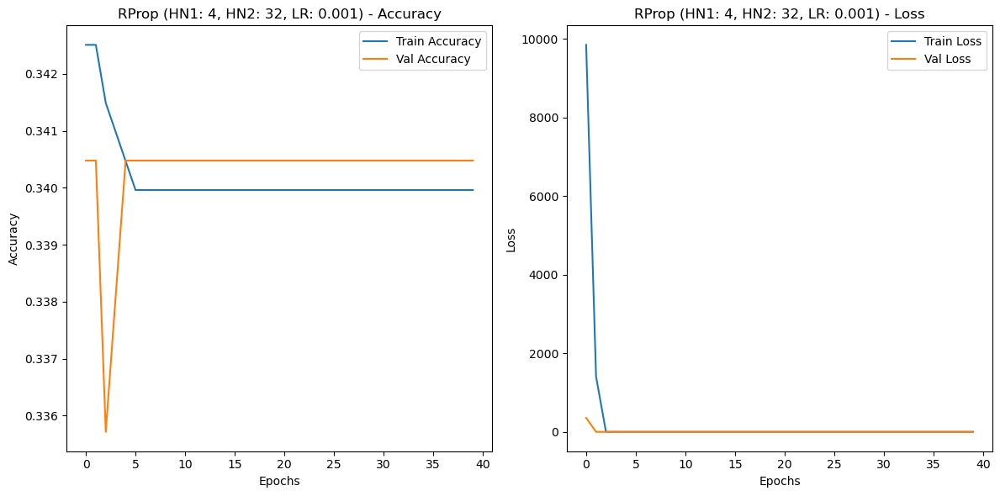


[INFO] Training Adam optimizer with 4 first hidden neurons, 32 second hidden neurons, and 0.01 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 69ms/step - accuracy: 0.3461 - loss: 4026.3472 - val_accuracy: 0.3381 - val_loss: 30.5009
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 68ms/step - accuracy: 0.3404 - loss: 124.7247 - val_accuracy: 0.3405 - val_loss: 1.0998
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 68ms/step - accuracy: 0.3229 - loss: 1.1015 - val_accuracy: 0.3405 - val_loss: 1.0988
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 68ms/step - accuracy: 0.3358 - loss: 1.0987 - val_accuracy: 0.3405 - val_loss: 1.0986
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 72ms/step - accuracy: 0.3309 - loss: 1.0989 - val_accuracy: 0.3405 - val_loss: 1.0984
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 72ms/step - accuracy: 0.3484 - loss: 1.0985 - val_accuracy: 0.3405 - val_loss: 1.0986
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 75ms/step - accuracy: 0.3480 - loss: 1.0983 - val_accuracy: 0.3405 - val_loss: 1

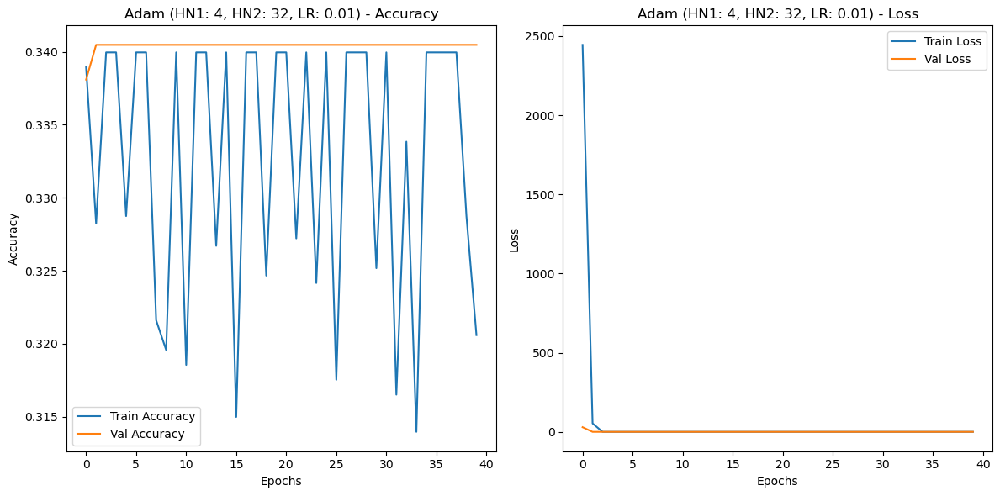


[INFO] Training RProp optimizer with 4 first hidden neurons, 32 second hidden neurons, and 0.01 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3340 - loss: 249.4630 - val_accuracy: 0.3381 - val_loss: 1.0984
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3099 - loss: 1.1044 - val_accuracy: 0.3381 - val_loss: 1.0984
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3284 - loss: 1.1372 - val_accuracy: 0.3381 - val_loss: 1.0984
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3417 - loss: 1.0984 - val_accuracy: 0.3381 - val_loss: 1.0984
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3249 - loss: 1.0988 - val_accuracy: 0.3381 - val_loss: 1.0984
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3364 - loss: 1.0986 - val_accuracy: 0.3381 - val_loss: 1.0984
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3290 - loss: 1.0988 - val_accuracy: 0.3381 - val_loss: 1.09

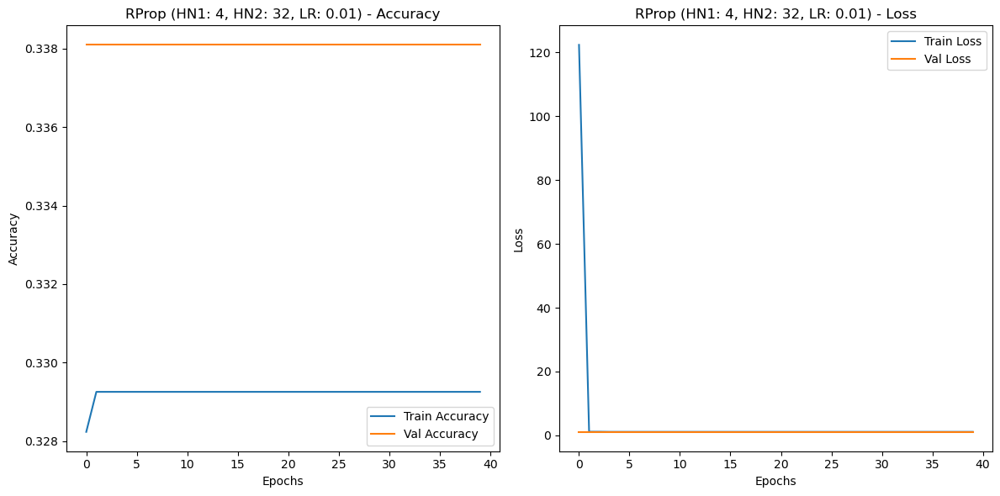


[INFO] Training Adam optimizer with 4 first hidden neurons, 32 second hidden neurons, and 0.1 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - accuracy: 0.3355 - loss: 8.5314 - val_accuracy: 0.3214 - val_loss: 1.1059
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3643 - loss: 1.1020 - val_accuracy: 0.3405 - val_loss: 1.0990
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3468 - loss: 1.1001 - val_accuracy: 0.3214 - val_loss: 1.1081
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3361 - loss: 1.1060 - val_accuracy: 0.3405 - val_loss: 1.1049
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3276 - loss: 1.1038 - val_accuracy: 0.3214 - val_loss: 1.1056
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3370 - loss: 1.1026 - val_accuracy: 0.3405 - val_loss: 1.0991
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3283 - loss: 1.1010 - val_accuracy: 0.3405 - val_loss: 1.0987
E

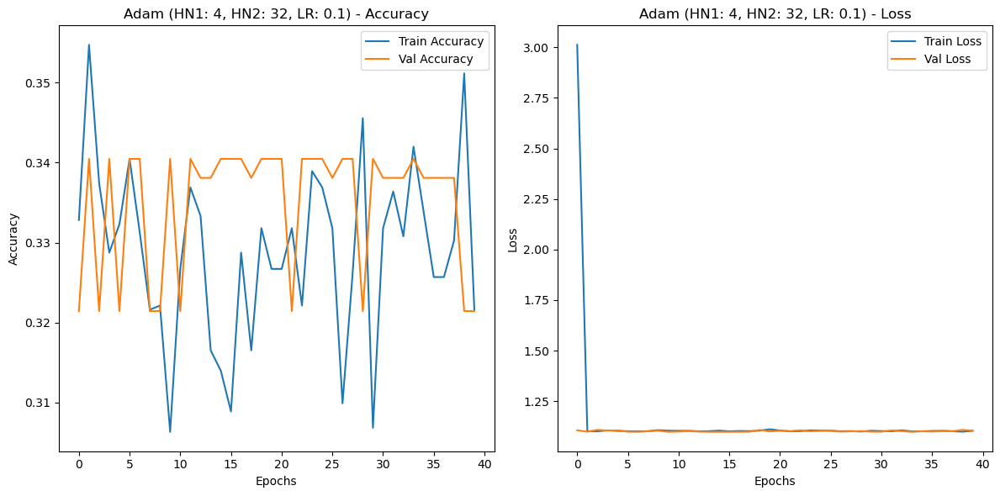


[INFO] Training RProp optimizer with 4 first hidden neurons, 32 second hidden neurons, and 0.1 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3432 - loss: 460.7697 - val_accuracy: 0.3452 - val_loss: 1.3124
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3483 - loss: 1.2485 - val_accuracy: 0.3500 - val_loss: 1.3164
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3407 - loss: 1.1426 - val_accuracy: 0.3500 - val_loss: 1.3048
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3428 - loss: 1.3002 - val_accuracy: 0.3500 - val_loss: 1.2822
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 58ms/step - accuracy: 0.3546 - loss: 1.4166 - val_accuracy: 0.3500 - val_loss: 1.2666
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 55ms/step - accuracy: 0.3344 - loss: 1.1482 - val_accuracy: 0.3500 - val_loss: 1.2692
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3342 - loss: 1.4928 - val_accuracy: 0.3500 - val_loss: 1.254

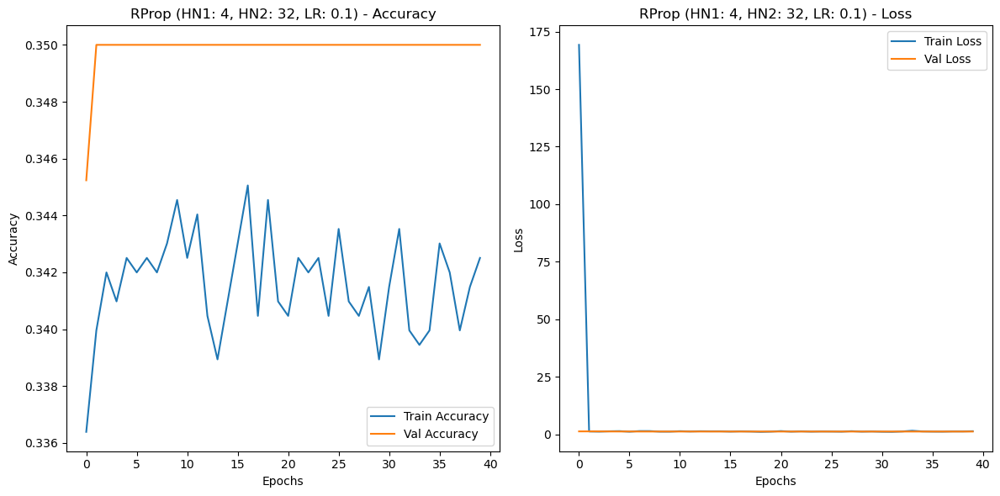


[INFO] Training Adam optimizer with 4 first hidden neurons, 64 second hidden neurons, and 0.0001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 71ms/step - accuracy: 0.3498 - loss: 3178.4277 - val_accuracy: 0.3405 - val_loss: 2164.2119
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3408 - loss: 2910.3994 - val_accuracy: 0.3405 - val_loss: 1808.6161
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3534 - loss: 2791.1665 - val_accuracy: 0.3405 - val_loss: 1543.9174
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - accuracy: 0.3192 - loss: 2617.9717 - val_accuracy: 0.3405 - val_loss: 1302.9214
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3431 - loss: 2379.4915 - val_accuracy: 0.3405 - val_loss: 1088.1239
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - accuracy: 0.3613 - loss: 2237.8301 - val_accuracy: 0.3405 - val_loss: 919.4194
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3447 - loss: 2114.5554 - 

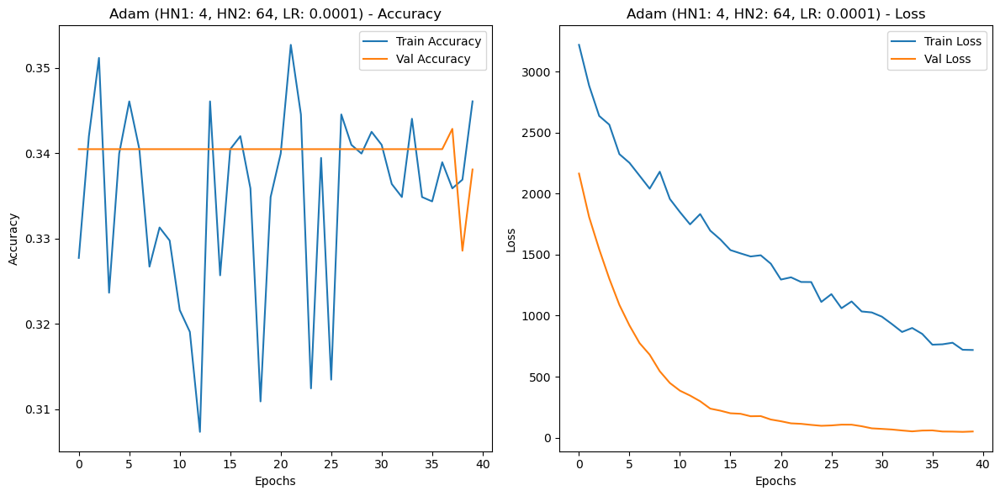


[INFO] Training RProp optimizer with 4 first hidden neurons, 64 second hidden neurons, and 0.0001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 49ms/step - accuracy: 0.3228 - loss: 6981.2568 - val_accuracy: 0.3381 - val_loss: 2816.3882
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3075 - loss: 4494.5005 - val_accuracy: 0.3071 - val_loss: 649.6609
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3143 - loss: 1625.7067 - val_accuracy: 0.3405 - val_loss: 69.8679
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3616 - loss: 40.1739 - val_accuracy: 0.3119 - val_loss: 5.7966
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3441 - loss: 7.5554 - val_accuracy: 0.3333 - val_loss: 4.8689
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3408 - loss: 4.4660 - val_accuracy: 0.3381 - val_loss: 2.5645
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3390 - loss: 4.1970 - val_accuracy: 0.3452 

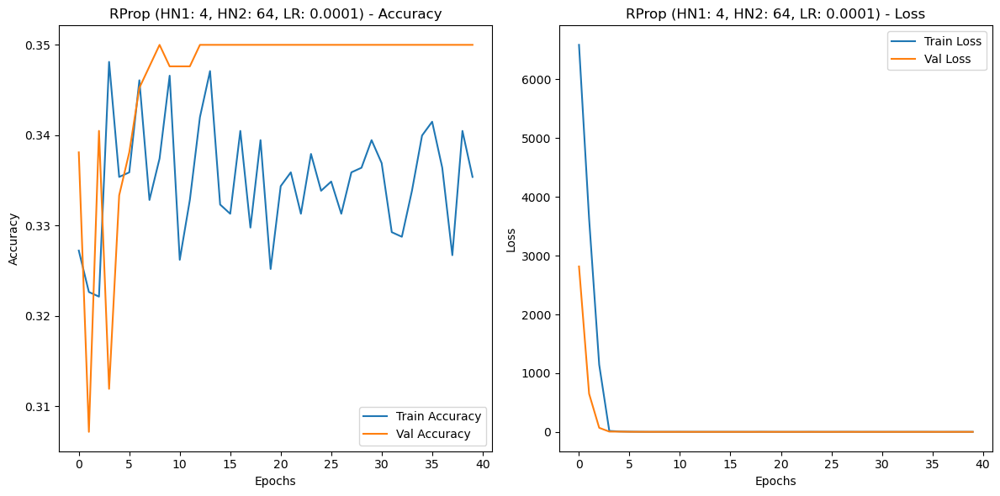


[INFO] Training Adam optimizer with 4 first hidden neurons, 64 second hidden neurons, and 0.001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 68ms/step - accuracy: 0.3177 - loss: 6760.6060 - val_accuracy: 0.3381 - val_loss: 1974.9449
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3583 - loss: 4303.7324 - val_accuracy: 0.3381 - val_loss: 904.1535
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - accuracy: 0.3263 - loss: 3423.0911 - val_accuracy: 0.3381 - val_loss: 687.5784
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3064 - loss: 2973.9187 - val_accuracy: 0.3381 - val_loss: 576.3890
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3457 - loss: 2122.8132 - val_accuracy: 0.3381 - val_loss: 306.2546
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3458 - loss: 1702.5582 - val_accuracy: 0.3167 - val_loss: 285.3603
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - accuracy: 0.3282 - loss: 1322.0533 - val_a

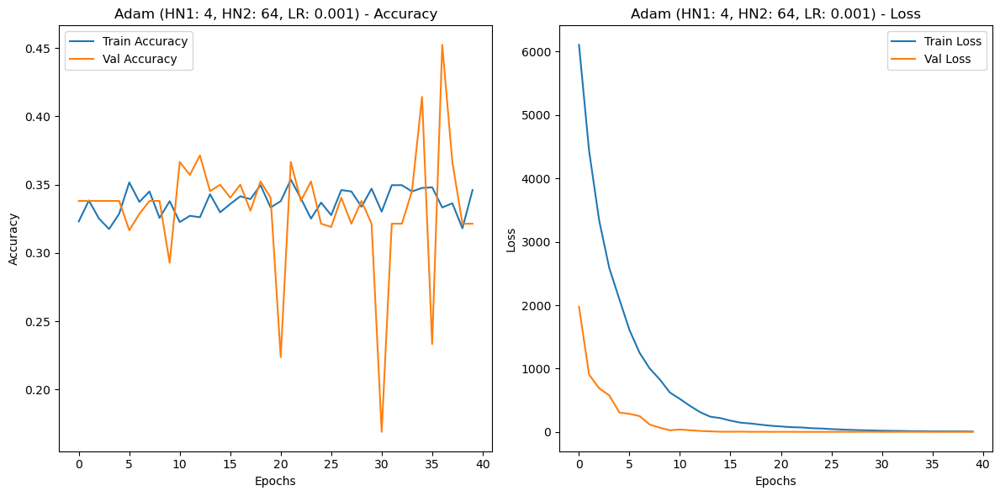


[INFO] Training RProp optimizer with 4 first hidden neurons, 64 second hidden neurons, and 0.001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3231 - loss: 1776.0067 - val_accuracy: 0.3405 - val_loss: 34.4022
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3322 - loss: 25.5275 - val_accuracy: 0.3405 - val_loss: 1.0933
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3279 - loss: 1.1683 - val_accuracy: 0.3405 - val_loss: 1.0933
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3401 - loss: 1.1388 - val_accuracy: 0.3405 - val_loss: 1.0959
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3268 - loss: 1.1028 - val_accuracy: 0.3405 - val_loss: 1.0959
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3487 - loss: 1.1031 - val_accuracy: 0.3405 - val_loss: 1.0959
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3348 - loss: 1.0985 - val_accuracy: 0.3405 - val_loss: 

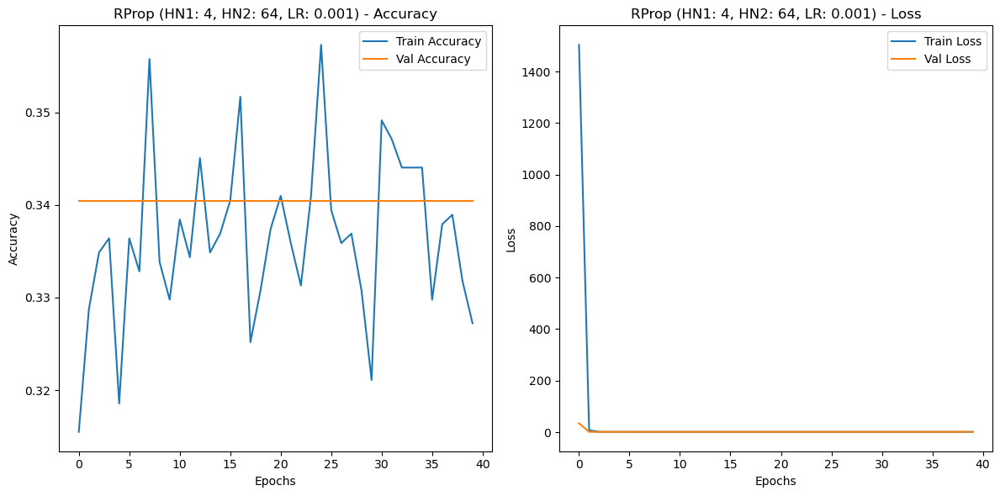


[INFO] Training Adam optimizer with 4 first hidden neurons, 64 second hidden neurons, and 0.01 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3241 - loss: 1567.1293 - val_accuracy: 0.3381 - val_loss: 35.2236
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3568 - loss: 69.7398 - val_accuracy: 0.3214 - val_loss: 1.1044
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3390 - loss: 1.0998 - val_accuracy: 0.3405 - val_loss: 1.0989
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3176 - loss: 1.0996 - val_accuracy: 0.3405 - val_loss: 1.0987
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3267 - loss: 1.0991 - val_accuracy: 0.3405 - val_loss: 1.0990
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3375 - loss: 1.0989 - val_accuracy: 0.3405 - val_loss: 1.0984
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3373 - loss: 1.0990 - val_accuracy: 0.3405 - val_loss: 1.

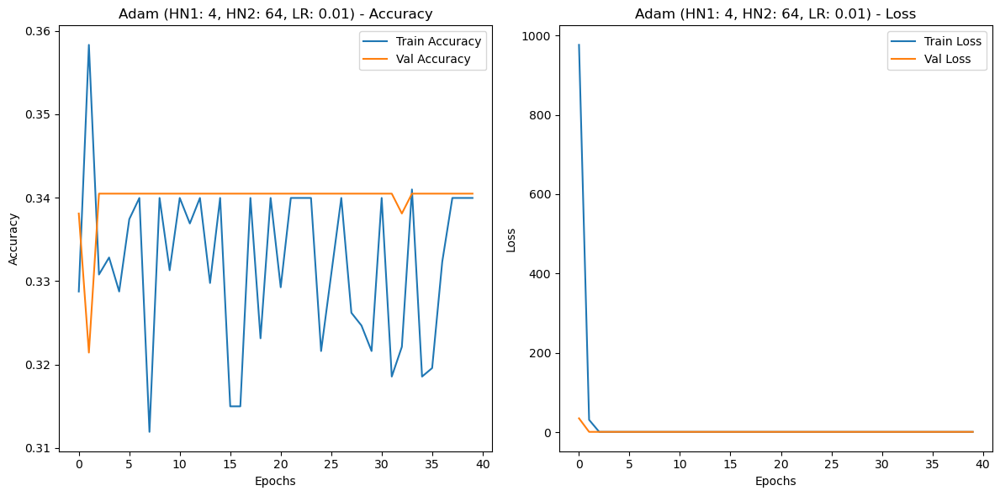


[INFO] Training RProp optimizer with 4 first hidden neurons, 64 second hidden neurons, and 0.01 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 51ms/step - accuracy: 0.3365 - loss: 2787.6484 - val_accuracy: 0.3381 - val_loss: 1.0986
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3270 - loss: 1.0987 - val_accuracy: 0.3381 - val_loss: 1.0986
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3314 - loss: 1.0987 - val_accuracy: 0.3381 - val_loss: 1.0986
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3177 - loss: 1.0987 - val_accuracy: 0.3381 - val_loss: 1.0986
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3320 - loss: 1.0986 - val_accuracy: 0.3381 - val_loss: 1.0986
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3238 - loss: 1.0987 - val_accuracy: 0.3381 - val_loss: 1.0986
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3322 - loss: 1.0986 - val_accuracy: 0.3381 - val_loss: 1.0

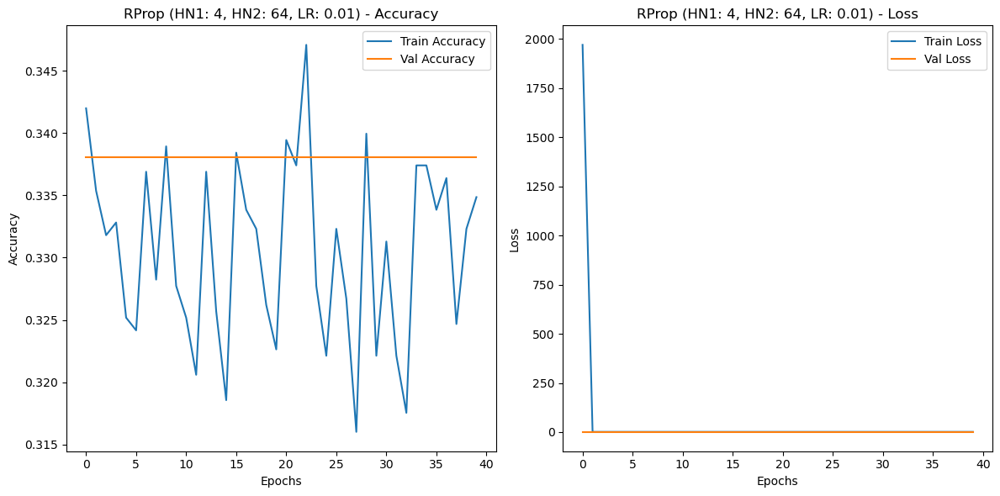


[INFO] Training Adam optimizer with 4 first hidden neurons, 64 second hidden neurons, and 0.1 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - accuracy: 0.3369 - loss: 608.0870 - val_accuracy: 0.3405 - val_loss: 1.0991
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3702 - loss: 1.0985 - val_accuracy: 0.3381 - val_loss: 1.1003
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3371 - loss: 1.1025 - val_accuracy: 0.3405 - val_loss: 1.0995
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - accuracy: 0.3263 - loss: 1.1028 - val_accuracy: 0.3405 - val_loss: 1.0995
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3274 - loss: 1.1015 - val_accuracy: 0.3405 - val_loss: 1.0984
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3174 - loss: 1.1030 - val_accuracy: 0.3381 - val_loss: 1.1065
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3001 - loss: 1.1094 - val_accuracy: 0.3381 - val_loss: 1.1022

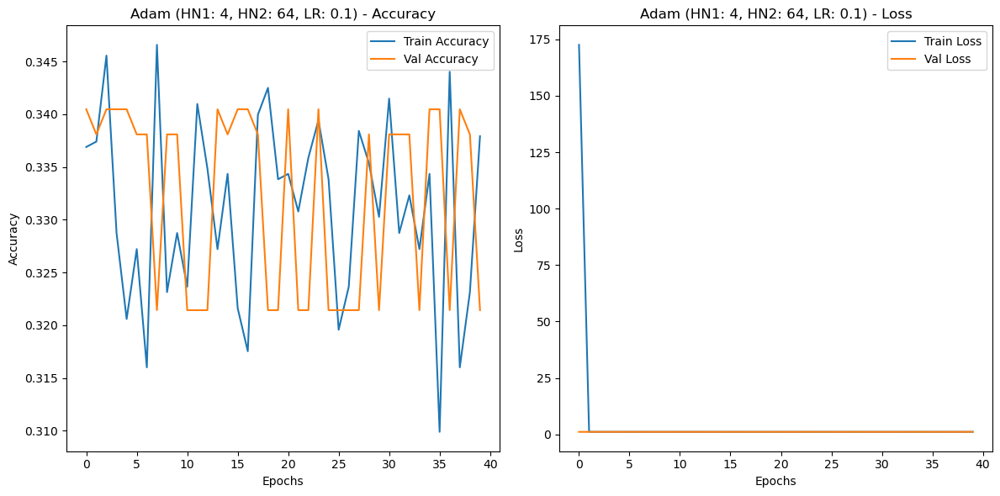


[INFO] Training RProp optimizer with 4 first hidden neurons, 64 second hidden neurons, and 0.1 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 48ms/step - accuracy: 0.3371 - loss: 1265.6521 - val_accuracy: 0.3381 - val_loss: 1.1000
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3266 - loss: 1.1011 - val_accuracy: 0.3381 - val_loss: 1.1000
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3298 - loss: 1.1005 - val_accuracy: 0.3381 - val_loss: 1.1000
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3166 - loss: 1.1003 - val_accuracy: 0.3381 - val_loss: 1.1000
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3294 - loss: 1.0998 - val_accuracy: 0.3381 - val_loss: 1.1000
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3068 - loss: 1.1010 - val_accuracy: 0.3381 - val_loss: 1.1000
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3451 - loss: 1.0996 - val_accuracy: 0.3381 - val_loss: 1.10

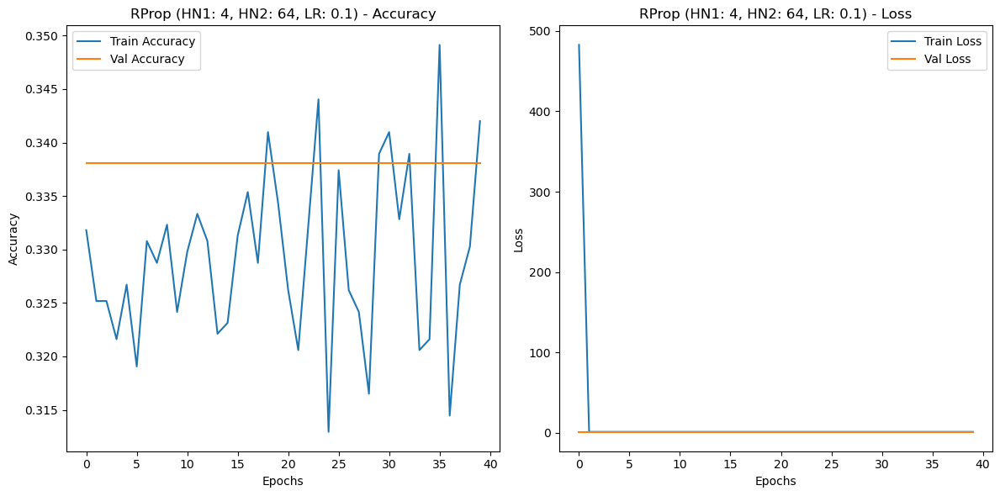


[INFO] Training Adam optimizer with 4 first hidden neurons, 128 second hidden neurons, and 0.0001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3318 - loss: 3871.2173 - val_accuracy: 0.3381 - val_loss: 1289.7664
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3095 - loss: 3332.7068 - val_accuracy: 0.3381 - val_loss: 902.7773
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3534 - loss: 3043.4656 - val_accuracy: 0.3381 - val_loss: 518.3461
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3049 - loss: 2906.2231 - val_accuracy: 0.3381 - val_loss: 381.4598
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3345 - loss: 2863.5715 - val_accuracy: 0.3381 - val_loss: 277.6227
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3338 - loss: 2550.8857 - val_accuracy: 0.3381 - val_loss: 199.0607
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3282 - loss: 2503.8345 - val

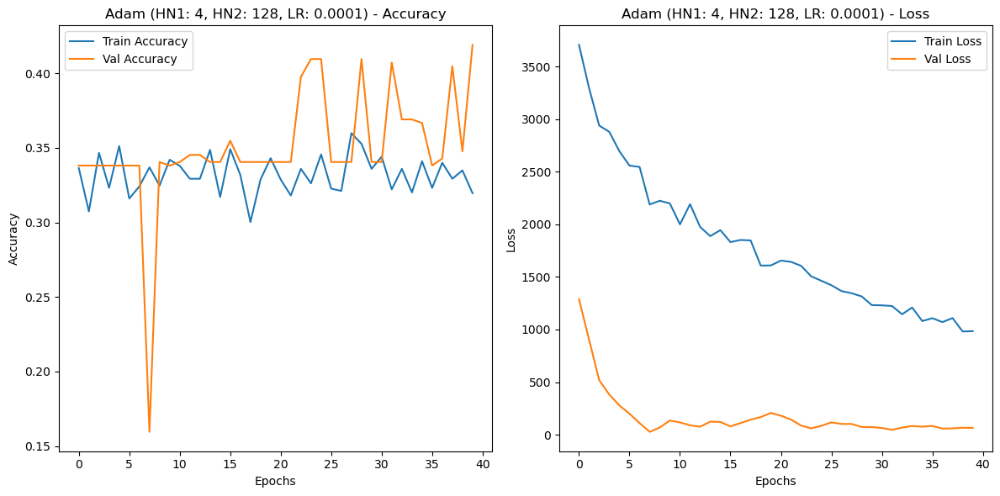


[INFO] Training RProp optimizer with 4 first hidden neurons, 128 second hidden neurons, and 0.0001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 49ms/step - accuracy: 0.3396 - loss: 2717.1262 - val_accuracy: 0.3381 - val_loss: 1173.0406
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3405 - loss: 1817.8564 - val_accuracy: 0.3405 - val_loss: 63.2667
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3395 - loss: 765.0427 - val_accuracy: 0.3405 - val_loss: 18.8650
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3458 - loss: 63.0163 - val_accuracy: 0.3405 - val_loss: 1.0977
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3203 - loss: 1.1719 - val_accuracy: 0.3405 - val_loss: 1.0977
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3236 - loss: 1.1170 - val_accuracy: 0.3405 - val_loss: 1.0977
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3283 - loss: 1.1220 - val_accuracy: 0.3405 -

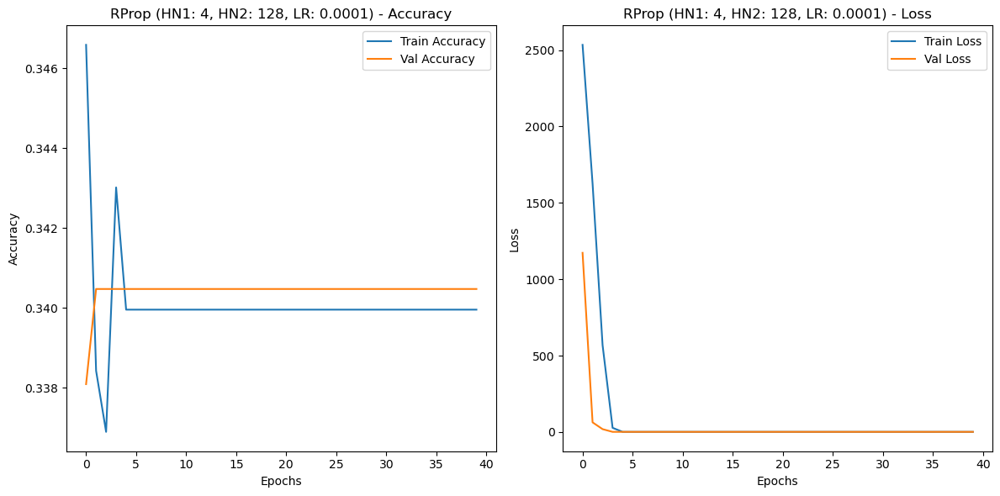


[INFO] Training Adam optimizer with 4 first hidden neurons, 128 second hidden neurons, and 0.001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 85ms/step - accuracy: 0.3209 - loss: 1.2053 - val_accuracy: 0.3405 - val_loss: 1.1017
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 80ms/step - accuracy: 0.3400 - loss: 1.0980 - val_accuracy: 0.3405 - val_loss: 1.1016
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 73ms/step - accuracy: 0.3526 - loss: 1.0985 - val_accuracy: 0.3405 - val_loss: 1.1063
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 80ms/step - accuracy: 0.3424 - loss: 1.1078 - val_accuracy: 0.3405 - val_loss: 1.0986
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 78ms/step - accuracy: 0.3386 - loss: 1.0981 - val_accuracy: 0.3405 - val_loss: 1.0986
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 82ms/step - accuracy: 0.3444 - loss: 1.0984 - val_accuracy: 0.3405 - val_loss: 1.0986
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3391 - loss: 1.1018 - val_accuracy: 0.3405 - val_loss: 1.098

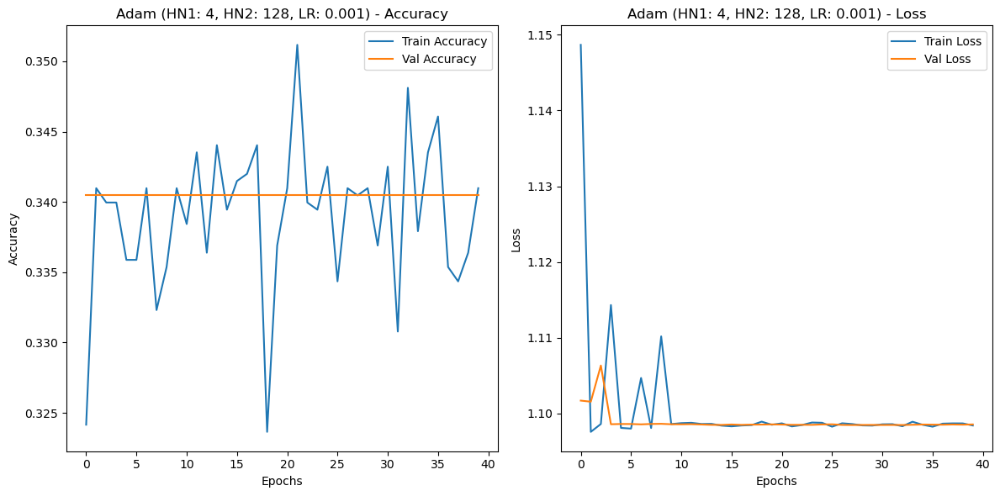


[INFO] Training RProp optimizer with 4 first hidden neurons, 128 second hidden neurons, and 0.001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 53ms/step - accuracy: 0.3547 - loss: 2074.7244 - val_accuracy: 0.3381 - val_loss: 65.6178
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3346 - loss: 350.6640 - val_accuracy: 0.3405 - val_loss: 1.0985
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3301 - loss: 1.0991 - val_accuracy: 0.3405 - val_loss: 1.0985
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3409 - loss: 1.0985 - val_accuracy: 0.3405 - val_loss: 1.0985
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3366 - loss: 1.0988 - val_accuracy: 0.3405 - val_loss: 1.0985
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3499 - loss: 1.0981 - val_accuracy: 0.3405 - val_loss: 1.0985
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3421 - loss: 1.0985 - val_accuracy: 0.3405 - val_loss

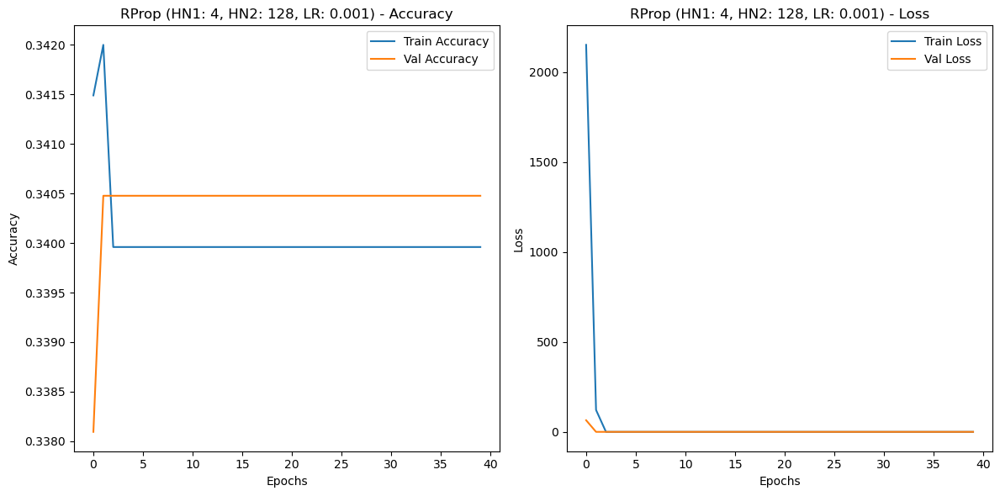


[INFO] Training Adam optimizer with 4 first hidden neurons, 128 second hidden neurons, and 0.01 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3391 - loss: 285.5264 - val_accuracy: 0.3381 - val_loss: 1.2024
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3369 - loss: 1.0972 - val_accuracy: 0.3214 - val_loss: 1.0988
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3192 - loss: 1.1009 - val_accuracy: 0.3405 - val_loss: 1.0986
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3156 - loss: 1.0998 - val_accuracy: 0.3405 - val_loss: 1.0986
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3343 - loss: 1.0983 - val_accuracy: 0.3214 - val_loss: 1.0989
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3475 - loss: 1.0981 - val_accuracy: 0.3405 - val_loss: 1.0984
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3176 - loss: 1.0995 - val_accuracy: 0.3214 - val_loss: 1.09

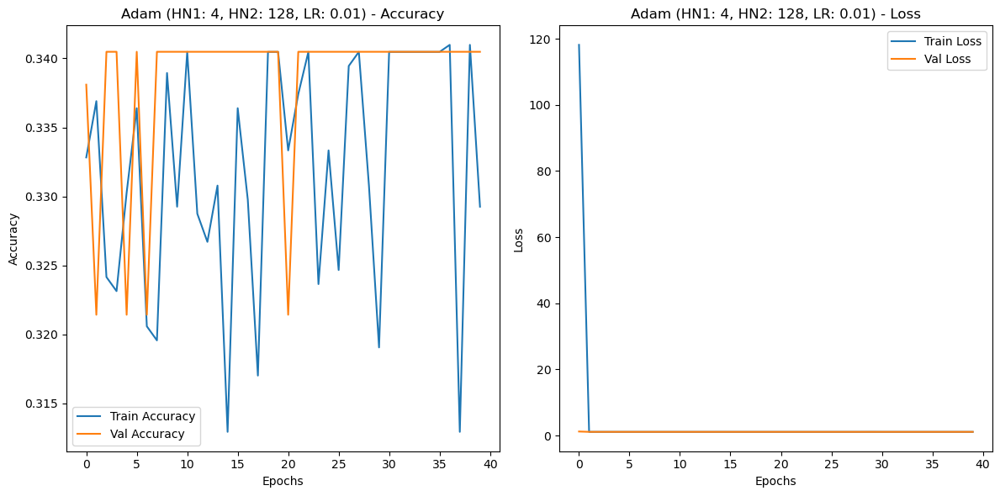


[INFO] Training RProp optimizer with 4 first hidden neurons, 128 second hidden neurons, and 0.01 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3238 - loss: 1.0986 - val_accuracy: 0.3405 - val_loss: 1.0986
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3295 - loss: 1.0986 - val_accuracy: 0.3405 - val_loss: 1.0986
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3392 - loss: 1.0986 - val_accuracy: 0.3405 - val_loss: 1.0986
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3507 - loss: 1.0986 - val_accuracy: 0.3405 - val_loss: 1.0986
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3435 - loss: 1.0986 - val_accuracy: 0.3405 - val_loss: 1.0986
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3349 - loss: 1.0986 - val_accuracy: 0.3405 - val_loss: 1.0986
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3397 - loss: 1.0986 - val_accuracy: 0.3405 - val_loss: 1.098

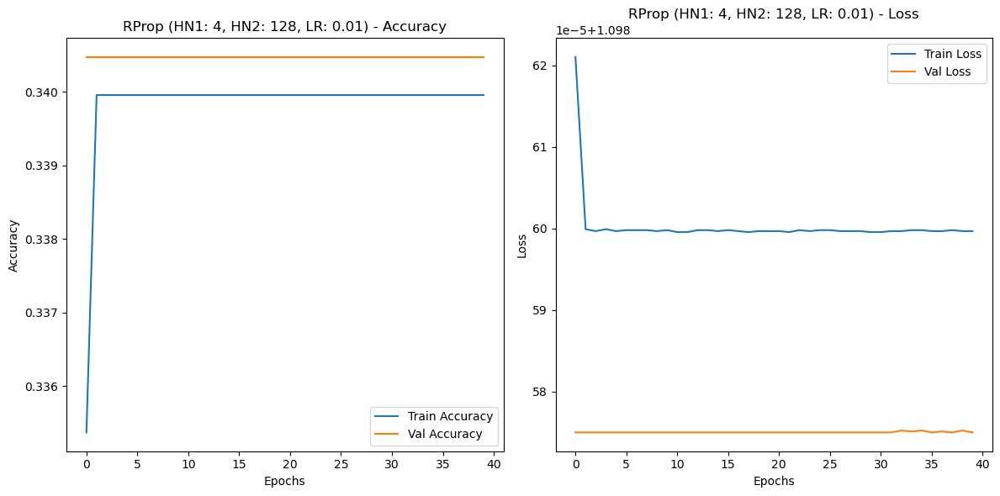


[INFO] Training Adam optimizer with 4 first hidden neurons, 128 second hidden neurons, and 0.1 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 78ms/step - accuracy: 0.3131 - loss: 655.6589 - val_accuracy: 0.3214 - val_loss: 1.1003
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 103ms/step - accuracy: 0.3294 - loss: 1.1012 - val_accuracy: 0.3405 - val_loss: 1.0984
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3545 - loss: 1.1016 - val_accuracy: 0.3405 - val_loss: 1.1005
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3333 - loss: 1.1018 - val_accuracy: 0.3214 - val_loss: 1.1007
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3055 - loss: 1.1025 - val_accuracy: 0.3405 - val_loss: 1.1072
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3242 - loss: 1.1144 - val_accuracy: 0.3405 - val_loss: 1.1041
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3597 - loss: 1.1017 - val_accuracy: 0.3405 - val_loss: 1.10

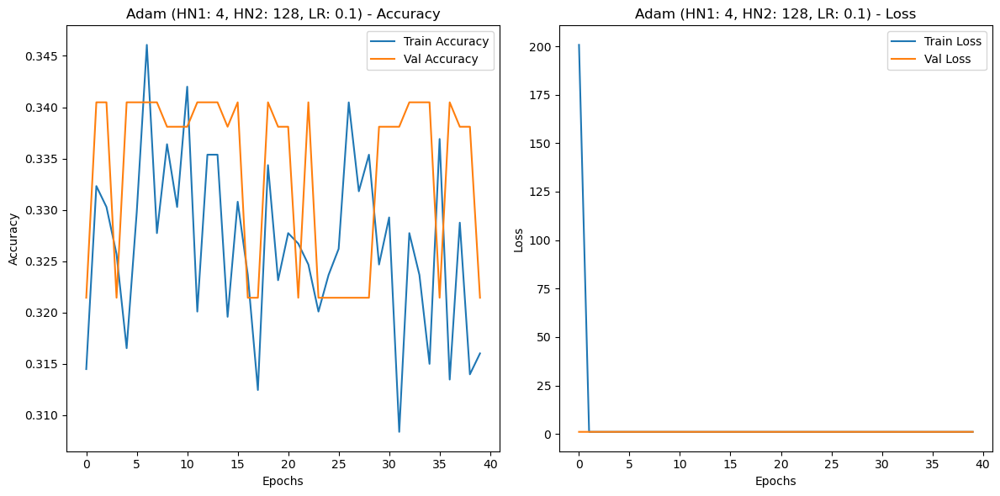


[INFO] Training RProp optimizer with 4 first hidden neurons, 128 second hidden neurons, and 0.1 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3439 - loss: 201.2068 - val_accuracy: 0.3214 - val_loss: 1.4604
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3335 - loss: 1.6538 - val_accuracy: 0.3214 - val_loss: 1.6894
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3341 - loss: 1.4449 - val_accuracy: 0.3214 - val_loss: 1.4674
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3505 - loss: 1.3535 - val_accuracy: 0.3214 - val_loss: 1.3652
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3266 - loss: 1.2932 - val_accuracy: 0.3214 - val_loss: 1.3368
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3203 - loss: 1.2419 - val_accuracy: 0.3214 - val_loss: 1.3623
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3341 - loss: 1.4642 - val_accuracy: 0.3214 - val_loss: 1.35

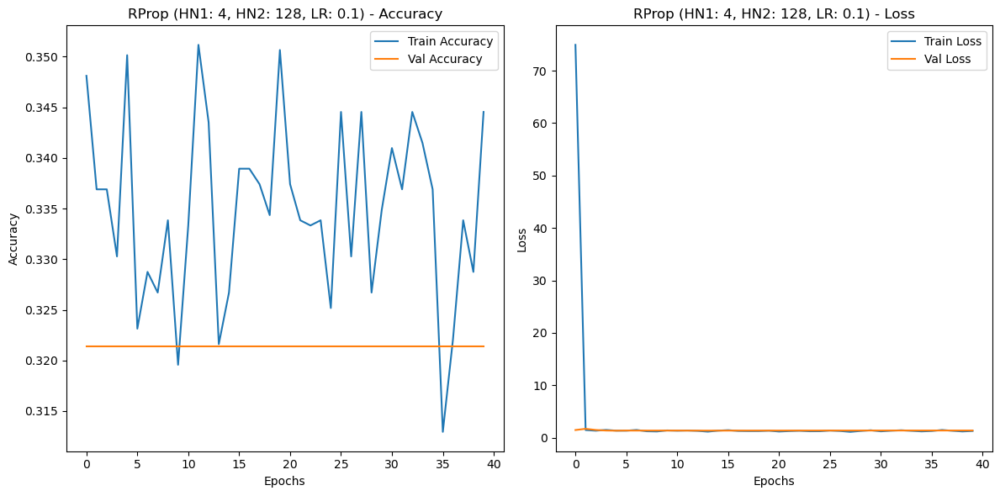


[INFO] Training Adam optimizer with 8 first hidden neurons, 4 second hidden neurons, and 0.0001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3046 - loss: 9304.4873 - val_accuracy: 0.3381 - val_loss: 5639.6899
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3383 - loss: 7589.3433 - val_accuracy: 0.3381 - val_loss: 5455.1284
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3306 - loss: 7880.4199 - val_accuracy: 0.3381 - val_loss: 5250.8481
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3519 - loss: 7983.7637 - val_accuracy: 0.3381 - val_loss: 5051.4482
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3310 - loss: 7877.6758 - val_accuracy: 0.3381 - val_loss: 4863.7651
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3400 - loss: 7071.2163 - val_accuracy: 0.3381 - val_loss: 4691.7832
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3261 - loss: 7129.5850 - 

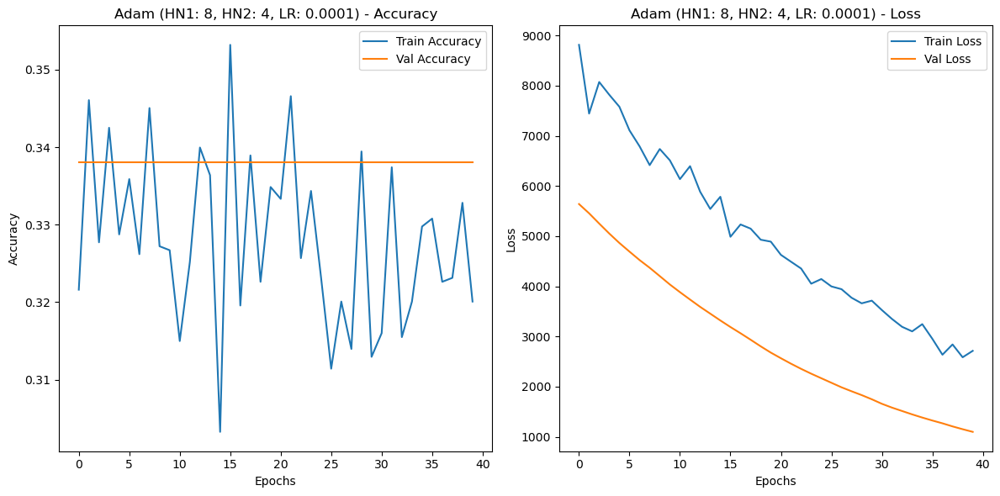


[INFO] Training RProp optimizer with 8 first hidden neurons, 4 second hidden neurons, and 0.0001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3211 - loss: 223.8107 - val_accuracy: 0.1952 - val_loss: 89.0393
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3120 - loss: 33.0120 - val_accuracy: 0.3405 - val_loss: 1.2958
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3316 - loss: 1.0986 - val_accuracy: 0.3405 - val_loss: 1.2958
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3622 - loss: 1.0980 - val_accuracy: 0.3405 - val_loss: 1.2958
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3496 - loss: 1.0984 - val_accuracy: 0.3405 - val_loss: 1.2955
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3521 - loss: 1.0987 - val_accuracy: 0.3405 - val_loss: 1.2955
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3464 - loss: 1.0989 - val_accuracy: 0.3405 - val_loss: 1

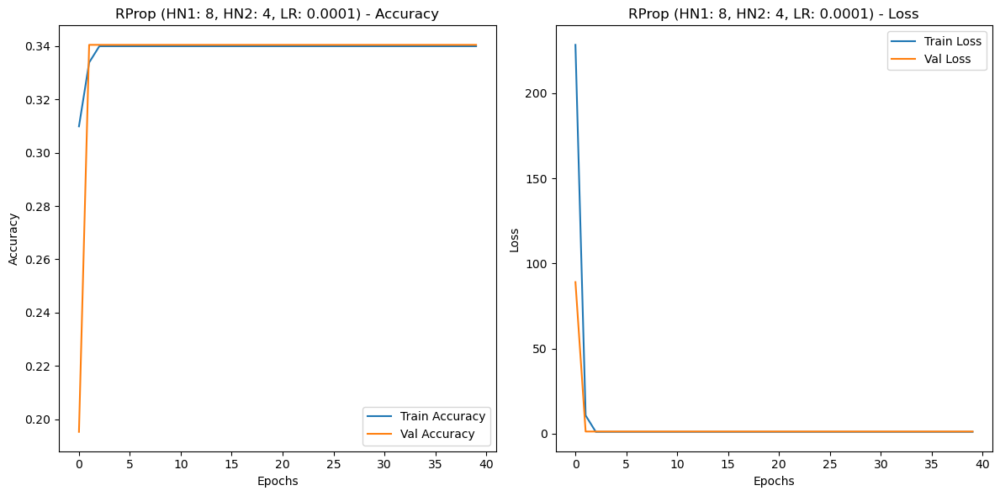


[INFO] Training Adam optimizer with 8 first hidden neurons, 4 second hidden neurons, and 0.001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3331 - loss: 9802.3223 - val_accuracy: 0.3381 - val_loss: 3468.2271
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3303 - loss: 7171.9497 - val_accuracy: 0.3381 - val_loss: 1745.2546
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3276 - loss: 6081.4419 - val_accuracy: 0.3381 - val_loss: 1057.9067
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3185 - loss: 4101.3032 - val_accuracy: 0.3214 - val_loss: 780.2697
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3027 - loss: 3618.3838 - val_accuracy: 0.3214 - val_loss: 623.6781
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3286 - loss: 2398.8706 - val_accuracy: 0.3238 - val_loss: 451.7207
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3282 - loss: 1467.1548 - val_

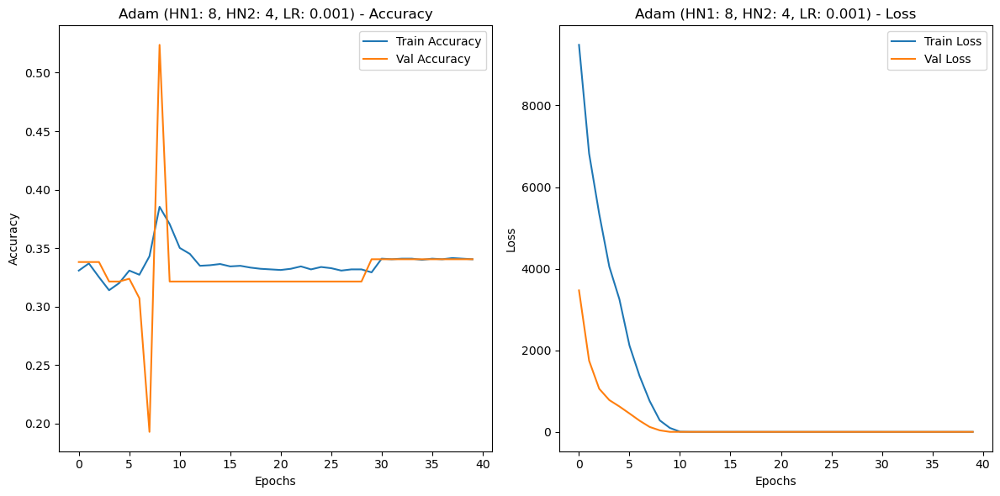


[INFO] Training RProp optimizer with 8 first hidden neurons, 4 second hidden neurons, and 0.001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3199 - loss: 5558.7593 - val_accuracy: 0.3381 - val_loss: 547.1177
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3494 - loss: 462.0431 - val_accuracy: 0.3810 - val_loss: 2.7189
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3824 - loss: 1.9981 - val_accuracy: 0.3810 - val_loss: 2.3696
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3482 - loss: 1.4999 - val_accuracy: 0.3810 - val_loss: 2.3670
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3549 - loss: 1.6406 - val_accuracy: 0.3810 - val_loss: 2.3626
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3641 - loss: 1.4395 - val_accuracy: 0.3810 - val_loss: 2.3627
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3564 - loss: 2.1114 - val_accuracy: 0.3810 - val_loss:

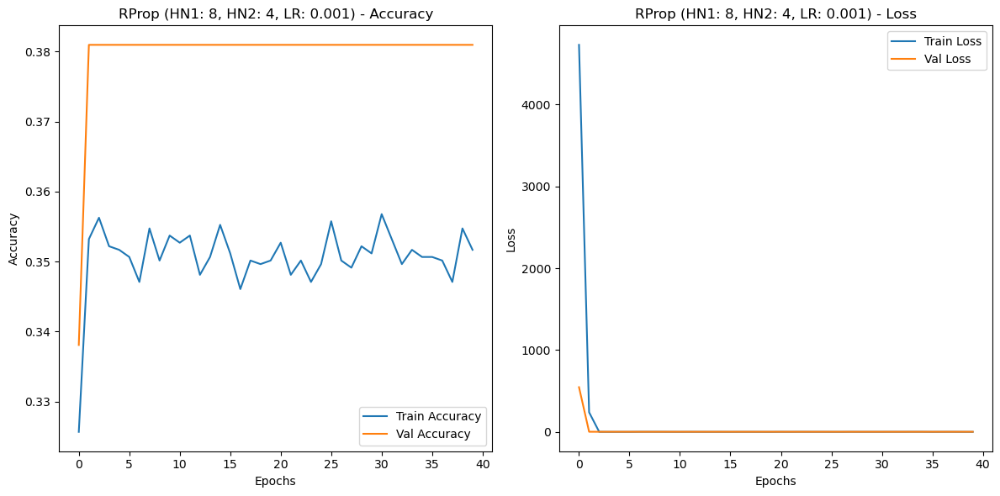


[INFO] Training Adam optimizer with 8 first hidden neurons, 4 second hidden neurons, and 0.01 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3174 - loss: 3113.2344 - val_accuracy: 0.3214 - val_loss: 121.9528
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3376 - loss: 61.1089 - val_accuracy: 0.3405 - val_loss: 1.1038
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3474 - loss: 1.5507 - val_accuracy: 0.3405 - val_loss: 1.0994
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3474 - loss: 1.5239 - val_accuracy: 0.3405 - val_loss: 1.0988
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 58ms/step - accuracy: 0.3533 - loss: 1.5526 - val_accuracy: 0.3405 - val_loss: 1.0988
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3387 - loss: 1.3913 - val_accuracy: 0.3405 - val_loss: 1.0991
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3149 - loss: 1.5006 - val_accuracy: 0.3214 - val_loss: 1.

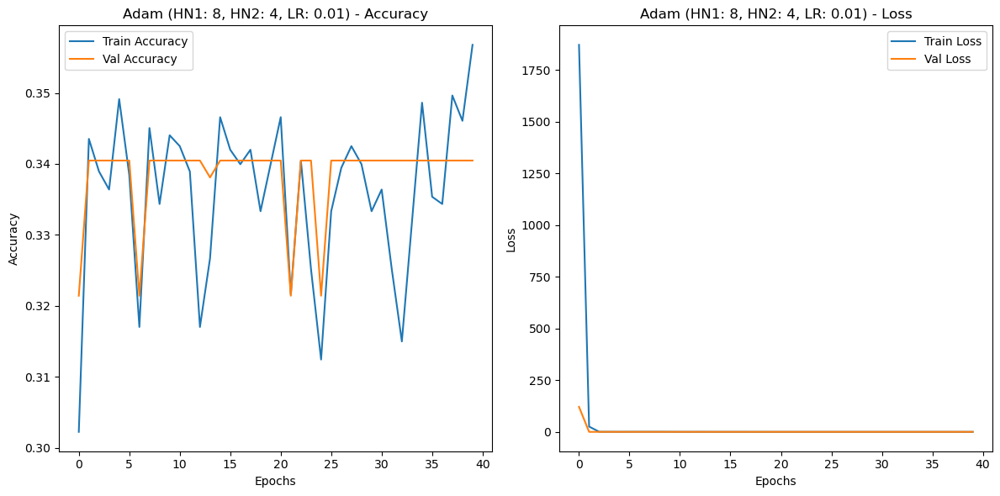


[INFO] Training RProp optimizer with 8 first hidden neurons, 4 second hidden neurons, and 0.01 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 48ms/step - accuracy: 0.3333 - loss: 7174.0801 - val_accuracy: 0.3381 - val_loss: 1.1661
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3222 - loss: 71.8339 - val_accuracy: 0.3381 - val_loss: 1.1002
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3132 - loss: 1.1024 - val_accuracy: 0.3381 - val_loss: 1.1002
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3143 - loss: 1.1025 - val_accuracy: 0.3381 - val_loss: 1.1002
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3119 - loss: 1.1025 - val_accuracy: 0.3381 - val_loss: 1.1002
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 40ms/step - accuracy: 0.3155 - loss: 1.1018 - val_accuracy: 0.3381 - val_loss: 1.1002
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 40ms/step - accuracy: 0.3283 - loss: 1.1014 - val_accuracy: 0.3381 - val_loss: 1.1

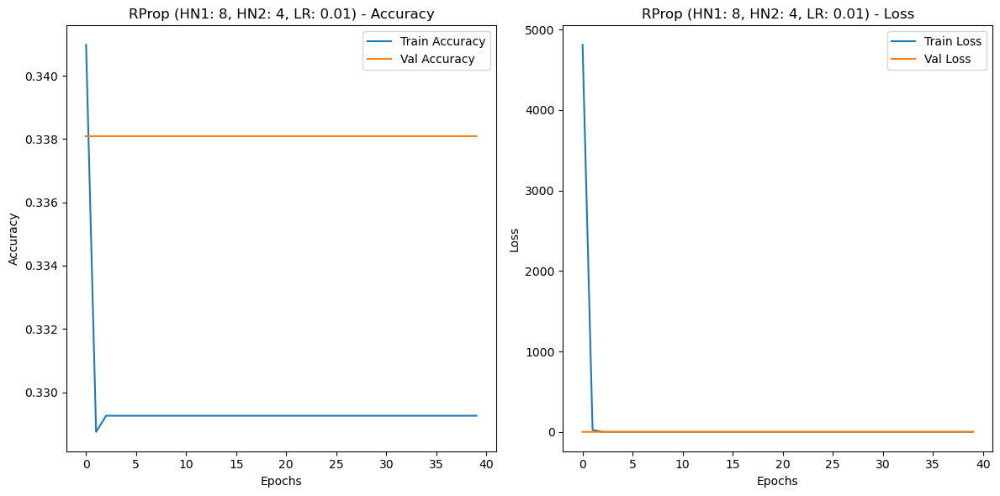


[INFO] Training Adam optimizer with 8 first hidden neurons, 4 second hidden neurons, and 0.1 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3240 - loss: 2817.6243 - val_accuracy: 0.3405 - val_loss: 1.1012
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3324 - loss: 1.1060 - val_accuracy: 0.3405 - val_loss: 1.1015
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3478 - loss: 1.0999 - val_accuracy: 0.3381 - val_loss: 1.0995
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 58ms/step - accuracy: 0.3186 - loss: 1.1010 - val_accuracy: 0.3381 - val_loss: 1.1007
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3305 - loss: 1.1010 - val_accuracy: 0.3381 - val_loss: 1.0988
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3096 - loss: 1.1022 - val_accuracy: 0.3405 - val_loss: 1.0996
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 58ms/step - accuracy: 0.3275 - loss: 1.1071 - val_accuracy: 0.3405 - val_loss: 1.0992

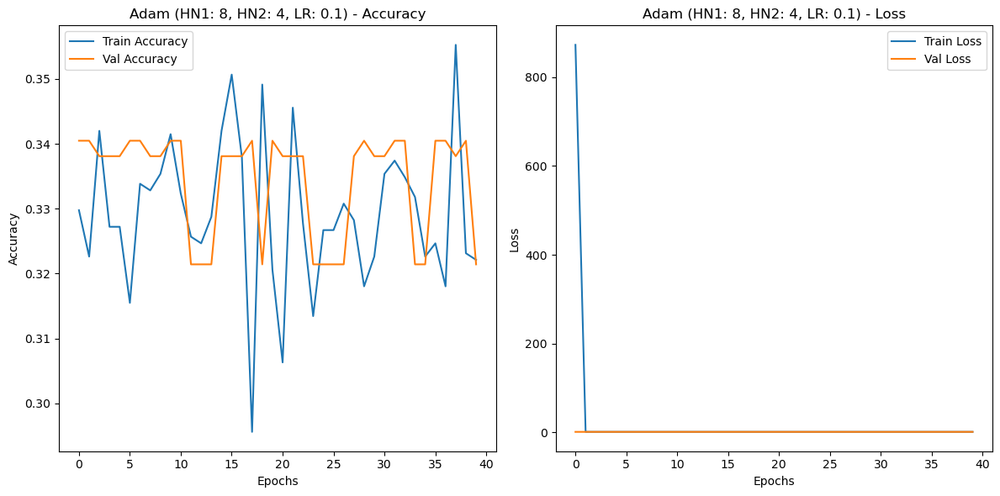


[INFO] Training RProp optimizer with 8 first hidden neurons, 4 second hidden neurons, and 0.1 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 56ms/step - accuracy: 0.3373 - loss: 4610.7700 - val_accuracy: 0.3214 - val_loss: 1.1060
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 50ms/step - accuracy: 0.3337 - loss: 1.3766 - val_accuracy: 0.3214 - val_loss: 1.1057
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3352 - loss: 1.1027 - val_accuracy: 0.3214 - val_loss: 1.1057
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3153 - loss: 1.1937 - val_accuracy: 0.3214 - val_loss: 1.1057
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3267 - loss: 1.1042 - val_accuracy: 0.3214 - val_loss: 1.1057
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3374 - loss: 1.1195 - val_accuracy: 0.3214 - val_loss: 1.1057
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3281 - loss: 1.1102 - val_accuracy: 0.3214 - val_loss: 1.105

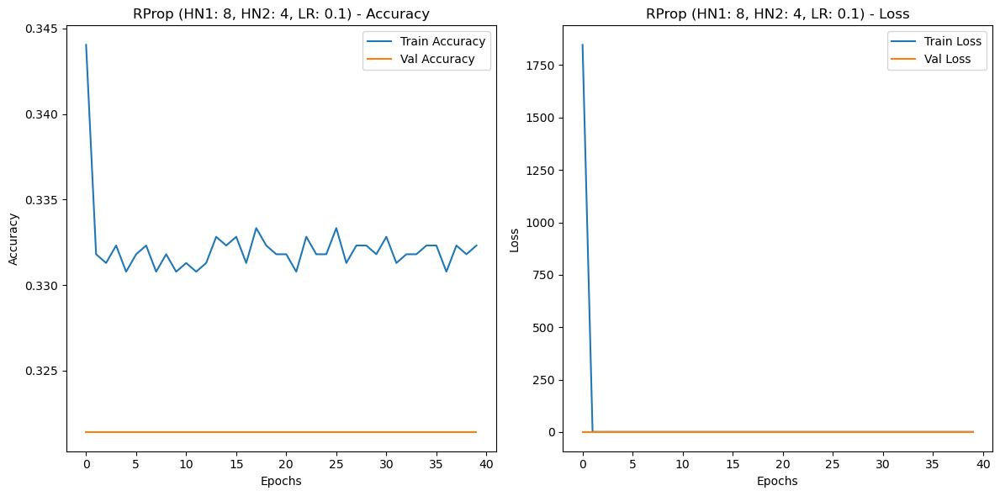


[INFO] Training Adam optimizer with 8 first hidden neurons, 8 second hidden neurons, and 0.0001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3314 - loss: 8208.6504 - val_accuracy: 0.3381 - val_loss: 2443.2961
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3309 - loss: 7231.0049 - val_accuracy: 0.3381 - val_loss: 2320.3320
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 58ms/step - accuracy: 0.3412 - loss: 6640.0435 - val_accuracy: 0.3381 - val_loss: 2175.0969
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3232 - loss: 6677.8433 - val_accuracy: 0.3381 - val_loss: 2039.3723
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3082 - loss: 6273.7803 - val_accuracy: 0.3381 - val_loss: 1924.4126
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3187 - loss: 6162.5122 - val_accuracy: 0.3381 - val_loss: 1833.1560
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3316 - loss: 6250.3130 - 

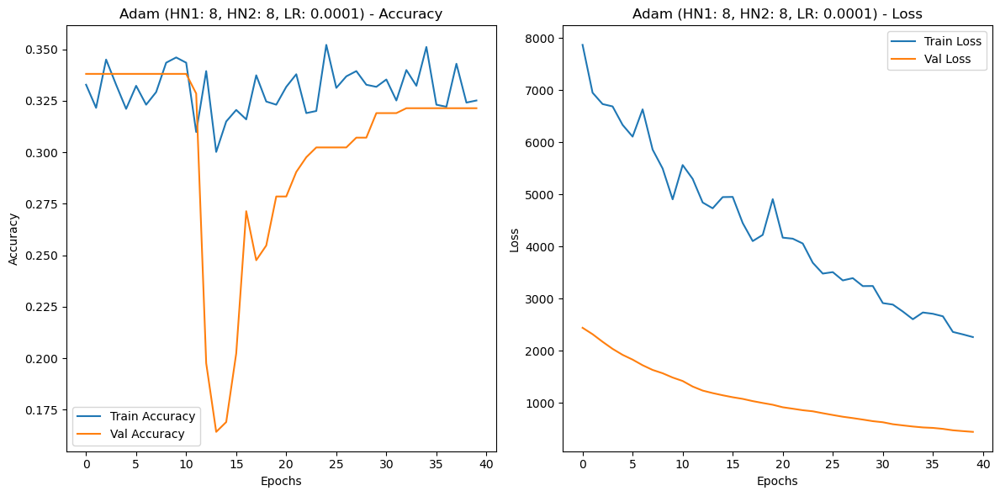


[INFO] Training RProp optimizer with 8 first hidden neurons, 8 second hidden neurons, and 0.0001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3177 - loss: 11291.7031 - val_accuracy: 0.3405 - val_loss: 1407.1058
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 40ms/step - accuracy: 0.3211 - loss: 6747.2710 - val_accuracy: 0.3381 - val_loss: 1.1066
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 40ms/step - accuracy: 0.3381 - loss: 2300.0559 - val_accuracy: 0.3381 - val_loss: 1.1070
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 40ms/step - accuracy: 0.3276 - loss: 1344.6271 - val_accuracy: 0.3381 - val_loss: 1.1067
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3432 - loss: 350.8540 - val_accuracy: 0.3381 - val_loss: 1.1062
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 40ms/step - accuracy: 0.3445 - loss: 140.5150 - val_accuracy: 0.3381 - val_loss: 1.1061
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 40ms/step - accuracy: 0.3246 - loss: 57.2739 - val_accuracy: 0.3

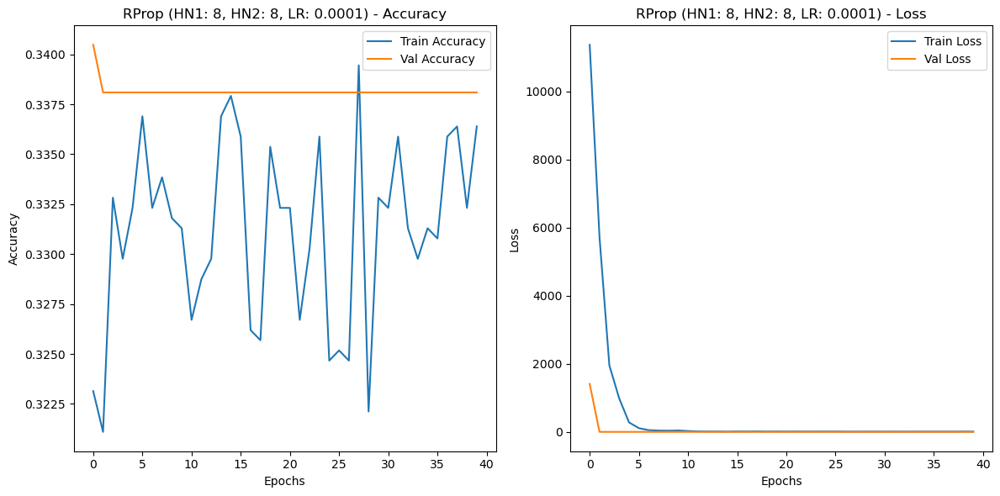


[INFO] Training Adam optimizer with 8 first hidden neurons, 8 second hidden neurons, and 0.001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3291 - loss: 3170.0615 - val_accuracy: 0.3214 - val_loss: 1177.4108
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3329 - loss: 1942.4238 - val_accuracy: 0.3095 - val_loss: 787.9522
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3393 - loss: 1112.5386 - val_accuracy: 0.2976 - val_loss: 508.1772
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3650 - loss: 741.2206 - val_accuracy: 0.3000 - val_loss: 362.0794
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3446 - loss: 507.8405 - val_accuracy: 0.3167 - val_loss: 266.3354
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3133 - loss: 312.6478 - val_accuracy: 0.3619 - val_loss: 140.3557
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3352 - loss: 166.5312 - val_accura

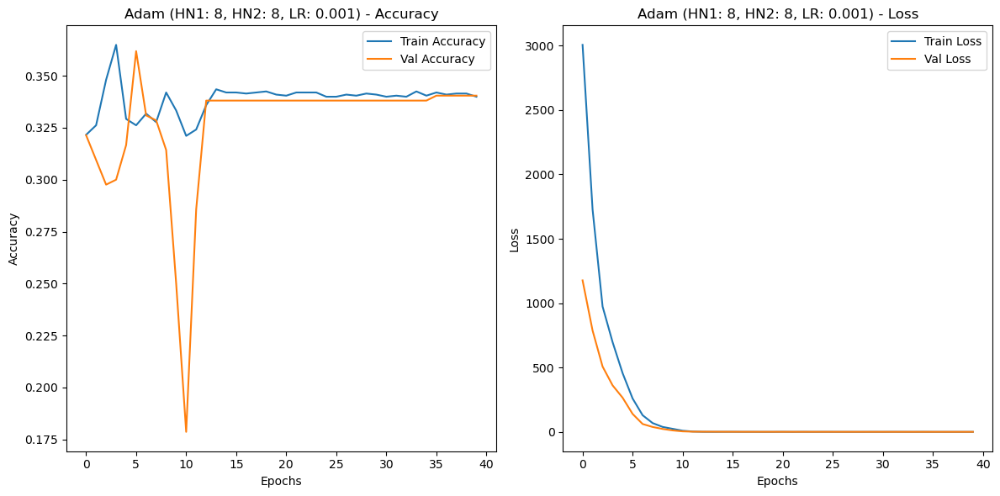


[INFO] Training RProp optimizer with 8 first hidden neurons, 8 second hidden neurons, and 0.001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3258 - loss: 1348.5344 - val_accuracy: 0.2167 - val_loss: 3.8067
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.2958 - loss: 85.5348 - val_accuracy: 0.3190 - val_loss: 1.2063
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3301 - loss: 26.8898 - val_accuracy: 0.3214 - val_loss: 1.1290
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3461 - loss: 7.4131 - val_accuracy: 0.3214 - val_loss: 1.1105
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3438 - loss: 6.4843 - val_accuracy: 0.3214 - val_loss: 1.1017
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3250 - loss: 2.0524 - val_accuracy: 0.3214 - val_loss: 1.1021
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3141 - loss: 1.3862 - val_accuracy: 0.3214 - val_loss: 1

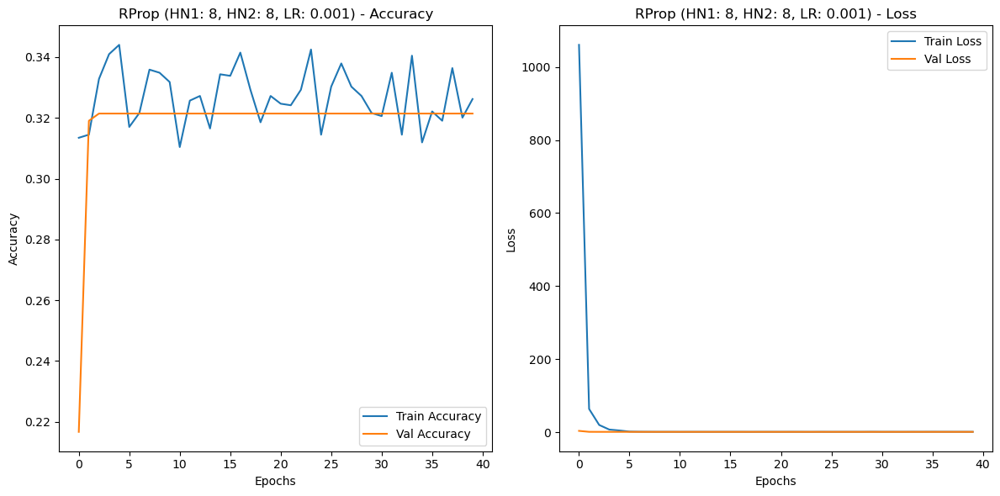


[INFO] Training Adam optimizer with 8 first hidden neurons, 8 second hidden neurons, and 0.01 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3050 - loss: 11699.3965 - val_accuracy: 0.3595 - val_loss: 72.1486
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3455 - loss: 736.3878 - val_accuracy: 0.3381 - val_loss: 1.1026
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3319 - loss: 99.2843 - val_accuracy: 0.3405 - val_loss: 1.0986
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3182 - loss: 44.5728 - val_accuracy: 0.3405 - val_loss: 1.0999
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3372 - loss: 16.8248 - val_accuracy: 0.3405 - val_loss: 1.0989
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3297 - loss: 6.8856 - val_accuracy: 0.3405 - val_loss: 1.0988
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3347 - loss: 3.5674 - val_accuracy: 0.3214 - val_loss

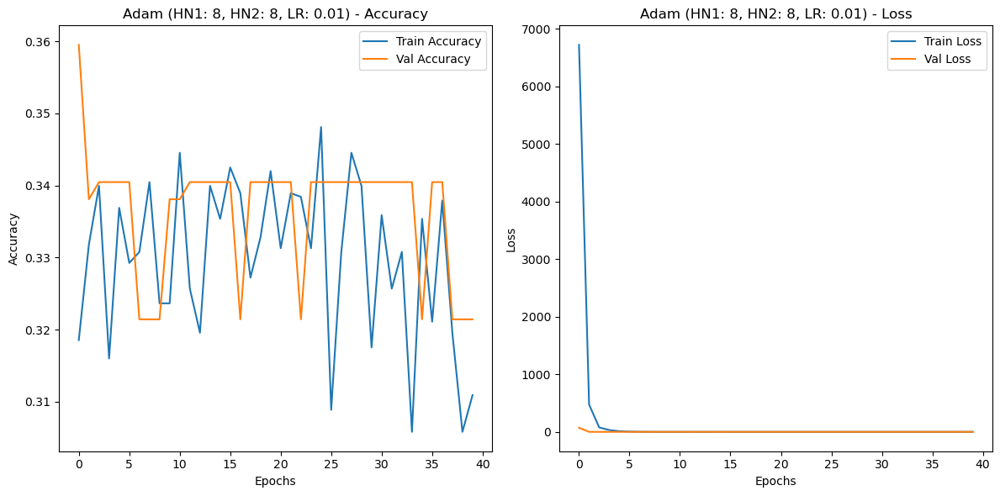


[INFO] Training RProp optimizer with 8 first hidden neurons, 8 second hidden neurons, and 0.01 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3336 - loss: 853.1154 - val_accuracy: 0.3381 - val_loss: 1.3758
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3294 - loss: 12.1004 - val_accuracy: 0.3381 - val_loss: 1.1052
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3095 - loss: 3.7691 - val_accuracy: 0.3381 - val_loss: 1.1036
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3366 - loss: 1.5394 - val_accuracy: 0.3381 - val_loss: 1.1035
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3262 - loss: 1.6364 - val_accuracy: 0.3381 - val_loss: 1.1037
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3074 - loss: 1.4425 - val_accuracy: 0.3381 - val_loss: 1.1038
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3098 - loss: 1.7690 - val_accuracy: 0.3381 - val_loss: 1.10

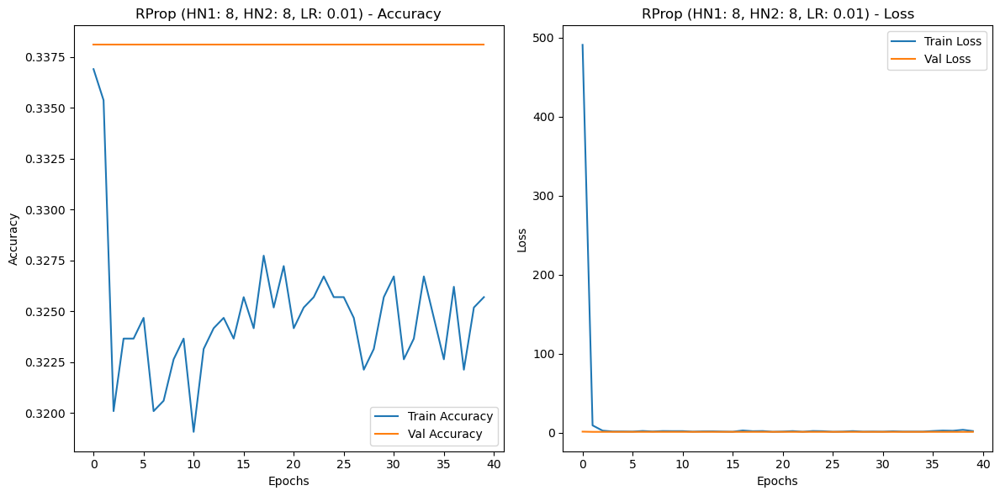


[INFO] Training Adam optimizer with 8 first hidden neurons, 8 second hidden neurons, and 0.1 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3408 - loss: 1705.1512 - val_accuracy: 0.3405 - val_loss: 1.1005
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3063 - loss: 1.1019 - val_accuracy: 0.3405 - val_loss: 1.0984
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3303 - loss: 1.1019 - val_accuracy: 0.3214 - val_loss: 1.1044
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3287 - loss: 1.1013 - val_accuracy: 0.3214 - val_loss: 1.1031
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3291 - loss: 1.1033 - val_accuracy: 0.3214 - val_loss: 1.1065
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3306 - loss: 1.1027 - val_accuracy: 0.3214 - val_loss: 1.1066
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3527 - loss: 1.0991 - val_accuracy: 0.3405 - val_loss: 1.1022

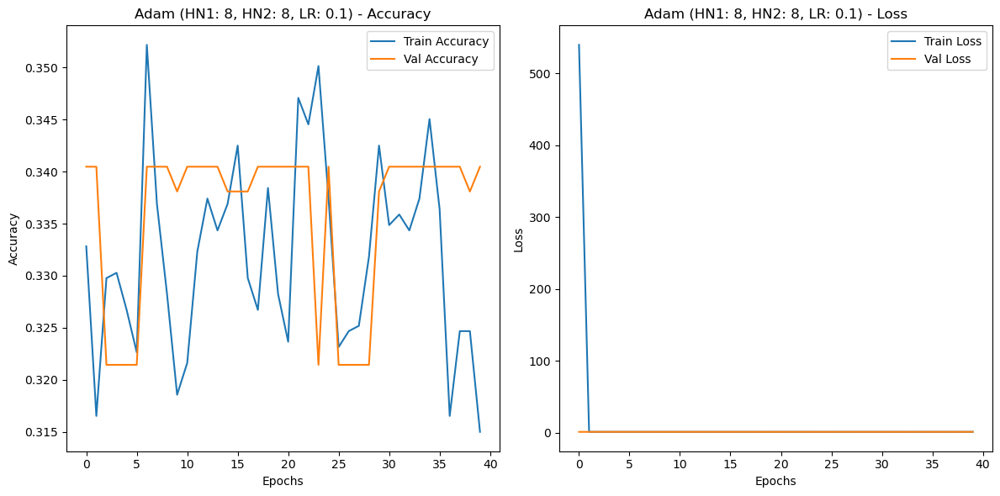


[INFO] Training RProp optimizer with 8 first hidden neurons, 8 second hidden neurons, and 0.1 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3382 - loss: 4193.9937 - val_accuracy: 0.3214 - val_loss: 1.1195
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 40ms/step - accuracy: 0.3171 - loss: 1.1080 - val_accuracy: 0.3214 - val_loss: 1.0994
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 40ms/step - accuracy: 0.3250 - loss: 1.1056 - val_accuracy: 0.3214 - val_loss: 1.0994
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3177 - loss: 1.0998 - val_accuracy: 0.3214 - val_loss: 1.0994
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3184 - loss: 1.0998 - val_accuracy: 0.3214 - val_loss: 1.0994
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3490 - loss: 1.0983 - val_accuracy: 0.3214 - val_loss: 1.0994
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 40ms/step - accuracy: 0.3298 - loss: 1.0989 - val_accuracy: 0.3214 - val_loss: 1.099

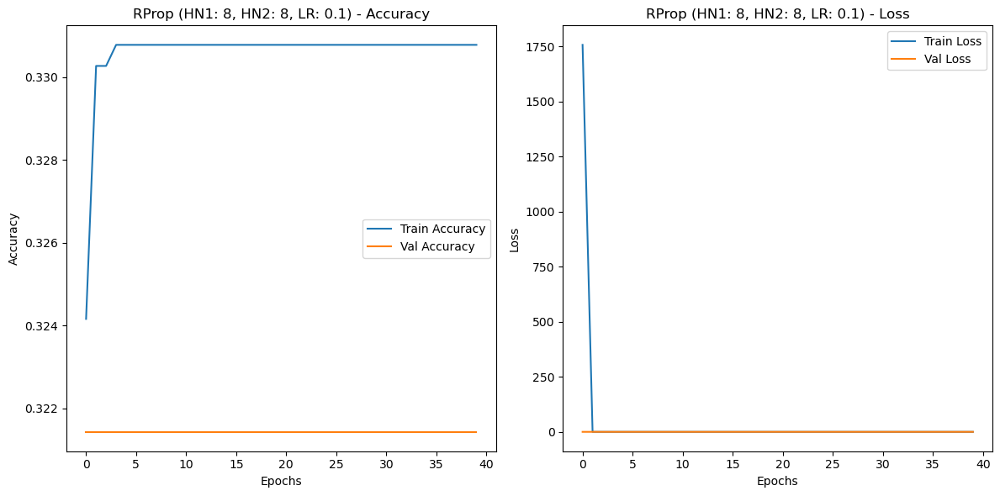


[INFO] Training Adam optimizer with 8 first hidden neurons, 16 second hidden neurons, and 0.0001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3559 - loss: 8144.6396 - val_accuracy: 0.3214 - val_loss: 5966.2266
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3541 - loss: 7669.9819 - val_accuracy: 0.3214 - val_loss: 5620.5581
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3277 - loss: 8051.0308 - val_accuracy: 0.3214 - val_loss: 5284.3428
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3311 - loss: 7283.8682 - val_accuracy: 0.3214 - val_loss: 4987.7036
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3605 - loss: 7286.1880 - val_accuracy: 0.3214 - val_loss: 4680.3574
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3393 - loss: 7050.6714 - val_accuracy: 0.3214 - val_loss: 4380.8848
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3237 - loss: 6935.8013 -

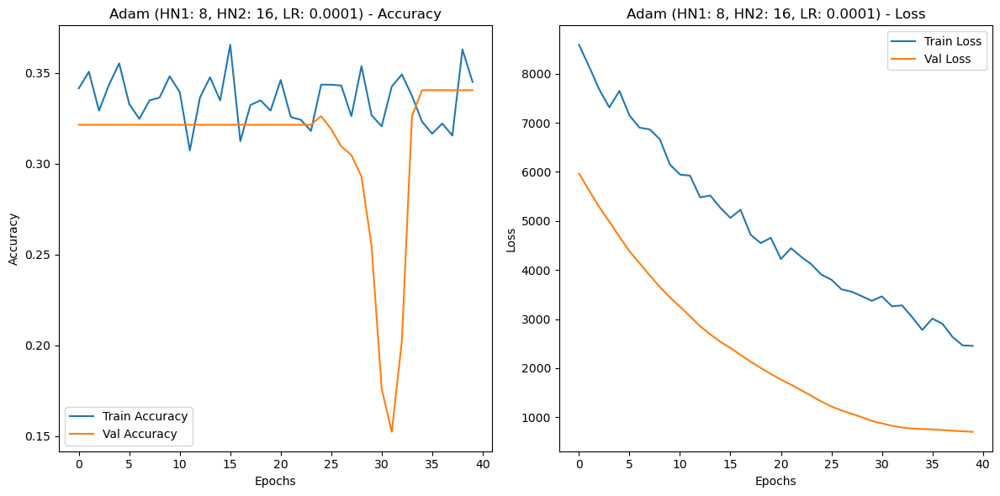


[INFO] Training RProp optimizer with 8 first hidden neurons, 16 second hidden neurons, and 0.0001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3518 - loss: 4084.0125 - val_accuracy: 0.3214 - val_loss: 975.9565
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3297 - loss: 2927.3870 - val_accuracy: 0.3381 - val_loss: 33.0007
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3626 - loss: 51.4871 - val_accuracy: 0.3810 - val_loss: 1.6327
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3446 - loss: 2.2971 - val_accuracy: 0.3595 - val_loss: 1.4173
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3430 - loss: 1.3862 - val_accuracy: 0.3405 - val_loss: 1.2676
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3448 - loss: 1.0986 - val_accuracy: 0.3452 - val_loss: 1.3066
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3339 - loss: 1.1175 - val_accuracy: 0.3381 - val_

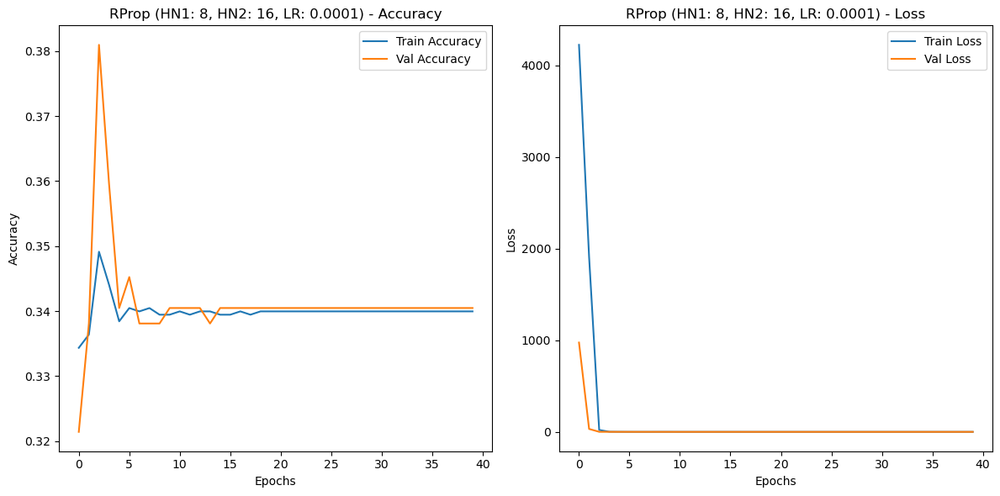


[INFO] Training Adam optimizer with 8 first hidden neurons, 16 second hidden neurons, and 0.001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3402 - loss: 6061.9521 - val_accuracy: 0.3381 - val_loss: 2230.1243
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 70ms/step - accuracy: 0.3437 - loss: 3855.4573 - val_accuracy: 0.3381 - val_loss: 1007.1073
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3246 - loss: 2701.1360 - val_accuracy: 0.3119 - val_loss: 243.8598
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3197 - loss: 1486.1565 - val_accuracy: 0.2119 - val_loss: 28.7568
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3069 - loss: 989.1730 - val_accuracy: 0.2881 - val_loss: 7.0406
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3141 - loss: 828.2720 - val_accuracy: 0.2690 - val_loss: 6.5050
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3083 - loss: 542.2232 - val_accuracy

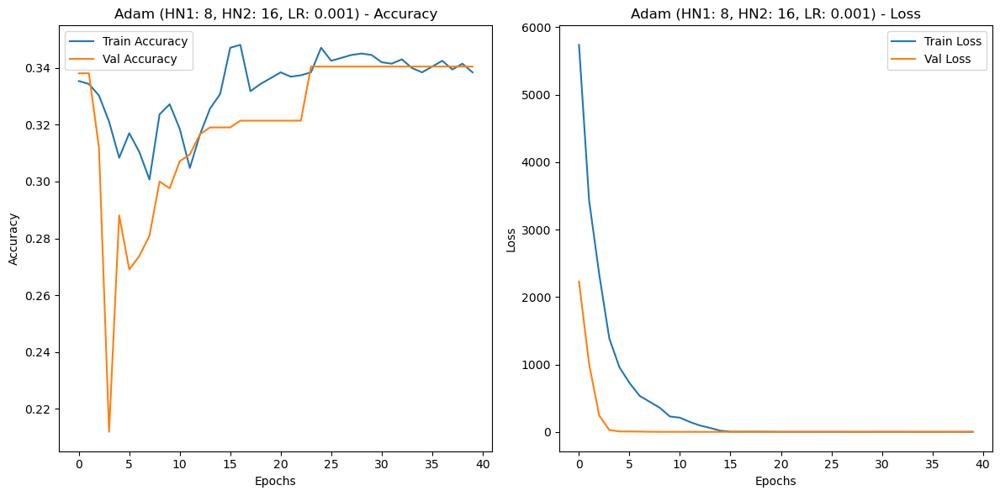


[INFO] Training RProp optimizer with 8 first hidden neurons, 16 second hidden neurons, and 0.001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3432 - loss: 9285.9492 - val_accuracy: 0.3381 - val_loss: 787.2140
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3003 - loss: 1293.7307 - val_accuracy: 0.3381 - val_loss: 1.0980
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3317 - loss: 1.0995 - val_accuracy: 0.3381 - val_loss: 1.0980
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3184 - loss: 1.1263 - val_accuracy: 0.3381 - val_loss: 1.1069
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3425 - loss: 1.1006 - val_accuracy: 0.3381 - val_loss: 1.1004
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3308 - loss: 1.0997 - val_accuracy: 0.3381 - val_loss: 1.0985
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3244 - loss: 1.0999 - val_accuracy: 0.3381 - val_los

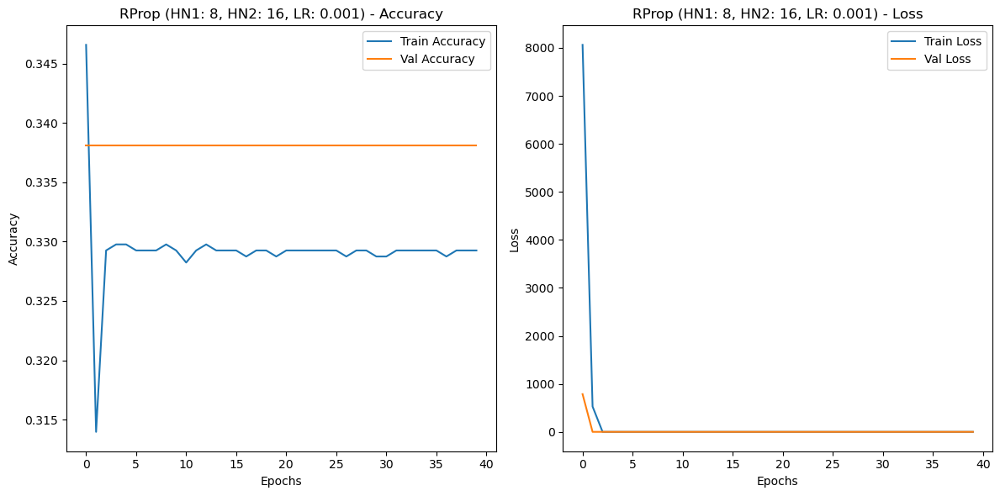


[INFO] Training Adam optimizer with 8 first hidden neurons, 16 second hidden neurons, and 0.01 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3258 - loss: 2510.5076 - val_accuracy: 0.3381 - val_loss: 1.1036
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 108ms/step - accuracy: 0.3288 - loss: 1.1016 - val_accuracy: 0.3381 - val_loss: 1.0988
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3352 - loss: 1.0987 - val_accuracy: 0.3405 - val_loss: 1.0985
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3286 - loss: 1.0988 - val_accuracy: 0.3405 - val_loss: 1.0989
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3213 - loss: 1.0992 - val_accuracy: 0.3405 - val_loss: 1.0984
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3560 - loss: 1.0982 - val_accuracy: 0.3405 - val_loss: 1.0987
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3152 - loss: 1.0994 - val_accuracy: 0.3405 - val_loss: 1.0

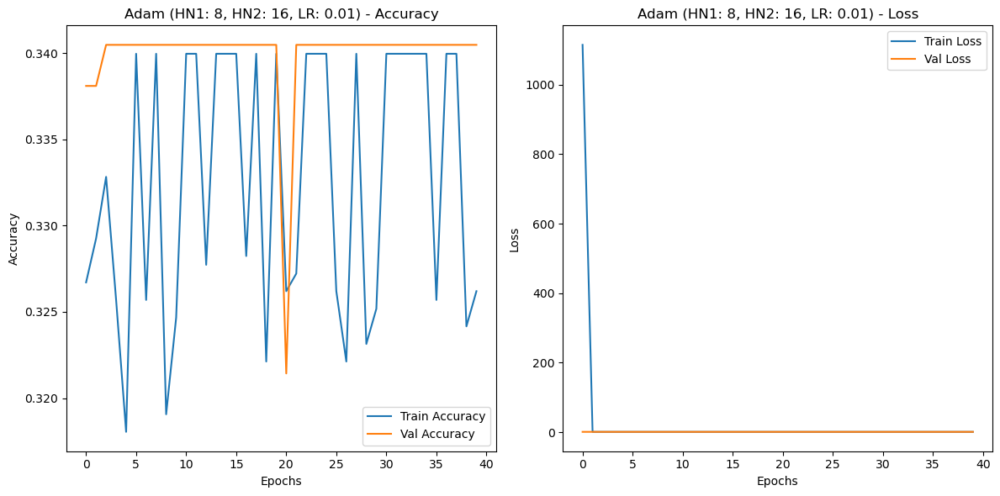


[INFO] Training RProp optimizer with 8 first hidden neurons, 16 second hidden neurons, and 0.01 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3142 - loss: 5335.3574 - val_accuracy: 0.3548 - val_loss: 121.1974
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3605 - loss: 533.3884 - val_accuracy: 0.3381 - val_loss: 106.2980
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3610 - loss: 208.0318 - val_accuracy: 0.3476 - val_loss: 7.4782
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3636 - loss: 12.0583 - val_accuracy: 0.3476 - val_loss: 5.7727
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3470 - loss: 8.7453 - val_accuracy: 0.3929 - val_loss: 1.2823
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3568 - loss: 2.8849 - val_accuracy: 0.3429 - val_loss: 1.2830
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3378 - loss: 2.0932 - val_accuracy: 0.3143 - val_

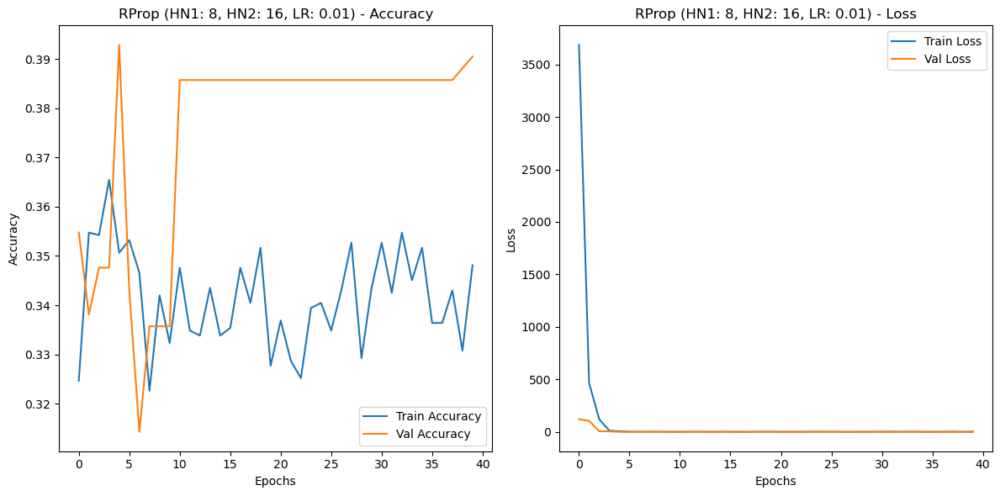


[INFO] Training Adam optimizer with 8 first hidden neurons, 16 second hidden neurons, and 0.1 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3395 - loss: 1928.9718 - val_accuracy: 0.3405 - val_loss: 1.0995
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3394 - loss: 1.1018 - val_accuracy: 0.3405 - val_loss: 1.0985
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3138 - loss: 1.1005 - val_accuracy: 0.3405 - val_loss: 1.1016
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3329 - loss: 1.1031 - val_accuracy: 0.3381 - val_loss: 1.0987
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3200 - loss: 1.1009 - val_accuracy: 0.3405 - val_loss: 1.1009
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3268 - loss: 1.1021 - val_accuracy: 0.3405 - val_loss: 1.1009
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3415 - loss: 1.1011 - val_accuracy: 0.3381 - val_loss: 1.098

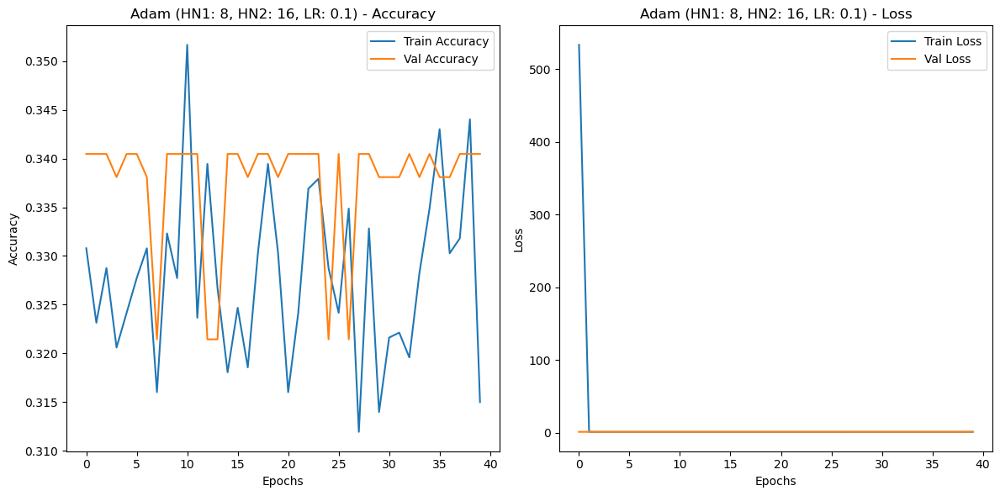


[INFO] Training RProp optimizer with 8 first hidden neurons, 16 second hidden neurons, and 0.1 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3291 - loss: 5119.1396 - val_accuracy: 0.3214 - val_loss: 1.1101
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3514 - loss: 1.0982 - val_accuracy: 0.3214 - val_loss: 1.1100
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3444 - loss: 1.0986 - val_accuracy: 0.3214 - val_loss: 1.1100
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3230 - loss: 1.1001 - val_accuracy: 0.3214 - val_loss: 1.1100
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3405 - loss: 1.0992 - val_accuracy: 0.3214 - val_loss: 1.1100
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3343 - loss: 1.0994 - val_accuracy: 0.3214 - val_loss: 1.1100
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3364 - loss: 1.0990 - val_accuracy: 0.3214 - val_loss: 1.11

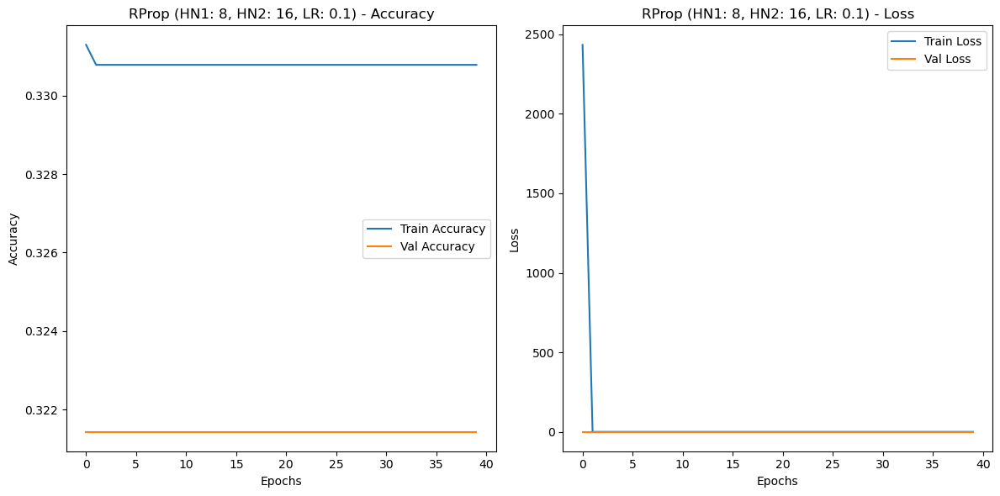


[INFO] Training Adam optimizer with 8 first hidden neurons, 32 second hidden neurons, and 0.0001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3325 - loss: 7558.9805 - val_accuracy: 0.3333 - val_loss: 1636.6106
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3229 - loss: 6913.4502 - val_accuracy: 0.3333 - val_loss: 1452.1401
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3488 - loss: 6854.2627 - val_accuracy: 0.3286 - val_loss: 1270.8628
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3322 - loss: 6530.8438 - val_accuracy: 0.3286 - val_loss: 1125.5690
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3397 - loss: 6690.8833 - val_accuracy: 0.3310 - val_loss: 1030.0166
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3296 - loss: 5871.7236 - val_accuracy: 0.3310 - val_loss: 947.2238
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3398 - loss: 5746.7275 - 

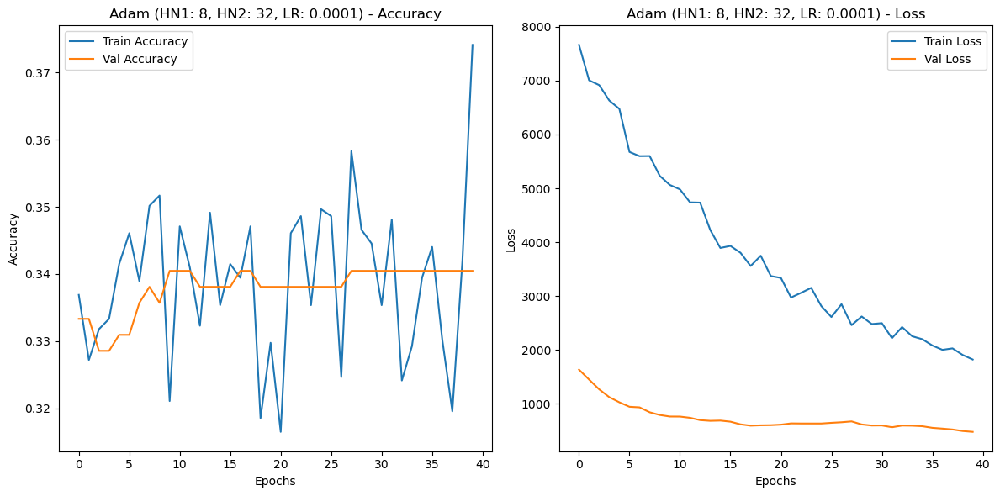


[INFO] Training RProp optimizer with 8 first hidden neurons, 32 second hidden neurons, and 0.0001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3121 - loss: 3160.9719 - val_accuracy: 0.3381 - val_loss: 1029.1339
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3283 - loss: 1998.2064 - val_accuracy: 0.4667 - val_loss: 18.6344
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3750 - loss: 138.8866 - val_accuracy: 0.4333 - val_loss: 4.2380
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3605 - loss: 8.0889 - val_accuracy: 0.3214 - val_loss: 1.2787
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3397 - loss: 1.6210 - val_accuracy: 0.3214 - val_loss: 1.1397
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3174 - loss: 1.1817 - val_accuracy: 0.3214 - val_loss: 1.0990
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3345 - loss: 1.1413 - val_accuracy: 0.3214 - va

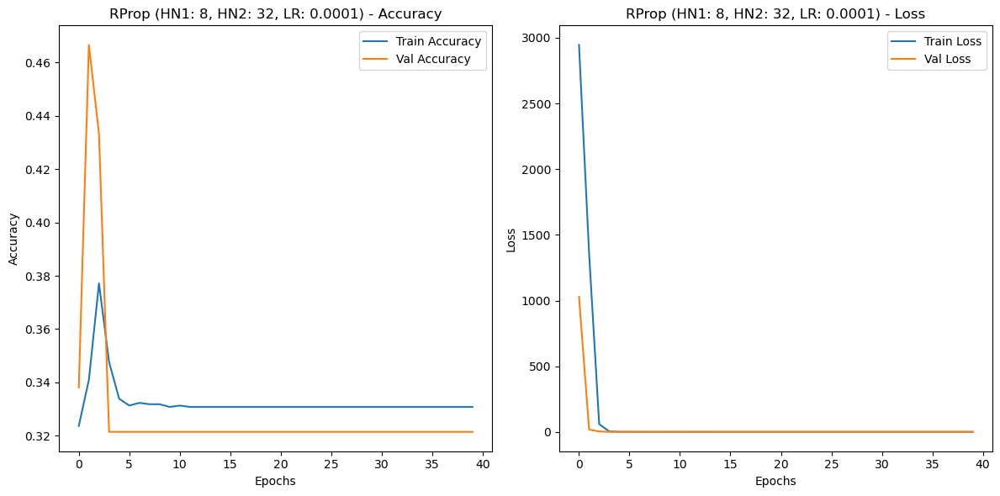


[INFO] Training Adam optimizer with 8 first hidden neurons, 32 second hidden neurons, and 0.001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3305 - loss: 9291.1260 - val_accuracy: 0.3381 - val_loss: 4309.0073
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 57ms/step - accuracy: 0.3147 - loss: 5515.0903 - val_accuracy: 0.3405 - val_loss: 1122.1669
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 57ms/step - accuracy: 0.3125 - loss: 3348.2620 - val_accuracy: 0.3071 - val_loss: 398.2765
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 56ms/step - accuracy: 0.3367 - loss: 2340.8000 - val_accuracy: 0.3405 - val_loss: 320.7169
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 57ms/step - accuracy: 0.3220 - loss: 2221.5225 - val_accuracy: 0.3405 - val_loss: 281.6976
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 57ms/step - accuracy: 0.3338 - loss: 1342.5544 - val_accuracy: 0.3405 - val_loss: 221.1244
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3432 - loss: 1149.4227 - val_

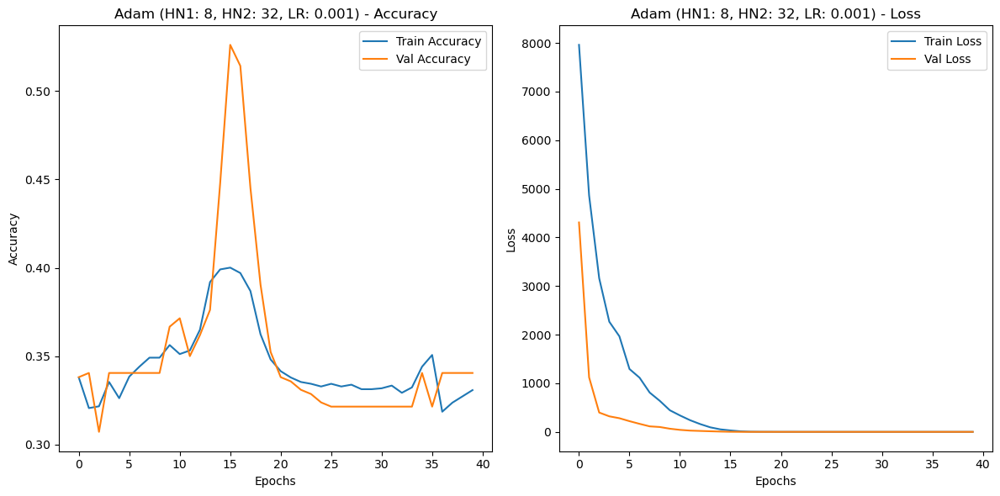


[INFO] Training RProp optimizer with 8 first hidden neurons, 32 second hidden neurons, and 0.001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3393 - loss: 7089.4644 - val_accuracy: 0.3405 - val_loss: 699.4616
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3397 - loss: 2586.8850 - val_accuracy: 0.3238 - val_loss: 419.2608
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3640 - loss: 728.8178 - val_accuracy: 0.5167 - val_loss: 45.7351
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 40ms/step - accuracy: 0.3456 - loss: 179.2315 - val_accuracy: 0.4262 - val_loss: 1.6230
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 48ms/step - accuracy: 0.3545 - loss: 6.0518 - val_accuracy: 0.4333 - val_loss: 2.3486
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3746 - loss: 6.3877 - val_accuracy: 0.3833 - val_loss: 1.4483
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3618 - loss: 1.9197 - val_accuracy: 0.3524 - 

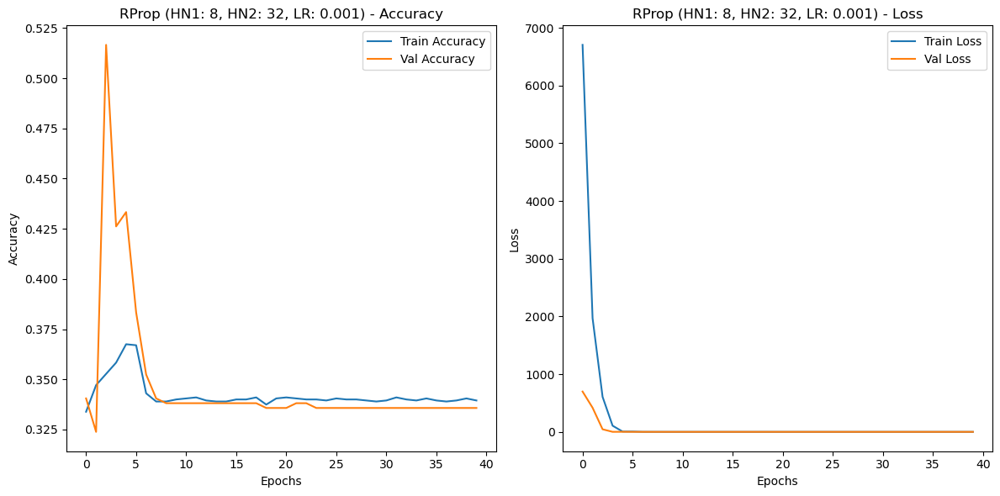


[INFO] Training Adam optimizer with 8 first hidden neurons, 32 second hidden neurons, and 0.01 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 72ms/step - accuracy: 0.3648 - loss: 3968.2896 - val_accuracy: 0.3405 - val_loss: 68.2975
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 71ms/step - accuracy: 0.3402 - loss: 180.9291 - val_accuracy: 0.4786 - val_loss: 1.3654
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 69ms/step - accuracy: 0.3823 - loss: 2.7047 - val_accuracy: 0.3214 - val_loss: 1.1020
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3485 - loss: 1.1410 - val_accuracy: 0.3405 - val_loss: 1.0959
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3281 - loss: 1.1910 - val_accuracy: 0.3405 - val_loss: 1.0947
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3464 - loss: 1.1166 - val_accuracy: 0.3405 - val_loss: 1.0939
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3332 - loss: 1.1147 - val_accuracy: 0.3405 - val_loss: 1

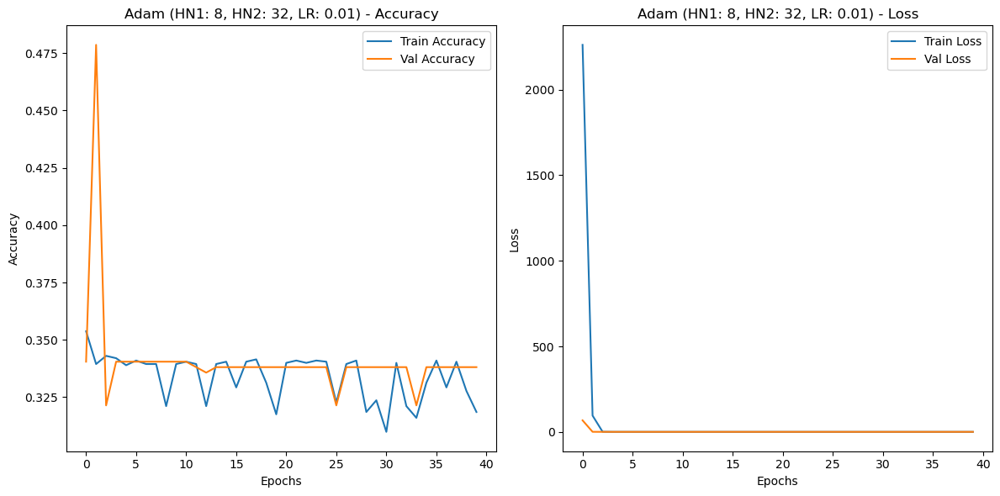


[INFO] Training RProp optimizer with 8 first hidden neurons, 32 second hidden neurons, and 0.01 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3486 - loss: 3001.3103 - val_accuracy: 0.3429 - val_loss: 1.0942
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 48ms/step - accuracy: 0.3443 - loss: 1.4550 - val_accuracy: 0.3405 - val_loss: 1.0969
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3113 - loss: 1.2140 - val_accuracy: 0.3405 - val_loss: 1.0969
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 53ms/step - accuracy: 0.3337 - loss: 1.3181 - val_accuracy: 0.3405 - val_loss: 1.0980
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 56ms/step - accuracy: 0.3273 - loss: 1.1982 - val_accuracy: 0.3381 - val_loss: 1.0996
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 53ms/step - accuracy: 0.3186 - loss: 1.1042 - val_accuracy: 0.3381 - val_loss: 1.0997
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3314 - loss: 1.1834 - val_accuracy: 0.3381 - val_loss: 1.0

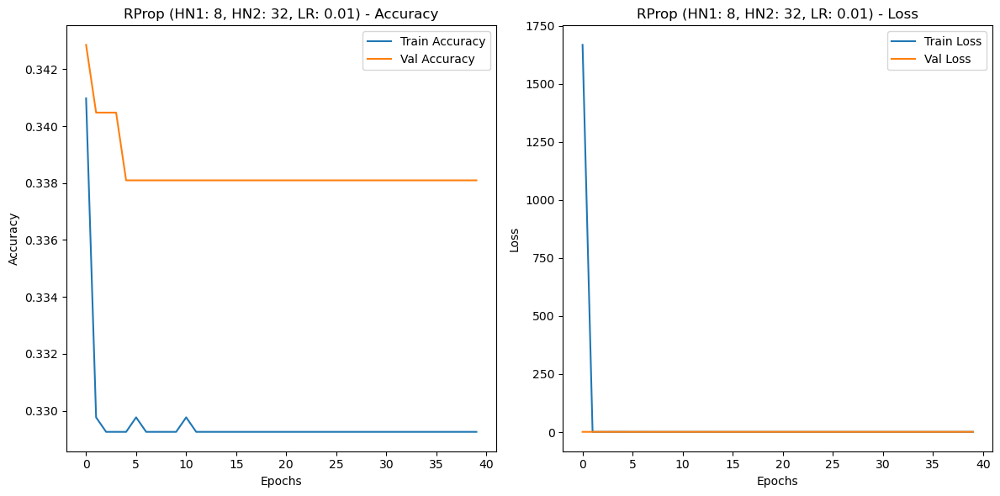


[INFO] Training Adam optimizer with 8 first hidden neurons, 32 second hidden neurons, and 0.1 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 80ms/step - accuracy: 0.3305 - loss: 1091.2738 - val_accuracy: 0.3405 - val_loss: 1.1030
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 73ms/step - accuracy: 0.3349 - loss: 1.1041 - val_accuracy: 0.3381 - val_loss: 1.0989
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3435 - loss: 1.0997 - val_accuracy: 0.3381 - val_loss: 1.1039
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3327 - loss: 1.1011 - val_accuracy: 0.3381 - val_loss: 1.1004
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3395 - loss: 1.1010 - val_accuracy: 0.3405 - val_loss: 1.0994
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3422 - loss: 1.1004 - val_accuracy: 0.3405 - val_loss: 1.0983
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3337 - loss: 1.1012 - val_accuracy: 0.3405 - val_loss: 1.099

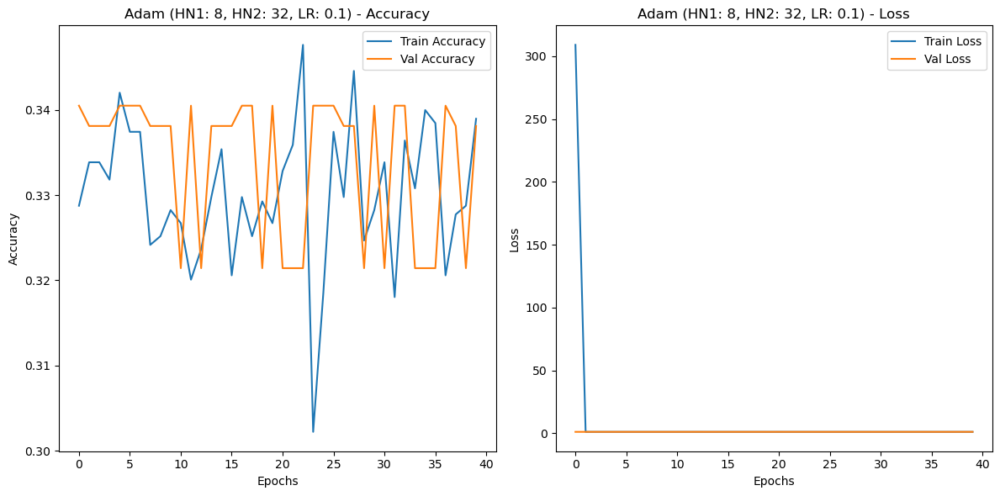


[INFO] Training RProp optimizer with 8 first hidden neurons, 32 second hidden neurons, and 0.1 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3448 - loss: 841.3340 - val_accuracy: 0.3405 - val_loss: 1.0998
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 40ms/step - accuracy: 0.3359 - loss: 1.0999 - val_accuracy: 0.3405 - val_loss: 1.0997
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3303 - loss: 1.1003 - val_accuracy: 0.3405 - val_loss: 1.0997
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3318 - loss: 1.1001 - val_accuracy: 0.3405 - val_loss: 1.0997
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3189 - loss: 1.1009 - val_accuracy: 0.3405 - val_loss: 1.0997
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 40ms/step - accuracy: 0.3378 - loss: 1.0993 - val_accuracy: 0.3405 - val_loss: 1.0997
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3384 - loss: 1.0996 - val_accuracy: 0.3405 - val_loss: 1.099

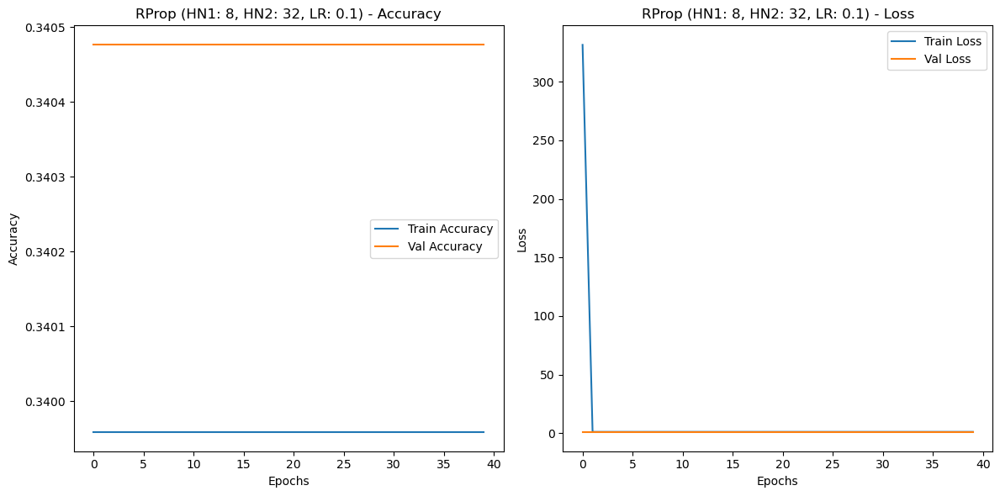


[INFO] Training Adam optimizer with 8 first hidden neurons, 64 second hidden neurons, and 0.0001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 74ms/step - accuracy: 0.3334 - loss: 4234.0938 - val_accuracy: 0.3405 - val_loss: 2236.7498
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 72ms/step - accuracy: 0.3282 - loss: 4052.9883 - val_accuracy: 0.3405 - val_loss: 1906.1447
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - accuracy: 0.3163 - loss: 3642.6562 - val_accuracy: 0.3405 - val_loss: 1676.3804
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 68ms/step - accuracy: 0.3528 - loss: 3146.1982 - val_accuracy: 0.3405 - val_loss: 1441.3988
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 58ms/step - accuracy: 0.3231 - loss: 3402.5439 - val_accuracy: 0.3405 - val_loss: 1204.5531
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3303 - loss: 2837.2834 - val_accuracy: 0.3405 - val_loss: 1024.3324
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3486 - loss: 2643.6978 -

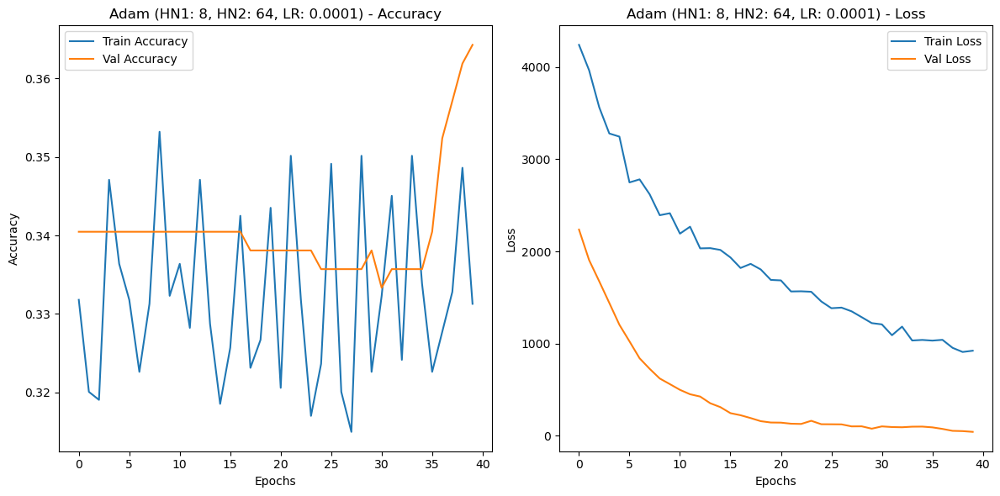


[INFO] Training RProp optimizer with 8 first hidden neurons, 64 second hidden neurons, and 0.0001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 49ms/step - accuracy: 0.2945 - loss: 5541.8774 - val_accuracy: 0.5000 - val_loss: 402.3757
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 52ms/step - accuracy: 0.3178 - loss: 3909.2563 - val_accuracy: 0.3333 - val_loss: 506.4778
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3549 - loss: 1119.4016 - val_accuracy: 0.4357 - val_loss: 27.8491
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 49ms/step - accuracy: 0.3671 - loss: 78.3392 - val_accuracy: 0.3833 - val_loss: 22.8638
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 49ms/step - accuracy: 0.3090 - loss: 81.5308 - val_accuracy: 0.3857 - val_loss: 12.5702
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3050 - loss: 24.5681 - val_accuracy: 0.3214 - val_loss: 2.0569
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 54ms/step - accuracy: 0.2995 - loss: 4.2358 - val_accuracy: 0.32

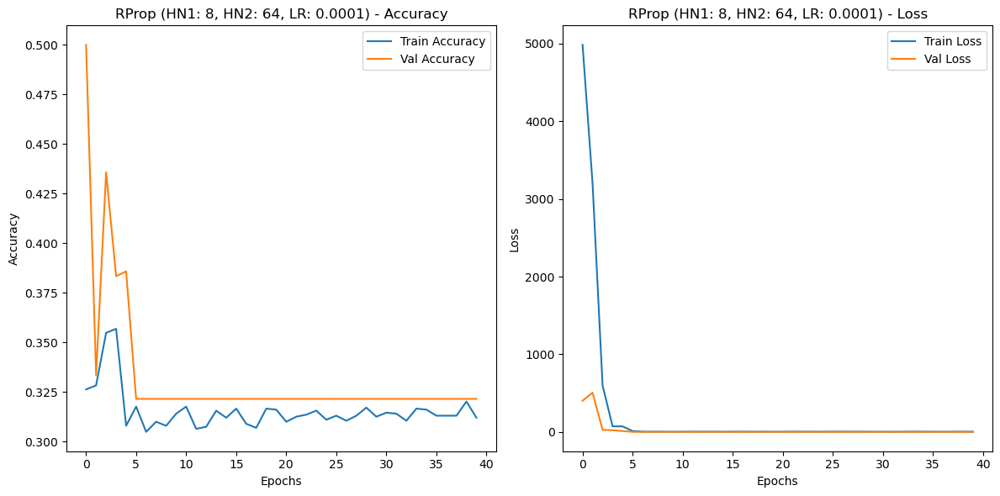


[INFO] Training Adam optimizer with 8 first hidden neurons, 64 second hidden neurons, and 0.001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3359 - loss: 6560.9180 - val_accuracy: 0.3381 - val_loss: 1362.8395
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3162 - loss: 3098.5613 - val_accuracy: 0.3405 - val_loss: 433.7904
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 58ms/step - accuracy: 0.3344 - loss: 2333.0029 - val_accuracy: 0.3381 - val_loss: 507.1109
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 58ms/step - accuracy: 0.3247 - loss: 1801.0210 - val_accuracy: 0.3429 - val_loss: 245.5730
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 58ms/step - accuracy: 0.3286 - loss: 1650.2100 - val_accuracy: 0.3667 - val_loss: 262.4403
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3213 - loss: 1244.9496 - val_accuracy: 0.3595 - val_loss: 207.9468
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3221 - loss: 921.2407 - val_ac

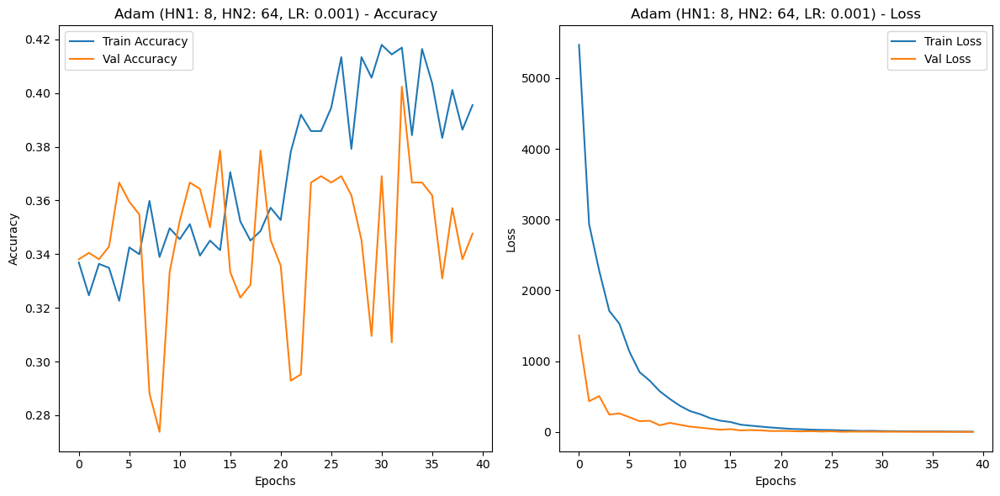


[INFO] Training RProp optimizer with 8 first hidden neurons, 64 second hidden neurons, and 0.001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 54ms/step - accuracy: 0.3217 - loss: 6193.9097 - val_accuracy: 0.3405 - val_loss: 432.3835
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3398 - loss: 522.0590 - val_accuracy: 0.3405 - val_loss: 1.0988
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3469 - loss: 1.0979 - val_accuracy: 0.3405 - val_loss: 1.0988
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 56ms/step - accuracy: 0.3426 - loss: 1.0985 - val_accuracy: 0.3405 - val_loss: 1.0988
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3550 - loss: 1.0977 - val_accuracy: 0.3405 - val_loss: 1.0988
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3304 - loss: 1.0999 - val_accuracy: 0.3405 - val_loss: 1.0988
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3374 - loss: 1.0992 - val_accuracy: 0.3405 - val_loss

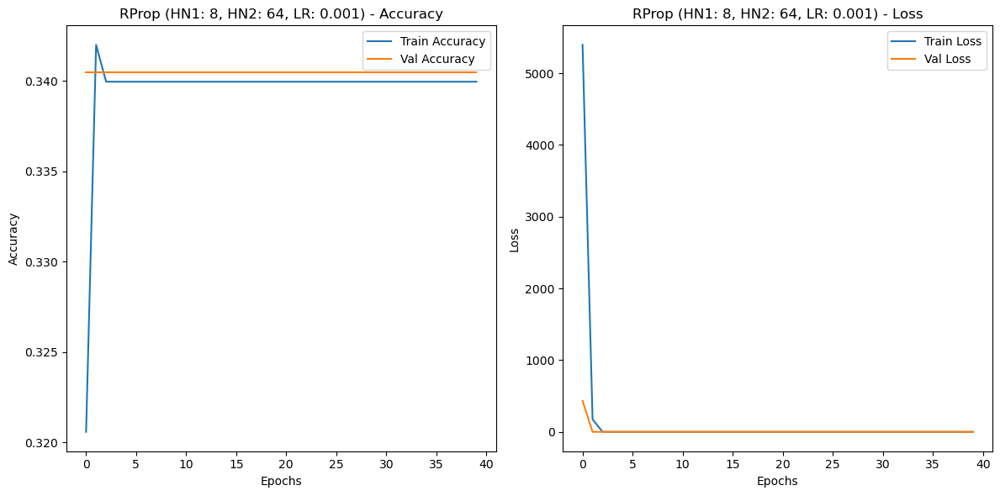


[INFO] Training Adam optimizer with 8 first hidden neurons, 64 second hidden neurons, and 0.01 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3343 - loss: 1817.0007 - val_accuracy: 0.3452 - val_loss: 1.1878
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 57ms/step - accuracy: 0.3359 - loss: 1.2769 - val_accuracy: 0.3405 - val_loss: 1.0986
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3282 - loss: 1.1019 - val_accuracy: 0.3405 - val_loss: 1.0985
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 70ms/step - accuracy: 0.3345 - loss: 1.0990 - val_accuracy: 0.3405 - val_loss: 1.0987
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 70ms/step - accuracy: 0.3421 - loss: 1.0988 - val_accuracy: 0.3405 - val_loss: 1.0988
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 68ms/step - accuracy: 0.3563 - loss: 1.0987 - val_accuracy: 0.3405 - val_loss: 1.0986
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3526 - loss: 1.0980 - val_accuracy: 0.3405 - val_loss: 1.09

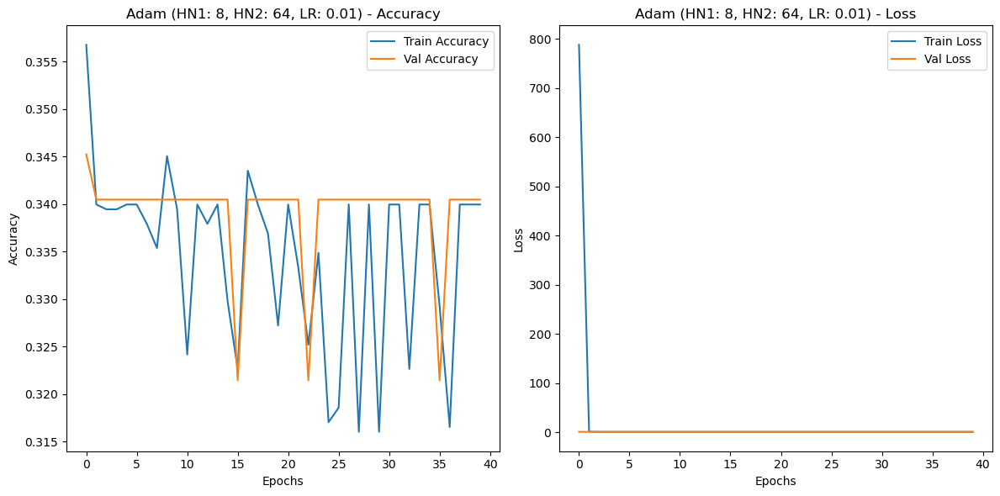


[INFO] Training RProp optimizer with 8 first hidden neurons, 64 second hidden neurons, and 0.01 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 54ms/step - accuracy: 0.3437 - loss: 4435.4072 - val_accuracy: 0.4071 - val_loss: 10.0081
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 50ms/step - accuracy: 0.3816 - loss: 15.0993 - val_accuracy: 0.3452 - val_loss: 1.3199
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 49ms/step - accuracy: 0.3351 - loss: 1.5088 - val_accuracy: 0.3357 - val_loss: 1.1325
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 50ms/step - accuracy: 0.3299 - loss: 1.1491 - val_accuracy: 0.3381 - val_loss: 1.1129
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 40ms/step - accuracy: 0.3274 - loss: 1.1057 - val_accuracy: 0.3381 - val_loss: 1.1059
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3434 - loss: 1.1208 - val_accuracy: 0.3381 - val_loss: 1.1037
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3327 - loss: 1.1492 - val_accuracy: 0.3381 - val_loss: 1

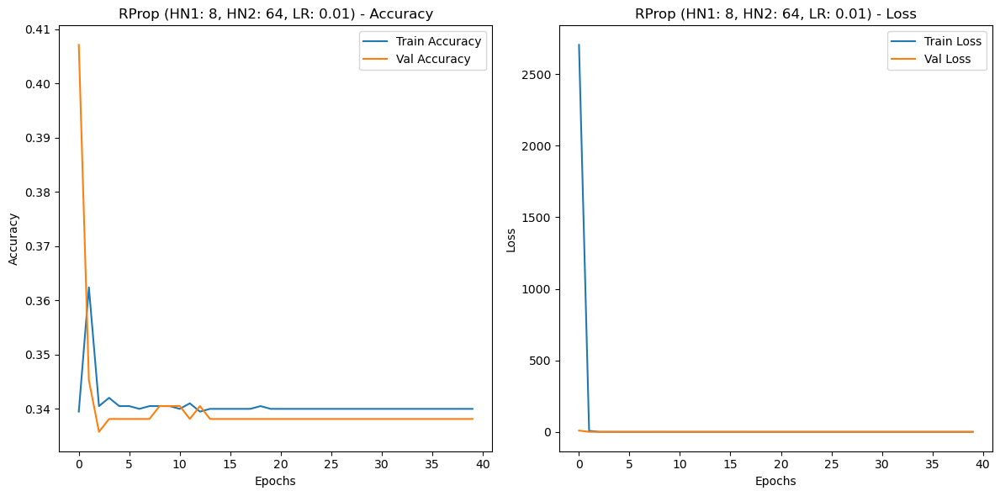


[INFO] Training Adam optimizer with 8 first hidden neurons, 64 second hidden neurons, and 0.1 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3328 - loss: 1428.9482 - val_accuracy: 0.3381 - val_loss: 1.0991
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3205 - loss: 1.1014 - val_accuracy: 0.3381 - val_loss: 1.0998
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3260 - loss: 1.1008 - val_accuracy: 0.3405 - val_loss: 1.0984
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3442 - loss: 1.1000 - val_accuracy: 0.3381 - val_loss: 1.1013
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3320 - loss: 1.1022 - val_accuracy: 0.3405 - val_loss: 1.0984
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3163 - loss: 1.1003 - val_accuracy: 0.3381 - val_loss: 1.0984
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3326 - loss: 1.1003 - val_accuracy: 0.3214 - val_loss: 1.117

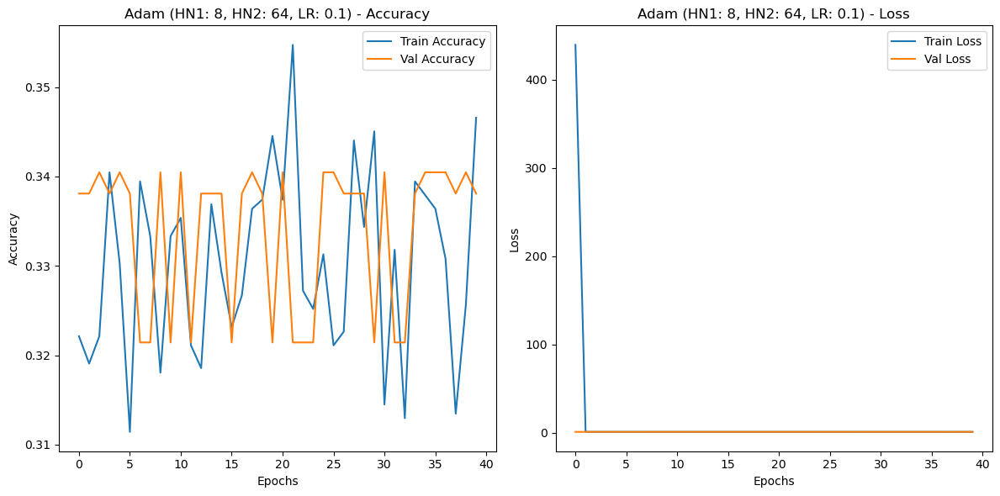


[INFO] Training RProp optimizer with 8 first hidden neurons, 64 second hidden neurons, and 0.1 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 52ms/step - accuracy: 0.3397 - loss: 2109.8948 - val_accuracy: 0.4190 - val_loss: 1.2129
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3627 - loss: 2.5629 - val_accuracy: 0.4190 - val_loss: 1.2441
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3595 - loss: 2.3254 - val_accuracy: 0.4214 - val_loss: 1.2471
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3556 - loss: 3.8441 - val_accuracy: 0.4214 - val_loss: 1.2489
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3852 - loss: 2.5196 - val_accuracy: 0.4214 - val_loss: 1.2488
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 52ms/step - accuracy: 0.3551 - loss: 3.0697 - val_accuracy: 0.4214 - val_loss: 1.2485
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 54ms/step - accuracy: 0.3805 - loss: 2.6334 - val_accuracy: 0.4214 - val_loss: 1.24

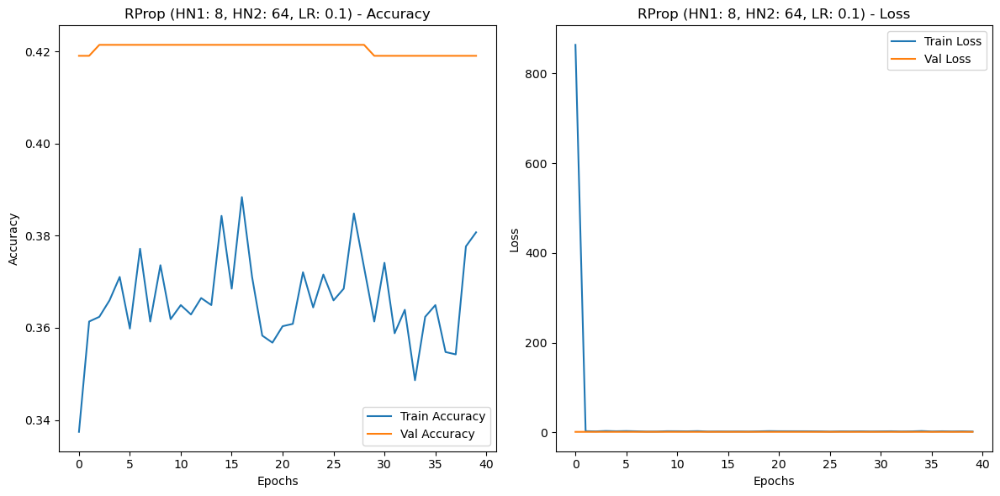


[INFO] Training Adam optimizer with 8 first hidden neurons, 128 second hidden neurons, and 0.0001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 72ms/step - accuracy: 0.3268 - loss: 877.6712 - val_accuracy: 0.3286 - val_loss: 134.3222
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - accuracy: 0.3368 - loss: 830.4736 - val_accuracy: 0.3310 - val_loss: 88.6427
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3455 - loss: 741.1968 - val_accuracy: 0.3167 - val_loss: 68.9943
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3149 - loss: 722.7698 - val_accuracy: 0.3476 - val_loss: 62.9885
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3254 - loss: 694.0607 - val_accuracy: 0.3476 - val_loss: 51.5658
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3414 - loss: 591.5233 - val_accuracy: 0.3929 - val_loss: 47.7918
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3427 - loss: 538.7386 - val_accuracy: 0.

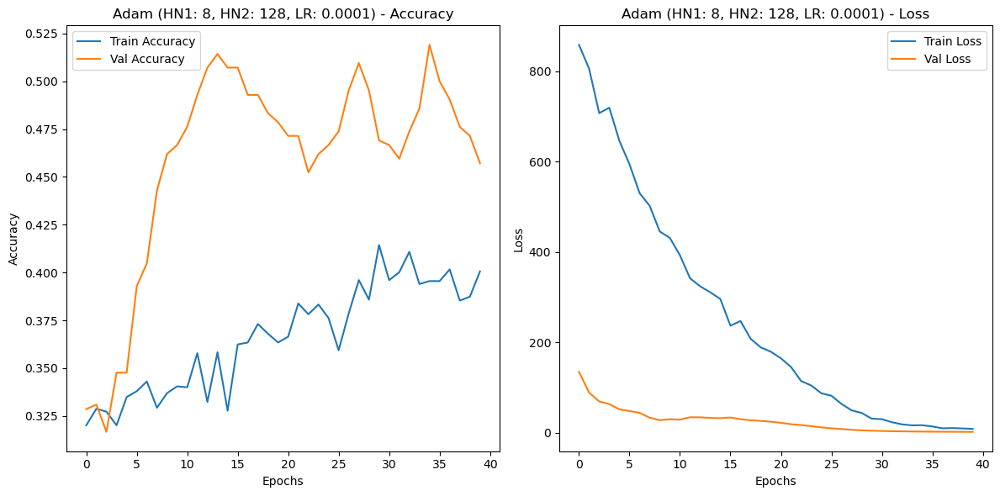


[INFO] Training RProp optimizer with 8 first hidden neurons, 128 second hidden neurons, and 0.0001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 55ms/step - accuracy: 0.3340 - loss: 3107.9277 - val_accuracy: 0.3405 - val_loss: 868.9152
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 56ms/step - accuracy: 0.3601 - loss: 1425.4303 - val_accuracy: 0.3762 - val_loss: 32.9025
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3661 - loss: 204.4052 - val_accuracy: 0.5095 - val_loss: 42.3403
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 74ms/step - accuracy: 0.4084 - loss: 49.6521 - val_accuracy: 0.4976 - val_loss: 21.6529
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3977 - loss: 36.1223 - val_accuracy: 0.3952 - val_loss: 5.2953
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 51ms/step - accuracy: 0.3684 - loss: 5.2538 - val_accuracy: 0.4310 - val_loss: 2.5798
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 52ms/step - accuracy: 0.3689 - loss: 4.8538 - val_accuracy: 0.4333 

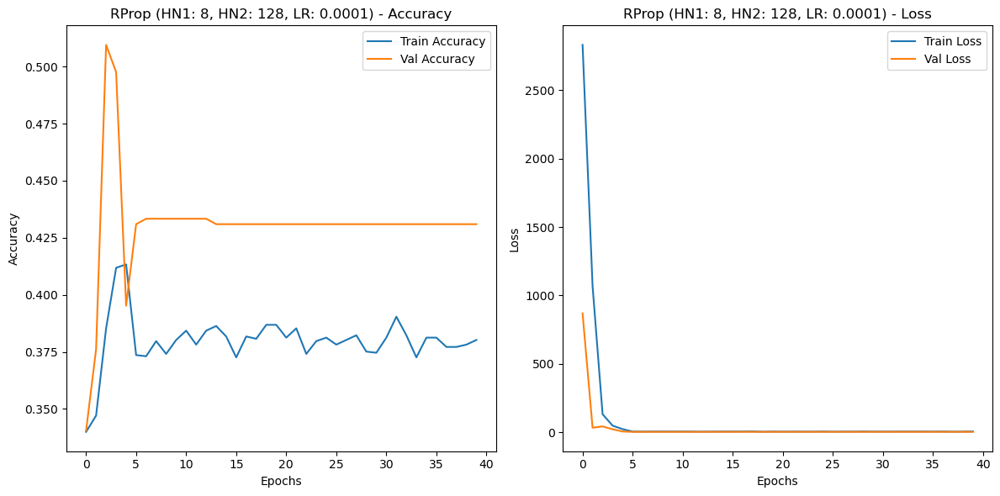


[INFO] Training Adam optimizer with 8 first hidden neurons, 128 second hidden neurons, and 0.001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 73ms/step - accuracy: 0.3427 - loss: 1963.5658 - val_accuracy: 0.3214 - val_loss: 299.7281
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 77ms/step - accuracy: 0.3434 - loss: 1480.2366 - val_accuracy: 0.3405 - val_loss: 188.9253
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 74ms/step - accuracy: 0.3199 - loss: 1114.8916 - val_accuracy: 0.3381 - val_loss: 182.1414
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 73ms/step - accuracy: 0.3224 - loss: 825.8347 - val_accuracy: 0.3381 - val_loss: 147.3141
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 77ms/step - accuracy: 0.3167 - loss: 634.2036 - val_accuracy: 0.3405 - val_loss: 45.4885
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 76ms/step - accuracy: 0.3399 - loss: 477.2656 - val_accuracy: 0.3333 - val_loss: 95.1239
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 80ms/step - accuracy: 0.3584 - loss: 322.1212 - val_accurac

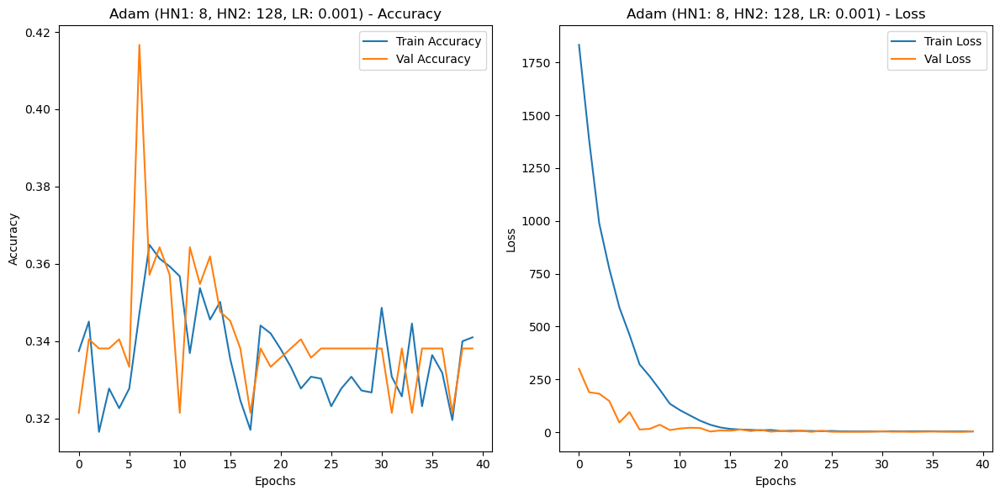


[INFO] Training RProp optimizer with 8 first hidden neurons, 128 second hidden neurons, and 0.001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 58ms/step - accuracy: 0.3355 - loss: 5484.6401 - val_accuracy: 0.3381 - val_loss: 103.6655
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 54ms/step - accuracy: 0.3499 - loss: 1587.5826 - val_accuracy: 0.3333 - val_loss: 159.2078
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 57ms/step - accuracy: 0.3324 - loss: 925.3475 - val_accuracy: 0.3310 - val_loss: 58.6919
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 49ms/step - accuracy: 0.3238 - loss: 640.1073 - val_accuracy: 0.3667 - val_loss: 1.5075
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 54ms/step - accuracy: 0.3405 - loss: 2.7367 - val_accuracy: 0.3786 - val_loss: 1.1303
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 53ms/step - accuracy: 0.3651 - loss: 1.4858 - val_accuracy: 0.3833 - val_loss: 1.1048
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3445 - loss: 1.5395 - val_accuracy: 0.3833 -

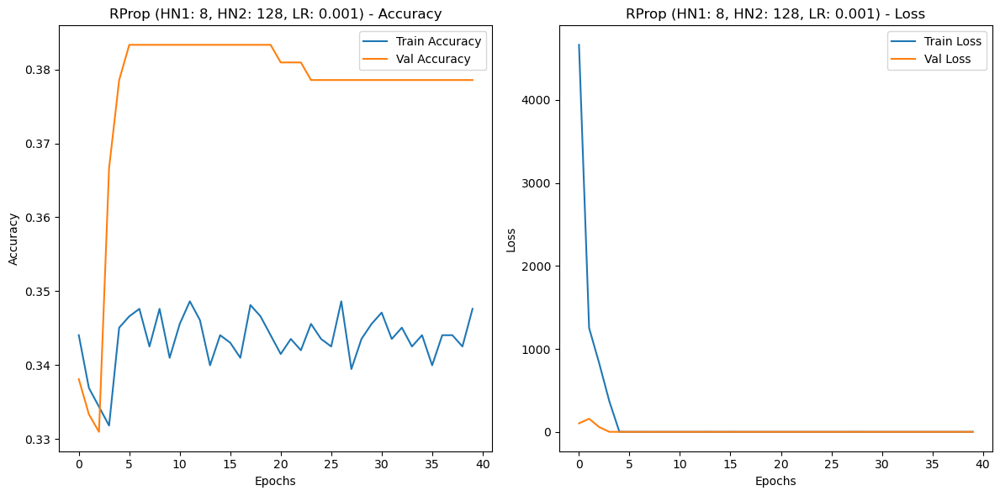


[INFO] Training Adam optimizer with 8 first hidden neurons, 128 second hidden neurons, and 0.01 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 73ms/step - accuracy: 0.3110 - loss: 3330.6287 - val_accuracy: 0.3143 - val_loss: 40.3260
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 70ms/step - accuracy: 0.3420 - loss: 196.9297 - val_accuracy: 0.3595 - val_loss: 3.3560
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 76ms/step - accuracy: 0.3817 - loss: 8.6321 - val_accuracy: 0.3214 - val_loss: 1.1075
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 69ms/step - accuracy: 0.3336 - loss: 1.1027 - val_accuracy: 0.3214 - val_loss: 1.1000
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - accuracy: 0.3453 - loss: 1.0990 - val_accuracy: 0.3405 - val_loss: 1.0988
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - accuracy: 0.3361 - loss: 1.0983 - val_accuracy: 0.3405 - val_loss: 1.0985
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 77ms/step - accuracy: 0.3339 - loss: 1.0992 - val_accuracy: 0.3405 - val_loss: 

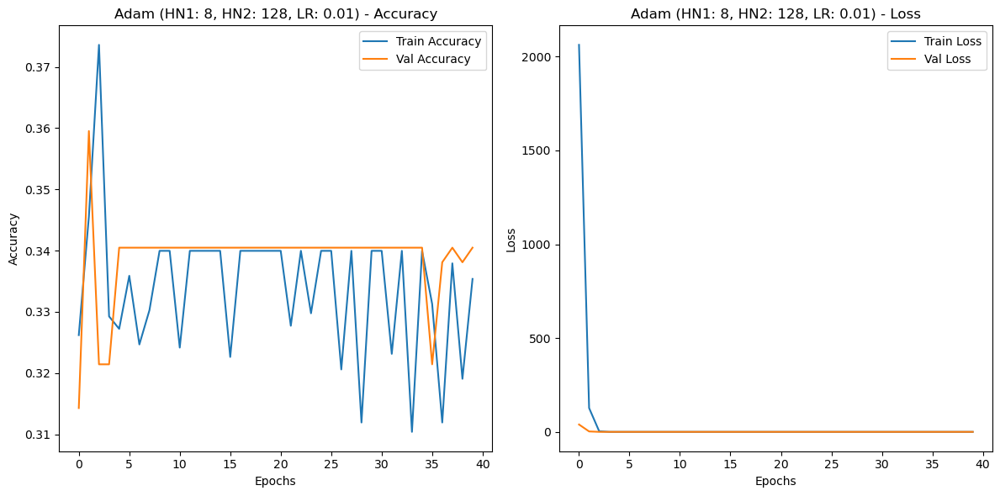


[INFO] Training RProp optimizer with 8 first hidden neurons, 128 second hidden neurons, and 0.01 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 53ms/step - accuracy: 0.3322 - loss: 4555.8584 - val_accuracy: 0.3762 - val_loss: 86.6594
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 49ms/step - accuracy: 0.3101 - loss: 491.3729 - val_accuracy: 0.3333 - val_loss: 1.2847
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 49ms/step - accuracy: 0.3315 - loss: 1.9190 - val_accuracy: 0.3333 - val_loss: 1.1367
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 50ms/step - accuracy: 0.3047 - loss: 1.7897 - val_accuracy: 0.3357 - val_loss: 1.1013
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 51ms/step - accuracy: 0.3265 - loss: 1.4526 - val_accuracy: 0.3357 - val_loss: 1.1197
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 50ms/step - accuracy: 0.3398 - loss: 1.4097 - val_accuracy: 0.3357 - val_loss: 1.0993
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3109 - loss: 1.3645 - val_accuracy: 0.3381 - val_loss:

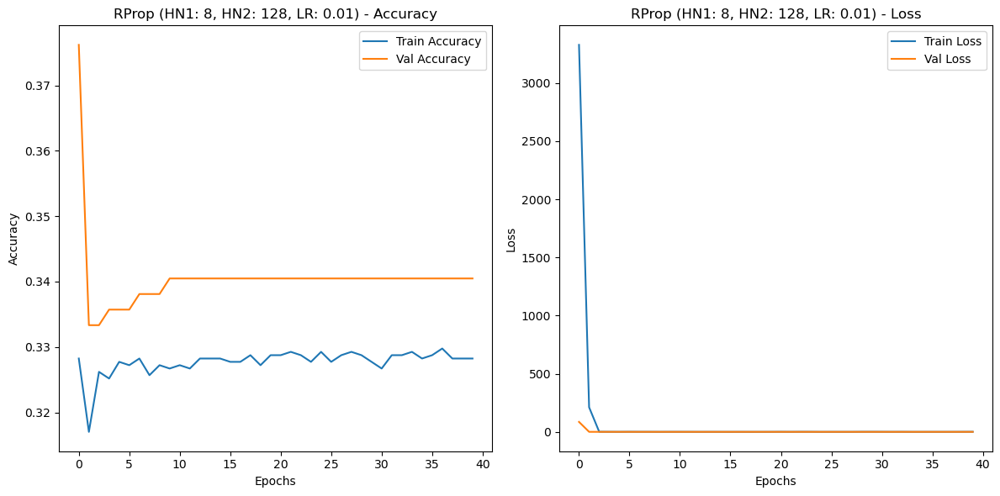


[INFO] Training Adam optimizer with 8 first hidden neurons, 128 second hidden neurons, and 0.1 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 76ms/step - accuracy: 0.3236 - loss: 1857.6014 - val_accuracy: 0.3381 - val_loss: 2.3389
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 71ms/step - accuracy: 0.3287 - loss: 1.1017 - val_accuracy: 0.3381 - val_loss: 2.3942
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3272 - loss: 1.1018 - val_accuracy: 0.3381 - val_loss: 2.3967
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - accuracy: 0.3112 - loss: 1.1021 - val_accuracy: 0.3381 - val_loss: 2.3961
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - accuracy: 0.3413 - loss: 1.1027 - val_accuracy: 0.3381 - val_loss: 2.3992
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3428 - loss: 1.1002 - val_accuracy: 0.3381 - val_loss: 2.3968
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 71ms/step - accuracy: 0.3323 - loss: 1.1003 - val_accuracy: 0.3381 - val_loss: 2.39

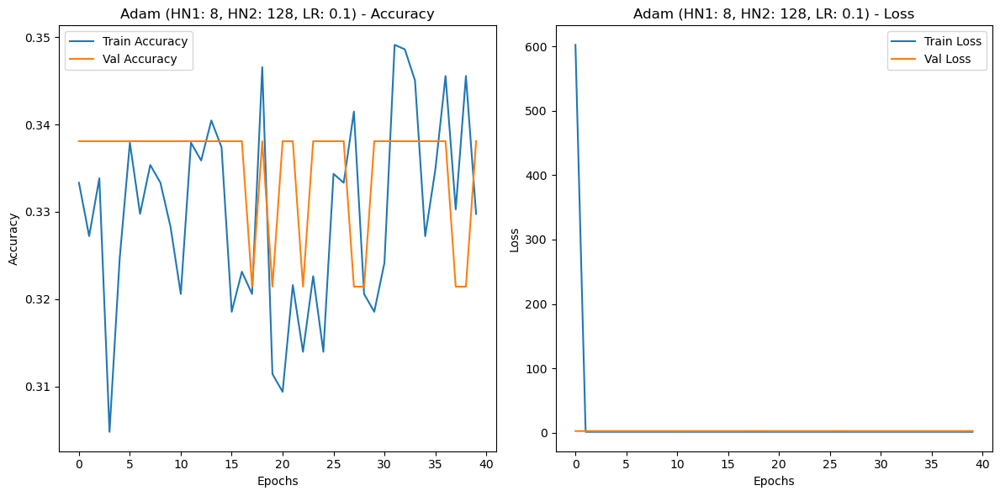


[INFO] Training RProp optimizer with 8 first hidden neurons, 128 second hidden neurons, and 0.1 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 51ms/step - accuracy: 0.3387 - loss: 1707.0251 - val_accuracy: 0.3262 - val_loss: 1.1150
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 48ms/step - accuracy: 0.3441 - loss: 1.1446 - val_accuracy: 0.3214 - val_loss: 1.1007
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 49ms/step - accuracy: 0.3302 - loss: 1.1832 - val_accuracy: 0.3214 - val_loss: 1.1007
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3360 - loss: 1.0994 - val_accuracy: 0.3214 - val_loss: 1.1007
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 48ms/step - accuracy: 0.3358 - loss: 1.0995 - val_accuracy: 0.3214 - val_loss: 1.1007
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3341 - loss: 1.1000 - val_accuracy: 0.3214 - val_loss: 1.1007
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3314 - loss: 1.1047 - val_accuracy: 0.3214 - val_loss: 1.1

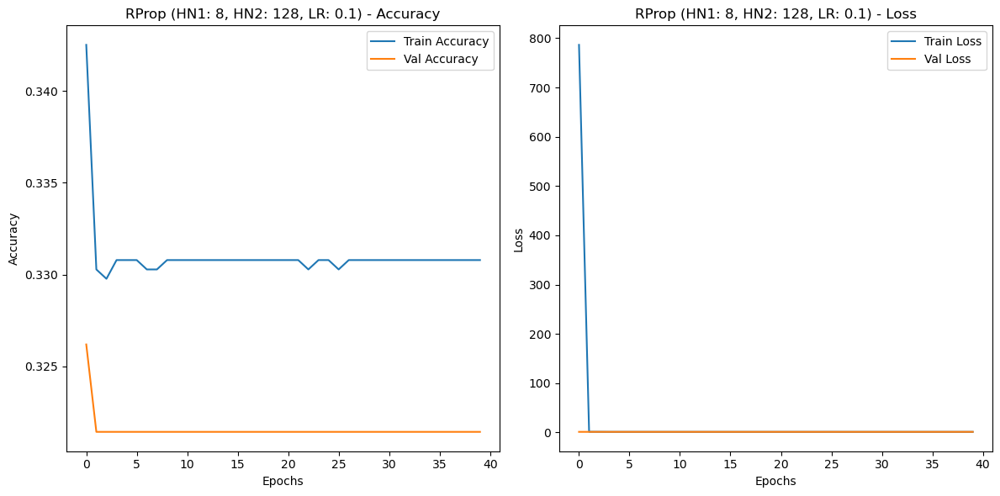


[INFO] Training Adam optimizer with 16 first hidden neurons, 4 second hidden neurons, and 0.0001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 70ms/step - accuracy: 0.3230 - loss: 8524.3555 - val_accuracy: 0.3405 - val_loss: 1591.2908
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 69ms/step - accuracy: 0.3359 - loss: 8181.4136 - val_accuracy: 0.3405 - val_loss: 1441.9166
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 79ms/step - accuracy: 0.3293 - loss: 7961.9009 - val_accuracy: 0.3405 - val_loss: 1265.6522
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 73ms/step - accuracy: 0.3402 - loss: 8130.5396 - val_accuracy: 0.3405 - val_loss: 1072.4803
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 70ms/step - accuracy: 0.3297 - loss: 8002.5718 - val_accuracy: 0.3405 - val_loss: 931.9587
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 72ms/step - accuracy: 0.3243 - loss: 7122.5908 - val_accuracy: 0.3405 - val_loss: 787.2393
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 68ms/step - accuracy: 0.3207 - loss: 6679.2075 - v

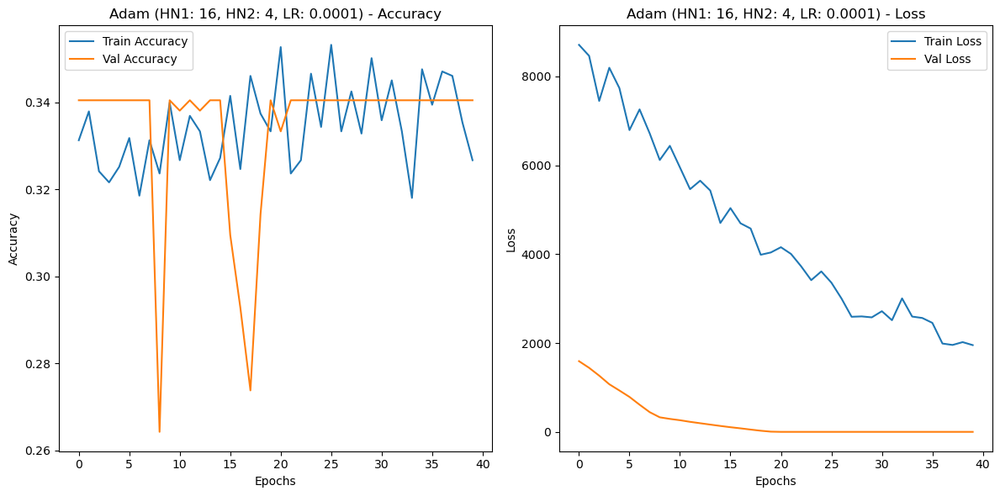


[INFO] Training RProp optimizer with 16 first hidden neurons, 4 second hidden neurons, and 0.0001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 49ms/step - accuracy: 0.3383 - loss: 5475.2842 - val_accuracy: 0.3405 - val_loss: 1477.5240
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3034 - loss: 2887.0769 - val_accuracy: 0.3214 - val_loss: 1.1034
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - accuracy: 0.3283 - loss: 304.0081 - val_accuracy: 0.3214 - val_loss: 1.1040
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - accuracy: 0.3239 - loss: 78.4062 - val_accuracy: 0.3214 - val_loss: 1.1040
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3357 - loss: 16.4990 - val_accuracy: 0.3214 - val_loss: 1.1040
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3351 - loss: 10.0309 - val_accuracy: 0.3214 - val_loss: 1.1040
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3308 - loss: 7.0390 - val_accuracy: 0.3214 - 

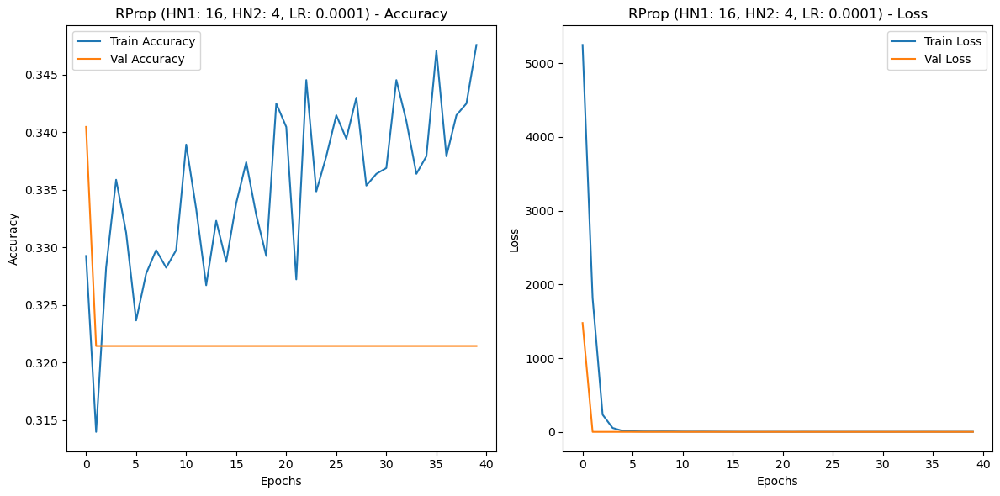


[INFO] Training Adam optimizer with 16 first hidden neurons, 4 second hidden neurons, and 0.001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - accuracy: 0.3044 - loss: 1394.3704 - val_accuracy: 0.3381 - val_loss: 1.0983
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3339 - loss: 586.6655 - val_accuracy: 0.3381 - val_loss: 1.0986
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3229 - loss: 228.1879 - val_accuracy: 0.3381 - val_loss: 1.0992
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - accuracy: 0.3179 - loss: 113.8178 - val_accuracy: 0.3381 - val_loss: 1.1000
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 74ms/step - accuracy: 0.3262 - loss: 66.1915 - val_accuracy: 0.3381 - val_loss: 1.1008
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 68ms/step - accuracy: 0.3400 - loss: 38.5359 - val_accuracy: 0.3405 - val_loss: 1.1016
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 68ms/step - accuracy: 0.3463 - loss: 19.8089 - val_accuracy: 0.3405 - val_

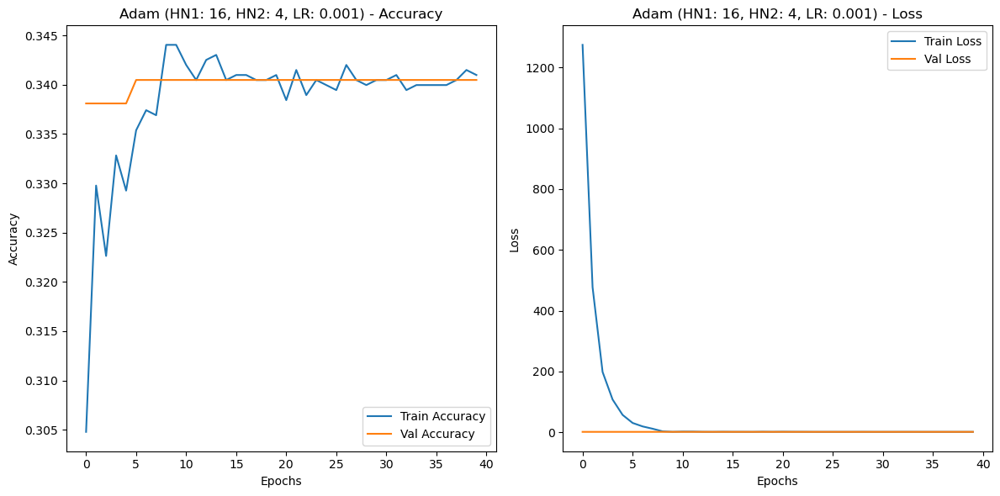


[INFO] Training RProp optimizer with 16 first hidden neurons, 4 second hidden neurons, and 0.001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 48ms/step - accuracy: 0.3337 - loss: 2722.8301 - val_accuracy: 0.3214 - val_loss: 1.0989
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3315 - loss: 129.3621 - val_accuracy: 0.3214 - val_loss: 1.0989
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 49ms/step - accuracy: 0.3446 - loss: 14.9297 - val_accuracy: 0.3214 - val_loss: 1.0989
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 54ms/step - accuracy: 0.3188 - loss: 4.1682 - val_accuracy: 0.3214 - val_loss: 1.0989
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3115 - loss: 2.3909 - val_accuracy: 0.3214 - val_loss: 1.0989
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3250 - loss: 3.1060 - val_accuracy: 0.3214 - val_loss: 1.0989
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3273 - loss: 2.5982 - val_accuracy: 0.3214 - val_loss:

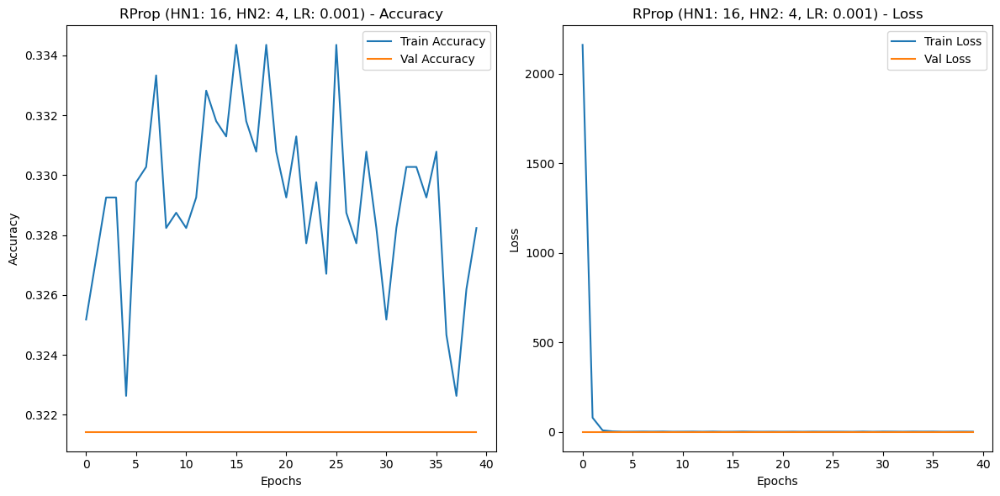


[INFO] Training Adam optimizer with 16 first hidden neurons, 4 second hidden neurons, and 0.01 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 84ms/step - accuracy: 0.3356 - loss: 2527.3584 - val_accuracy: 0.3405 - val_loss: 1.1103
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 76ms/step - accuracy: 0.3266 - loss: 64.7702 - val_accuracy: 0.3405 - val_loss: 1.1032
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 71ms/step - accuracy: 0.3263 - loss: 27.8492 - val_accuracy: 0.3405 - val_loss: 1.0986
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 74ms/step - accuracy: 0.3433 - loss: 9.5230 - val_accuracy: 0.3405 - val_loss: 1.0984
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 75ms/step - accuracy: 0.3518 - loss: 2.1440 - val_accuracy: 0.3405 - val_loss: 1.0984
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 85ms/step - accuracy: 0.3352 - loss: 2.1778 - val_accuracy: 0.3214 - val_loss: 1.0992
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 76ms/step - accuracy: 0.3447 - loss: 2.4017 - val_accuracy: 0.3405 - val_loss: 1.

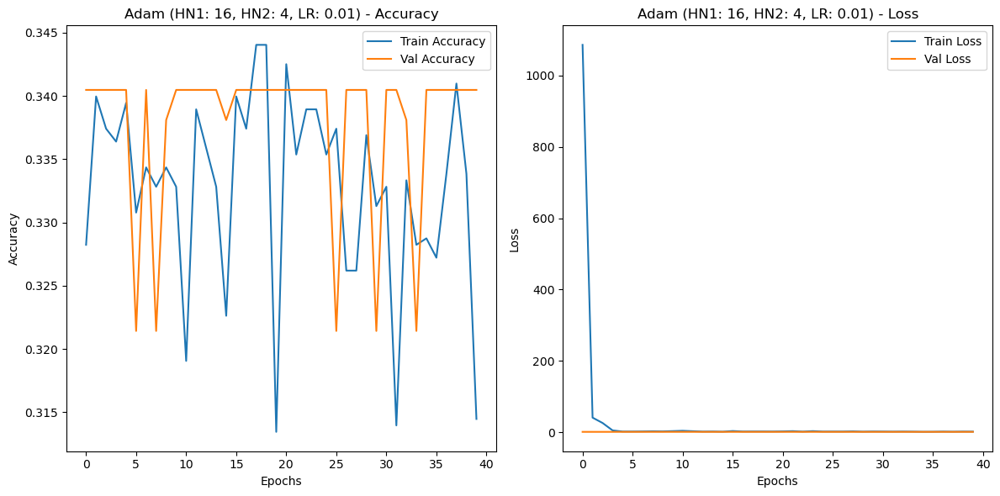


[INFO] Training RProp optimizer with 16 first hidden neurons, 4 second hidden neurons, and 0.01 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3371 - loss: 12042.8125 - val_accuracy: 0.3381 - val_loss: 1.1024
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 48ms/step - accuracy: 0.3157 - loss: 10.0113 - val_accuracy: 0.3381 - val_loss: 1.1008
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 52ms/step - accuracy: 0.3331 - loss: 5.4356 - val_accuracy: 0.3381 - val_loss: 1.1006
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 48ms/step - accuracy: 0.3263 - loss: 2.4735 - val_accuracy: 0.3381 - val_loss: 1.1006
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 53ms/step - accuracy: 0.3165 - loss: 3.6568 - val_accuracy: 0.3381 - val_loss: 1.1006
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 56ms/step - accuracy: 0.3335 - loss: 1.9898 - val_accuracy: 0.3381 - val_loss: 1.1006
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 50ms/step - accuracy: 0.3336 - loss: 2.2767 - val_accuracy: 0.3381 - val_loss: 1

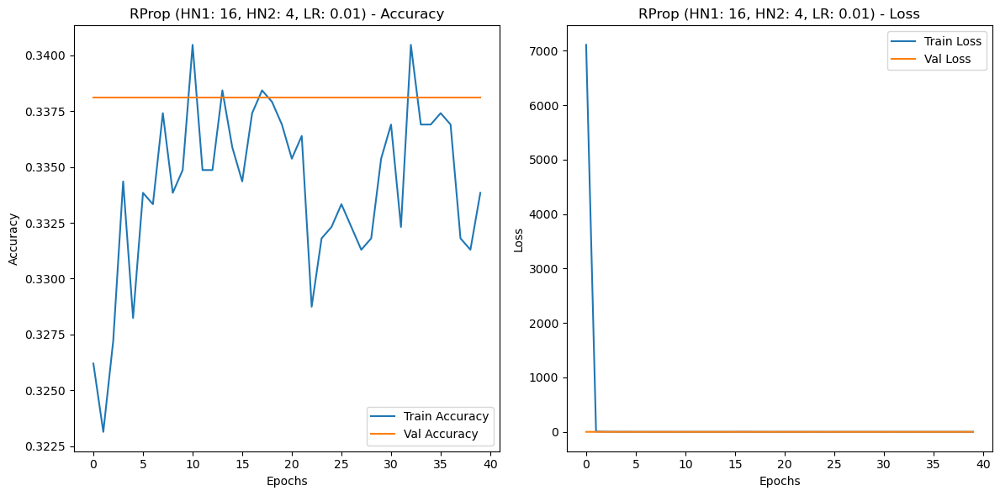


[INFO] Training Adam optimizer with 16 first hidden neurons, 4 second hidden neurons, and 0.1 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 70ms/step - accuracy: 0.3159 - loss: 1790.1686 - val_accuracy: 0.3214 - val_loss: 1.1003
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 81ms/step - accuracy: 0.3154 - loss: 1.1009 - val_accuracy: 0.3405 - val_loss: 1.0985
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.3388 - loss: 1.1007 - val_accuracy: 0.3405 - val_loss: 1.1039
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 80ms/step - accuracy: 0.3216 - loss: 1.1050 - val_accuracy: 0.3405 - val_loss: 1.1019
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 82ms/step - accuracy: 0.3387 - loss: 1.1021 - val_accuracy: 0.3405 - val_loss: 1.1080
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 83ms/step - accuracy: 0.3226 - loss: 1.1064 - val_accuracy: 0.3405 - val_loss: 1.1003
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 83ms/step - accuracy: 0.3406 - loss: 1.1012 - val_accuracy: 0.3405 - val_loss: 1.102

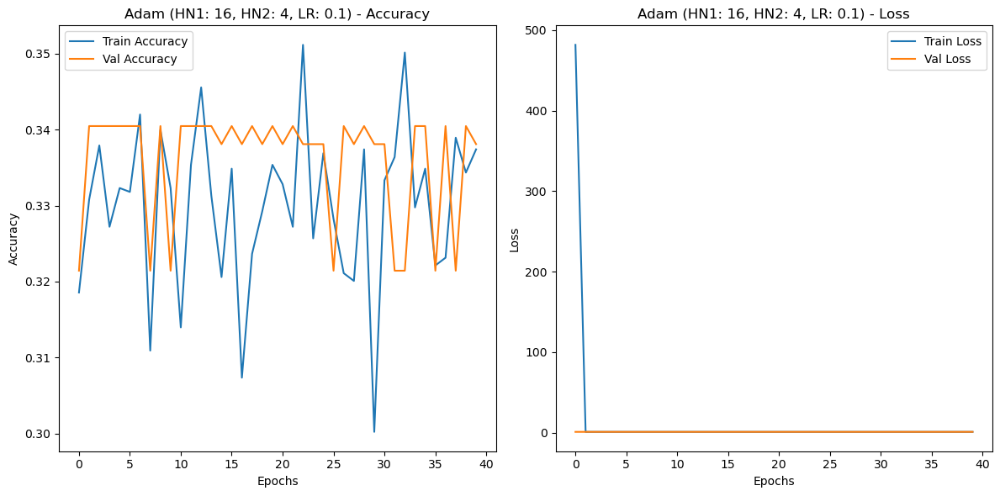


[INFO] Training RProp optimizer with 16 first hidden neurons, 4 second hidden neurons, and 0.1 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 50ms/step - accuracy: 0.3371 - loss: 4202.2109 - val_accuracy: 0.3381 - val_loss: 1.1000
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3333 - loss: 1.2188 - val_accuracy: 0.3381 - val_loss: 1.0995
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 68ms/step - accuracy: 0.3240 - loss: 1.1451 - val_accuracy: 0.3405 - val_loss: 1.0989
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 58ms/step - accuracy: 0.3423 - loss: 1.1332 - val_accuracy: 0.3405 - val_loss: 1.0989
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 58ms/step - accuracy: 0.3643 - loss: 1.1222 - val_accuracy: 0.3405 - val_loss: 1.0989
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3295 - loss: 1.1249 - val_accuracy: 0.3405 - val_loss: 1.0989
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3495 - loss: 1.1101 - val_accuracy: 0.3405 - val_loss: 1.09

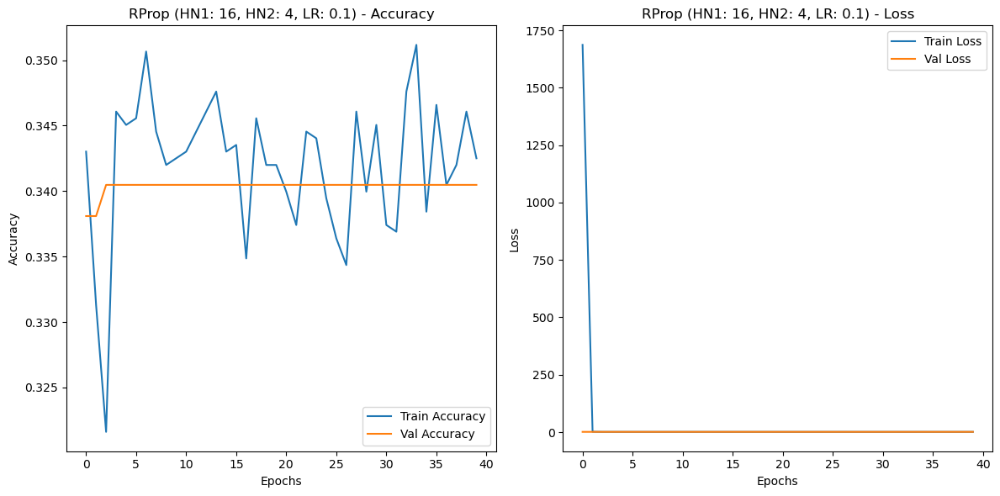


[INFO] Training Adam optimizer with 16 first hidden neurons, 8 second hidden neurons, and 0.0001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - accuracy: 0.3439 - loss: 14614.1660 - val_accuracy: 0.3214 - val_loss: 11082.2588
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3351 - loss: 14703.7432 - val_accuracy: 0.3214 - val_loss: 9988.8633
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3389 - loss: 12753.2109 - val_accuracy: 0.3214 - val_loss: 9020.8057
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3235 - loss: 12899.6475 - val_accuracy: 0.3214 - val_loss: 8052.9761
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3235 - loss: 11925.3760 - val_accuracy: 0.3214 - val_loss: 7109.3442
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3553 - loss: 10930.7910 - val_accuracy: 0.3214 - val_loss: 6272.7661
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3266 - loss: 1038

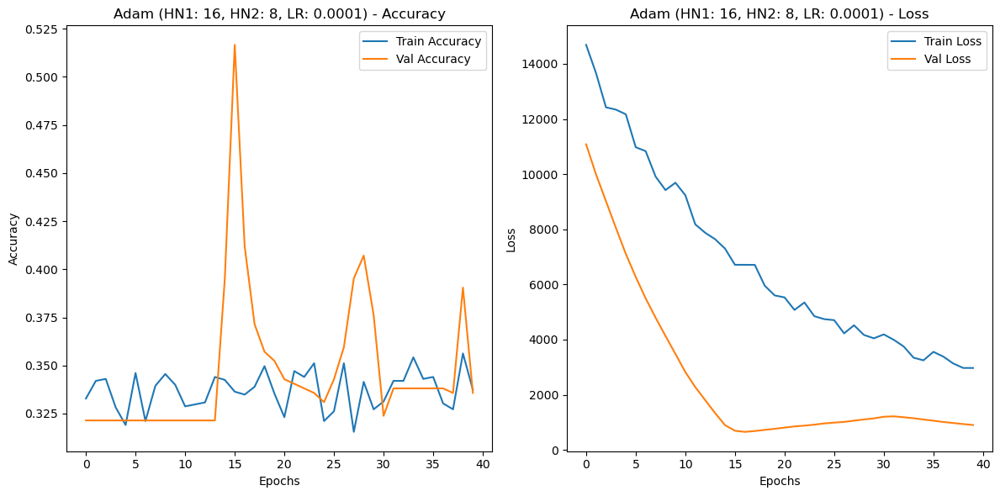


[INFO] Training RProp optimizer with 16 first hidden neurons, 8 second hidden neurons, and 0.0001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3159 - loss: 5827.8735 - val_accuracy: 0.3238 - val_loss: 1027.1561
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3503 - loss: 4193.4741 - val_accuracy: 0.3929 - val_loss: 8.5584
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3312 - loss: 1470.7025 - val_accuracy: 0.3214 - val_loss: 57.6370
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3236 - loss: 482.4276 - val_accuracy: 0.3381 - val_loss: 1.0986
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3319 - loss: 285.1572 - val_accuracy: 0.3381 - val_loss: 1.0986
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3358 - loss: 181.3647 - val_accuracy: 0.3381 - val_loss: 1.0986
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3125 - loss: 195.7989 - val_accuracy: 0.

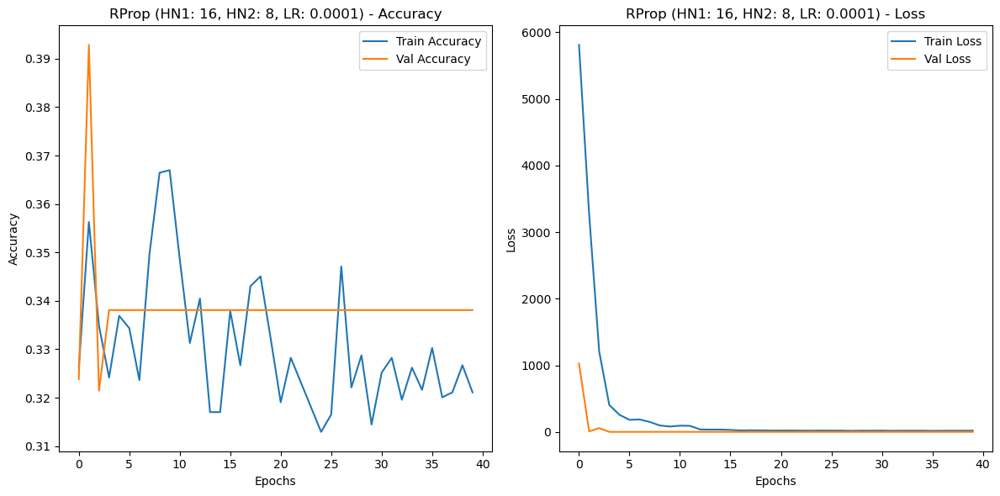


[INFO] Training Adam optimizer with 16 first hidden neurons, 8 second hidden neurons, and 0.001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - accuracy: 0.3160 - loss: 1492.7545 - val_accuracy: 0.3381 - val_loss: 111.2396
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3451 - loss: 634.0543 - val_accuracy: 0.3214 - val_loss: 36.6231
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3502 - loss: 433.3947 - val_accuracy: 0.3381 - val_loss: 14.5560
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3069 - loss: 329.1096 - val_accuracy: 0.3452 - val_loss: 2.5187
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3233 - loss: 150.9254 - val_accuracy: 0.3214 - val_loss: 1.1664
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3313 - loss: 118.0745 - val_accuracy: 0.3214 - val_loss: 1.1667
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3095 - loss: 84.3652 - val_accuracy: 0.3619 

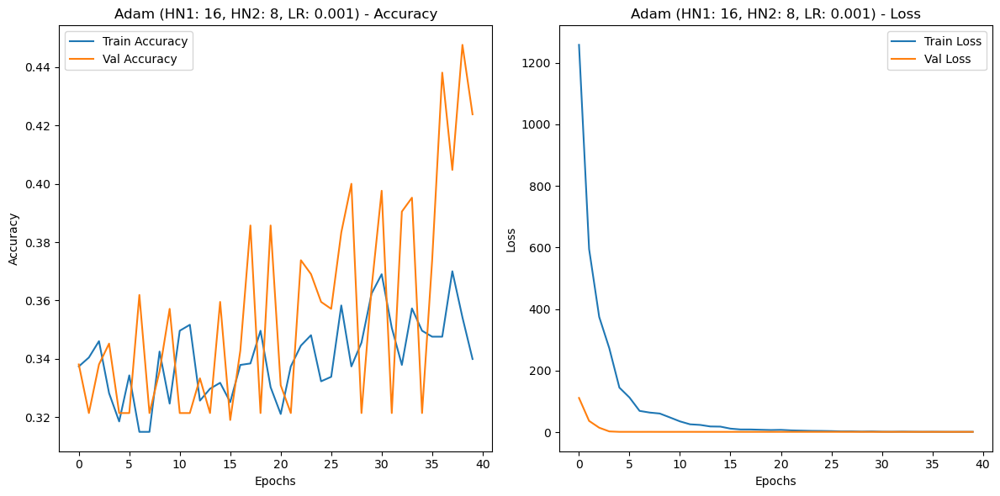


[INFO] Training RProp optimizer with 16 first hidden neurons, 8 second hidden neurons, and 0.001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 57ms/step - accuracy: 0.3391 - loss: 8900.0410 - val_accuracy: 0.3381 - val_loss: 666.5960
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3386 - loss: 1664.0637 - val_accuracy: 0.3524 - val_loss: 12.3162
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3547 - loss: 186.6376 - val_accuracy: 0.3405 - val_loss: 1.0990
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3412 - loss: 43.1928 - val_accuracy: 0.3405 - val_loss: 1.0990
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3402 - loss: 12.6775 - val_accuracy: 0.3405 - val_loss: 1.0990
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3240 - loss: 10.2270 - val_accuracy: 0.3405 - val_loss: 1.0990
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 49ms/step - accuracy: 0.3421 - loss: 15.4087 - val_accuracy: 0.3405 - 

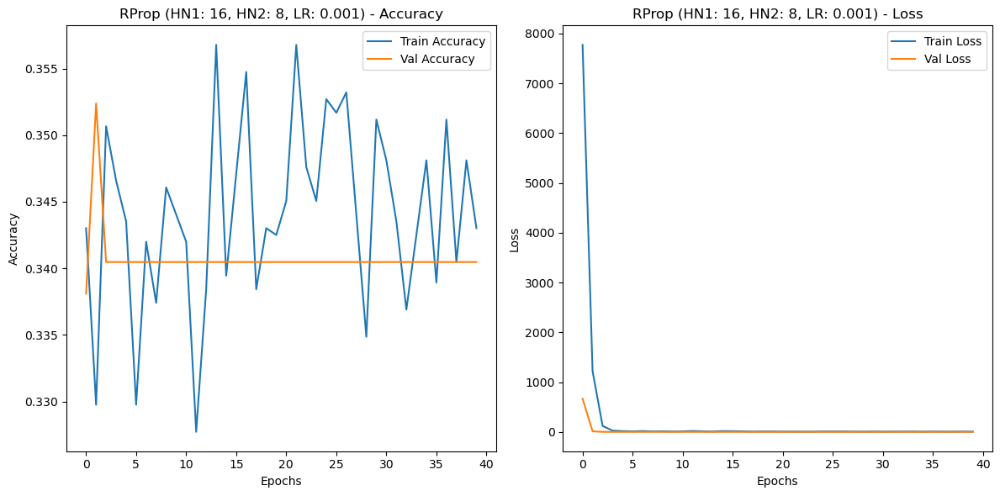


[INFO] Training Adam optimizer with 16 first hidden neurons, 8 second hidden neurons, and 0.01 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 78ms/step - accuracy: 0.3512 - loss: 4998.1299 - val_accuracy: 0.5381 - val_loss: 66.2625
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3696 - loss: 36.0764 - val_accuracy: 0.3571 - val_loss: 1.2492
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3563 - loss: 1.5060 - val_accuracy: 0.3500 - val_loss: 1.1420
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3472 - loss: 1.5090 - val_accuracy: 0.3381 - val_loss: 1.1101
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3340 - loss: 1.2126 - val_accuracy: 0.3333 - val_loss: 1.1071
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3272 - loss: 1.1680 - val_accuracy: 0.3333 - val_loss: 1.1046
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3275 - loss: 1.1195 - val_accuracy: 0.3310 - val_loss: 1.

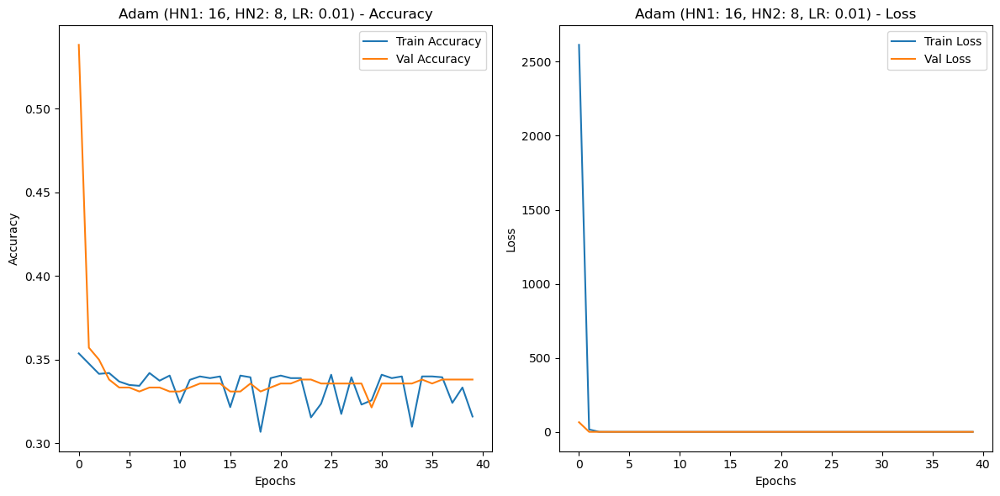


[INFO] Training RProp optimizer with 16 first hidden neurons, 8 second hidden neurons, and 0.01 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3128 - loss: 3867.3394 - val_accuracy: 0.3214 - val_loss: 1.1076
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3313 - loss: 259.8607 - val_accuracy: 0.3214 - val_loss: 1.1030
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3350 - loss: 79.5546 - val_accuracy: 0.3214 - val_loss: 1.1031
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3372 - loss: 47.3679 - val_accuracy: 0.3214 - val_loss: 1.1031
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3491 - loss: 39.3165 - val_accuracy: 0.3214 - val_loss: 1.1031
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3336 - loss: 26.1501 - val_accuracy: 0.3214 - val_loss: 1.1031
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3548 - loss: 20.2938 - val_accuracy: 0.3214 - val_lo

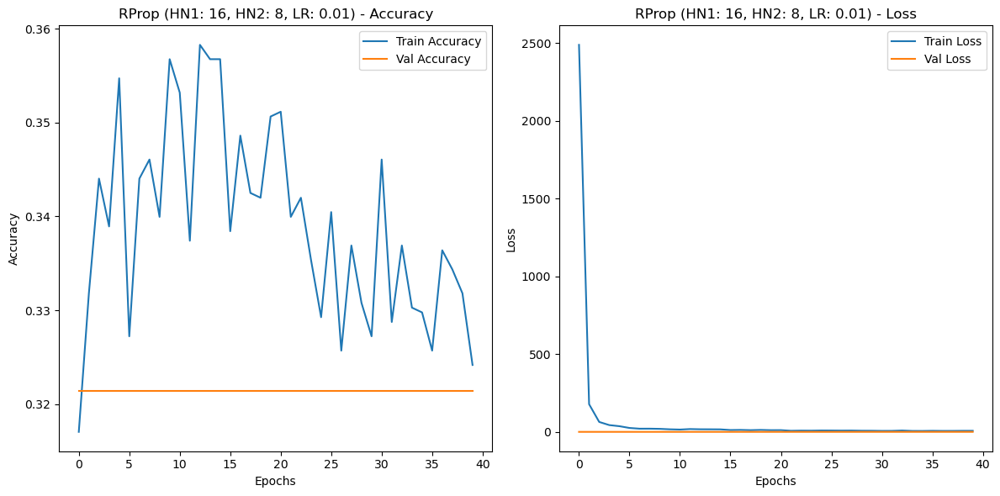


[INFO] Training Adam optimizer with 16 first hidden neurons, 8 second hidden neurons, and 0.1 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3323 - loss: 2181.4661 - val_accuracy: 0.3214 - val_loss: 1.1082
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3442 - loss: 1.0984 - val_accuracy: 0.3405 - val_loss: 1.0999
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3381 - loss: 1.0991 - val_accuracy: 0.3405 - val_loss: 1.1051
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3345 - loss: 1.1054 - val_accuracy: 0.3405 - val_loss: 1.1045
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3033 - loss: 1.1082 - val_accuracy: 0.3405 - val_loss: 1.1047
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3262 - loss: 1.1039 - val_accuracy: 0.3405 - val_loss: 1.0993
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3385 - loss: 1.1008 - val_accuracy: 0.3405 - val_loss: 1.108

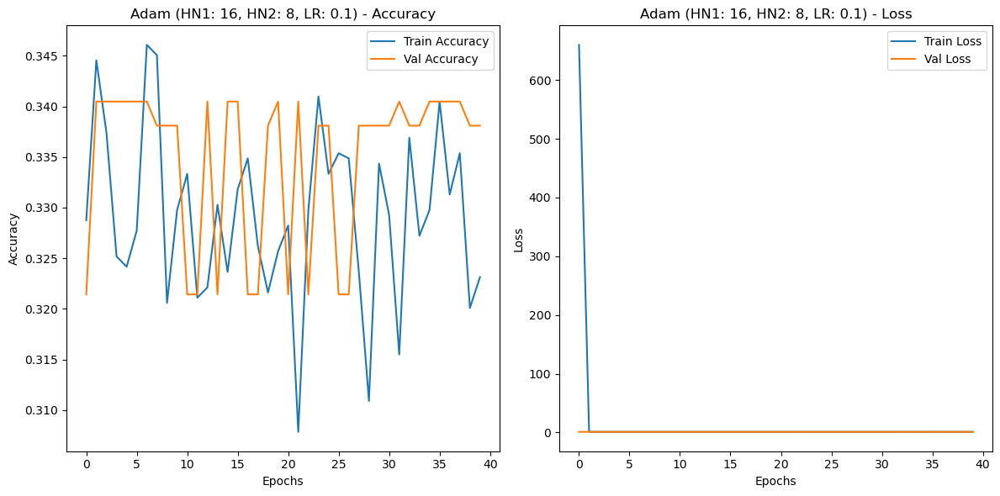


[INFO] Training RProp optimizer with 16 first hidden neurons, 8 second hidden neurons, and 0.1 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 48ms/step - accuracy: 0.3299 - loss: 2164.3452 - val_accuracy: 0.3214 - val_loss: 1.1003
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3534 - loss: 3.8287 - val_accuracy: 0.3214 - val_loss: 1.1003
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3525 - loss: 2.0660 - val_accuracy: 0.3214 - val_loss: 1.1003
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3427 - loss: 3.3933 - val_accuracy: 0.3214 - val_loss: 1.1003
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3449 - loss: 2.0416 - val_accuracy: 0.3214 - val_loss: 1.1003
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3530 - loss: 1.9335 - val_accuracy: 0.3214 - val_loss: 1.1003
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3542 - loss: 1.5355 - val_accuracy: 0.3214 - val_loss: 1.10

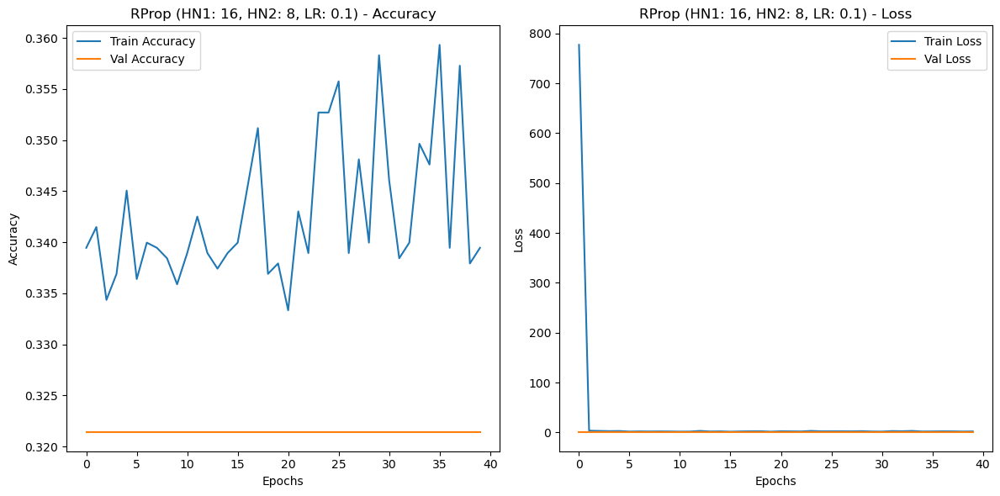


[INFO] Training Adam optimizer with 16 first hidden neurons, 16 second hidden neurons, and 0.0001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3411 - loss: 3112.4980 - val_accuracy: 0.3405 - val_loss: 1530.6917
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3277 - loss: 3229.2966 - val_accuracy: 0.3405 - val_loss: 1363.9327
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3258 - loss: 3128.0247 - val_accuracy: 0.3405 - val_loss: 1208.4437
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3184 - loss: 2940.3623 - val_accuracy: 0.3405 - val_loss: 1074.5116
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3335 - loss: 2704.2219 - val_accuracy: 0.3405 - val_loss: 953.3786
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3331 - loss: 2426.2871 - val_accuracy: 0.3405 - val_loss: 866.7011
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3403 - loss: 2488.0012 - 

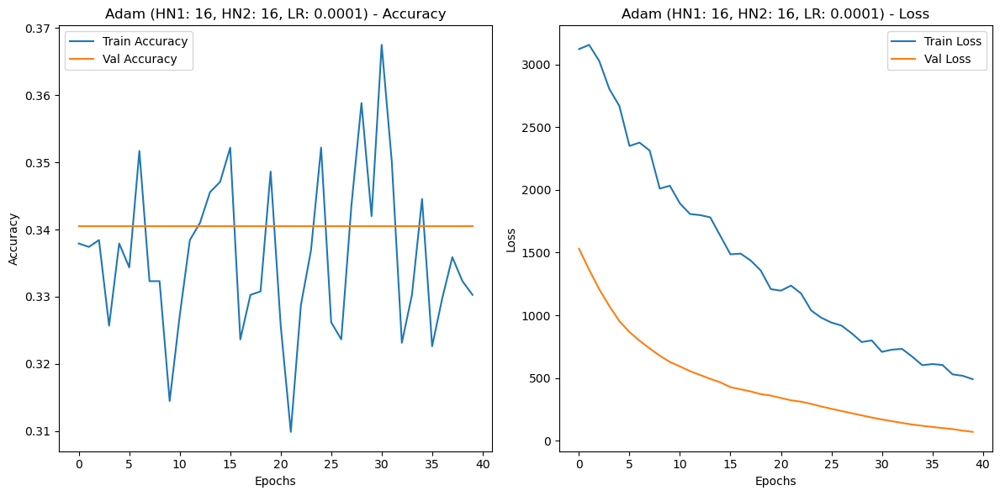


[INFO] Training RProp optimizer with 16 first hidden neurons, 16 second hidden neurons, and 0.0001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3197 - loss: 5649.0737 - val_accuracy: 0.3381 - val_loss: 814.1135
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3181 - loss: 4798.0527 - val_accuracy: 0.3381 - val_loss: 730.0526
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3493 - loss: 2413.9385 - val_accuracy: 0.3381 - val_loss: 881.0298
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3426 - loss: 2034.3236 - val_accuracy: 0.3381 - val_loss: 495.6837
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3256 - loss: 1514.9729 - val_accuracy: 0.3381 - val_loss: 143.5393
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3177 - loss: 968.8821 - val_accuracy: 0.3381 - val_loss: 42.3661
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3579 - loss: 623.6356 - val_ac

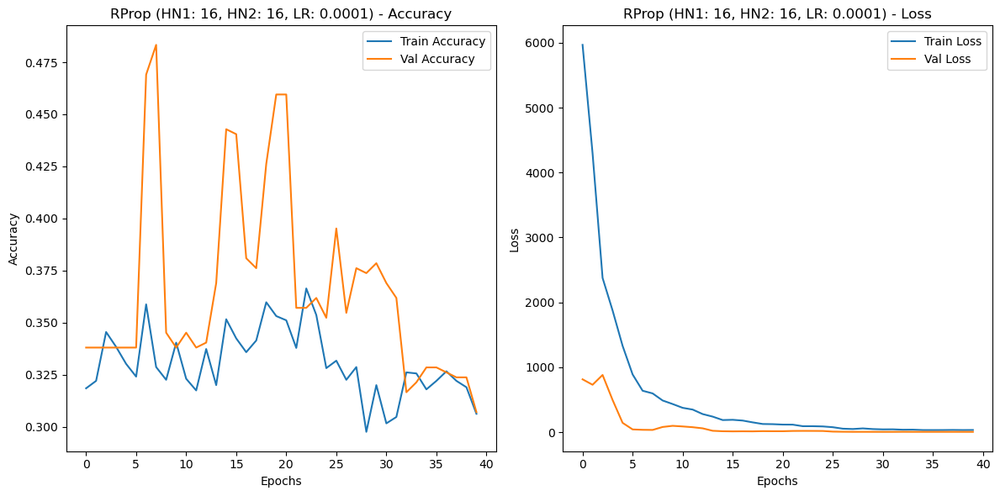


[INFO] Training Adam optimizer with 16 first hidden neurons, 16 second hidden neurons, and 0.001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3223 - loss: 6180.3115 - val_accuracy: 0.3214 - val_loss: 930.3405
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3365 - loss: 4054.9185 - val_accuracy: 0.4238 - val_loss: 591.3851
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3530 - loss: 2744.1223 - val_accuracy: 0.4833 - val_loss: 339.8927
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3336 - loss: 1842.5391 - val_accuracy: 0.4381 - val_loss: 217.1898
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3488 - loss: 1185.3962 - val_accuracy: 0.4738 - val_loss: 136.5328
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3519 - loss: 864.6179 - val_accuracy: 0.4429 - val_loss: 127.8495
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3537 - loss: 537.0284 - val_acc

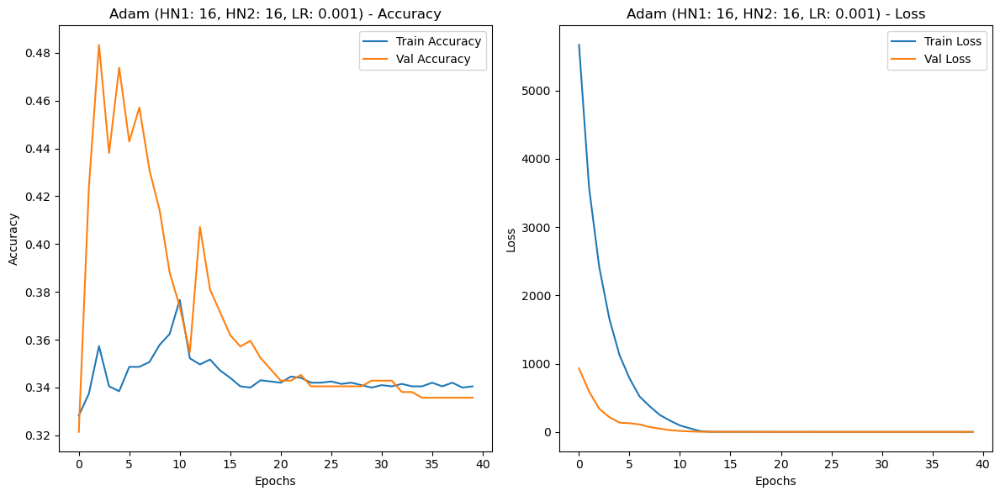


[INFO] Training RProp optimizer with 16 first hidden neurons, 16 second hidden neurons, and 0.001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3373 - loss: 8417.9102 - val_accuracy: 0.3214 - val_loss: 512.0648
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3557 - loss: 820.6273 - val_accuracy: 0.3667 - val_loss: 50.9316
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3404 - loss: 79.0573 - val_accuracy: 0.3667 - val_loss: 5.6963
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3320 - loss: 8.0213 - val_accuracy: 0.3238 - val_loss: 1.4290
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3266 - loss: 1.4874 - val_accuracy: 0.3190 - val_loss: 1.3774
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3302 - loss: 1.7023 - val_accuracy: 0.3214 - val_loss: 1.3919
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3170 - loss: 1.3504 - val_accuracy: 0.3214 - val_l

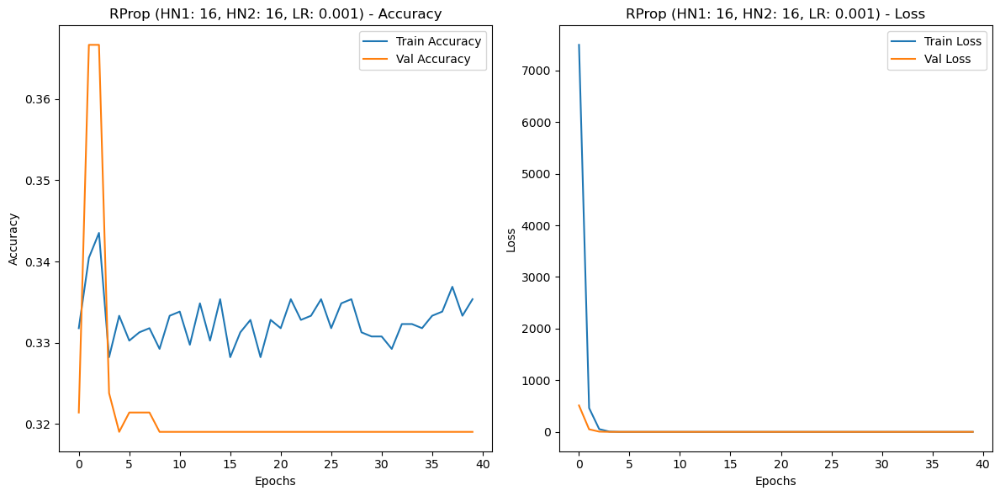


[INFO] Training Adam optimizer with 16 first hidden neurons, 16 second hidden neurons, and 0.01 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3312 - loss: 6271.3872 - val_accuracy: 0.3381 - val_loss: 1.1028
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3203 - loss: 241.2621 - val_accuracy: 0.3381 - val_loss: 1.1041
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3276 - loss: 33.3939 - val_accuracy: 0.3381 - val_loss: 1.0995
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3250 - loss: 9.1235 - val_accuracy: 0.3214 - val_loss: 1.1034
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3300 - loss: 1.2848 - val_accuracy: 0.3214 - val_loss: 1.0993
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3257 - loss: 1.0991 - val_accuracy: 0.3405 - val_loss: 1.0984
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3317 - loss: 1.0988 - val_accuracy: 0.3405 - val_loss: 

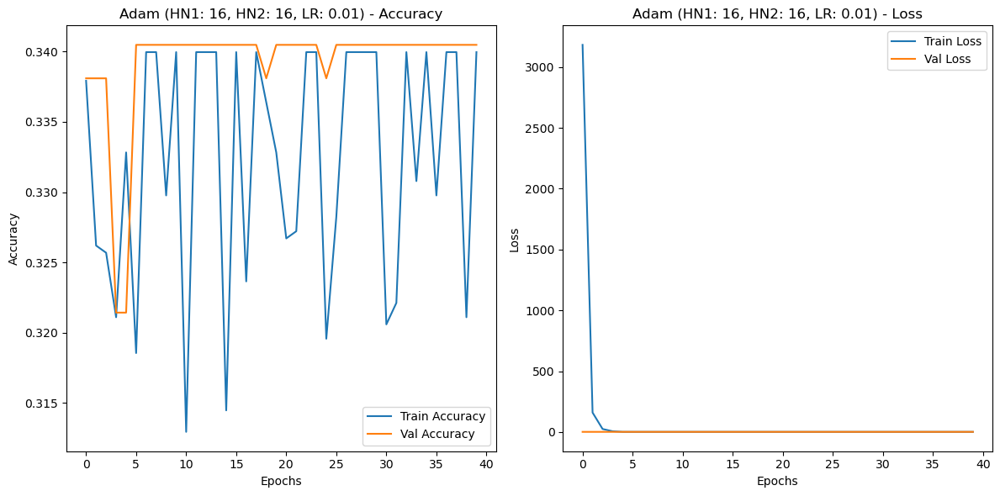


[INFO] Training RProp optimizer with 16 first hidden neurons, 16 second hidden neurons, and 0.01 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 58ms/step - accuracy: 0.3127 - loss: 8745.8955 - val_accuracy: 0.4762 - val_loss: 159.6905
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3285 - loss: 1693.0604 - val_accuracy: 0.3405 - val_loss: 79.7841
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3312 - loss: 522.9598 - val_accuracy: 0.2024 - val_loss: 16.3295
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3329 - loss: 254.3928 - val_accuracy: 0.3190 - val_loss: 22.7217
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3250 - loss: 190.1597 - val_accuracy: 0.3262 - val_loss: 1.1853
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3367 - loss: 138.4927 - val_accuracy: 0.3024 - val_loss: 1.2641
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3485 - loss: 117.8660 - val_accuracy: 0.2

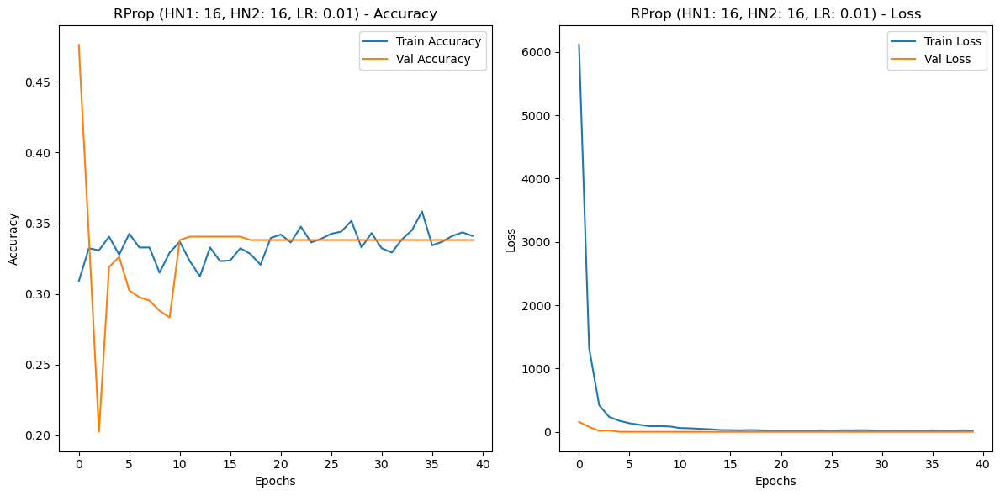


[INFO] Training Adam optimizer with 16 first hidden neurons, 16 second hidden neurons, and 0.1 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3519 - loss: 1168.6022 - val_accuracy: 0.3381 - val_loss: 1.0992
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3200 - loss: 1.1004 - val_accuracy: 0.3381 - val_loss: 1.0986
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3384 - loss: 1.1011 - val_accuracy: 0.3405 - val_loss: 1.0984
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3563 - loss: 1.0996 - val_accuracy: 0.3381 - val_loss: 1.1019
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3324 - loss: 1.1027 - val_accuracy: 0.3405 - val_loss: 1.0984
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3446 - loss: 1.1000 - val_accuracy: 0.3405 - val_loss: 1.0984
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - accuracy: 0.3394 - loss: 1.1006 - val_accuracy: 0.3214 - val_loss: 1.10

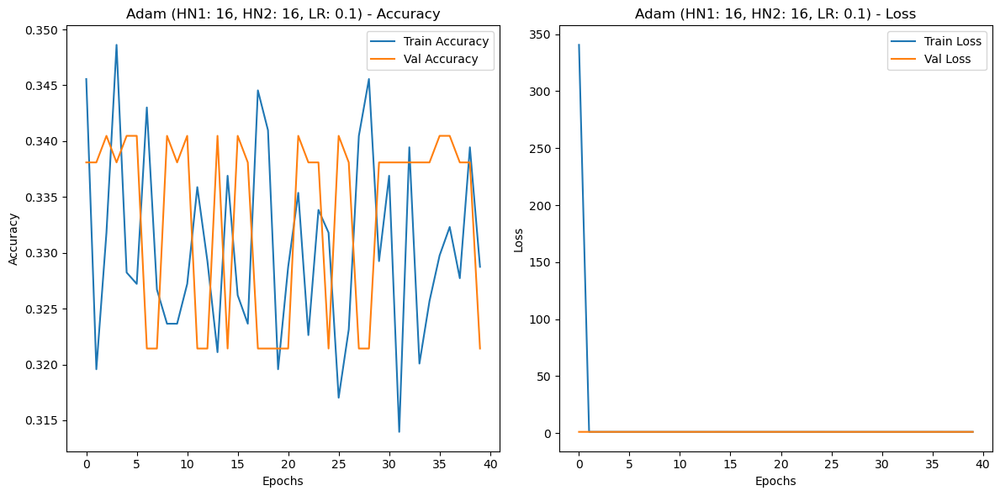


[INFO] Training RProp optimizer with 16 first hidden neurons, 16 second hidden neurons, and 0.1 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3236 - loss: 7746.5732 - val_accuracy: 0.3929 - val_loss: 2.4906
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3467 - loss: 135.2887 - val_accuracy: 0.3405 - val_loss: 1.1006
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3387 - loss: 22.9492 - val_accuracy: 0.3405 - val_loss: 1.1006
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3148 - loss: 12.3538 - val_accuracy: 0.3405 - val_loss: 1.1006
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 48ms/step - accuracy: 0.3208 - loss: 12.6665 - val_accuracy: 0.3405 - val_loss: 1.1006
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3374 - loss: 6.4632 - val_accuracy: 0.3405 - val_loss: 1.1006
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3467 - loss: 6.5157 - val_accuracy: 0.3405 - val_loss

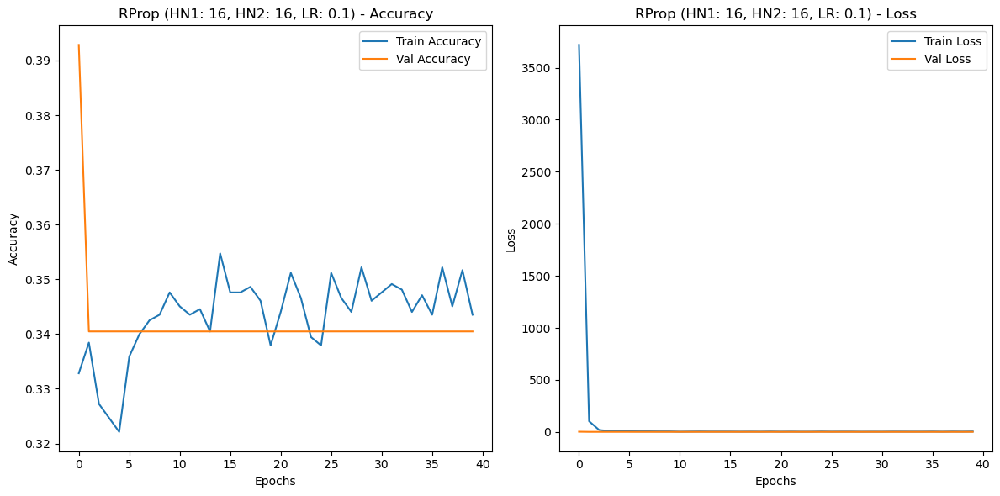


[INFO] Training Adam optimizer with 16 first hidden neurons, 32 second hidden neurons, and 0.0001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - accuracy: 0.3509 - loss: 8972.5420 - val_accuracy: 0.3381 - val_loss: 6942.3594
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3280 - loss: 8695.1973 - val_accuracy: 0.3381 - val_loss: 6280.3013
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3075 - loss: 7906.4614 - val_accuracy: 0.3381 - val_loss: 5643.6138
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3061 - loss: 7590.4678 - val_accuracy: 0.3381 - val_loss: 5079.5952
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3048 - loss: 7144.8423 - val_accuracy: 0.3381 - val_loss: 4557.4780
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3085 - loss: 6968.2104 - val_accuracy: 0.3381 - val_loss: 4046.4080
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3517 - loss: 5583.7988 

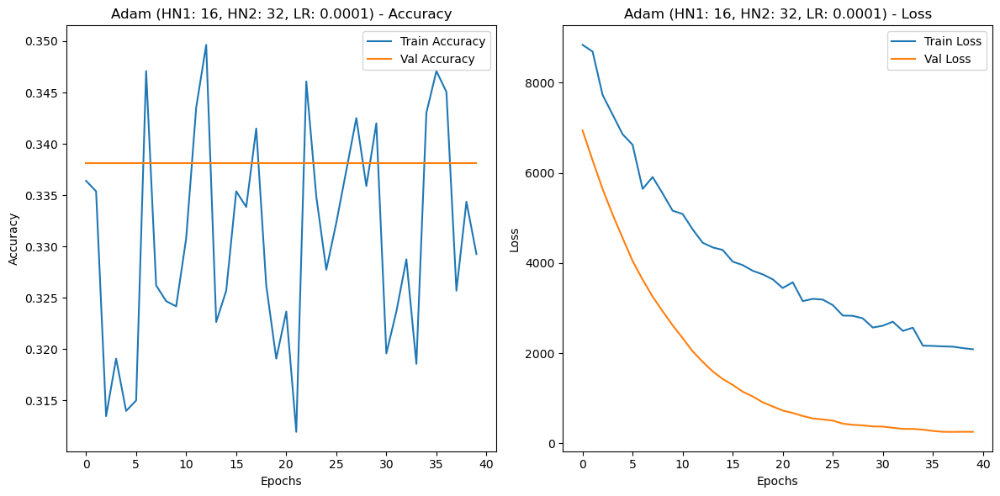


[INFO] Training RProp optimizer with 16 first hidden neurons, 32 second hidden neurons, and 0.0001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 48ms/step - accuracy: 0.3467 - loss: 10551.0801 - val_accuracy: 0.3381 - val_loss: 2738.8691
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3435 - loss: 7708.4712 - val_accuracy: 0.3214 - val_loss: 1262.8422
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3237 - loss: 4803.3169 - val_accuracy: 0.3214 - val_loss: 1436.5721
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3470 - loss: 3689.6213 - val_accuracy: 0.3214 - val_loss: 1003.0541
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3293 - loss: 2715.3220 - val_accuracy: 0.5214 - val_loss: 386.6534
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3485 - loss: 1680.4015 - val_accuracy: 0.2833 - val_loss: 127.4396
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3110 - loss: 1343.1073 

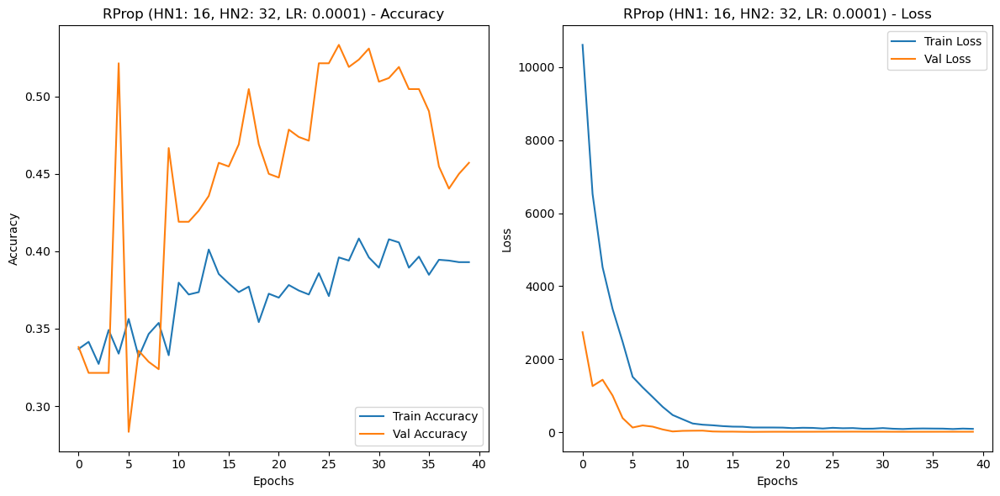


[INFO] Training Adam optimizer with 16 first hidden neurons, 32 second hidden neurons, and 0.001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 69ms/step - accuracy: 0.3380 - loss: 5421.6089 - val_accuracy: 0.3214 - val_loss: 646.5529
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 71ms/step - accuracy: 0.3625 - loss: 3108.8997 - val_accuracy: 0.3571 - val_loss: 613.9063
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 79ms/step - accuracy: 0.3675 - loss: 2251.6475 - val_accuracy: 0.3643 - val_loss: 450.4145
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 74ms/step - accuracy: 0.3415 - loss: 1450.9497 - val_accuracy: 0.4238 - val_loss: 230.6375
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 68ms/step - accuracy: 0.3699 - loss: 1015.3834 - val_accuracy: 0.5357 - val_loss: 126.7479
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 76ms/step - accuracy: 0.3980 - loss: 772.8521 - val_accuracy: 0.5619 - val_loss: 90.1801
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 85ms/step - accuracy: 0.3348 - loss: 563.5498 - val_accu

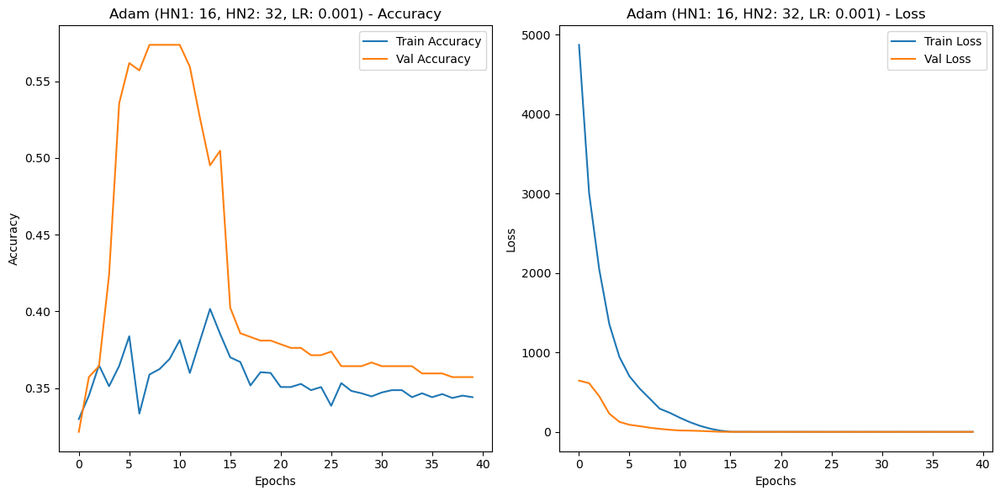


[INFO] Training RProp optimizer with 16 first hidden neurons, 32 second hidden neurons, and 0.001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 52ms/step - accuracy: 0.3372 - loss: 8066.7666 - val_accuracy: 0.3405 - val_loss: 668.3171
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 50ms/step - accuracy: 0.3113 - loss: 1449.1730 - val_accuracy: 0.3857 - val_loss: 77.8422
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 52ms/step - accuracy: 0.3296 - loss: 732.2729 - val_accuracy: 0.3381 - val_loss: 85.5990
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 53ms/step - accuracy: 0.2829 - loss: 235.3547 - val_accuracy: 0.1310 - val_loss: 11.4125
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3030 - loss: 26.9627 - val_accuracy: 0.3119 - val_loss: 6.8920
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 50ms/step - accuracy: 0.3245 - loss: 28.3790 - val_accuracy: 0.3524 - val_loss: 3.5072
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 51ms/step - accuracy: 0.3506 - loss: 7.6589 - val_accuracy: 0.3619

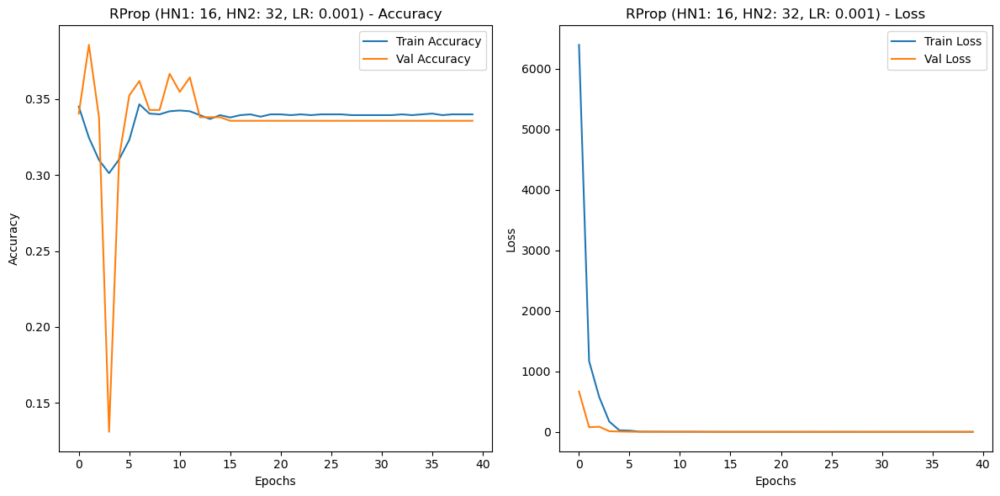


[INFO] Training Adam optimizer with 16 first hidden neurons, 32 second hidden neurons, and 0.01 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 71ms/step - accuracy: 0.3099 - loss: 4149.4937 - val_accuracy: 0.3381 - val_loss: 121.9359
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - accuracy: 0.3308 - loss: 117.5917 - val_accuracy: 0.3405 - val_loss: 1.0992
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 69ms/step - accuracy: 0.3255 - loss: 1.1006 - val_accuracy: 0.3405 - val_loss: 1.0986
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 71ms/step - accuracy: 0.3375 - loss: 1.0989 - val_accuracy: 0.3405 - val_loss: 1.0986
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 71ms/step - accuracy: 0.3546 - loss: 1.0982 - val_accuracy: 0.3405 - val_loss: 1.0985
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - accuracy: 0.3111 - loss: 1.0992 - val_accuracy: 0.3405 - val_loss: 1.0987
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 70ms/step - accuracy: 0.3328 - loss: 1.0987 - val_accuracy: 0.3405 - val_loss:

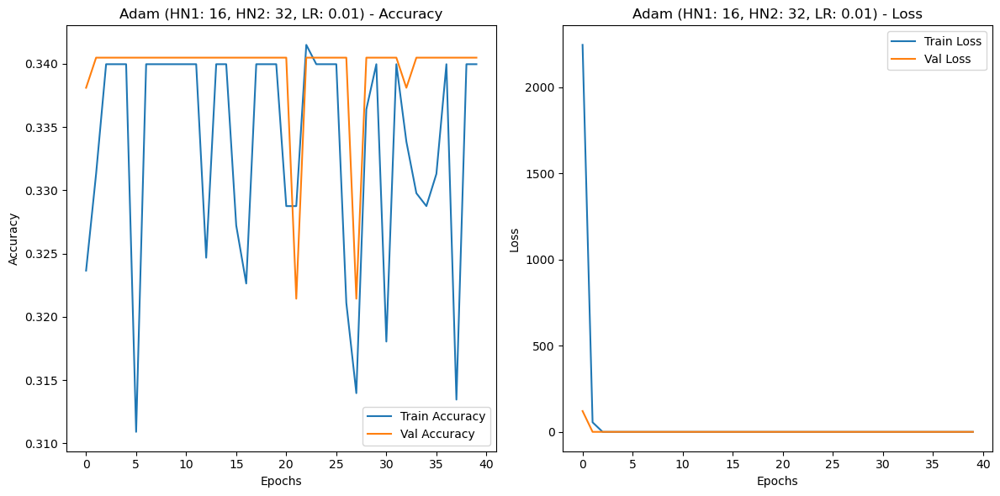


[INFO] Training RProp optimizer with 16 first hidden neurons, 32 second hidden neurons, and 0.01 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3196 - loss: 7545.5088 - val_accuracy: 0.3286 - val_loss: 76.2244
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3185 - loss: 1595.4288 - val_accuracy: 0.5286 - val_loss: 45.4519
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3898 - loss: 213.2430 - val_accuracy: 0.3810 - val_loss: 37.8151
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3637 - loss: 59.5939 - val_accuracy: 0.4190 - val_loss: 11.5337
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3641 - loss: 13.9412 - val_accuracy: 0.4833 - val_loss: 5.1408
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3688 - loss: 8.4421 - val_accuracy: 0.4810 - val_loss: 4.5974
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3928 - loss: 9.4514 - val_accuracy: 0.4762 - v

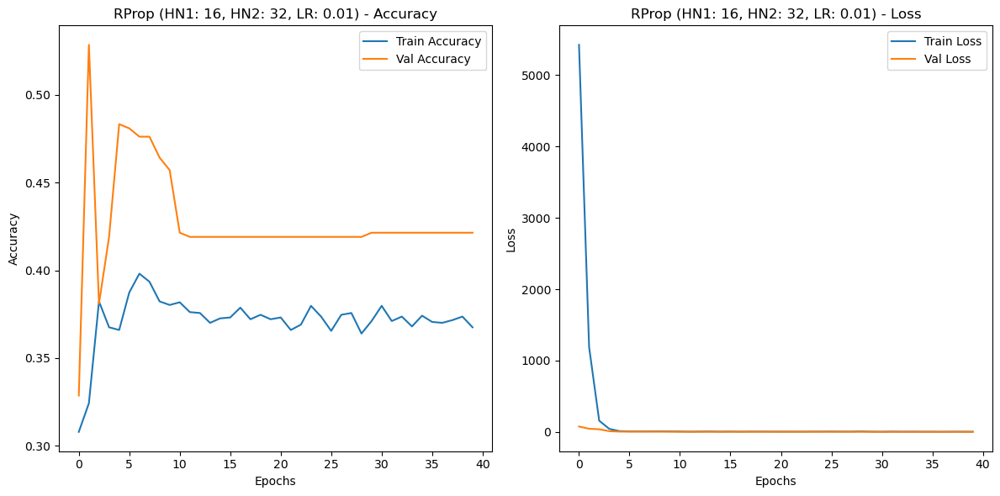


[INFO] Training Adam optimizer with 16 first hidden neurons, 32 second hidden neurons, and 0.1 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - accuracy: 0.3415 - loss: 1659.6194 - val_accuracy: 0.3405 - val_loss: 1.1003
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3008 - loss: 1.1025 - val_accuracy: 0.3405 - val_loss: 1.1003
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - accuracy: 0.3484 - loss: 1.0982 - val_accuracy: 0.3405 - val_loss: 1.1010
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3296 - loss: 1.1018 - val_accuracy: 0.3381 - val_loss: 1.0999
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3340 - loss: 1.1039 - val_accuracy: 0.3214 - val_loss: 1.1023
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3220 - loss: 1.1034 - val_accuracy: 0.3405 - val_loss: 1.1030
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3236 - loss: 1.1007 - val_accuracy: 0.3214 - val_loss: 1.09

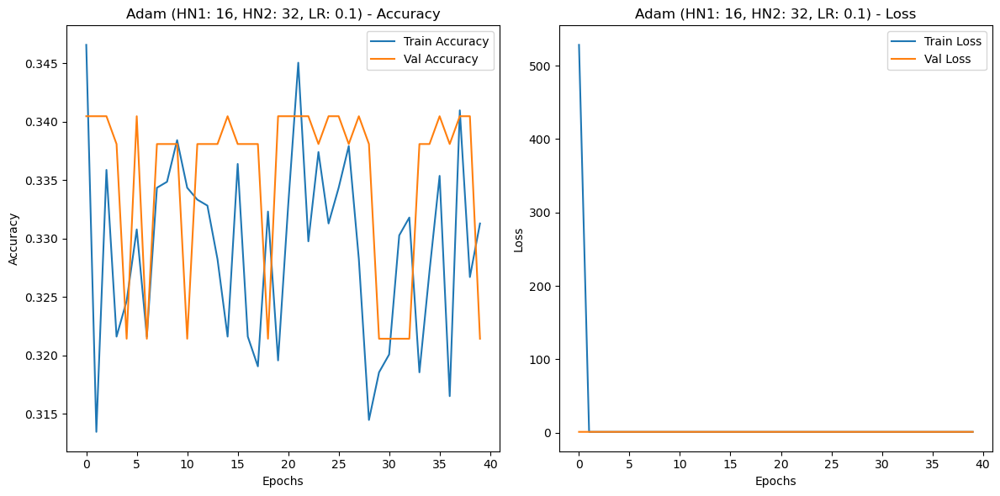


[INFO] Training RProp optimizer with 16 first hidden neurons, 32 second hidden neurons, and 0.1 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3206 - loss: 2924.3564 - val_accuracy: 0.4000 - val_loss: 24.6865
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3594 - loss: 150.5527 - val_accuracy: 0.5595 - val_loss: 11.9402
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3762 - loss: 100.2722 - val_accuracy: 0.5738 - val_loss: 11.3403
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3659 - loss: 97.2483 - val_accuracy: 0.5024 - val_loss: 8.7323
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3402 - loss: 71.0721 - val_accuracy: 0.4286 - val_loss: 7.6020
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3669 - loss: 68.6496 - val_accuracy: 0.4262 - val_loss: 6.6637
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3908 - loss: 63.0934 - val_accuracy: 0.5643 - va

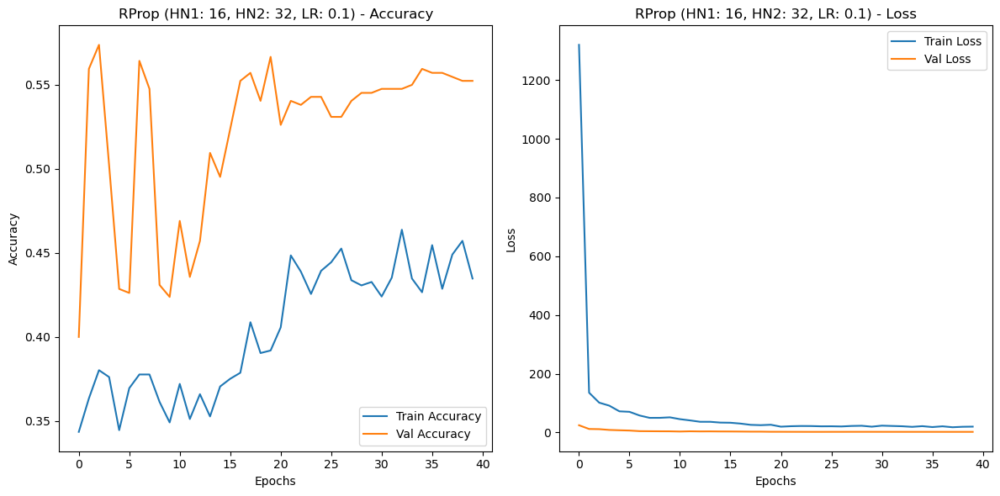


[INFO] Training Adam optimizer with 16 first hidden neurons, 64 second hidden neurons, and 0.0001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3436 - loss: 2721.6143 - val_accuracy: 0.3357 - val_loss: 161.6949
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3345 - loss: 2678.4504 - val_accuracy: 0.3810 - val_loss: 177.6912
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - accuracy: 0.3370 - loss: 2611.0278 - val_accuracy: 0.3381 - val_loss: 296.6523
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3418 - loss: 2257.9907 - val_accuracy: 0.3381 - val_loss: 392.7039
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 68ms/step - accuracy: 0.3551 - loss: 2361.0801 - val_accuracy: 0.3405 - val_loss: 413.2849
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3656 - loss: 2121.8555 - val_accuracy: 0.3405 - val_loss: 461.7437
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - accuracy: 0.3542 - loss: 2000.2784 - val_

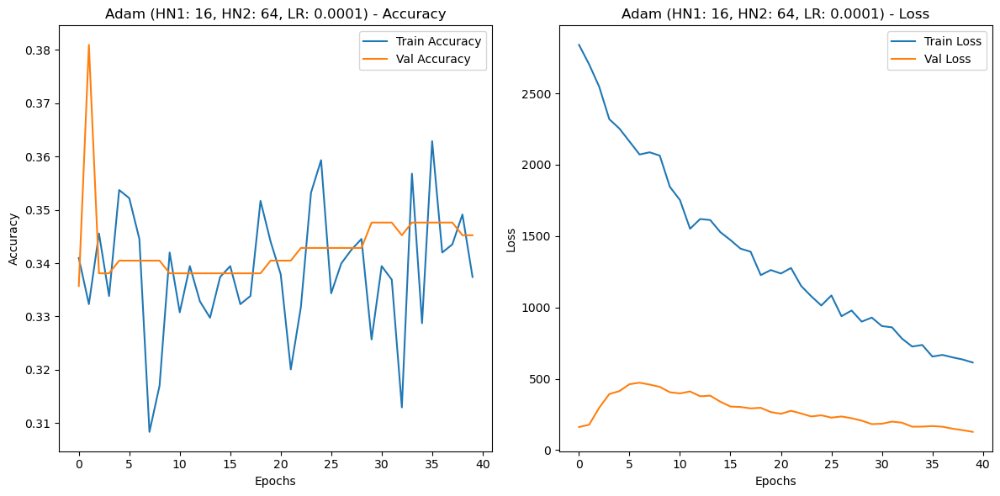


[INFO] Training RProp optimizer with 16 first hidden neurons, 64 second hidden neurons, and 0.0001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 48ms/step - accuracy: 0.3254 - loss: 11169.1572 - val_accuracy: 0.3381 - val_loss: 3972.2856
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3488 - loss: 6237.3345 - val_accuracy: 0.3405 - val_loss: 745.7072
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3330 - loss: 3477.1511 - val_accuracy: 0.3405 - val_loss: 978.8927
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3442 - loss: 2319.3953 - val_accuracy: 0.3476 - val_loss: 452.8707
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3412 - loss: 1675.1570 - val_accuracy: 0.4619 - val_loss: 55.7967
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3267 - loss: 1419.1681 - val_accuracy: 0.3619 - val_loss: 398.5163
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3270 - loss: 935.3282 - val

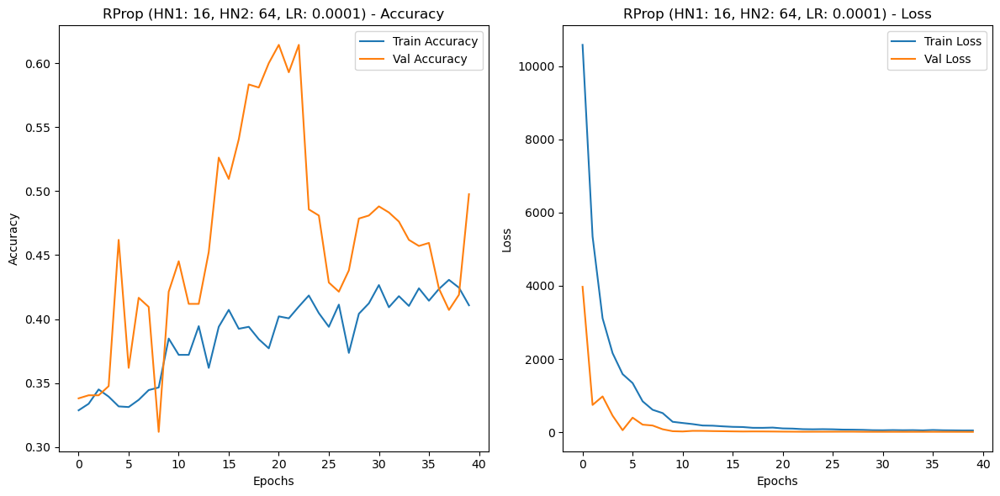


[INFO] Training Adam optimizer with 16 first hidden neurons, 64 second hidden neurons, and 0.001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - accuracy: 0.3366 - loss: 6311.5542 - val_accuracy: 0.3381 - val_loss: 1340.3140
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3427 - loss: 4063.9448 - val_accuracy: 0.3381 - val_loss: 556.3448
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3367 - loss: 3010.9548 - val_accuracy: 0.3238 - val_loss: 207.8511
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3474 - loss: 2170.2288 - val_accuracy: 0.3405 - val_loss: 118.8799
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3343 - loss: 1636.2467 - val_accuracy: 0.3214 - val_loss: 145.0647
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - accuracy: 0.3363 - loss: 1226.4941 - val_accuracy: 0.3048 - val_loss: 53.2290
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3468 - loss: 929.8227 - val_ac

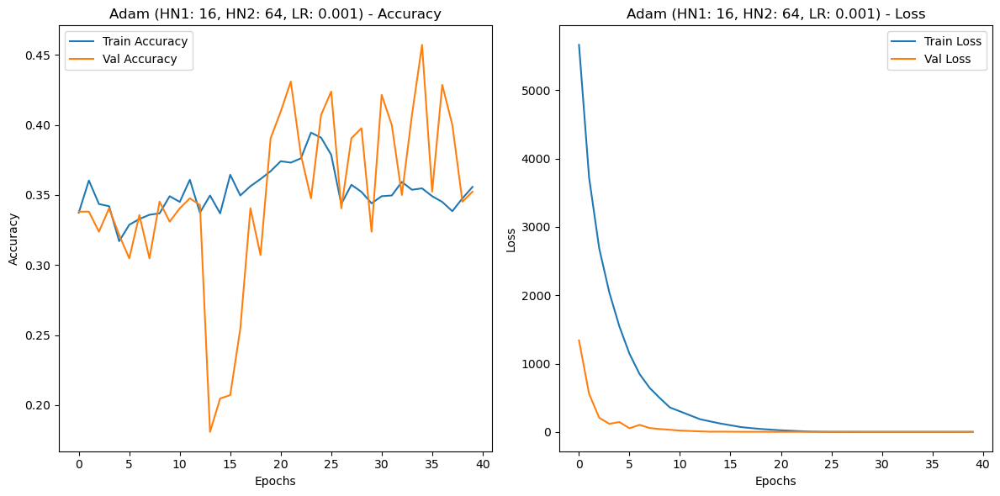


[INFO] Training RProp optimizer with 16 first hidden neurons, 64 second hidden neurons, and 0.001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3279 - loss: 6486.4883 - val_accuracy: 0.3381 - val_loss: 489.0210
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3107 - loss: 730.7791 - val_accuracy: 0.4071 - val_loss: 23.0469
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3560 - loss: 68.6616 - val_accuracy: 0.4071 - val_loss: 14.7151
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3699 - loss: 36.1516 - val_accuracy: 0.4024 - val_loss: 2.9534
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3777 - loss: 4.3194 - val_accuracy: 0.3881 - val_loss: 2.6335
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3727 - loss: 4.0724 - val_accuracy: 0.3881 - val_loss: 2.6176
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3854 - loss: 6.7556 - val_accuracy: 0.3881 - val

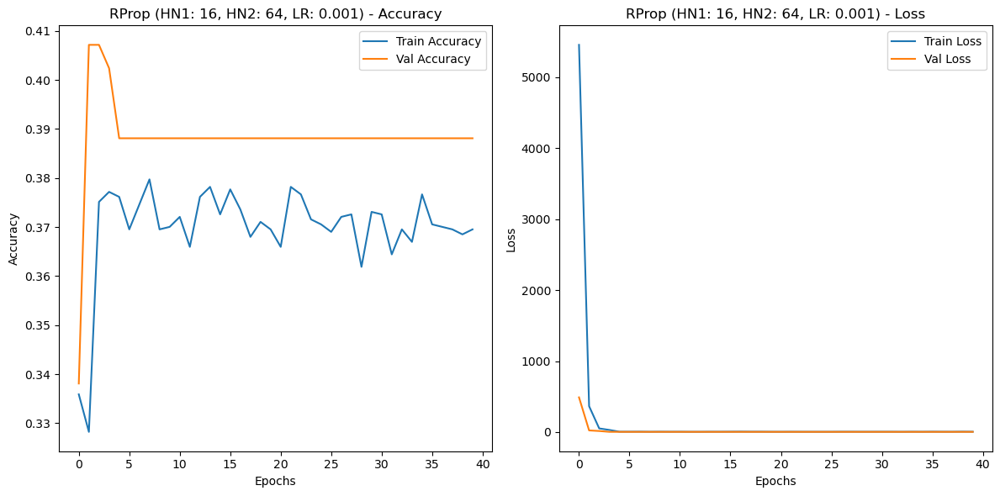


[INFO] Training Adam optimizer with 16 first hidden neurons, 64 second hidden neurons, and 0.01 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - accuracy: 0.3104 - loss: 4551.5493 - val_accuracy: 0.3381 - val_loss: 25.9217
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3007 - loss: 166.9551 - val_accuracy: 0.3810 - val_loss: 4.0648
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3863 - loss: 9.1675 - val_accuracy: 0.3619 - val_loss: 1.1390
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3500 - loss: 1.2002 - val_accuracy: 0.3405 - val_loss: 1.1036
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3543 - loss: 1.1656 - val_accuracy: 0.3452 - val_loss: 1.1094
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3337 - loss: 1.1110 - val_accuracy: 0.3429 - val_loss: 1.1048
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3410 - loss: 1.1512 - val_accuracy: 0.3429 - val_loss: 

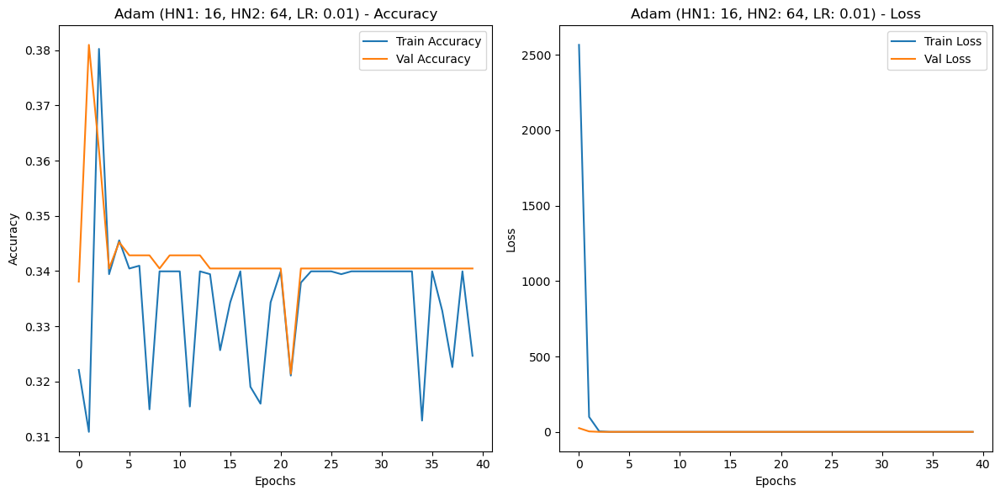


[INFO] Training RProp optimizer with 16 first hidden neurons, 64 second hidden neurons, and 0.01 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 49ms/step - accuracy: 0.3320 - loss: 2271.6458 - val_accuracy: 0.3214 - val_loss: 1.1810
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3196 - loss: 1.2331 - val_accuracy: 0.3214 - val_loss: 1.2211
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3423 - loss: 1.3736 - val_accuracy: 0.3214 - val_loss: 1.2229
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3436 - loss: 1.2559 - val_accuracy: 0.3214 - val_loss: 1.2316
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3151 - loss: 1.1315 - val_accuracy: 0.3214 - val_loss: 1.2355
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3362 - loss: 1.2501 - val_accuracy: 0.3214 - val_loss: 1.2359
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3330 - loss: 1.2388 - val_accuracy: 0.3214 - val_loss: 1.

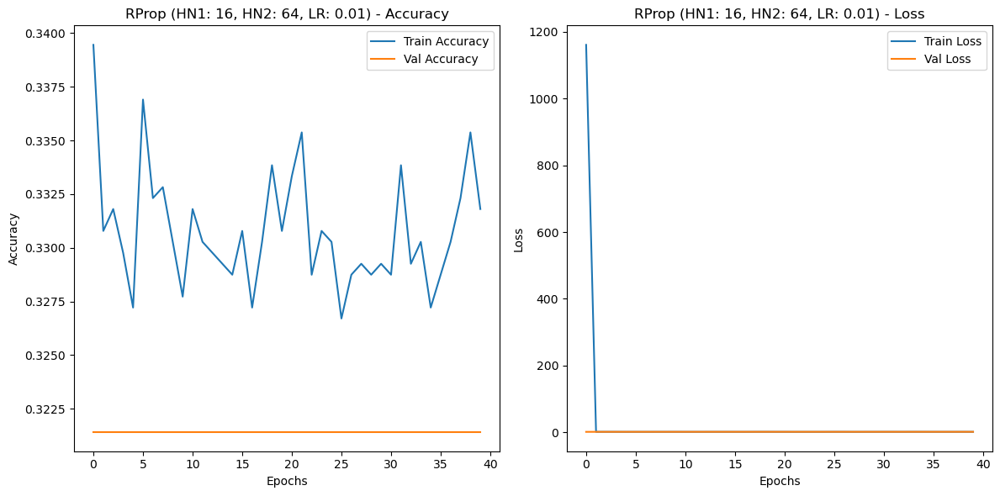


[INFO] Training Adam optimizer with 16 first hidden neurons, 64 second hidden neurons, and 0.1 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 80ms/step - accuracy: 0.3223 - loss: 2174.4514 - val_accuracy: 0.3381 - val_loss: 1.0995
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 78ms/step - accuracy: 0.3169 - loss: 1.1013 - val_accuracy: 0.3214 - val_loss: 1.0989
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 72ms/step - accuracy: 0.3383 - loss: 1.1001 - val_accuracy: 0.3381 - val_loss: 1.0998
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3382 - loss: 1.1002 - val_accuracy: 0.3381 - val_loss: 1.0988
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 73ms/step - accuracy: 0.3291 - loss: 1.0998 - val_accuracy: 0.3381 - val_loss: 1.1002
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3337 - loss: 1.1018 - val_accuracy: 0.3405 - val_loss: 1.0997
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 72ms/step - accuracy: 0.3462 - loss: 1.1001 - val_accuracy: 0.3405 - val_loss: 1.09

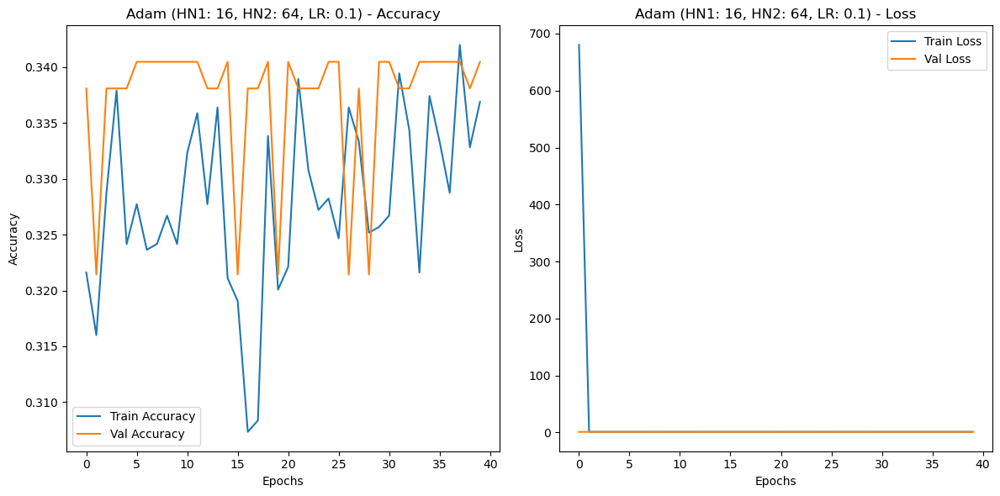


[INFO] Training RProp optimizer with 16 first hidden neurons, 64 second hidden neurons, and 0.1 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 50ms/step - accuracy: 0.3125 - loss: 3550.8550 - val_accuracy: 0.4238 - val_loss: 72.4339
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3810 - loss: 102.7972 - val_accuracy: 0.4214 - val_loss: 3.2678
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3799 - loss: 14.2277 - val_accuracy: 0.3690 - val_loss: 2.6286
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3781 - loss: 4.5649 - val_accuracy: 0.3738 - val_loss: 1.2979
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3832 - loss: 2.4521 - val_accuracy: 0.3690 - val_loss: 1.4969
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3492 - loss: 2.8047 - val_accuracy: 0.3952 - val_loss: 1.6075
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3737 - loss: 2.2723 - val_accuracy: 0.3952 - val_loss:

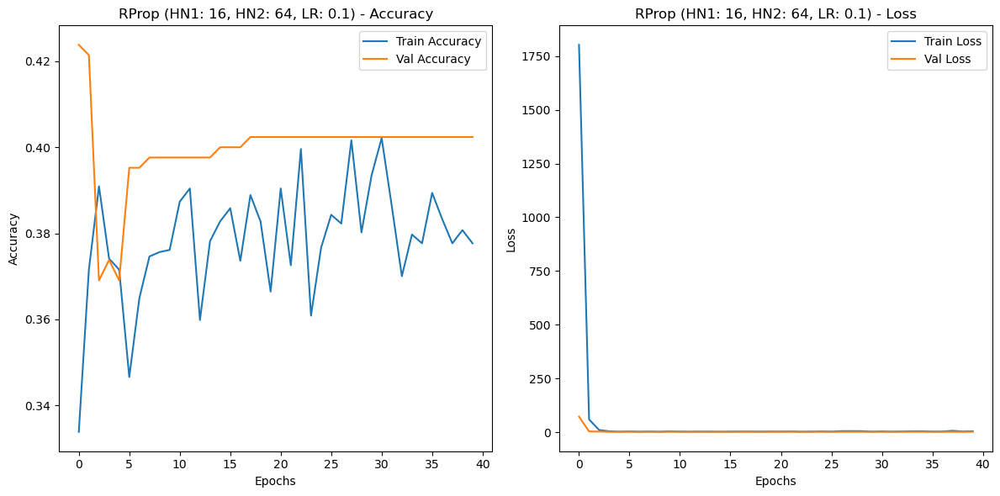


[INFO] Training Adam optimizer with 16 first hidden neurons, 128 second hidden neurons, and 0.0001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 77ms/step - accuracy: 0.3332 - loss: 5191.0781 - val_accuracy: 0.3405 - val_loss: 1752.9017
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - accuracy: 0.3253 - loss: 4605.9941 - val_accuracy: 0.3476 - val_loss: 1263.0848
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 78ms/step - accuracy: 0.3427 - loss: 4186.6743 - val_accuracy: 0.3452 - val_loss: 1010.3464
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 71ms/step - accuracy: 0.3280 - loss: 4009.2090 - val_accuracy: 0.3452 - val_loss: 943.7828
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 83ms/step - accuracy: 0.3369 - loss: 3550.7766 - val_accuracy: 0.3381 - val_loss: 898.7032
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 74ms/step - accuracy: 0.3308 - loss: 3258.2720 - val_accuracy: 0.3381 - val_loss: 761.7753
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 80ms/step - accuracy: 0.3257 - loss: 3546.1824 - 

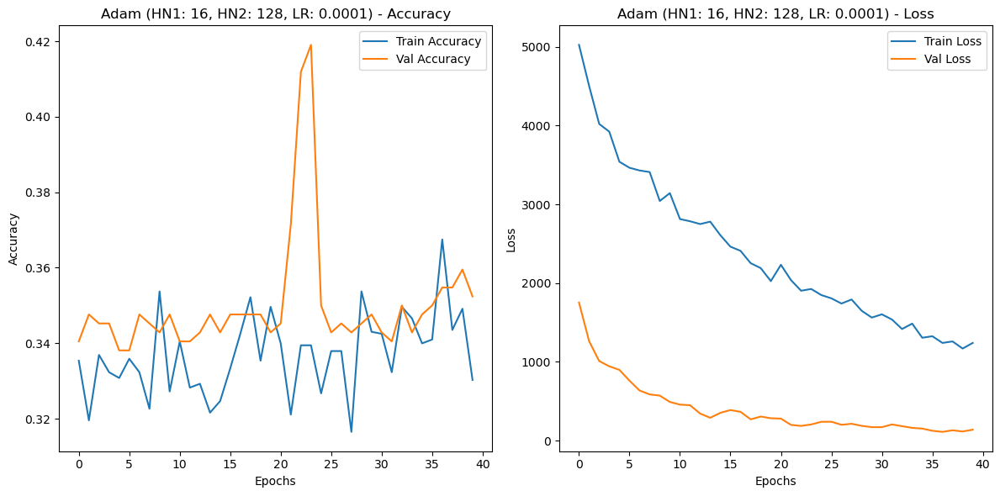


[INFO] Training RProp optimizer with 16 first hidden neurons, 128 second hidden neurons, and 0.0001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3339 - loss: 6589.8027 - val_accuracy: 0.3214 - val_loss: 2255.7095
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3486 - loss: 4531.1172 - val_accuracy: 0.3381 - val_loss: 393.2749
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3409 - loss: 2772.5691 - val_accuracy: 0.3452 - val_loss: 468.0540
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 48ms/step - accuracy: 0.3252 - loss: 1667.3394 - val_accuracy: 0.3238 - val_loss: 187.4887
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 53ms/step - accuracy: 0.3321 - loss: 993.9599 - val_accuracy: 0.4048 - val_loss: 39.7278
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 73ms/step - accuracy: 0.3201 - loss: 113.7248 - val_accuracy: 0.3214 - val_loss: 10.6834
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 56ms/step - accuracy: 0.2871 - loss: 56.1993 - val_acc

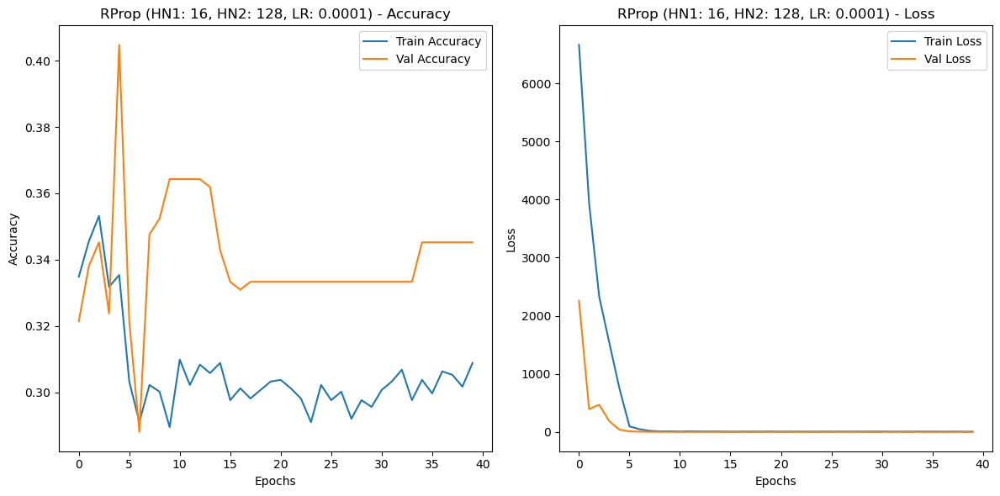


[INFO] Training Adam optimizer with 16 first hidden neurons, 128 second hidden neurons, and 0.001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 77ms/step - accuracy: 0.3387 - loss: 5715.7012 - val_accuracy: 0.3381 - val_loss: 979.6056
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 81ms/step - accuracy: 0.3386 - loss: 3475.3628 - val_accuracy: 0.3381 - val_loss: 722.1729
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 78ms/step - accuracy: 0.3124 - loss: 2495.3269 - val_accuracy: 0.3381 - val_loss: 465.0611
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 82ms/step - accuracy: 0.3193 - loss: 1875.3212 - val_accuracy: 0.3405 - val_loss: 182.4158
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 75ms/step - accuracy: 0.3538 - loss: 1407.7815 - val_accuracy: 0.3381 - val_loss: 227.2832
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 79ms/step - accuracy: 0.3390 - loss: 1045.4226 - val_accuracy: 0.3095 - val_loss: 87.9741
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3603 - loss: 824.0627 - val_ac

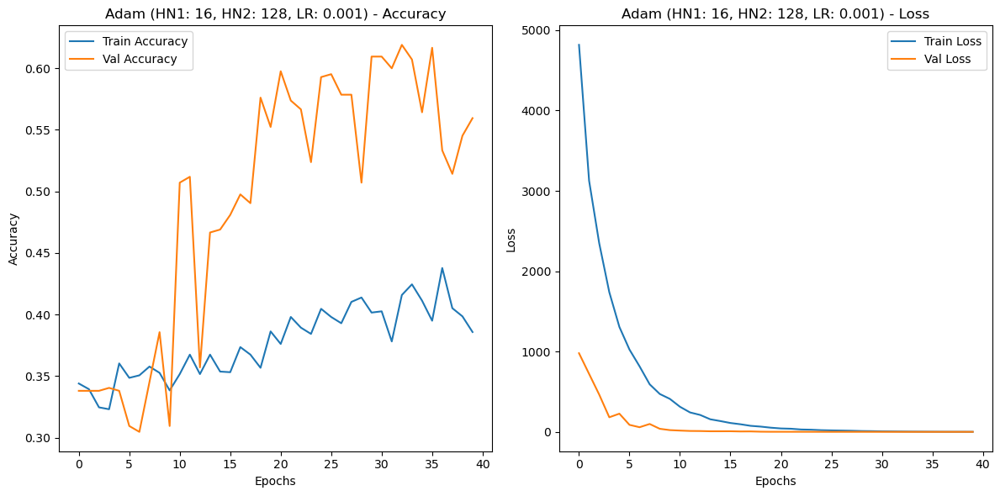


[INFO] Training RProp optimizer with 16 first hidden neurons, 128 second hidden neurons, and 0.001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 71ms/step - accuracy: 0.3497 - loss: 4487.7651 - val_accuracy: 0.3381 - val_loss: 614.6949
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 55ms/step - accuracy: 0.3482 - loss: 882.7817 - val_accuracy: 0.3738 - val_loss: 115.9348
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 57ms/step - accuracy: 0.3781 - loss: 260.0855 - val_accuracy: 0.3857 - val_loss: 70.9804
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 58ms/step - accuracy: 0.3344 - loss: 100.1330 - val_accuracy: 0.3381 - val_loss: 10.4005
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 53ms/step - accuracy: 0.3621 - loss: 15.4225 - val_accuracy: 0.3714 - val_loss: 10.0407
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 53ms/step - accuracy: 0.3829 - loss: 13.2523 - val_accuracy: 0.4143 - val_loss: 6.3302
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 54ms/step - accuracy: 0.3961 - loss: 6.5731 - val_accuracy: 0.40

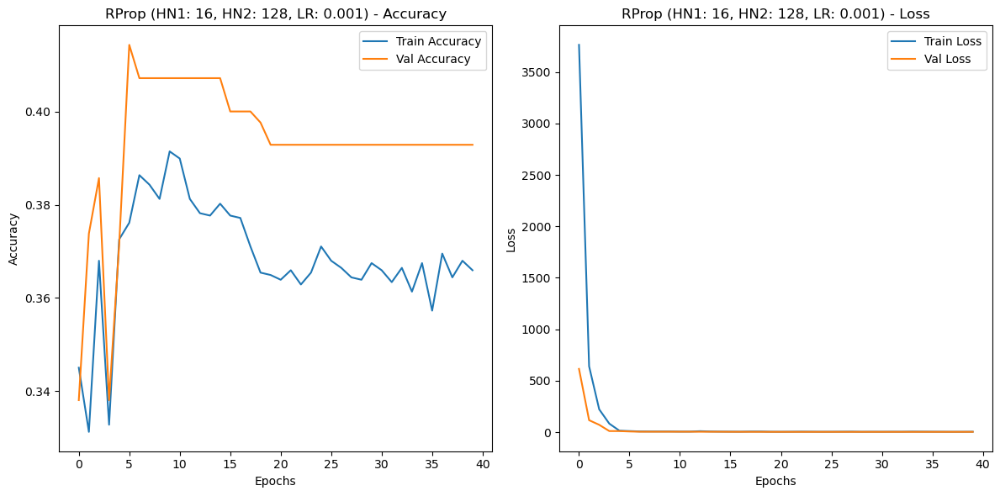


[INFO] Training Adam optimizer with 16 first hidden neurons, 128 second hidden neurons, and 0.01 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 79ms/step - accuracy: 0.3617 - loss: 1150.5493 - val_accuracy: 0.3238 - val_loss: 1.4298
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 75ms/step - accuracy: 0.3251 - loss: 1.2313 - val_accuracy: 0.3357 - val_loss: 1.1123
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 73ms/step - accuracy: 0.3353 - loss: 1.1073 - val_accuracy: 0.3381 - val_loss: 1.0987
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 74ms/step - accuracy: 0.3163 - loss: 1.0990 - val_accuracy: 0.3405 - val_loss: 1.0986
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 71ms/step - accuracy: 0.3562 - loss: 1.0996 - val_accuracy: 0.3405 - val_loss: 1.0987
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 78ms/step - accuracy: 0.3383 - loss: 1.0978 - val_accuracy: 0.3405 - val_loss: 1.0985
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3440 - loss: 1.0978 - val_accuracy: 0.3405 - val_loss: 1.

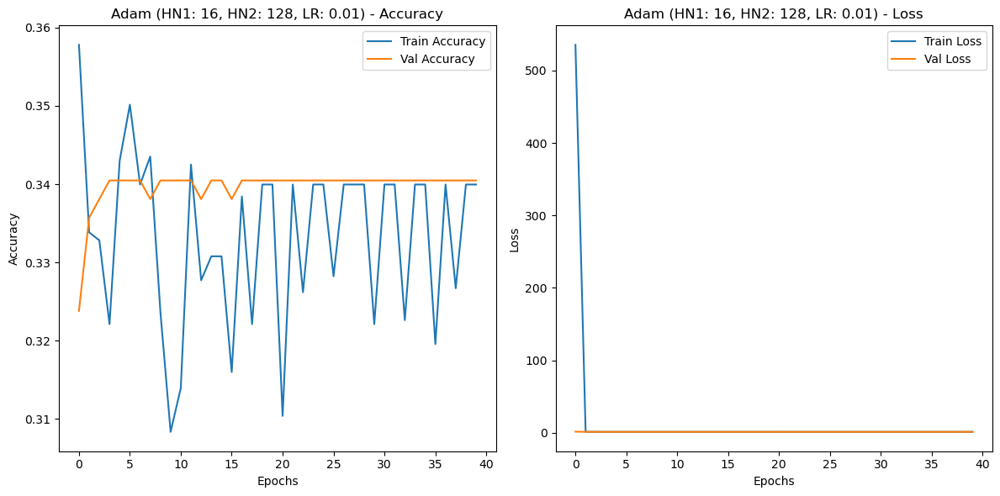


[INFO] Training RProp optimizer with 16 first hidden neurons, 128 second hidden neurons, and 0.01 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3092 - loss: 5305.2461 - val_accuracy: 0.3405 - val_loss: 212.7384
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3418 - loss: 138.2582 - val_accuracy: 0.3238 - val_loss: 1.3294
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3432 - loss: 1.2002 - val_accuracy: 0.3214 - val_loss: 1.1024
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3196 - loss: 1.1028 - val_accuracy: 0.3214 - val_loss: 1.1006
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3333 - loss: 1.0995 - val_accuracy: 0.3214 - val_loss: 1.1006
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3329 - loss: 1.1041 - val_accuracy: 0.3214 - val_loss: 1.1006
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3283 - loss: 1.1006 - val_accuracy: 0.3214 - val_los

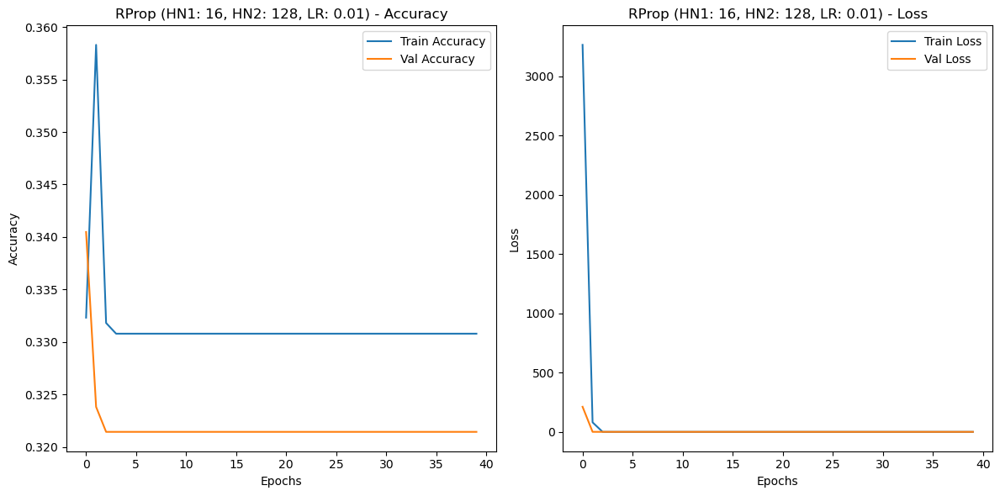


[INFO] Training Adam optimizer with 16 first hidden neurons, 128 second hidden neurons, and 0.1 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 97ms/step - accuracy: 0.3282 - loss: 5122.9380 - val_accuracy: 0.3214 - val_loss: 1.1033
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 78ms/step - accuracy: 0.3163 - loss: 1.1055 - val_accuracy: 0.3405 - val_loss: 1.1141
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 6s 205ms/step - accuracy: 0.3361 - loss: 1.1096 - val_accuracy: 0.3405 - val_loss: 1.0986
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 107ms/step - accuracy: 0.3392 - loss: 1.0997 - val_accuracy: 0.3405 - val_loss: 1.0985
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 79ms/step - accuracy: 0.3458 - loss: 1.0995 - val_accuracy: 0.3381 - val_loss: 1.0996
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 69ms/step - accuracy: 0.3203 - loss: 1.1035 - val_accuracy: 0.3405 - val_loss: 1.0986
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 72ms/step - accuracy: 0.3223 - loss: 1.1022 - val_accuracy: 0.3405 - val_loss: 1

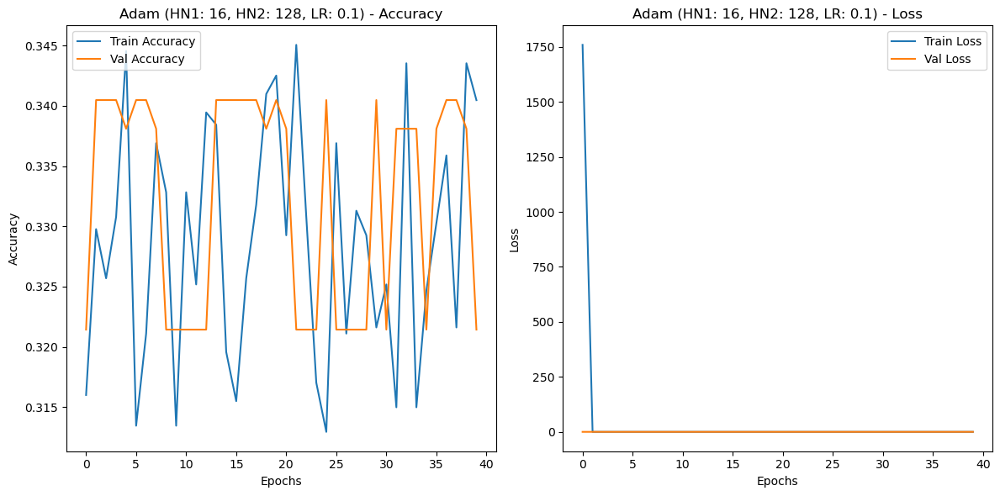


[INFO] Training RProp optimizer with 16 first hidden neurons, 128 second hidden neurons, and 0.1 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 51ms/step - accuracy: 0.3452 - loss: 1324.3066 - val_accuracy: 0.4190 - val_loss: 1.3306
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 50ms/step - accuracy: 0.3667 - loss: 2.1701 - val_accuracy: 0.4119 - val_loss: 1.3579
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3855 - loss: 1.6952 - val_accuracy: 0.4048 - val_loss: 1.4284
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3647 - loss: 1.3221 - val_accuracy: 0.4143 - val_loss: 1.4618
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3708 - loss: 1.5944 - val_accuracy: 0.4143 - val_loss: 1.4748
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 52ms/step - accuracy: 0.3464 - loss: 1.3764 - val_accuracy: 0.4143 - val_loss: 1.4856
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 48ms/step - accuracy: 0.3809 - loss: 1.6687 - val_accuracy: 0.4143 - val_loss: 1.

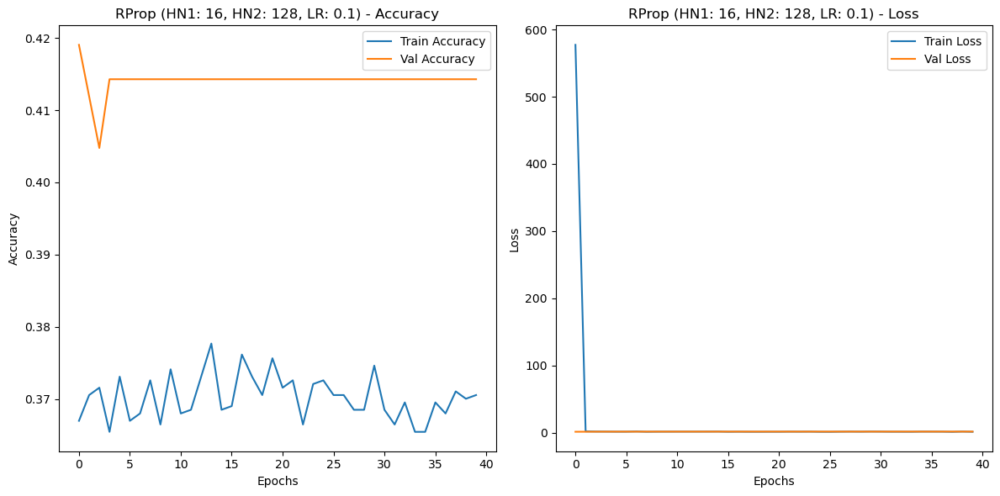


[INFO] Training Adam optimizer with 32 first hidden neurons, 4 second hidden neurons, and 0.0001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 80ms/step - accuracy: 0.3184 - loss: 3700.3647 - val_accuracy: 0.3381 - val_loss: 715.9218
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 71ms/step - accuracy: 0.3041 - loss: 3480.6951 - val_accuracy: 0.3381 - val_loss: 627.3590
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 69ms/step - accuracy: 0.3249 - loss: 2850.6694 - val_accuracy: 0.3381 - val_loss: 542.3661
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - accuracy: 0.2980 - loss: 2510.9417 - val_accuracy: 0.3381 - val_loss: 462.7701
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 71ms/step - accuracy: 0.3137 - loss: 2424.5308 - val_accuracy: 0.3381 - val_loss: 386.0742
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 80ms/step - accuracy: 0.3484 - loss: 2028.0784 - val_accuracy: 0.3381 - val_loss: 325.6532
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 68ms/step - accuracy: 0.3331 - loss: 1635.4661 - val_a

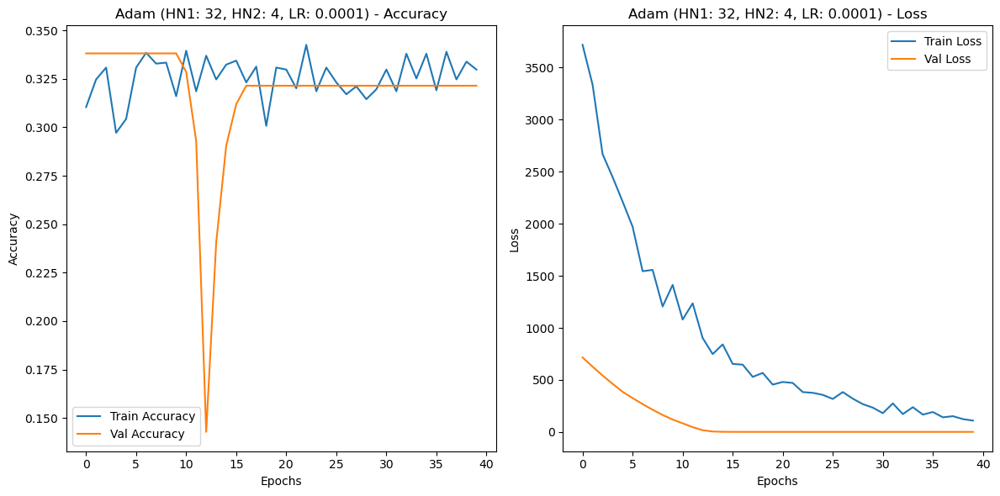


[INFO] Training RProp optimizer with 32 first hidden neurons, 4 second hidden neurons, and 0.0001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 54ms/step - accuracy: 0.3249 - loss: 2336.6985 - val_accuracy: 0.2190 - val_loss: 4.2410
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3386 - loss: 1294.7389 - val_accuracy: 0.3405 - val_loss: 1.0986
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3426 - loss: 91.6265 - val_accuracy: 0.3405 - val_loss: 1.0986
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 57ms/step - accuracy: 0.3333 - loss: 36.5149 - val_accuracy: 0.3405 - val_loss: 1.0986
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 47ms/step - accuracy: 0.3172 - loss: 19.7211 - val_accuracy: 0.3405 - val_loss: 1.0986
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 52ms/step - accuracy: 0.3378 - loss: 22.7653 - val_accuracy: 0.3405 - val_loss: 1.0986
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 52ms/step - accuracy: 0.3335 - loss: 11.4530 - val_accuracy: 0.3405 - val

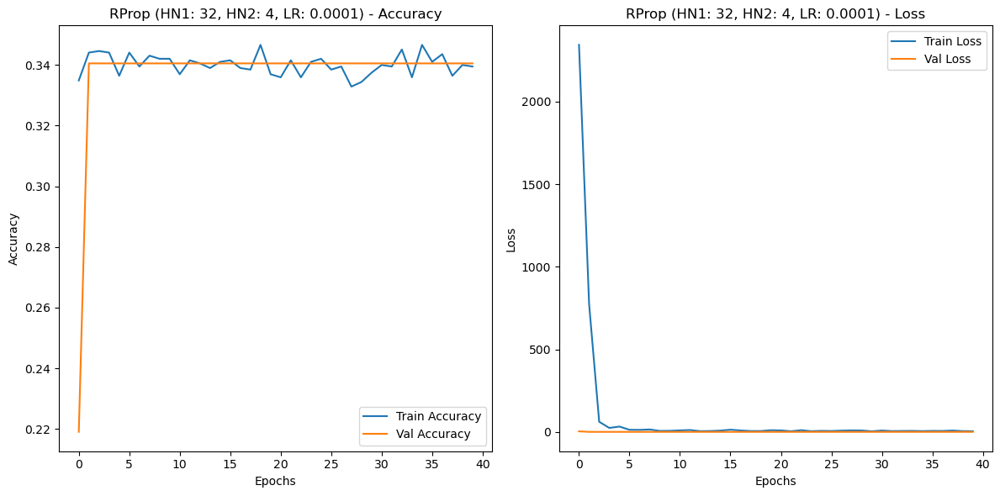


[INFO] Training Adam optimizer with 32 first hidden neurons, 4 second hidden neurons, and 0.001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - accuracy: 0.3402 - loss: 1188.1171 - val_accuracy: 0.3381 - val_loss: 1.0983
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - accuracy: 0.3260 - loss: 387.4490 - val_accuracy: 0.3381 - val_loss: 1.0984
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - accuracy: 0.3492 - loss: 231.7826 - val_accuracy: 0.3381 - val_loss: 1.0985
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 68ms/step - accuracy: 0.3320 - loss: 109.5925 - val_accuracy: 0.3381 - val_loss: 1.0985
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3299 - loss: 81.4145 - val_accuracy: 0.3381 - val_loss: 1.0983
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - accuracy: 0.3419 - loss: 56.3721 - val_accuracy: 0.3381 - val_loss: 1.0983
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3609 - loss: 19.2219 - val_accuracy: 0.3381 - val_

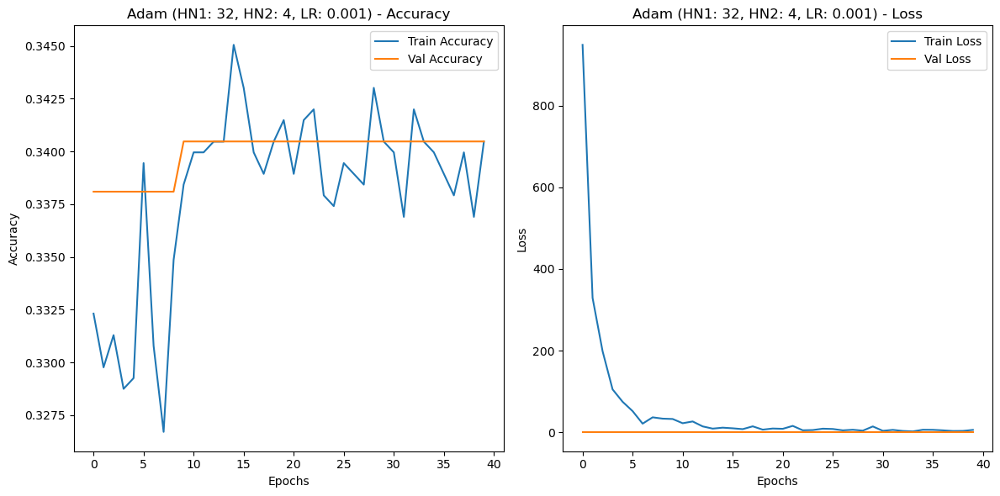


[INFO] Training RProp optimizer with 32 first hidden neurons, 4 second hidden neurons, and 0.001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 48ms/step - accuracy: 0.3223 - loss: 6383.6572 - val_accuracy: 0.3214 - val_loss: 1.1004
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 52ms/step - accuracy: 0.3507 - loss: 151.5990 - val_accuracy: 0.3214 - val_loss: 1.1002
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 49ms/step - accuracy: 0.3427 - loss: 43.3767 - val_accuracy: 0.3214 - val_loss: 1.1001
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3227 - loss: 74.5836 - val_accuracy: 0.3214 - val_loss: 1.1001
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3425 - loss: 24.4454 - val_accuracy: 0.3214 - val_loss: 1.1001
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3135 - loss: 60.6006 - val_accuracy: 0.3214 - val_loss: 1.1001
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 48ms/step - accuracy: 0.3344 - loss: 52.8505 - val_accuracy: 0.3214 - val_l

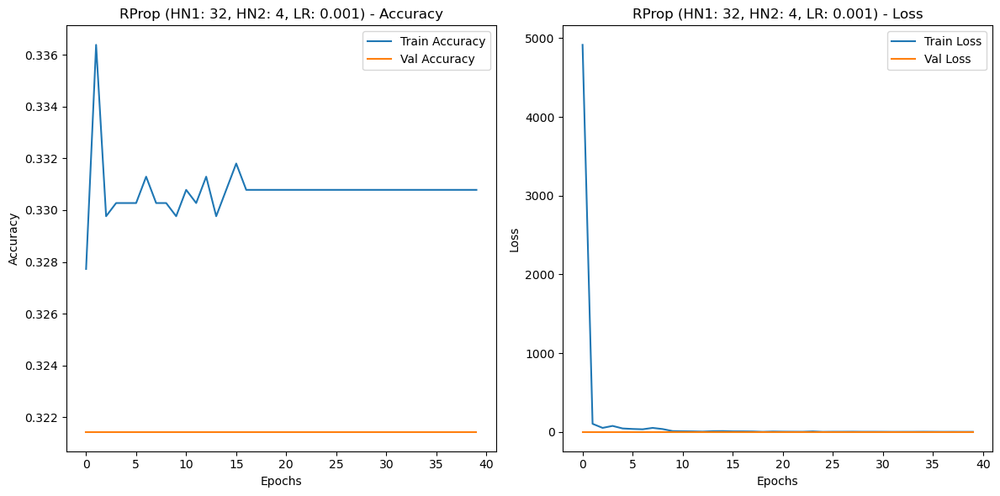


[INFO] Training Adam optimizer with 32 first hidden neurons, 4 second hidden neurons, and 0.01 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 69ms/step - accuracy: 0.3288 - loss: 3147.5625 - val_accuracy: 0.3381 - val_loss: 1.1036
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 72ms/step - accuracy: 0.3205 - loss: 37.2334 - val_accuracy: 0.3381 - val_loss: 1.0996
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 102ms/step - accuracy: 0.3241 - loss: 5.6777 - val_accuracy: 0.3405 - val_loss: 1.0984
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 70ms/step - accuracy: 0.3420 - loss: 10.6166 - val_accuracy: 0.3405 - val_loss: 1.0984
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 78ms/step - accuracy: 0.3200 - loss: 6.8930 - val_accuracy: 0.3405 - val_loss: 1.0984
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 73ms/step - accuracy: 0.3290 - loss: 6.8413 - val_accuracy: 0.3405 - val_loss: 1.0986
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 71ms/step - accuracy: 0.3444 - loss: 4.7640 - val_accuracy: 0.3405 - val_loss: 1

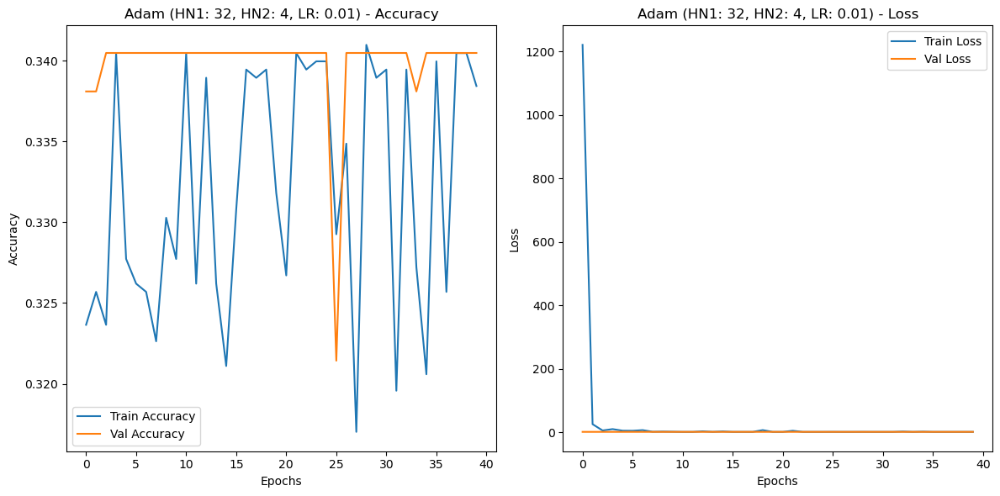


[INFO] Training RProp optimizer with 32 first hidden neurons, 4 second hidden neurons, and 0.01 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 71ms/step - accuracy: 0.3221 - loss: 1869.0387 - val_accuracy: 0.3405 - val_loss: 1.0985
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3469 - loss: 14.5988 - val_accuracy: 0.3405 - val_loss: 1.0985
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 58ms/step - accuracy: 0.3577 - loss: 6.1155 - val_accuracy: 0.3405 - val_loss: 1.0985
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 58ms/step - accuracy: 0.3473 - loss: 1.4751 - val_accuracy: 0.3405 - val_loss: 1.0985
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3560 - loss: 1.2858 - val_accuracy: 0.3405 - val_loss: 1.0985
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 76ms/step - accuracy: 0.3318 - loss: 2.6650 - val_accuracy: 0.3405 - val_loss: 1.0985
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 69ms/step - accuracy: 0.3372 - loss: 2.7133 - val_accuracy: 0.3405 - val_loss: 1.

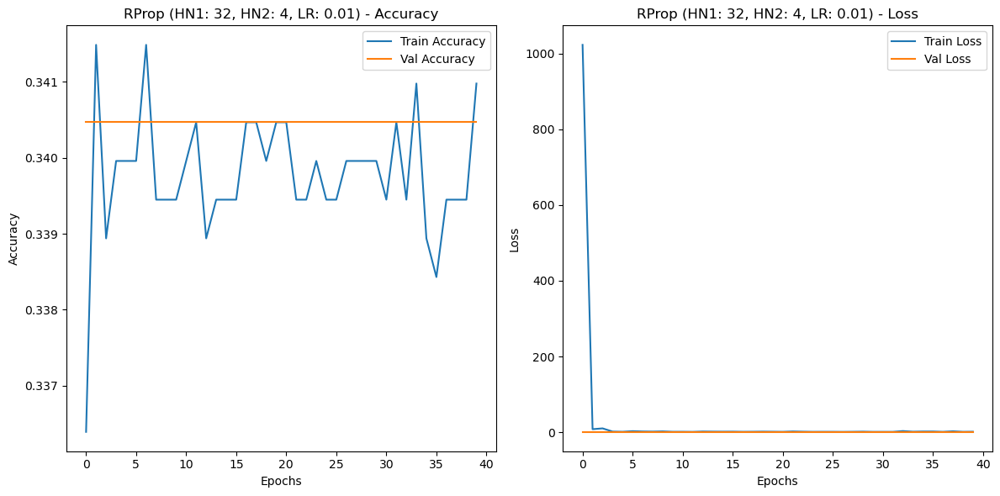


[INFO] Training Adam optimizer with 32 first hidden neurons, 4 second hidden neurons, and 0.1 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 76ms/step - accuracy: 0.3571 - loss: 1457.6055 - val_accuracy: 0.3214 - val_loss: 1.1046
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 74ms/step - accuracy: 0.3305 - loss: 1.1014 - val_accuracy: 0.3405 - val_loss: 1.0992
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 76ms/step - accuracy: 0.2913 - loss: 1.1057 - val_accuracy: 0.3381 - val_loss: 1.0989
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 85ms/step - accuracy: 0.3175 - loss: 1.1026 - val_accuracy: 0.3405 - val_loss: 1.1009
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 93ms/step - accuracy: 0.3400 - loss: 1.1021 - val_accuracy: 0.3405 - val_loss: 1.1088
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 72ms/step - accuracy: 0.3503 - loss: 1.1062 - val_accuracy: 0.3405 - val_loss: 1.1039
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 72ms/step - accuracy: 0.3271 - loss: 1.1059 - val_accuracy: 0.3405 - val_loss: 1.099

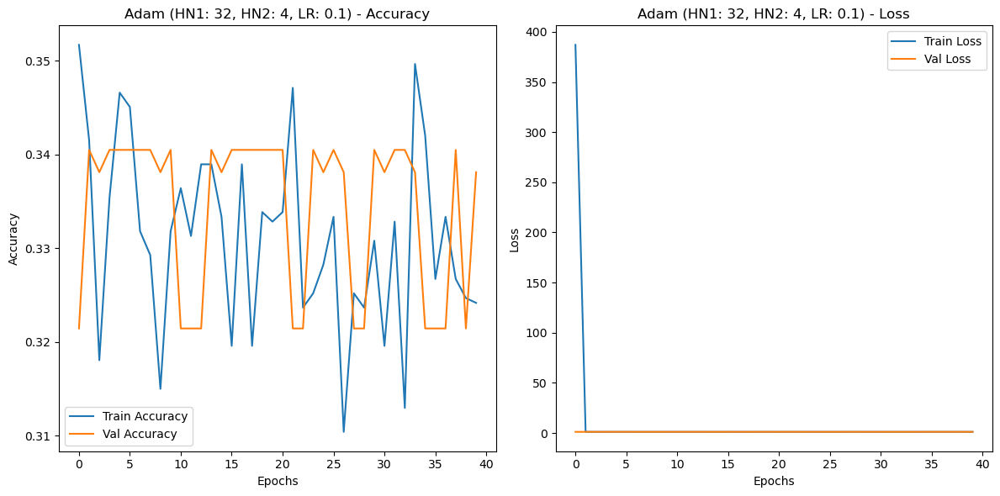


[INFO] Training RProp optimizer with 32 first hidden neurons, 4 second hidden neurons, and 0.1 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 57ms/step - accuracy: 0.3276 - loss: 1723.5349 - val_accuracy: 0.3405 - val_loss: 1.1004
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 49ms/step - accuracy: 0.3307 - loss: 5.2192 - val_accuracy: 0.3405 - val_loss: 1.1004
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3388 - loss: 8.5003 - val_accuracy: 0.3405 - val_loss: 1.1004
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 48ms/step - accuracy: 0.3340 - loss: 2.6589 - val_accuracy: 0.3405 - val_loss: 1.1004
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 56ms/step - accuracy: 0.3478 - loss: 2.4108 - val_accuracy: 0.3405 - val_loss: 1.1004
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 54ms/step - accuracy: 0.3443 - loss: 1.1985 - val_accuracy: 0.3405 - val_loss: 1.1004
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 51ms/step - accuracy: 0.3438 - loss: 1.3938 - val_accuracy: 0.3405 - val_loss: 1.10

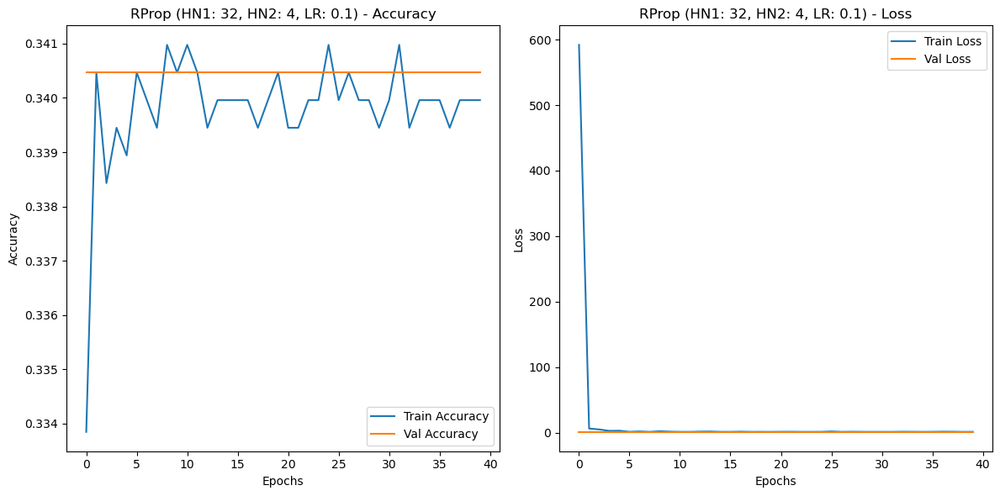


[INFO] Training Adam optimizer with 32 first hidden neurons, 8 second hidden neurons, and 0.0001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 68ms/step - accuracy: 0.3249 - loss: 18318.3457 - val_accuracy: 0.3405 - val_loss: 10743.0449
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3216 - loss: 18297.3672 - val_accuracy: 0.3405 - val_loss: 9258.5752
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 73ms/step - accuracy: 0.3236 - loss: 18560.3887 - val_accuracy: 0.3405 - val_loss: 7941.2749
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - accuracy: 0.3296 - loss: 15039.9766 - val_accuracy: 0.3405 - val_loss: 6707.0942
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 70ms/step - accuracy: 0.3360 - loss: 13903.6416 - val_accuracy: 0.3405 - val_loss: 5655.6147
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3473 - loss: 12546.5293 - val_accuracy: 0.3405 - val_loss: 4662.4004
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 68ms/step - accuracy: 0.3257 - loss: 1404

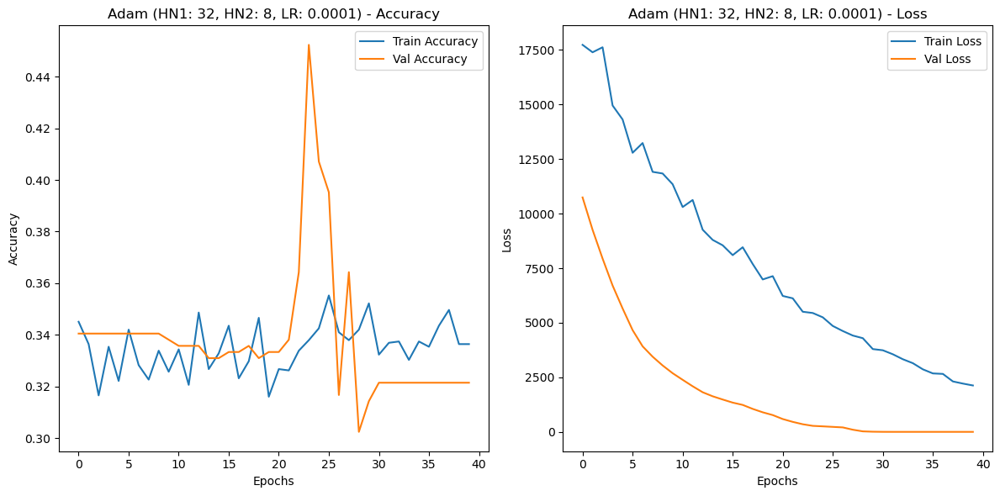


[INFO] Training RProp optimizer with 32 first hidden neurons, 8 second hidden neurons, and 0.0001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 49ms/step - accuracy: 0.3360 - loss: 11550.7402 - val_accuracy: 0.3405 - val_loss: 829.7532
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3514 - loss: 8118.5459 - val_accuracy: 0.3571 - val_loss: 89.7688
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3449 - loss: 1303.1613 - val_accuracy: 0.3381 - val_loss: 1.0986
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3156 - loss: 680.9910 - val_accuracy: 0.3381 - val_loss: 1.0986
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 50ms/step - accuracy: 0.3253 - loss: 441.9044 - val_accuracy: 0.3381 - val_loss: 1.0986
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3266 - loss: 267.4187 - val_accuracy: 0.3381 - val_loss: 1.0986
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3195 - loss: 245.8108 - val_accuracy: 0.

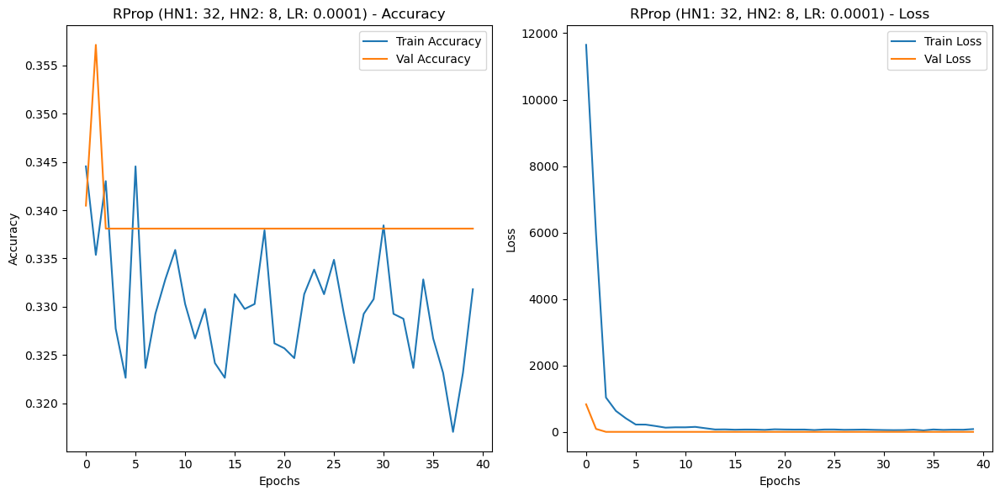


[INFO] Training Adam optimizer with 32 first hidden neurons, 8 second hidden neurons, and 0.001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - accuracy: 0.3494 - loss: 5006.8804 - val_accuracy: 0.3214 - val_loss: 1057.4126
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3402 - loss: 2943.9438 - val_accuracy: 0.3452 - val_loss: 387.0121
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3444 - loss: 1362.1514 - val_accuracy: 0.3381 - val_loss: 2.1506
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3376 - loss: 684.2543 - val_accuracy: 0.3786 - val_loss: 1.1736
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3146 - loss: 563.1602 - val_accuracy: 0.3452 - val_loss: 1.0992
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3366 - loss: 380.9049 - val_accuracy: 0.3381 - val_loss: 1.3762
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3294 - loss: 277.9199 - val_accuracy: 0.3

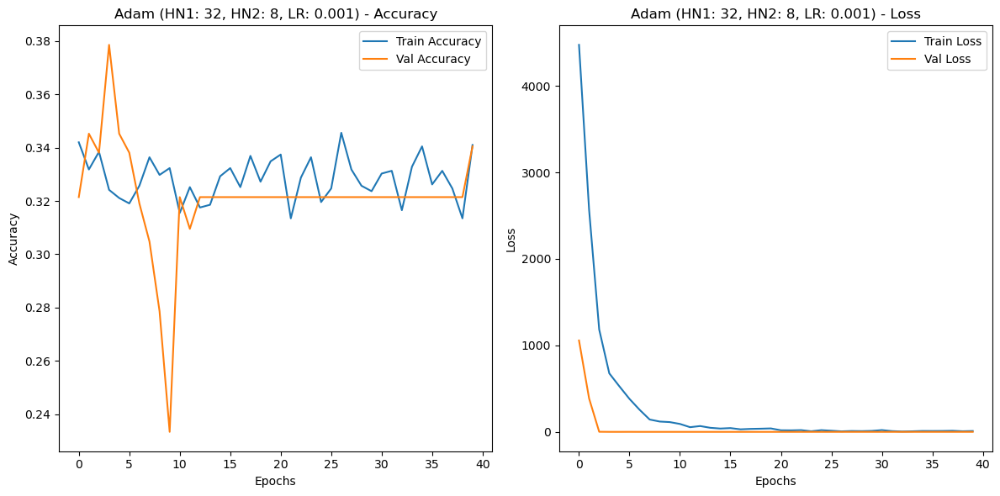


[INFO] Training RProp optimizer with 32 first hidden neurons, 8 second hidden neurons, and 0.001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3250 - loss: 8452.7148 - val_accuracy: 0.3214 - val_loss: 814.3010
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3351 - loss: 1605.8500 - val_accuracy: 0.3381 - val_loss: 52.8849
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3138 - loss: 315.3123 - val_accuracy: 0.3381 - val_loss: 1.1151
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3493 - loss: 152.0049 - val_accuracy: 0.3381 - val_loss: 1.1060
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3101 - loss: 109.7858 - val_accuracy: 0.3381 - val_loss: 1.1049
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3281 - loss: 98.5544 - val_accuracy: 0.3381 - val_loss: 1.1049
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3421 - loss: 67.3936 - val_accuracy: 0.3381 

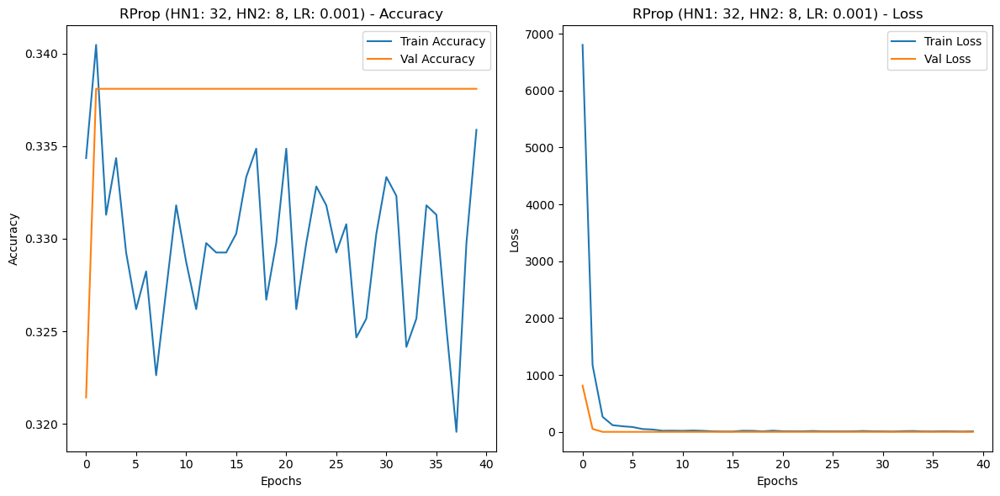


[INFO] Training Adam optimizer with 32 first hidden neurons, 8 second hidden neurons, and 0.01 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3337 - loss: 1262.1033 - val_accuracy: 0.3405 - val_loss: 1.1001
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3359 - loss: 35.1198 - val_accuracy: 0.3405 - val_loss: 1.0992
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3496 - loss: 3.2051 - val_accuracy: 0.3405 - val_loss: 1.0991
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 58ms/step - accuracy: 0.3319 - loss: 3.7076 - val_accuracy: 0.3214 - val_loss: 1.0989
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 58ms/step - accuracy: 0.3215 - loss: 4.7032 - val_accuracy: 0.3405 - val_loss: 1.0986
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 58ms/step - accuracy: 0.3126 - loss: 3.7789 - val_accuracy: 0.3405 - val_loss: 1.0987
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3443 - loss: 1.9557 - val_accuracy: 0.3405 - val_loss: 1.0

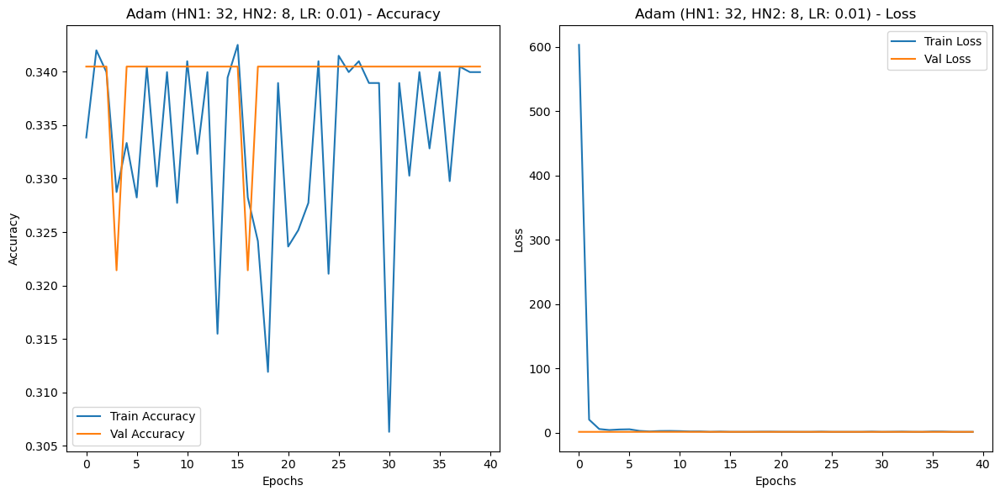


[INFO] Training RProp optimizer with 32 first hidden neurons, 8 second hidden neurons, and 0.01 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3286 - loss: 3973.8704 - val_accuracy: 0.3214 - val_loss: 1.1006
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3253 - loss: 133.3613 - val_accuracy: 0.3214 - val_loss: 1.1002
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3265 - loss: 14.5242 - val_accuracy: 0.3214 - val_loss: 1.1002
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3222 - loss: 7.3958 - val_accuracy: 0.3214 - val_loss: 1.1002
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3210 - loss: 14.6432 - val_accuracy: 0.3214 - val_loss: 1.1002
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3553 - loss: 2.7201 - val_accuracy: 0.3214 - val_loss: 1.1002
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3361 - loss: 8.0780 - val_accuracy: 0.3214 - val_loss:

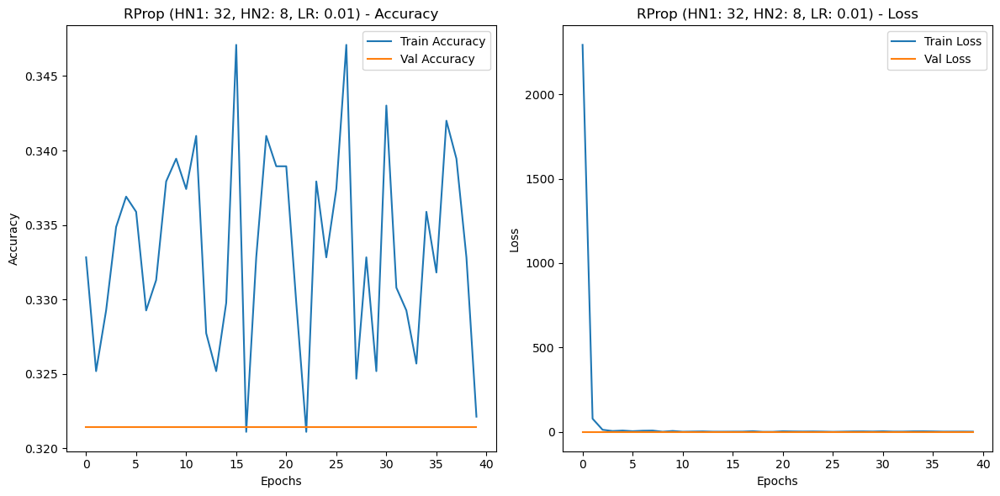


[INFO] Training Adam optimizer with 32 first hidden neurons, 8 second hidden neurons, and 0.1 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 68ms/step - accuracy: 0.3359 - loss: 4170.3403 - val_accuracy: 0.3405 - val_loss: 1.0984
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - accuracy: 0.3372 - loss: 1.1020 - val_accuracy: 0.3214 - val_loss: 1.0990
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 71ms/step - accuracy: 0.3418 - loss: 1.1044 - val_accuracy: 0.3405 - val_loss: 1.0986
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 69ms/step - accuracy: 0.3173 - loss: 1.1016 - val_accuracy: 0.3381 - val_loss: 1.1014
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 69ms/step - accuracy: 0.3302 - loss: 1.1050 - val_accuracy: 0.3405 - val_loss: 1.1019
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3455 - loss: 1.1005 - val_accuracy: 0.3405 - val_loss: 1.1003
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 76ms/step - accuracy: 0.3309 - loss: 1.1030 - val_accuracy: 0.3381 - val_loss: 1.100

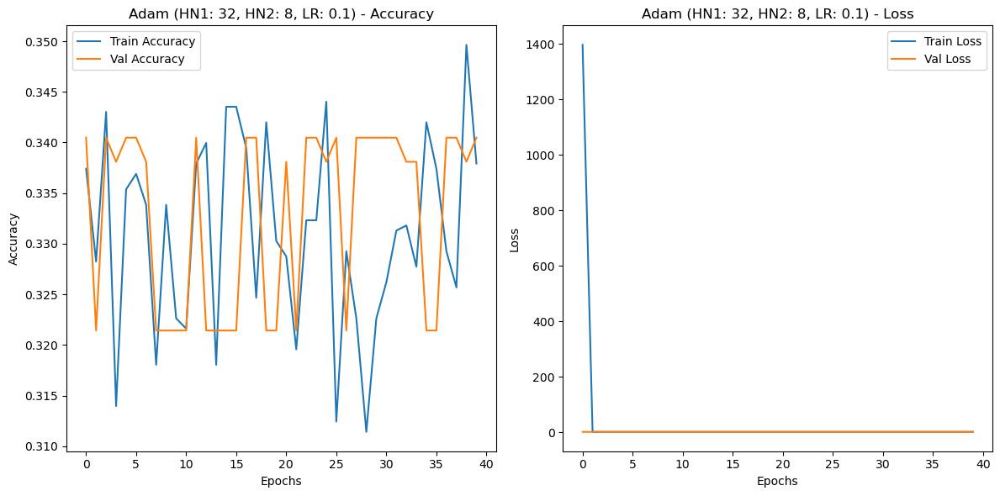


[INFO] Training RProp optimizer with 32 first hidden neurons, 8 second hidden neurons, and 0.1 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 49ms/step - accuracy: 0.3257 - loss: 2345.2798 - val_accuracy: 0.3381 - val_loss: 1.0992
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3348 - loss: 3.7439 - val_accuracy: 0.3381 - val_loss: 1.0992
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 49ms/step - accuracy: 0.3149 - loss: 2.6806 - val_accuracy: 0.3381 - val_loss: 1.0992
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 48ms/step - accuracy: 0.3406 - loss: 1.5401 - val_accuracy: 0.3381 - val_loss: 1.0992
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 53ms/step - accuracy: 0.3448 - loss: 1.5812 - val_accuracy: 0.3381 - val_loss: 1.0992
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 51ms/step - accuracy: 0.3334 - loss: 1.5279 - val_accuracy: 0.3381 - val_loss: 1.0992
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 52ms/step - accuracy: 0.3267 - loss: 1.2457 - val_accuracy: 0.3381 - val_loss: 1.09

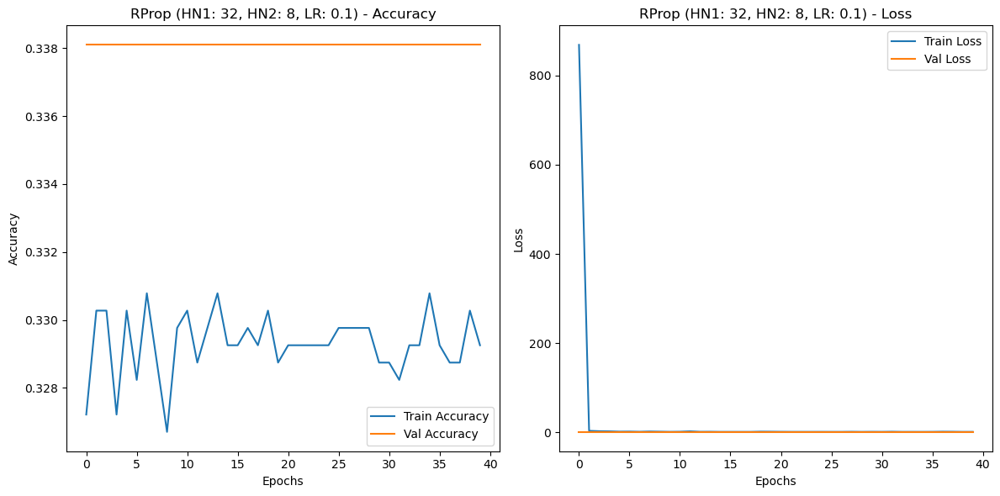


[INFO] Training Adam optimizer with 32 first hidden neurons, 16 second hidden neurons, and 0.0001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 69ms/step - accuracy: 0.3341 - loss: 8226.6240 - val_accuracy: 0.3381 - val_loss: 3226.2627
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3494 - loss: 7066.9727 - val_accuracy: 0.3381 - val_loss: 2620.4834
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 69ms/step - accuracy: 0.3491 - loss: 7206.9531 - val_accuracy: 0.3381 - val_loss: 2197.2981
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - accuracy: 0.3421 - loss: 6397.7764 - val_accuracy: 0.3381 - val_loss: 1874.5483
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3414 - loss: 6666.4258 - val_accuracy: 0.3381 - val_loss: 1582.8286
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3071 - loss: 6728.0420 - val_accuracy: 0.3381 - val_loss: 1231.2024
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3479 - loss: 6121.0288 

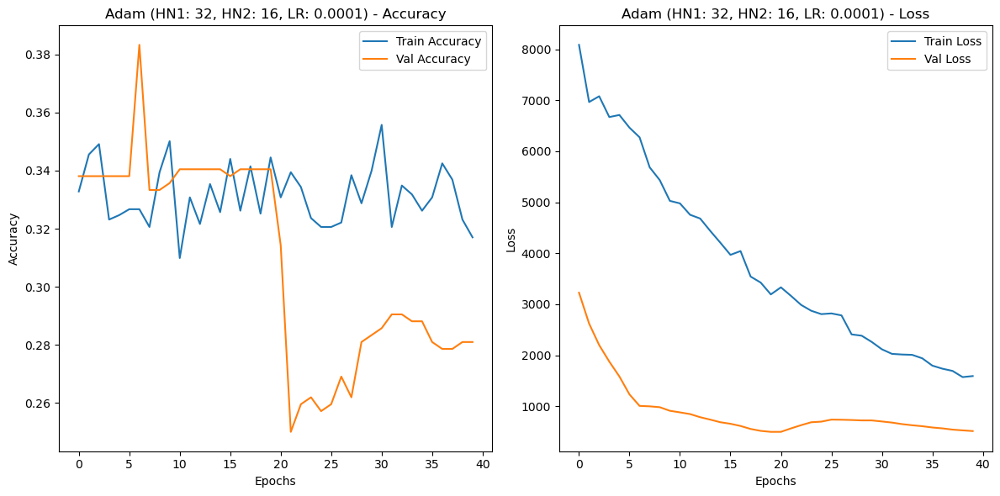


[INFO] Training RProp optimizer with 32 first hidden neurons, 16 second hidden neurons, and 0.0001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3294 - loss: 8782.9492 - val_accuracy: 0.3381 - val_loss: 2139.6819
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3310 - loss: 6107.3477 - val_accuracy: 0.5238 - val_loss: 452.7321
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3287 - loss: 2333.0322 - val_accuracy: 0.3405 - val_loss: 445.0168
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3433 - loss: 1515.6936 - val_accuracy: 0.3405 - val_loss: 420.2485
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3216 - loss: 1119.2343 - val_accuracy: 0.3405 - val_loss: 333.1101
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3677 - loss: 660.0099 - val_accuracy: 0.3405 - val_loss: 191.7053
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3308 - loss: 518.7856 - val_

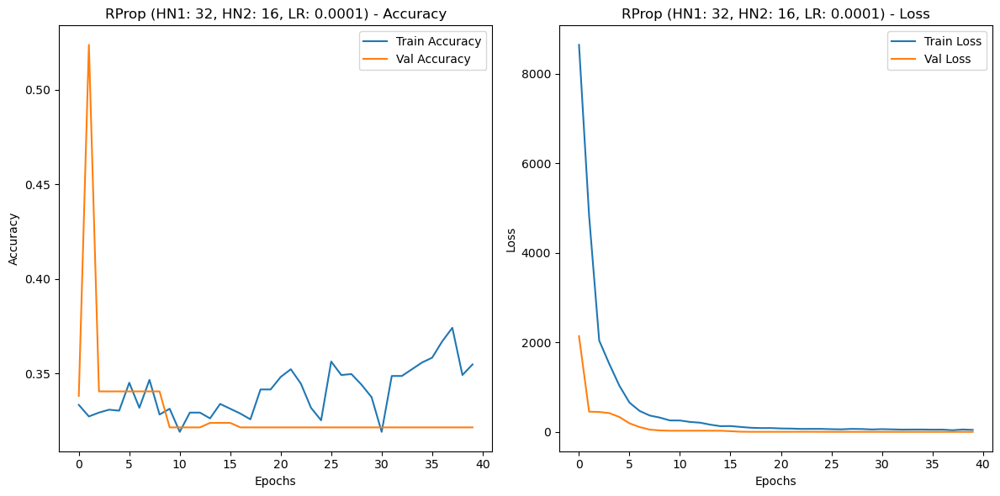


[INFO] Training Adam optimizer with 32 first hidden neurons, 16 second hidden neurons, and 0.001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3341 - loss: 8740.9756 - val_accuracy: 0.3381 - val_loss: 2330.0823
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3249 - loss: 5825.6006 - val_accuracy: 0.3381 - val_loss: 1132.4713
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - accuracy: 0.3297 - loss: 3386.0593 - val_accuracy: 0.4000 - val_loss: 437.7682
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 73ms/step - accuracy: 0.3048 - loss: 2051.9441 - val_accuracy: 0.3214 - val_loss: 180.2520
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3342 - loss: 1217.4429 - val_accuracy: 0.3286 - val_loss: 61.0905
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 68ms/step - accuracy: 0.3281 - loss: 712.8125 - val_accuracy: 0.3405 - val_loss: 1.0988
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 74ms/step - accuracy: 0.3292 - loss: 516.1324 - val_accu

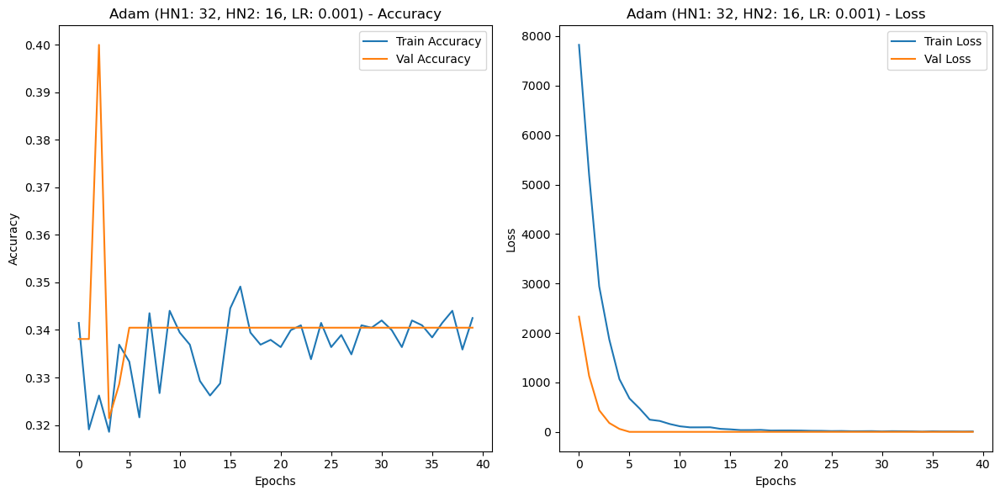


[INFO] Training RProp optimizer with 32 first hidden neurons, 16 second hidden neurons, and 0.001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 48ms/step - accuracy: 0.3584 - loss: 14316.0703 - val_accuracy: 0.2500 - val_loss: 827.0283
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 52ms/step - accuracy: 0.3661 - loss: 1700.2975 - val_accuracy: 0.3310 - val_loss: 92.0641
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 49ms/step - accuracy: 0.3541 - loss: 312.7038 - val_accuracy: 0.3214 - val_loss: 1.1045
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3348 - loss: 116.7450 - val_accuracy: 0.3167 - val_loss: 1.1066
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3535 - loss: 73.7934 - val_accuracy: 0.3214 - val_loss: 1.1023
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3521 - loss: 75.1314 - val_accuracy: 0.3214 - val_loss: 1.1023
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 48ms/step - accuracy: 0.3601 - loss: 64.6794 - val_accuracy: 0.3214

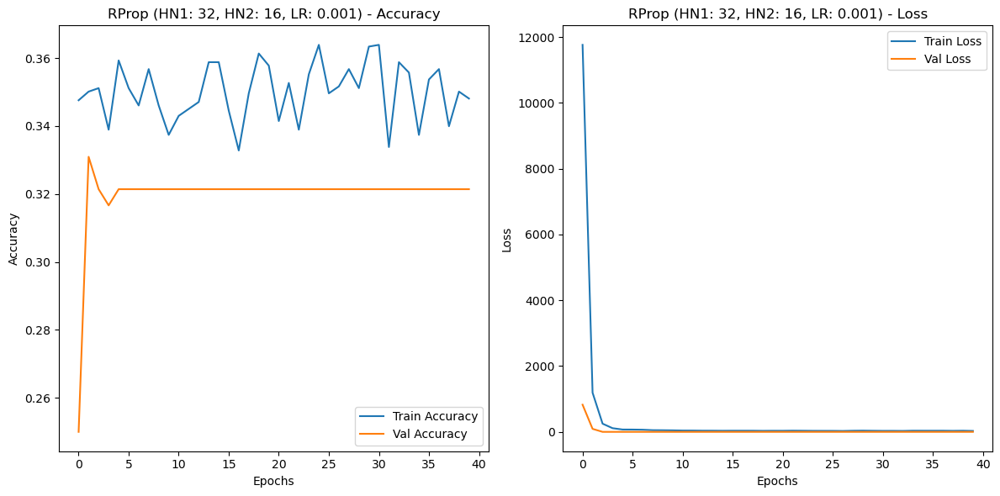


[INFO] Training Adam optimizer with 32 first hidden neurons, 16 second hidden neurons, and 0.01 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 96ms/step - accuracy: 0.3169 - loss: 3991.5205 - val_accuracy: 0.3405 - val_loss: 1.1040
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 78ms/step - accuracy: 0.3291 - loss: 25.5985 - val_accuracy: 0.3405 - val_loss: 1.1000
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 74ms/step - accuracy: 0.3372 - loss: 7.5671 - val_accuracy: 0.3381 - val_loss: 1.0987
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 75ms/step - accuracy: 0.3203 - loss: 4.6703 - val_accuracy: 0.3405 - val_loss: 1.0985
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 70ms/step - accuracy: 0.3512 - loss: 3.0698 - val_accuracy: 0.3405 - val_loss: 1.0983
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 76ms/step - accuracy: 0.3179 - loss: 4.3530 - val_accuracy: 0.3405 - val_loss: 1.0984
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 75ms/step - accuracy: 0.3171 - loss: 2.0859 - val_accuracy: 0.3381 - val_loss: 1.

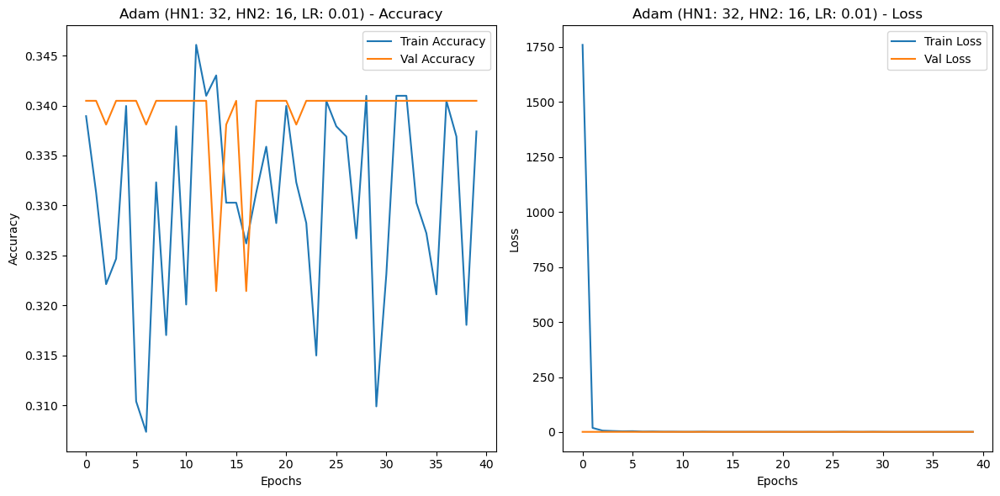


[INFO] Training RProp optimizer with 32 first hidden neurons, 16 second hidden neurons, and 0.01 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3549 - loss: 8516.5947 - val_accuracy: 0.3214 - val_loss: 588.5215
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3415 - loss: 1153.9575 - val_accuracy: 0.5238 - val_loss: 108.6974
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3918 - loss: 365.2981 - val_accuracy: 0.3381 - val_loss: 43.2502
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3787 - loss: 123.7133 - val_accuracy: 0.4714 - val_loss: 17.7493
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.4344 - loss: 57.5208 - val_accuracy: 0.4619 - val_loss: 9.3404
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.4075 - loss: 24.6500 - val_accuracy: 0.4190 - val_loss: 2.4300
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3756 - loss: 9.5010 - val_accuracy: 0.3690

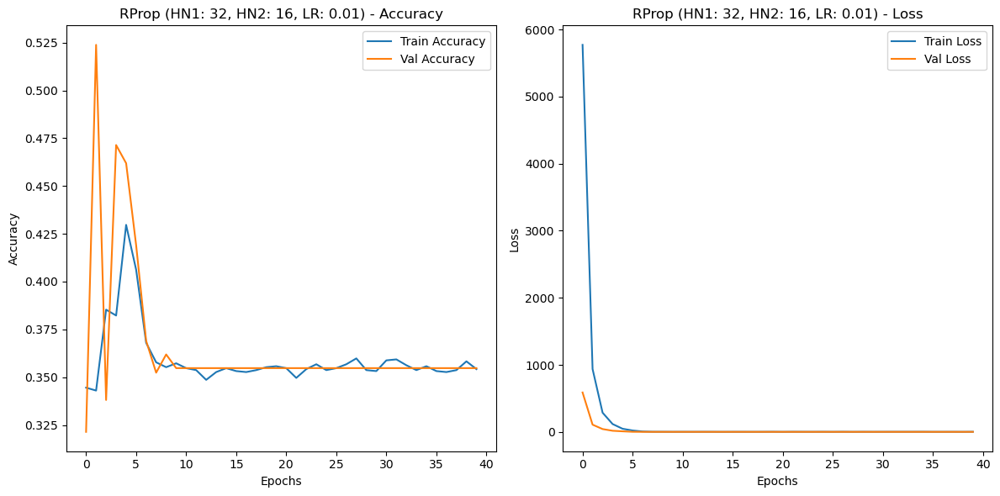


[INFO] Training Adam optimizer with 32 first hidden neurons, 16 second hidden neurons, and 0.1 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - accuracy: 0.3057 - loss: 2350.9360 - val_accuracy: 0.3405 - val_loss: 1.0991
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3284 - loss: 1.1231 - val_accuracy: 0.3214 - val_loss: 1.0994
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - accuracy: 0.3210 - loss: 1.1006 - val_accuracy: 0.3405 - val_loss: 1.1067
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 70ms/step - accuracy: 0.3640 - loss: 1.1046 - val_accuracy: 0.3214 - val_loss: 1.1046
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 68ms/step - accuracy: 0.3243 - loss: 1.1045 - val_accuracy: 0.3381 - val_loss: 1.0986
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 77ms/step - accuracy: 0.3391 - loss: 1.1011 - val_accuracy: 0.3214 - val_loss: 1.1057
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - accuracy: 0.3368 - loss: 1.1060 - val_accuracy: 0.3214 - val_loss: 1.10

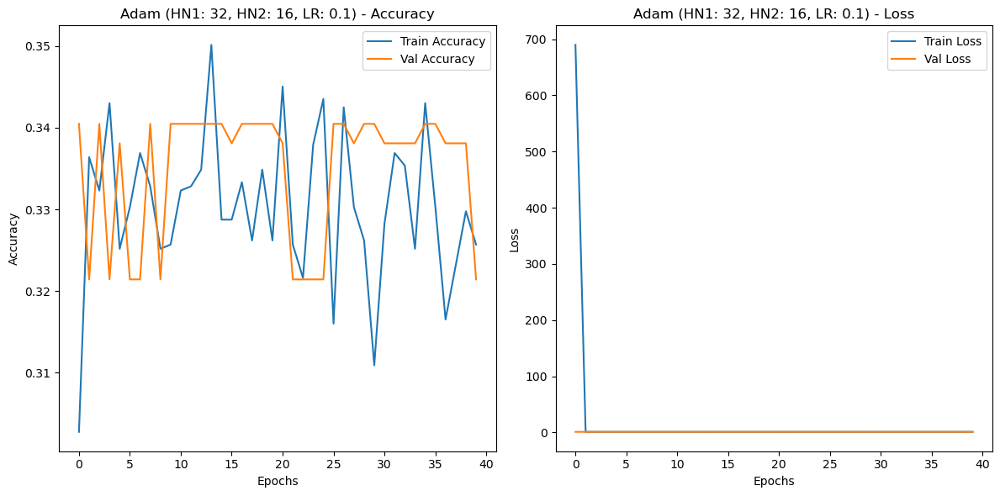


[INFO] Training RProp optimizer with 32 first hidden neurons, 16 second hidden neurons, and 0.1 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3363 - loss: 1795.5946 - val_accuracy: 0.3214 - val_loss: 1.0990
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3480 - loss: 48.1064 - val_accuracy: 0.3214 - val_loss: 1.0990
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3343 - loss: 35.5262 - val_accuracy: 0.3214 - val_loss: 1.0990
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3340 - loss: 24.1233 - val_accuracy: 0.3214 - val_loss: 1.0990
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 49ms/step - accuracy: 0.3274 - loss: 19.5709 - val_accuracy: 0.3214 - val_loss: 1.0990
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3376 - loss: 20.8019 - val_accuracy: 0.3214 - val_loss: 1.0990
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3291 - loss: 22.7883 - val_accuracy: 0.3214 - val_los

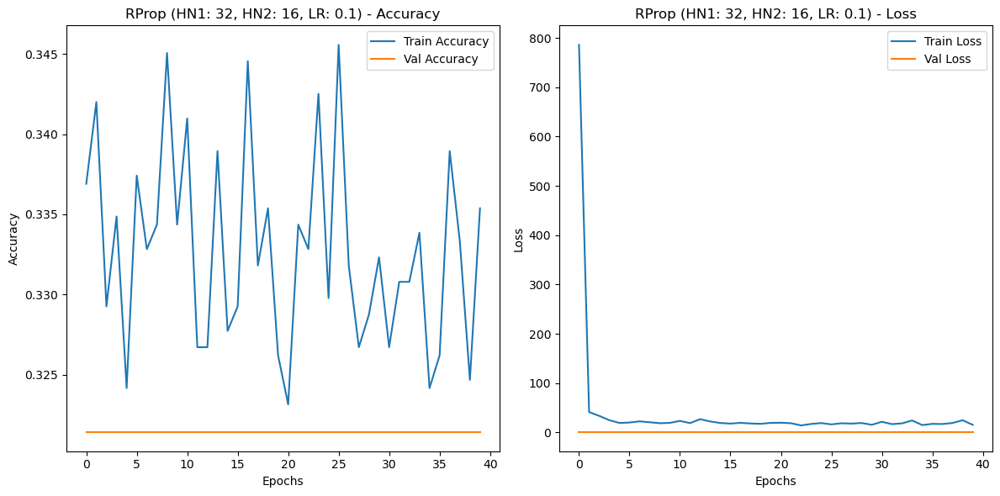


[INFO] Training Adam optimizer with 32 first hidden neurons, 32 second hidden neurons, and 0.0001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 76ms/step - accuracy: 0.3294 - loss: 13062.9473 - val_accuracy: 0.3214 - val_loss: 6888.2334
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 69ms/step - accuracy: 0.3470 - loss: 11146.3604 - val_accuracy: 0.3214 - val_loss: 5912.9419
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3423 - loss: 11294.4492 - val_accuracy: 0.3214 - val_loss: 5064.7861
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 71ms/step - accuracy: 0.3291 - loss: 10321.5283 - val_accuracy: 0.3214 - val_loss: 4422.0044
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - accuracy: 0.3417 - loss: 10080.4561 - val_accuracy: 0.3214 - val_loss: 3826.5654
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - accuracy: 0.3343 - loss: 8472.5801 - val_accuracy: 0.3214 - val_loss: 3347.3911
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - accuracy: 0.3143 - loss: 8726.

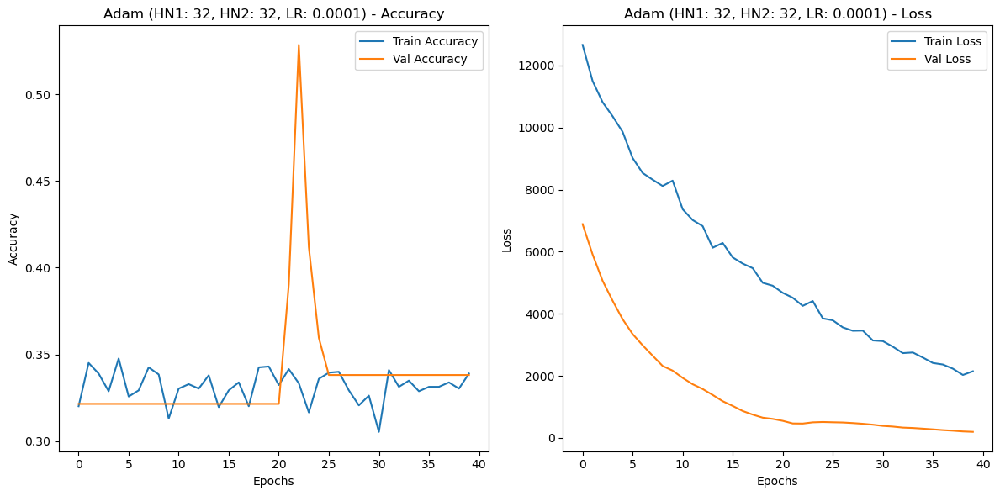


[INFO] Training RProp optimizer with 32 first hidden neurons, 32 second hidden neurons, and 0.0001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3224 - loss: 9419.3193 - val_accuracy: 0.3405 - val_loss: 3508.5056
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3235 - loss: 5100.5947 - val_accuracy: 0.3381 - val_loss: 795.2171
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3410 - loss: 2527.4641 - val_accuracy: 0.3381 - val_loss: 475.3221
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3225 - loss: 2284.3420 - val_accuracy: 0.3524 - val_loss: 333.5688
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3492 - loss: 1636.3237 - val_accuracy: 0.3048 - val_loss: 300.1338
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3644 - loss: 1485.9893 - val_accuracy: 0.3000 - val_loss: 291.3920
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3359 - loss: 1305.3435 - va

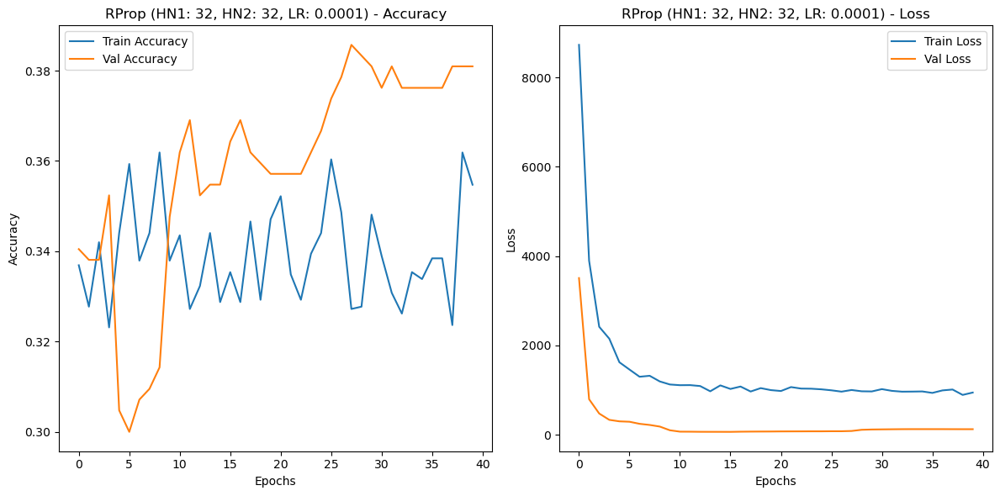


[INFO] Training Adam optimizer with 32 first hidden neurons, 32 second hidden neurons, and 0.001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3366 - loss: 7940.0352 - val_accuracy: 0.3381 - val_loss: 562.2952
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3211 - loss: 5095.1401 - val_accuracy: 0.3381 - val_loss: 838.6021
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3303 - loss: 3502.5408 - val_accuracy: 0.3381 - val_loss: 437.7630
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3307 - loss: 2256.4783 - val_accuracy: 0.3381 - val_loss: 294.2473
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3352 - loss: 1574.7207 - val_accuracy: 0.3381 - val_loss: 184.8361
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3262 - loss: 1071.0845 - val_accuracy: 0.3048 - val_loss: 55.4862
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3111 - loss: 700.5814 - val_acc

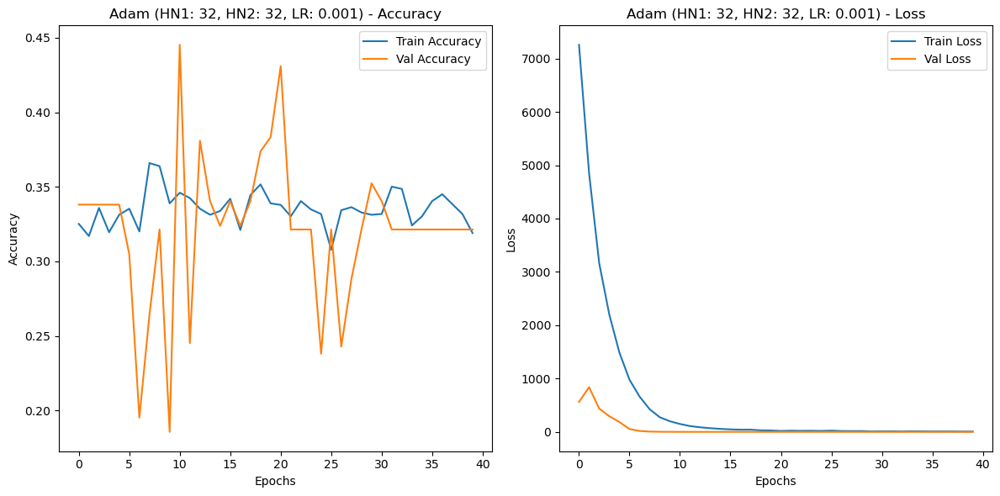


[INFO] Training RProp optimizer with 32 first hidden neurons, 32 second hidden neurons, and 0.001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3292 - loss: 5771.5972 - val_accuracy: 0.3405 - val_loss: 517.3664
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3513 - loss: 3381.1226 - val_accuracy: 0.3381 - val_loss: 544.8523
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3391 - loss: 2559.1541 - val_accuracy: 0.3381 - val_loss: 651.6373
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3384 - loss: 1942.8066 - val_accuracy: 0.4071 - val_loss: 78.6735
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3328 - loss: 1679.0977 - val_accuracy: 0.3476 - val_loss: 206.2475
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3328 - loss: 1401.4197 - val_accuracy: 0.3476 - val_loss: 135.6817
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3654 - loss: 1208.5935 - val_a

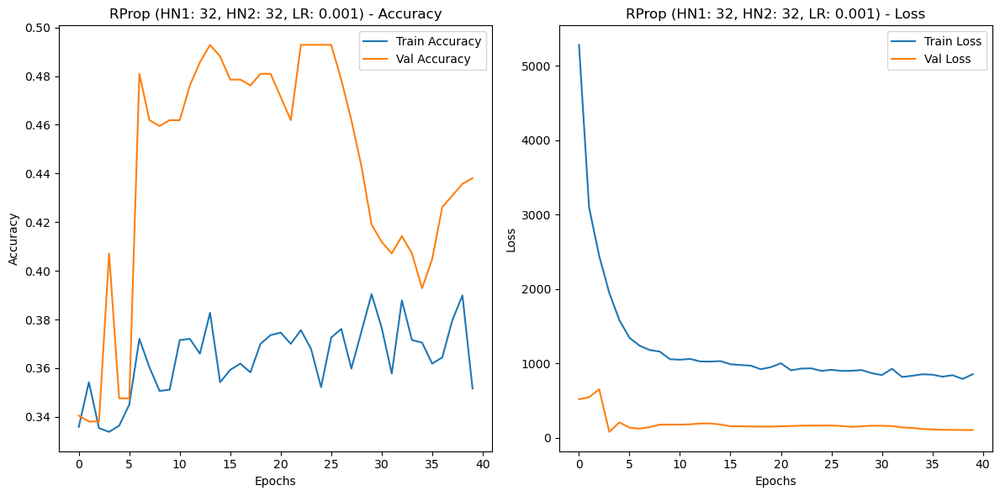


[INFO] Training Adam optimizer with 32 first hidden neurons, 32 second hidden neurons, and 0.01 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 71ms/step - accuracy: 0.3337 - loss: 3691.8555 - val_accuracy: 0.3405 - val_loss: 1.9463
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 71ms/step - accuracy: 0.3417 - loss: 78.6839 - val_accuracy: 0.3405 - val_loss: 1.1091
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 68ms/step - accuracy: 0.3332 - loss: 17.9641 - val_accuracy: 0.3405 - val_loss: 1.1027
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 72ms/step - accuracy: 0.3378 - loss: 7.5515 - val_accuracy: 0.3405 - val_loss: 1.1008
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3414 - loss: 6.2215 - val_accuracy: 0.3214 - val_loss: 1.1004
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3374 - loss: 4.4081 - val_accuracy: 0.3405 - val_loss: 1.0994
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3507 - loss: 3.3637 - val_accuracy: 0.3214 - val_loss: 1

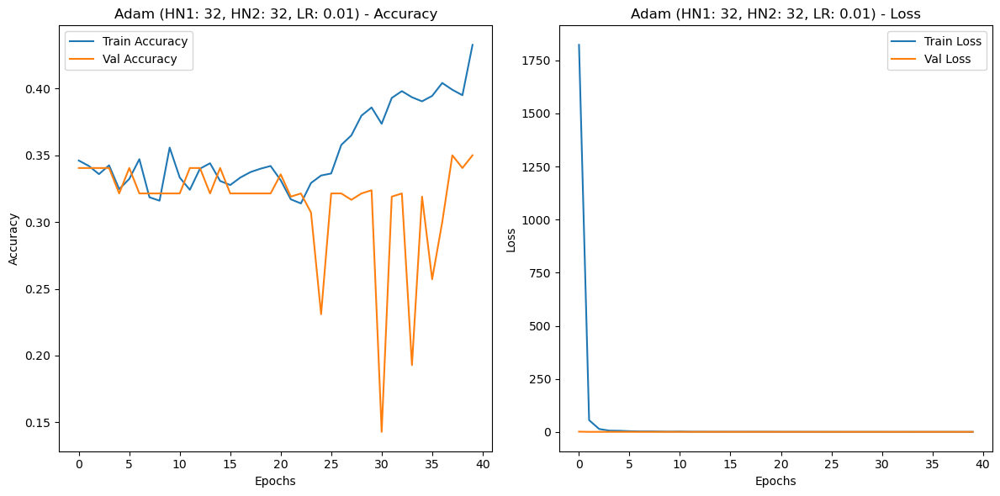


[INFO] Training RProp optimizer with 32 first hidden neurons, 32 second hidden neurons, and 0.01 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 53ms/step - accuracy: 0.3471 - loss: 7466.0273 - val_accuracy: 0.3214 - val_loss: 413.2045
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3464 - loss: 694.8839 - val_accuracy: 0.3714 - val_loss: 62.9988
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3400 - loss: 113.6631 - val_accuracy: 0.3405 - val_loss: 6.6605
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 48ms/step - accuracy: 0.3200 - loss: 12.9158 - val_accuracy: 0.3381 - val_loss: 5.6862
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3021 - loss: 11.3662 - val_accuracy: 0.3381 - val_loss: 1.7115
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.2919 - loss: 4.4373 - val_accuracy: 0.3381 - val_loss: 1.6178
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 48ms/step - accuracy: 0.3102 - loss: 2.9713 - val_accuracy: 0.3381 - val

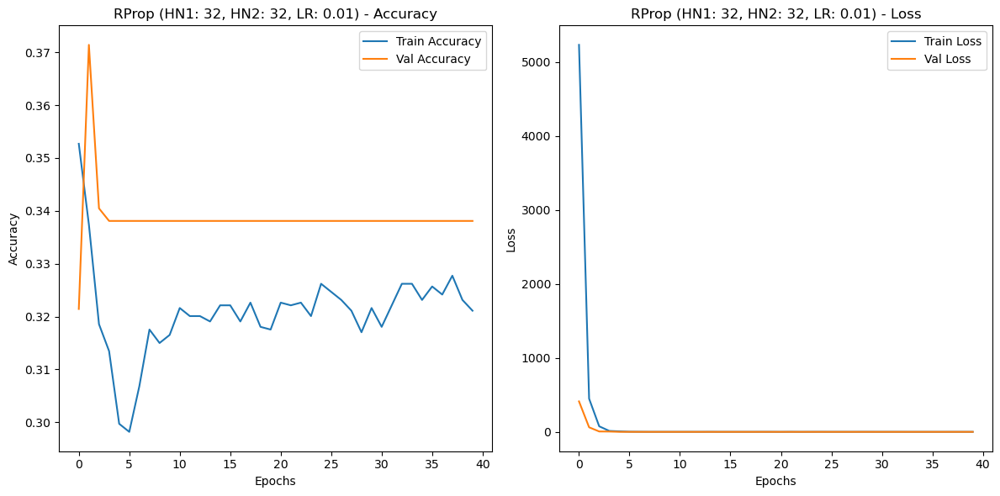


[INFO] Training Adam optimizer with 32 first hidden neurons, 32 second hidden neurons, and 0.1 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 83ms/step - accuracy: 0.3149 - loss: 1837.8835 - val_accuracy: 0.3405 - val_loss: 1.0993
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 69ms/step - accuracy: 0.3542 - loss: 1.0984 - val_accuracy: 0.3214 - val_loss: 1.1048
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 76ms/step - accuracy: 0.3198 - loss: 1.1053 - val_accuracy: 0.3214 - val_loss: 1.1022
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 79ms/step - accuracy: 0.3227 - loss: 1.1013 - val_accuracy: 0.3381 - val_loss: 1.1012
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 68ms/step - accuracy: 0.3347 - loss: 1.1040 - val_accuracy: 0.3214 - val_loss: 1.0996
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 70ms/step - accuracy: 0.3287 - loss: 1.1023 - val_accuracy: 0.3405 - val_loss: 1.1018
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 72ms/step - accuracy: 0.3332 - loss: 1.1008 - val_accuracy: 0.3381 - val_loss: 1.09

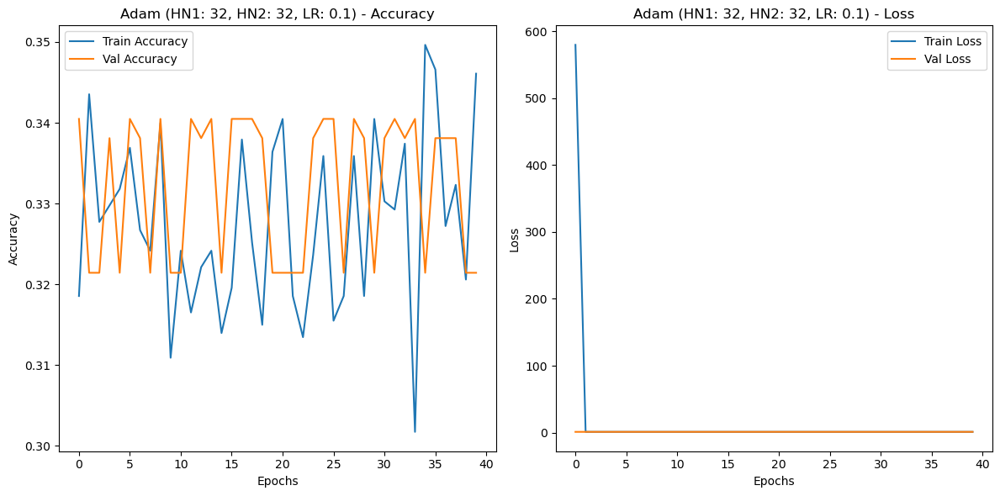


[INFO] Training RProp optimizer with 32 first hidden neurons, 32 second hidden neurons, and 0.1 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3540 - loss: 3210.3489 - val_accuracy: 0.3214 - val_loss: 28.6910
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3363 - loss: 473.2087 - val_accuracy: 0.3190 - val_loss: 8.4223
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3618 - loss: 295.4263 - val_accuracy: 0.5357 - val_loss: 9.6524
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3672 - loss: 231.1628 - val_accuracy: 0.5000 - val_loss: 13.0835
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3583 - loss: 202.2916 - val_accuracy: 0.4333 - val_loss: 8.5637
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3563 - loss: 182.9932 - val_accuracy: 0.3524 - val_loss: 8.4650
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3452 - loss: 174.7861 - val_accuracy: 0.3524 -

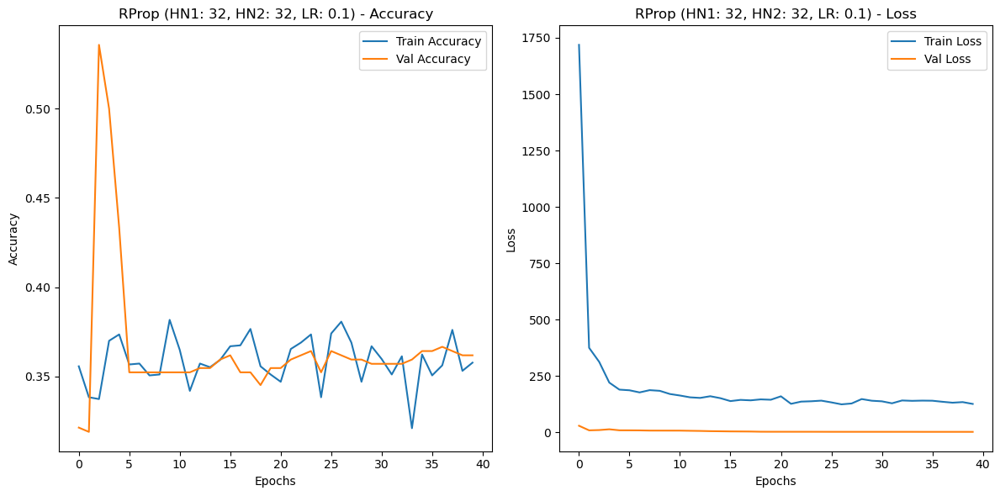


[INFO] Training Adam optimizer with 32 first hidden neurons, 64 second hidden neurons, and 0.0001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 71ms/step - accuracy: 0.3362 - loss: 8273.0430 - val_accuracy: 0.3405 - val_loss: 3650.2959
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3357 - loss: 8074.8223 - val_accuracy: 0.3357 - val_loss: 2961.7444
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 58ms/step - accuracy: 0.3572 - loss: 6904.1523 - val_accuracy: 0.3190 - val_loss: 2445.3030
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3186 - loss: 6434.2266 - val_accuracy: 0.3190 - val_loss: 2140.7021
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3452 - loss: 6374.6367 - val_accuracy: 0.3214 - val_loss: 1810.3917
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3287 - loss: 6098.8071 - val_accuracy: 0.3214 - val_loss: 1473.3890
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - accuracy: 0.3293 - loss: 5630.6929 

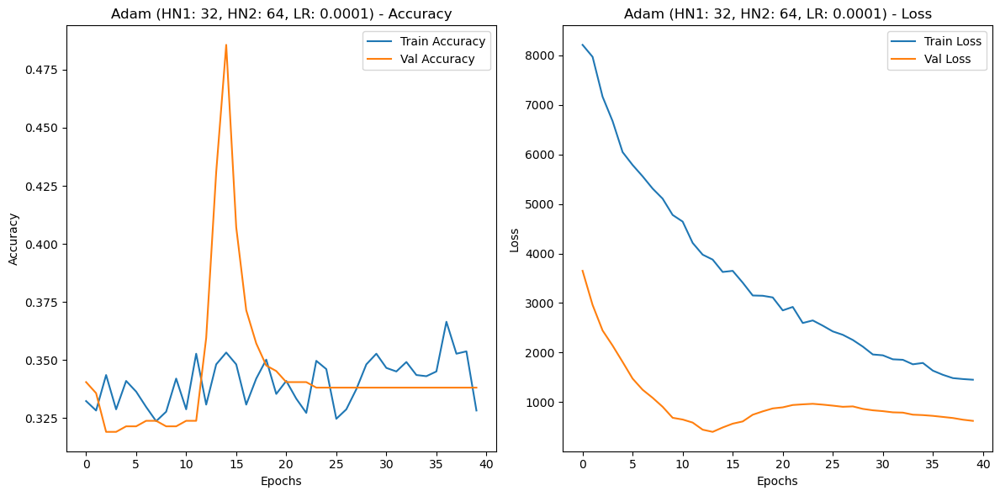


[INFO] Training RProp optimizer with 32 first hidden neurons, 64 second hidden neurons, and 0.0001 learning rate

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3312 - loss: 9579.7217 - val_accuracy: 0.3381 - val_loss: 4818.1665
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 49ms/step - accuracy: 0.3248 - loss: 6066.3794 - val_accuracy: 0.3905 - val_loss: 925.0179
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3355 - loss: 4527.3198 - val_accuracy: 0.3381 - val_loss: 1052.3123
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3210 - loss: 3604.7754 - val_accuracy: 0.3381 - val_loss: 1112.8826
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3341 - loss: 2663.6055 - val_accuracy: 0.3381 - val_loss: 804.0939
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 52ms/step - accuracy: 0.3425 - loss: 2269.8271 - val_accuracy: 0.3381 - val_loss: 595.8459
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3443 - loss: 2092.6245 - 

In [ ]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout
import matplotlib.pyplot as plt
import pandas as pd
from sklearn.impute import SimpleImputer
import numpy as np
import random
import time
import seaborn as sns

SEED = 42
np.random.seed(SEED)
tf.random.set_seed(SEED)
random.seed(SEED)

def create_model(hidden_neurons_1, hidden_neurons_2, input_shape, dropout_rate=0.5):
    model = Sequential()
    model.add(tf.keras.Input(shape=(input_shape,)))
    model.add(Dense(hidden_neurons_1, activation='relu'))
    model.add(Dropout(dropout_rate))  
    model.add(Dense(hidden_neurons_2, activation='relu')) 
    model.add(Dropout(dropout_rate))  
    model.add(Dense(len(label_encoder.classes_), activation='softmax'))
    return model

import matplotlib.pyplot as plt

def plot_training_history(history, optimizer_name):
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['accuracy'], label='Train Accuracy')
    plt.plot(history.history['val_accuracy'], label='Val Accuracy')
    plt.title(f'{optimizer_name} - Accuracy')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(history.history['loss'], label='Train Loss')
    plt.plot(history.history['val_loss'], label='Val Loss')
    plt.title(f'{optimizer_name} - Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()

    plt.tight_layout()
    plt.show()


def print_progress(message):
    print(f"\n[INFO] {message}\n")

print_progress("Imputing missing values for 'Roundness' column using median.")

median_imputer = SimpleImputer(strategy='median')
data_imputed = data.copy()
data_imputed['Roundness'] = median_imputer.fit_transform(data[['Roundness']])


hidden_neurons_1_options = [4,8, 16, 32, 64, 128] 
hidden_neurons_2_options = [4,8, 16, 32, 64, 128]  
learning_rate_options = [0.0001, 0.001, 0.01 ,0.1]
epochs = 40
batch_size = 64

results = []

start_time = time.time()

for hidden_neurons_1 in hidden_neurons_1_options:
    for hidden_neurons_2 in hidden_neurons_2_options:
        for learning_rate in learning_rate_options:
            # Adam optimizer model
            print_progress(f"Training Adam optimizer with {hidden_neurons_1} first hidden neurons, {hidden_neurons_2} second hidden neurons, and {learning_rate} learning rate")
            
            model_adam = create_model(hidden_neurons_1, hidden_neurons_2, X_train.shape[1])
            optimizer_adam = tf.keras.optimizers.Adam(learning_rate=learning_rate)
            model_adam.compile(optimizer=optimizer_adam, loss='sparse_categorical_crossentropy', metrics=['accuracy'])
            
            history_adam = model_adam.fit(X_train, y_train_encoded, validation_data=(X_val, y_val_encoded), 
                                          epochs=epochs, batch_size=batch_size, verbose=1)
            
            # Plot training history for Adam optimizer
            plot_training_history(history_adam, f'Adam (HN1: {hidden_neurons_1}, HN2: {hidden_neurons_2}, LR: {learning_rate})')
            
            test_loss_adam, test_accuracy_adam = model_adam.evaluate(X_test, y_test_encoded, verbose=0)
            results.append({
                'optimizer': 'Adam',
                'hidden_neurons_1': hidden_neurons_1,
                'hidden_neurons_2': hidden_neurons_2,
                'learning_rate': learning_rate,
                'test_loss': test_loss_adam,
                'test_accuracy': test_accuracy_adam
            })

            # RProp optimizer model
            print_progress(f"Training RProp optimizer with {hidden_neurons_1} first hidden neurons, {hidden_neurons_2} second hidden neurons, and {learning_rate} learning rate")
            
            model_rprop = create_model(hidden_neurons_1, hidden_neurons_2, X_train.shape[1])
            optimizer_rprop = RPropOptimizer(learning_rate=learning_rate)  # Assume RPropOptimizer is defined
            model_rprop.compile(optimizer=optimizer_rprop, loss='sparse_categorical_crossentropy', metrics=['accuracy'])
            
            history_rprop = model_rprop.fit(X_train, y_train_encoded, validation_data=(X_val, y_val_encoded), 
                                            epochs=epochs, batch_size=batch_size, verbose=1)
            
            # Plot training history for RProp optimizer
            plot_training_history(history_rprop, f'RProp (HN1: {hidden_neurons_1}, HN2: {hidden_neurons_2}, LR: {learning_rate})')
            
            test_loss_rprop, test_accuracy_rprop = model_rprop.evaluate(X_test, y_test_encoded, verbose=0)
            results.append({
                'optimizer': 'RProp',
                'hidden_neurons_1': hidden_neurons_1,
                'hidden_neurons_2': hidden_neurons_2,
                'learning_rate': learning_rate,
                'test_loss': test_loss_rprop,
                'test_accuracy': test_accuracy_rprop
            })

execution_time = time.time() - start_time
print_progress(f"Total execution time: {execution_time:.2f} seconds")

results_df = pd.DataFrame(results)
results_df.to_csv('results.csv', index=False)
print_progress("Results saved to 'results.csv'.")

for optimizer_name in ['Adam', 'RProp']:
    pivot_table = results_df[results_df['optimizer'] == optimizer_name].pivot_table(
        values='test_accuracy', index=['hidden_neurons_1', 'hidden_neurons_2'], columns='learning_rate')
    plt.figure(figsize=(8, 6))
    sns.heatmap(pivot_table, annot=True, fmt=".4f", cmap="YlGnBu")
    plt.title(f'Test Accuracy with {optimizer_name} Optimizer')
    plt.ylabel('Hidden Neurons (HN1, HN2)')
    plt.xlabel('Learning Rate')
    plt.show()



[INFO] Training models with HN1: 16, HN2: 16, LR: 0.0001
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 69ms/step - accuracy: 0.3212 - loss: 5139.1714 - val_accuracy: 0.3381 - val_loss: 1490.1371
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - accuracy: 0.3063 - loss: 5168.5117 - val_accuracy: 0.3381 - val_loss: 1311.8978
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 71ms/step - accuracy: 0.3467 - loss: 4456.7847 - val_accuracy: 0.3381 - val_loss: 1133.2355
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - accuracy: 0.3417 - loss: 4438.0796 - val_accuracy: 0.3381 - val_loss: 933.7740
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - accuracy: 0.3478 - loss: 4046.6533 - val_accuracy: 0.3381 - val_loss: 803.1108
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - accuracy: 0.3188 - loss: 4160.7837 - val_accuracy: 0.3286 - val_loss: 672.6801
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 68ms/step - accuracy: 0.3304 - loss: 3653.9229 - val_accuracy: 0.3262 - val_loss: 580.0007
Epoch 8/40
31/3

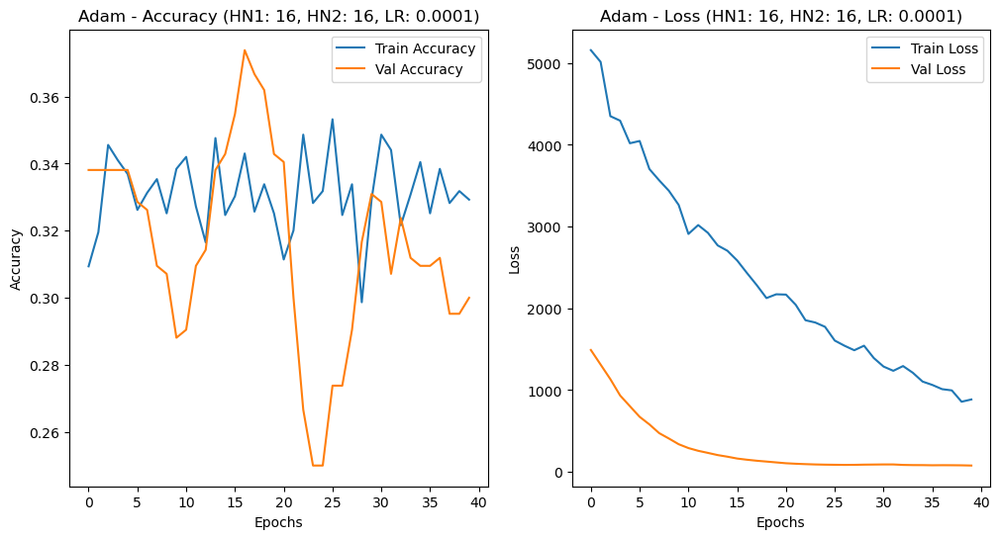

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3410 - loss: 7134.6802 - val_accuracy: 0.3405 - val_loss: 3573.6846
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3349 - loss: 4177.1816 - val_accuracy: 0.3905 - val_loss: 603.2506
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3681 - loss: 1295.5367 - val_accuracy: 0.3405 - val_loss: 368.8340
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3463 - loss: 821.1229 - val_accuracy: 0.3357 - val_loss: 197.9950
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3571 - loss: 265.8273 - val_accuracy: 0.3071 - val_loss: 50.6994
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3527 - loss: 160.0818 - val_accuracy: 0.3238 - val_loss: 20.6538
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3607 - loss: 101.2063 - val_accuracy: 0.4857 - val_loss: 5.9082
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3404 - loss: 53.74

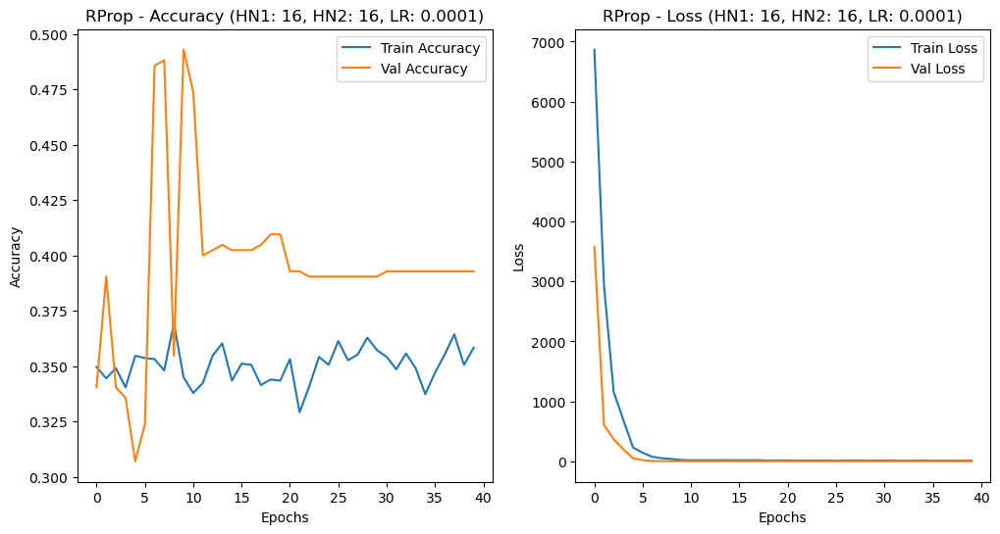

Adam Model - Test Loss: 75.0241, Test Accuracy: 0.2755
RProp Model - Test Loss: 1.8209, Test Accuracy: 0.4276
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
Hybrid Model - Test Accuracy: 0.3207

[INFO] Training models with HN1: 16, HN2: 16, LR: 0.001
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3215 - loss: 7730.1069 - val_accuracy: 0.3405 - val_loss: 1446.2617
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 58ms/step - accuracy: 0.3153 - loss: 5484.4097 - val_accuracy: 0.3524 - val_loss: 270.3988
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 58ms/step - accuracy: 0.3482 - loss: 3845.5012 - val_accuracy: 0.3405 - val_loss: 275.2092
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 58ms/step - accuracy: 0.3396 - loss: 2921.8213 - val_accuracy: 0.3310 - val_loss: 114.0982
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3338 - loss: 1833.8064 - val_accuracy: 0.3143 - val_loss: 278.5880
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 58ms/step - accu

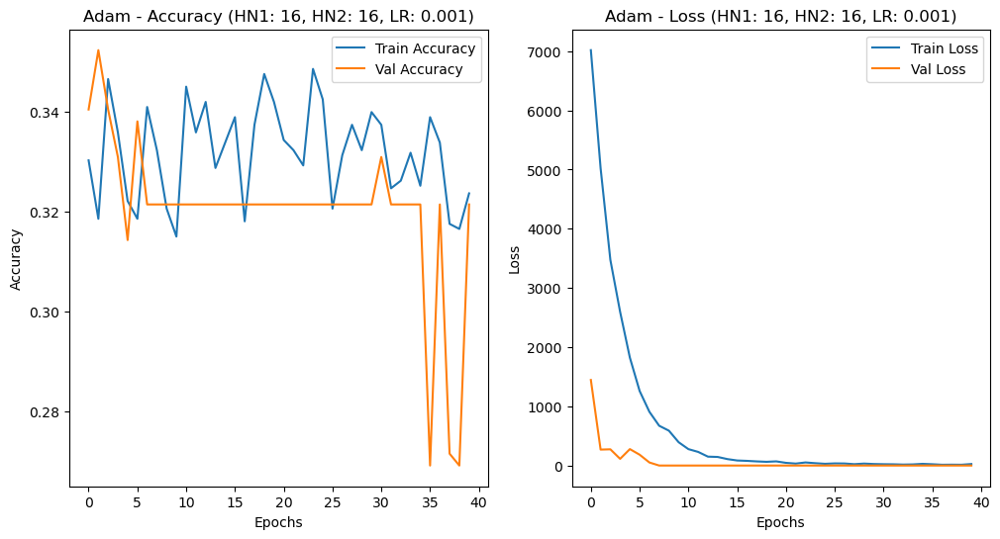

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3514 - loss: 13572.6904 - val_accuracy: 0.3238 - val_loss: 1214.4769
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3240 - loss: 5055.9917 - val_accuracy: 0.3214 - val_loss: 1163.0540
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3176 - loss: 1881.5349 - val_accuracy: 0.4690 - val_loss: 195.4720
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3291 - loss: 994.4520 - val_accuracy: 0.4714 - val_loss: 39.4993
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 40ms/step - accuracy: 0.3378 - loss: 312.1202 - val_accuracy: 0.2833 - val_loss: 83.8311
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3253 - loss: 145.6523 - val_accuracy: 0.2952 - val_loss: 43.4854
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3132 - loss: 75.1813 - val_accuracy: 0.3000 - val_loss: 24.5470
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 50ms/step - accuracy: 0.3168 - loss: 37.2

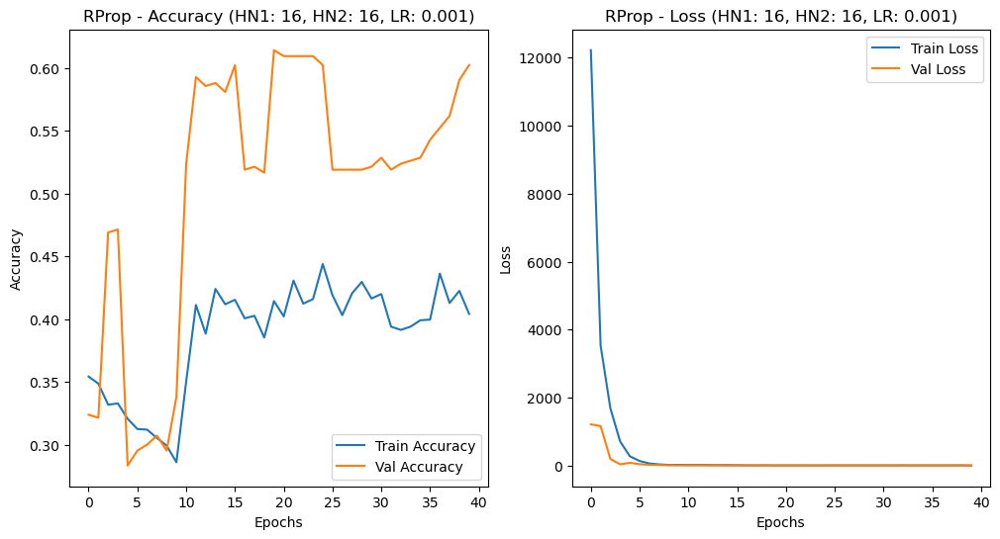

Adam Model - Test Loss: 1.0993, Test Accuracy: 0.3397
RProp Model - Test Loss: 3.2137, Test Accuracy: 0.5653
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
Hybrid Model - Test Accuracy: 0.5701

[INFO] Training models with HN1: 16, HN2: 16, LR: 0.01
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 74ms/step - accuracy: 0.2984 - loss: 7730.1963 - val_accuracy: 0.3881 - val_loss: 1.2533
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.3278 - loss: 264.9794 - val_accuracy: 0.2381 - val_loss: 1.2895
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 71ms/step - accuracy: 0.3076 - loss: 69.0607 - val_accuracy: 0.3452 - val_loss: 1.4330
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 78ms/step - accuracy: 0.3389 - loss: 14.6186 - val_accuracy: 0.4833 - val_loss: 1.0441
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.3574 - loss: 1.1344 - val_accuracy: 0.3548 - val_loss: 1.0732
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.3226 - loss: 

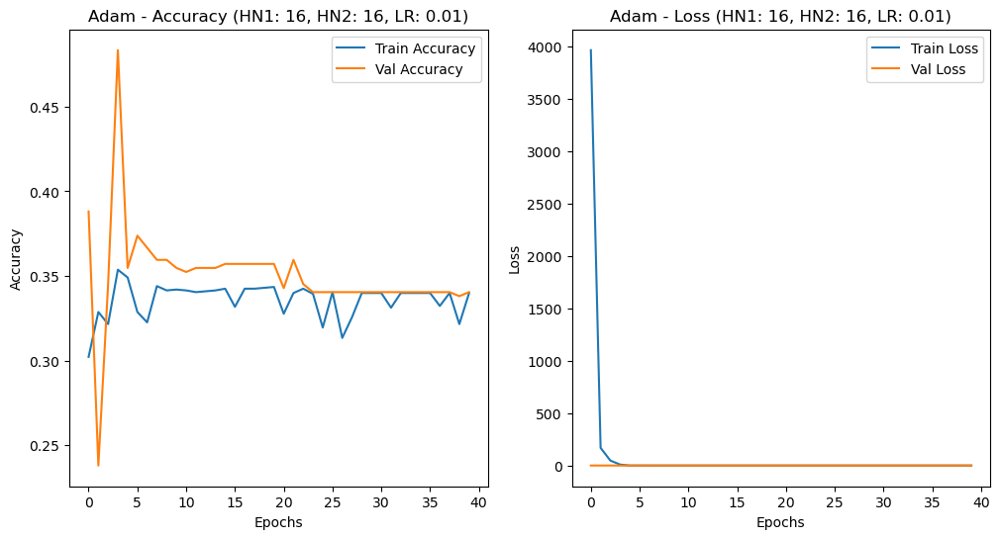

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3402 - loss: 7654.7510 - val_accuracy: 0.3405 - val_loss: 371.2278
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3608 - loss: 1808.7333 - val_accuracy: 0.3810 - val_loss: 119.4865
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 49ms/step - accuracy: 0.3687 - loss: 442.9104 - val_accuracy: 0.2881 - val_loss: 79.7615
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 54ms/step - accuracy: 0.3371 - loss: 245.1686 - val_accuracy: 0.3714 - val_loss: 13.1781
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3500 - loss: 125.6096 - val_accuracy: 0.4190 - val_loss: 17.8209
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3670 - loss: 95.9040 - val_accuracy: 0.4167 - val_loss: 13.3531
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3880 - loss: 75.3898 - val_accuracy: 0.4571 - val_loss: 8.4779
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3794 - loss: 51.2560 - v

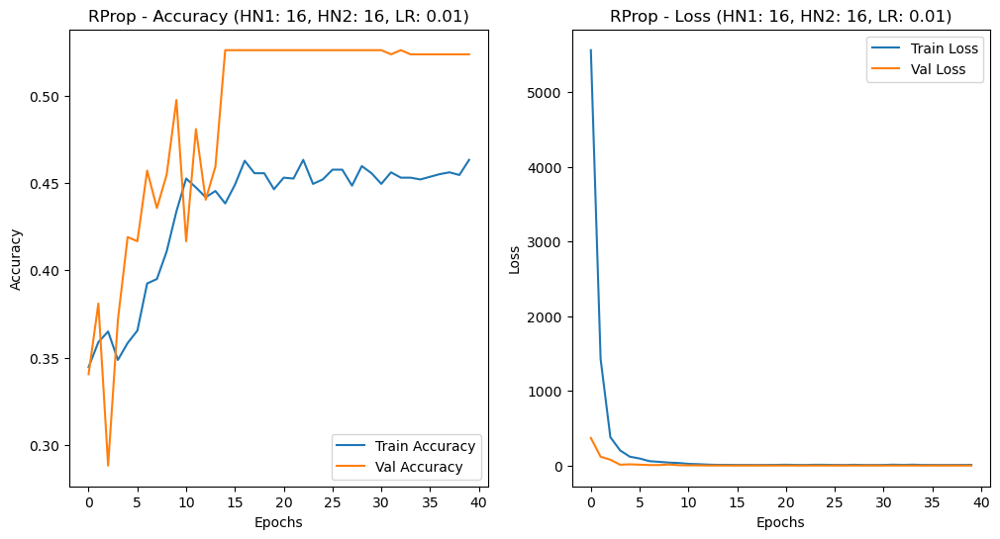

Adam Model - Test Loss: 1.0997, Test Accuracy: 0.3159
RProp Model - Test Loss: 1.9315, Test Accuracy: 0.5487
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
Hybrid Model - Test Accuracy: 0.3729

[INFO] Training models with HN1: 16, HN2: 16, LR: 0.1
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 74ms/step - accuracy: 0.3292 - loss: 1498.8944 - val_accuracy: 0.3405 - val_loss: 1.0988
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - accuracy: 0.3346 - loss: 1.1003 - val_accuracy: 0.3405 - val_loss: 1.0985
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 107ms/step - accuracy: 0.3333 - loss: 1.0988 - val_accuracy: 0.3214 - val_loss: 1.1002
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 77ms/step - accuracy: 0.3309 - loss: 1.1007 - val_accuracy: 0.3214 - val_loss: 1.0999
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.3520 - loss: 1.0991 - val_accuracy: 0.3405 - val_loss: 1.0991
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 75ms/step - accuracy: 0.3467 - loss: 1.10

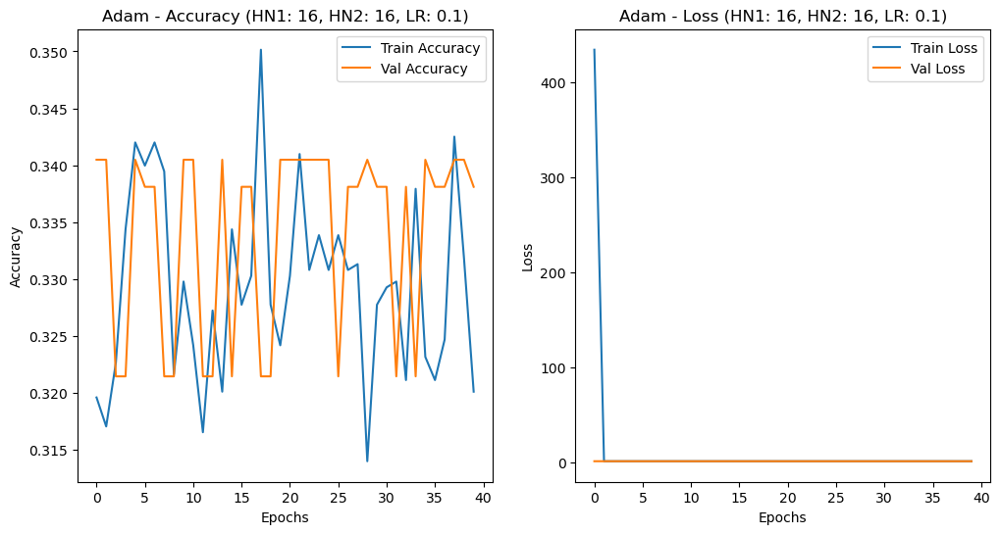

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3297 - loss: 628.3433 - val_accuracy: 0.3405 - val_loss: 1.0984
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3302 - loss: 1.1110 - val_accuracy: 0.3405 - val_loss: 1.0984
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3320 - loss: 1.1099 - val_accuracy: 0.3405 - val_loss: 1.0984
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3278 - loss: 1.0993 - val_accuracy: 0.3405 - val_loss: 1.0984
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3124 - loss: 1.0997 - val_accuracy: 0.3405 - val_loss: 1.0984
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 55ms/step - accuracy: 0.3468 - loss: 1.0985 - val_accuracy: 0.3405 - val_loss: 1.0984
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3427 - loss: 1.0983 - val_accuracy: 0.3405 - val_loss: 1.0984
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 49ms/step - accuracy: 0.3350 - loss: 1.0984 - val_accuracy: 0.3405 -

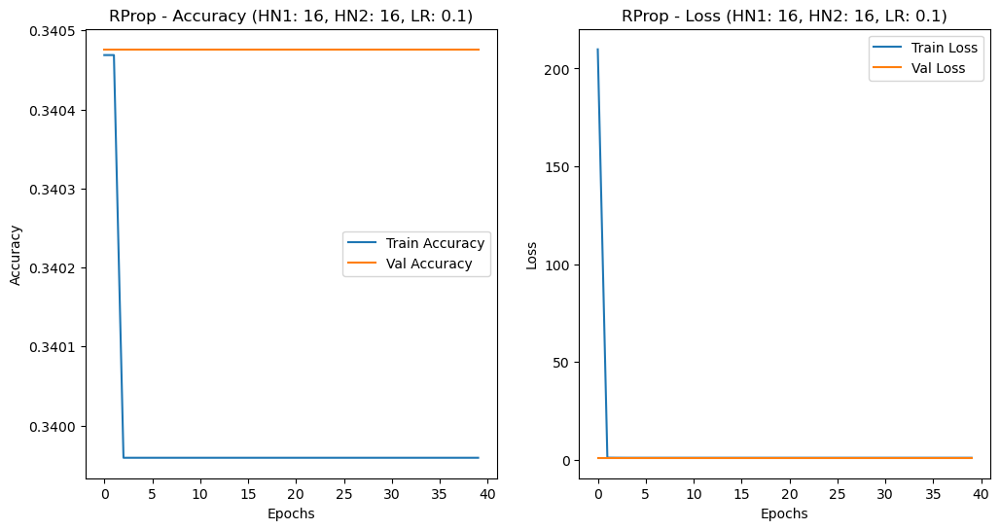

Adam Model - Test Loss: 1.0979, Test Accuracy: 0.3444
RProp Model - Test Loss: 1.0994, Test Accuracy: 0.3159
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
Hybrid Model - Test Accuracy: 0.3444

[INFO] Training models with HN1: 16, HN2: 32, LR: 0.0001
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3387 - loss: 7023.3911 - val_accuracy: 0.3405 - val_loss: 2611.8740
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3594 - loss: 7016.4492 - val_accuracy: 0.3405 - val_loss: 2343.5425
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3346 - loss: 6594.2539 - val_accuracy: 0.3405 - val_loss: 2110.7876
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3339 - loss: 6196.8174 - val_accuracy: 0.3405 - val_loss: 1936.3184
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3363 - loss: 6356.2544 - val_accuracy: 0.3405 - val_loss: 1740.2969
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - 

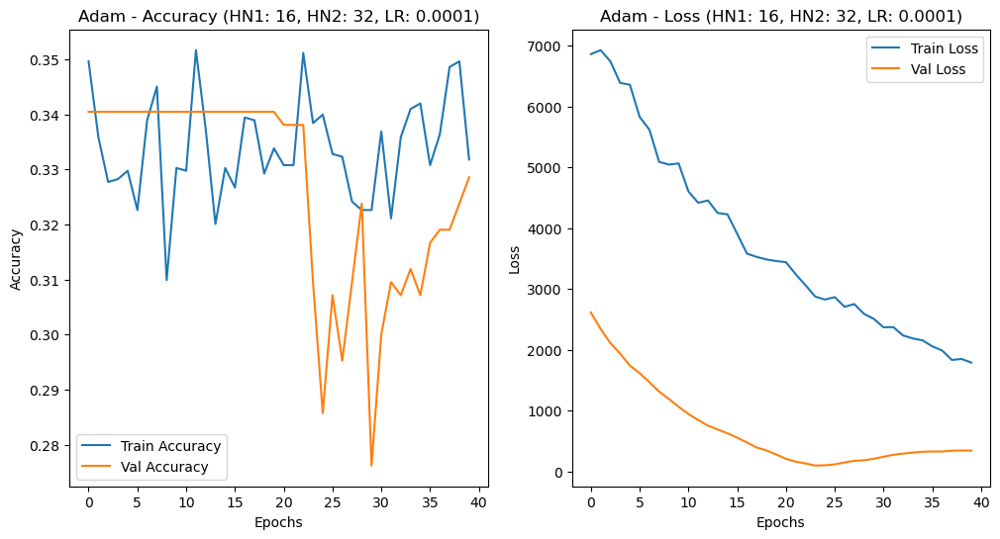

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3553 - loss: 11648.4258 - val_accuracy: 0.3214 - val_loss: 4069.6890
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3260 - loss: 8729.7881 - val_accuracy: 0.3405 - val_loss: 1113.0519
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3407 - loss: 5255.8950 - val_accuracy: 0.3405 - val_loss: 964.2268
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3434 - loss: 3832.0671 - val_accuracy: 0.3405 - val_loss: 939.2969
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3294 - loss: 3197.2837 - val_accuracy: 0.3405 - val_loss: 647.1720
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3262 - loss: 2669.5732 - val_accuracy: 0.3405 - val_loss: 325.8589
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3404 - loss: 2305.5090 - val_accuracy: 0.5095 - val_loss: 114.7634
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3547 - l

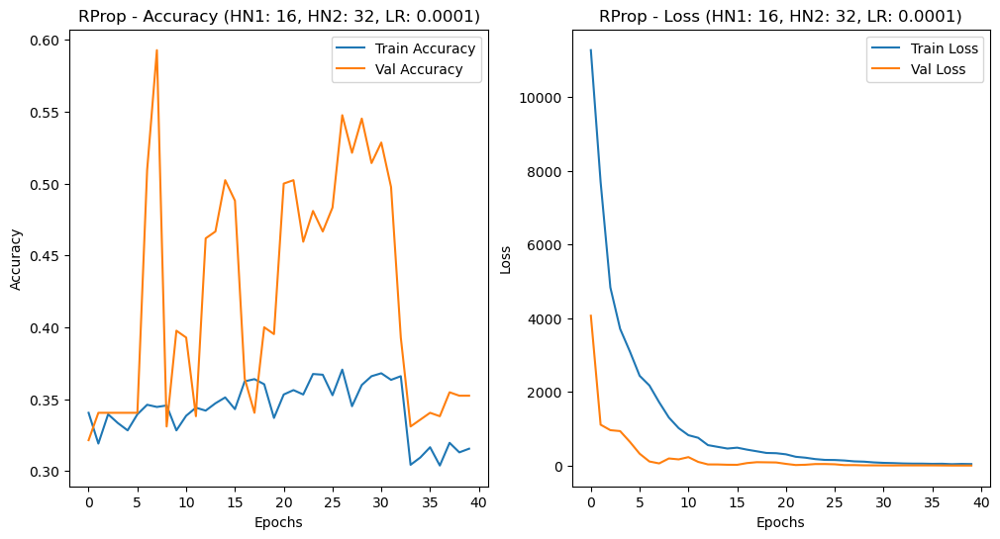

Adam Model - Test Loss: 345.8632, Test Accuracy: 0.3397
RProp Model - Test Loss: 4.4623, Test Accuracy: 0.3302
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
Hybrid Model - Test Accuracy: 0.3397

[INFO] Training models with HN1: 16, HN2: 32, LR: 0.001
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 74ms/step - accuracy: 0.3465 - loss: 5891.2402 - val_accuracy: 0.3238 - val_loss: 133.6424
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3496 - loss: 3913.7046 - val_accuracy: 0.3405 - val_loss: 331.8433
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 68ms/step - accuracy: 0.3633 - loss: 2515.4719 - val_accuracy: 0.4024 - val_loss: 162.6594
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3269 - loss: 1843.8297 - val_accuracy: 0.3452 - val_loss: 137.0249
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3322 - loss: 1456.6857 - val_accuracy: 0.3595 - val_loss: 97.2164
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - accur

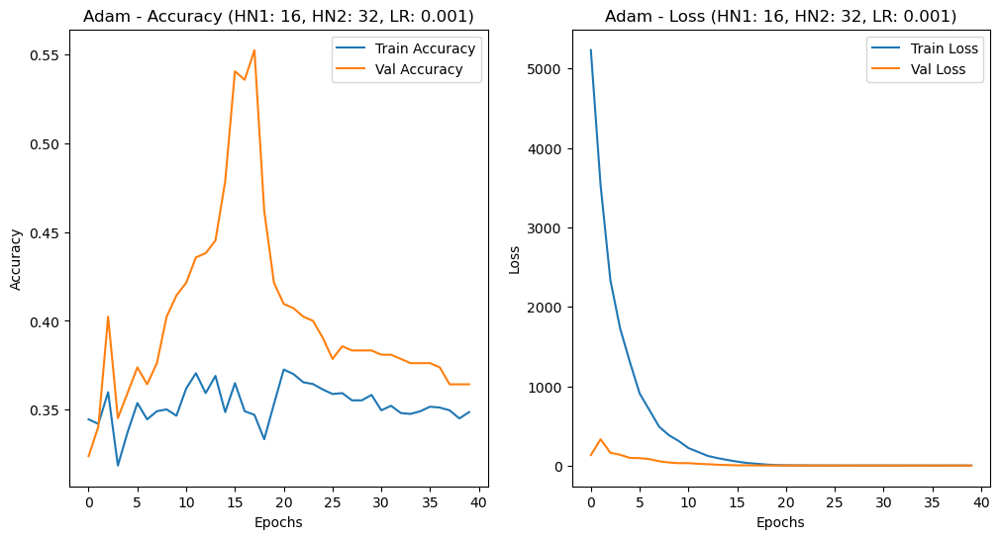

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3471 - loss: 9973.8223 - val_accuracy: 0.3381 - val_loss: 1042.6230
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 51ms/step - accuracy: 0.3428 - loss: 2043.7955 - val_accuracy: 0.3190 - val_loss: 245.0132
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 52ms/step - accuracy: 0.3324 - loss: 464.0524 - val_accuracy: 0.3524 - val_loss: 60.1616
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 57ms/step - accuracy: 0.3478 - loss: 129.5065 - val_accuracy: 0.3143 - val_loss: 10.0251
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 53ms/step - accuracy: 0.3115 - loss: 37.1915 - val_accuracy: 0.3833 - val_loss: 6.0493
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3687 - loss: 20.0778 - val_accuracy: 0.3833 - val_loss: 5.2982
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3592 - loss: 15.4560 - val_accuracy: 0.3905 - val_loss: 4.0730
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3639 - loss: 12.2886 - val

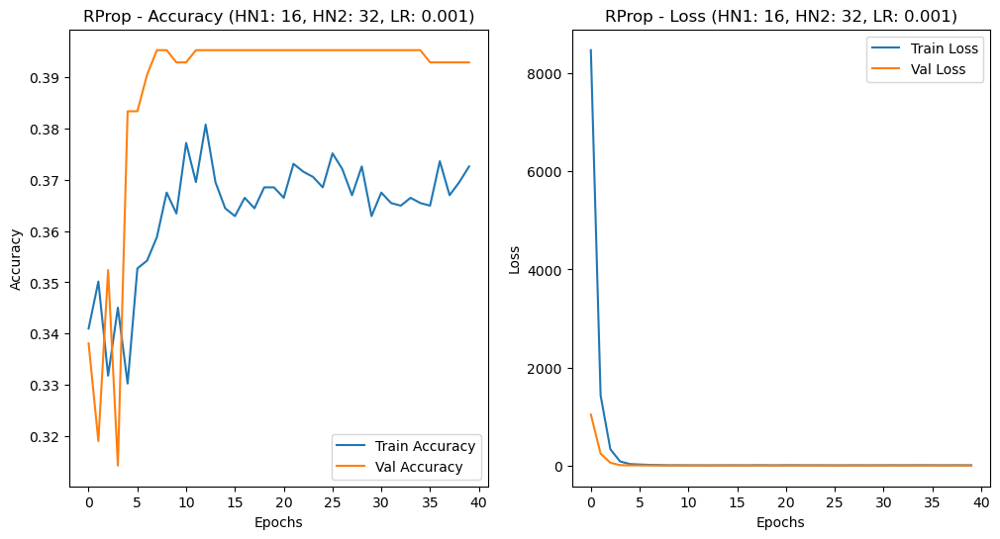

Adam Model - Test Loss: 1.0814, Test Accuracy: 0.3349
RProp Model - Test Loss: 2.4766, Test Accuracy: 0.4228
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
Hybrid Model - Test Accuracy: 0.4252

[INFO] Training models with HN1: 16, HN2: 32, LR: 0.01
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.3471 - loss: 3920.4268 - val_accuracy: 0.4190 - val_loss: 31.2233
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3600 - loss: 51.1181 - val_accuracy: 0.3286 - val_loss: 1.1157
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 68ms/step - accuracy: 0.3334 - loss: 1.2878 - val_accuracy: 0.3429 - val_loss: 1.1004
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3441 - loss: 1.1096 - val_accuracy: 0.3405 - val_loss: 1.0984
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3147 - loss: 1.0981 - val_accuracy: 0.3405 - val_loss: 1.0982
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - accuracy: 0.3481 - loss: 1.

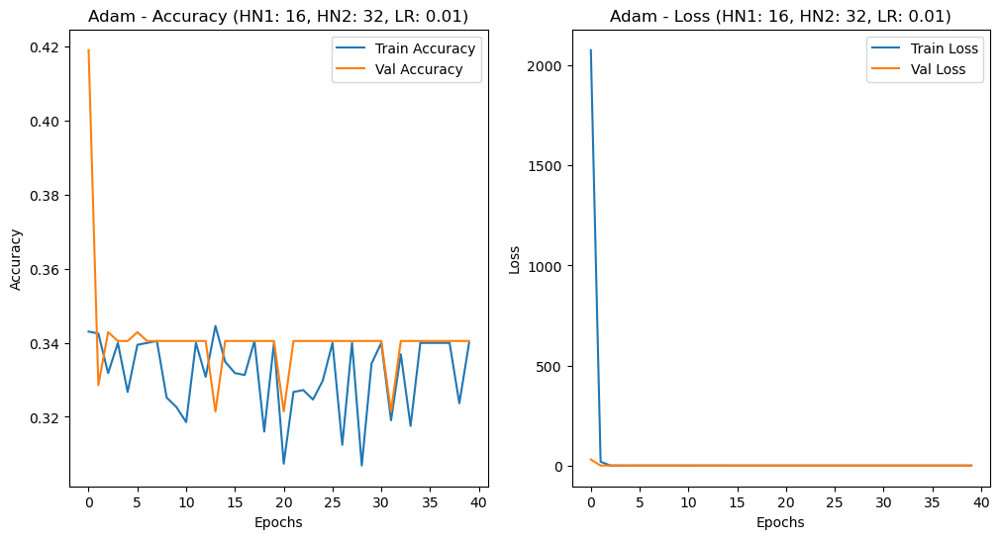

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 13s 417ms/step - accuracy: 0.3415 - loss: 3547.5168 - val_accuracy: 0.3714 - val_loss: 1.4852
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3355 - loss: 2.9168 - val_accuracy: 0.3619 - val_loss: 1.1690
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3390 - loss: 1.5186 - val_accuracy: 0.3619 - val_loss: 1.1624
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3328 - loss: 1.4362 - val_accuracy: 0.3619 - val_loss: 1.1311
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3389 - loss: 1.2498 - val_accuracy: 0.3571 - val_loss: 1.2119
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3331 - loss: 1.2628 - val_accuracy: 0.3548 - val_loss: 1.1831
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3263 - loss: 1.1451 - val_accuracy: 0.3548 - val_loss: 1.1829
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 50ms/step - accuracy: 0.3452 - loss: 1.2174 - val_accuracy: 0.354

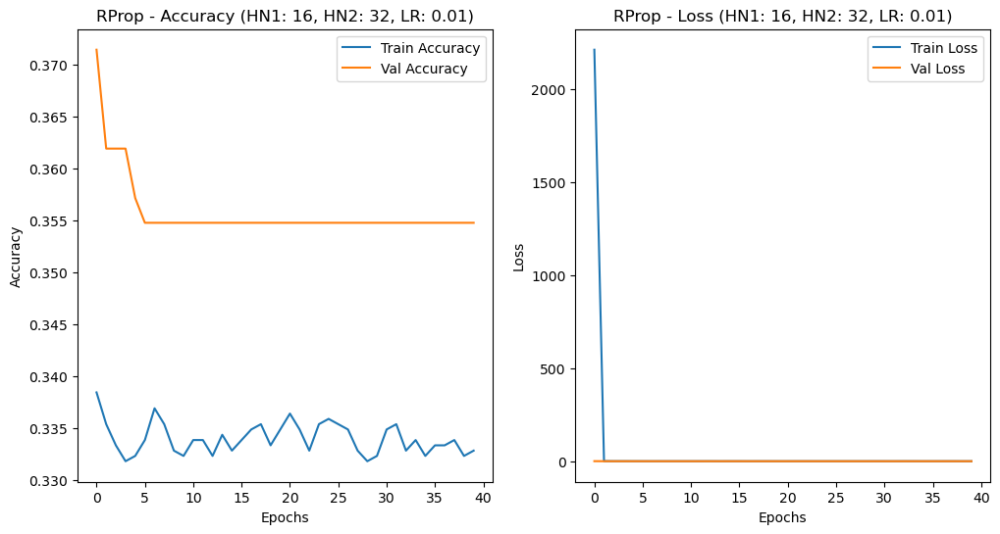

Adam Model - Test Loss: 1.1001, Test Accuracy: 0.3159
RProp Model - Test Loss: 1.1489, Test Accuracy: 0.3468
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
Hybrid Model - Test Accuracy: 0.3135

[INFO] Training models with HN1: 16, HN2: 32, LR: 0.1
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3343 - loss: 2541.7288 - val_accuracy: 0.3405 - val_loss: 1.0989
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3233 - loss: 1.1023 - val_accuracy: 0.3405 - val_loss: 1.0998
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3355 - loss: 1.1000 - val_accuracy: 0.3405 - val_loss: 1.0996
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3106 - loss: 1.1015 - val_accuracy: 0.3405 - val_loss: 1.0991
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3174 - loss: 1.1026 - val_accuracy: 0.3405 - val_loss: 1.0989
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - accuracy: 0.3093 - loss: 1.102

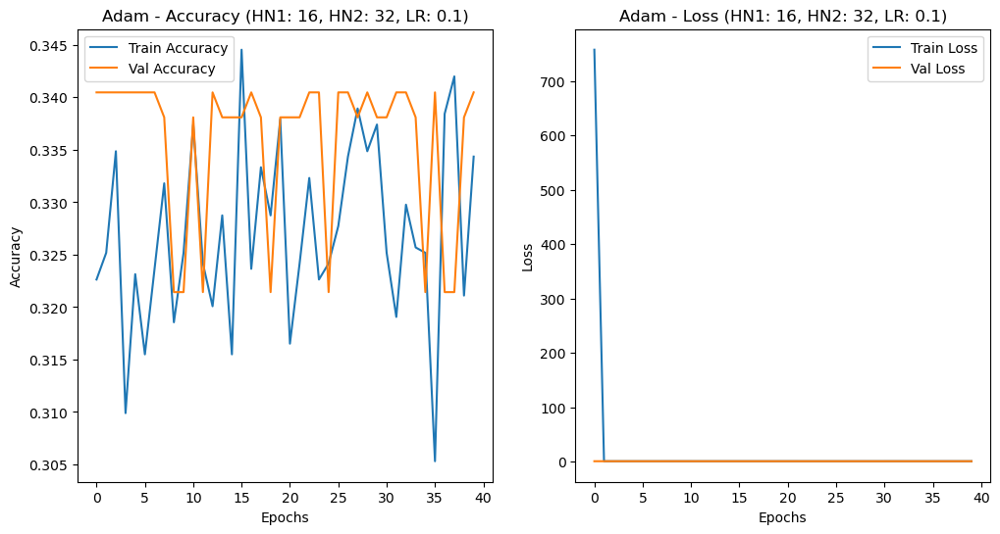

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3374 - loss: 4277.4062 - val_accuracy: 0.3905 - val_loss: 98.5063
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3718 - loss: 434.8880 - val_accuracy: 0.3333 - val_loss: 21.8906
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3604 - loss: 283.2426 - val_accuracy: 0.5024 - val_loss: 33.7349
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3596 - loss: 204.8604 - val_accuracy: 0.5405 - val_loss: 37.5880
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.4005 - loss: 173.6630 - val_accuracy: 0.5714 - val_loss: 33.8881
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3677 - loss: 186.3147 - val_accuracy: 0.5595 - val_loss: 31.2154
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3795 - loss: 160.2194 - val_accuracy: 0.5024 - val_loss: 24.5594
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3886 - loss: 145.3340 - 

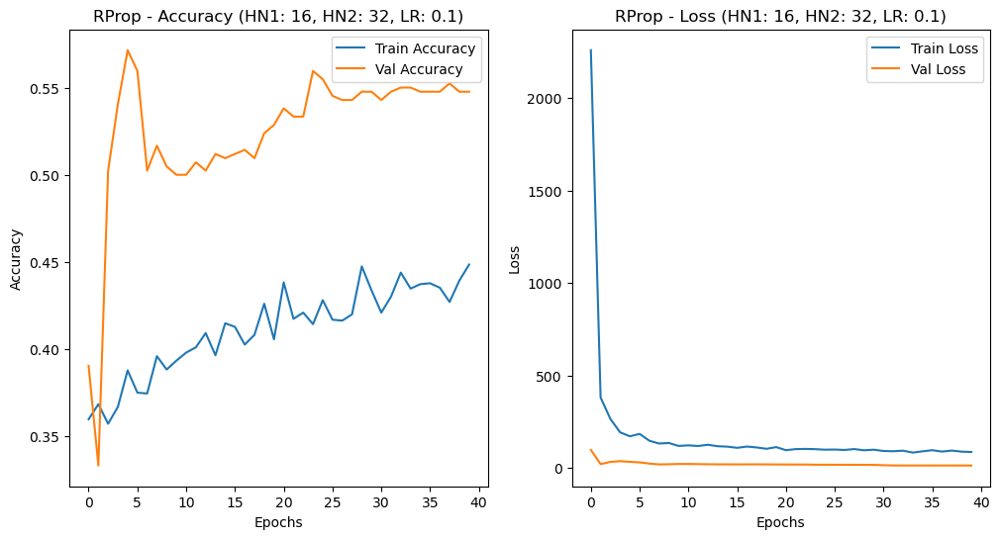

Adam Model - Test Loss: 1.1017, Test Accuracy: 0.3159
RProp Model - Test Loss: 14.8813, Test Accuracy: 0.5321
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
Hybrid Model - Test Accuracy: 0.5321

[INFO] Training models with HN1: 16, HN2: 64, LR: 0.0001
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 68ms/step - accuracy: 0.3413 - loss: 6631.6802 - val_accuracy: 0.3381 - val_loss: 1994.8865
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3143 - loss: 6048.7871 - val_accuracy: 0.3381 - val_loss: 1617.2996
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3238 - loss: 5494.5112 - val_accuracy: 0.3381 - val_loss: 1358.3162
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3413 - loss: 4987.2368 - val_accuracy: 0.3381 - val_loss: 1086.0779
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3369 - loss: 5086.0459 - val_accuracy: 0.3429 - val_loss: 804.8771
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - 

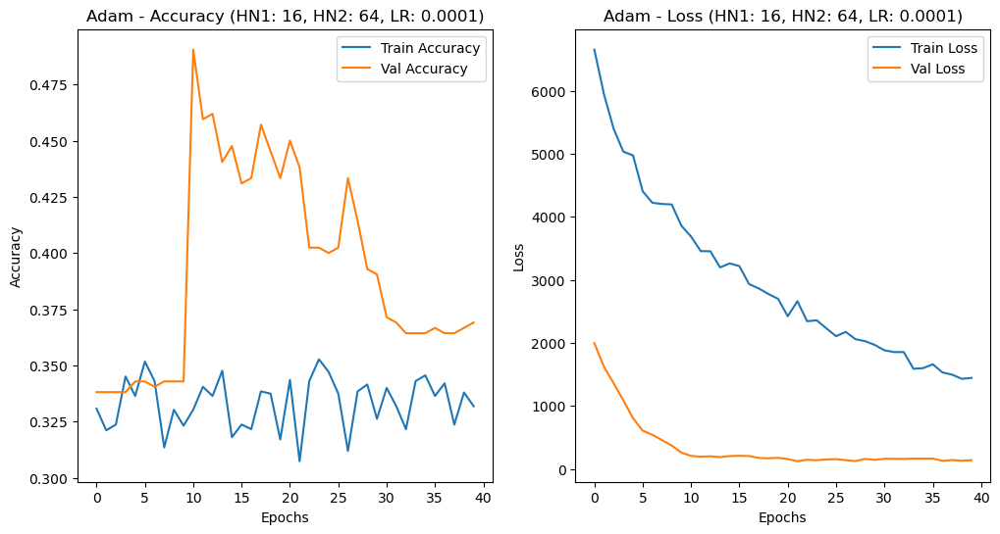

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3347 - loss: 7404.1768 - val_accuracy: 0.3405 - val_loss: 2595.3640
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 50ms/step - accuracy: 0.3297 - loss: 6172.4814 - val_accuracy: 0.2714 - val_loss: 153.6047
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 47ms/step - accuracy: 0.3421 - loss: 2323.0588 - val_accuracy: 0.4048 - val_loss: 165.1965
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3209 - loss: 1000.1668 - val_accuracy: 0.3381 - val_loss: 129.3326
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 54ms/step - accuracy: 0.3363 - loss: 453.2792 - val_accuracy: 0.4024 - val_loss: 58.4292
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 69ms/step - accuracy: 0.3079 - loss: 198.6997 - val_accuracy: 0.3333 - val_loss: 8.9694
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 52ms/step - accuracy: 0.2984 - loss: 90.5690 - val_accuracy: 0.3952 - val_loss: 6.6189
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 57ms/step - accuracy: 0.2760 - loss: 52.883

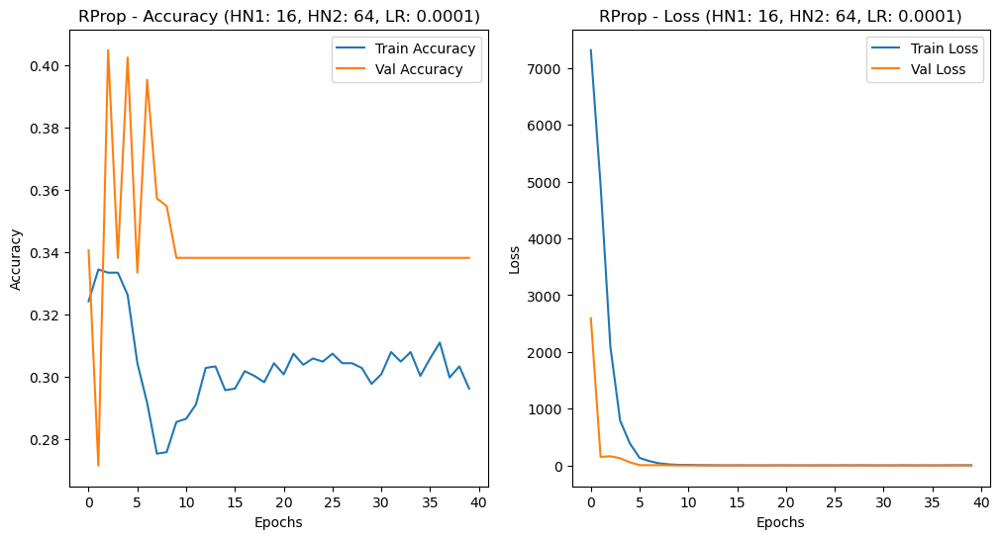

Adam Model - Test Loss: 132.1596, Test Accuracy: 0.3563
RProp Model - Test Loss: 1.9502, Test Accuracy: 0.3444
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
Hybrid Model - Test Accuracy: 0.3943

[INFO] Training models with HN1: 16, HN2: 64, LR: 0.001
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 69ms/step - accuracy: 0.3423 - loss: 7121.9023 - val_accuracy: 0.3214 - val_loss: 333.9887
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3265 - loss: 5233.3193 - val_accuracy: 0.3405 - val_loss: 196.3805
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3209 - loss: 3606.4741 - val_accuracy: 0.4333 - val_loss: 51.5203
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3334 - loss: 2726.4744 - val_accuracy: 0.3405 - val_loss: 196.1414
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3081 - loss: 2184.2908 - val_accuracy: 0.3238 - val_loss: 123.3834
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accur

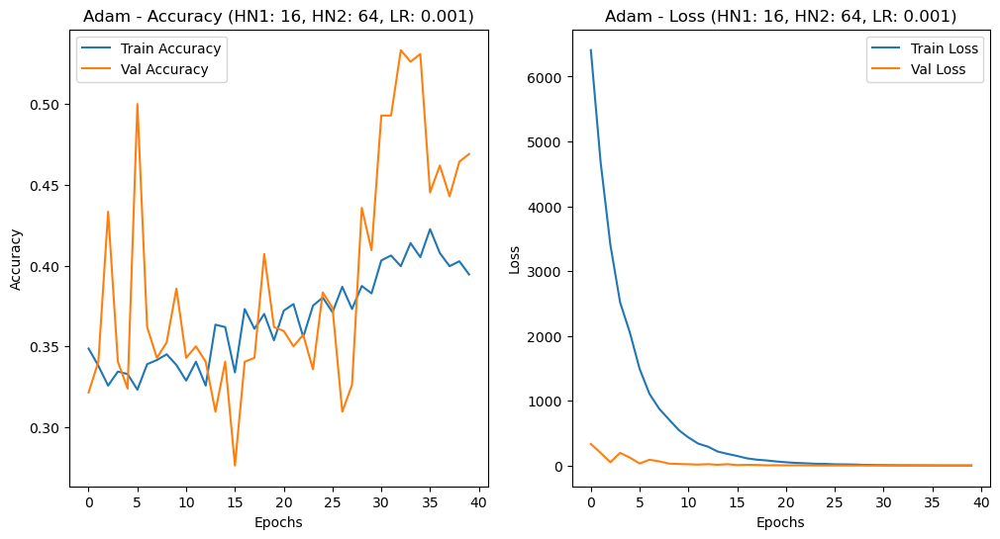

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3354 - loss: 4476.2192 - val_accuracy: 0.3405 - val_loss: 465.9946
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 48ms/step - accuracy: 0.3410 - loss: 1487.2147 - val_accuracy: 0.3381 - val_loss: 122.4922
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3337 - loss: 398.4755 - val_accuracy: 0.3214 - val_loss: 25.2349
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3238 - loss: 46.5557 - val_accuracy: 0.3381 - val_loss: 1.1081
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3581 - loss: 1.1600 - val_accuracy: 0.3381 - val_loss: 1.1080
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3568 - loss: 1.1323 - val_accuracy: 0.3381 - val_loss: 1.1080
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3487 - loss: 1.1804 - val_accuracy: 0.3381 - val_loss: 1.1078
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3330 - loss: 1.2983 - val_accura

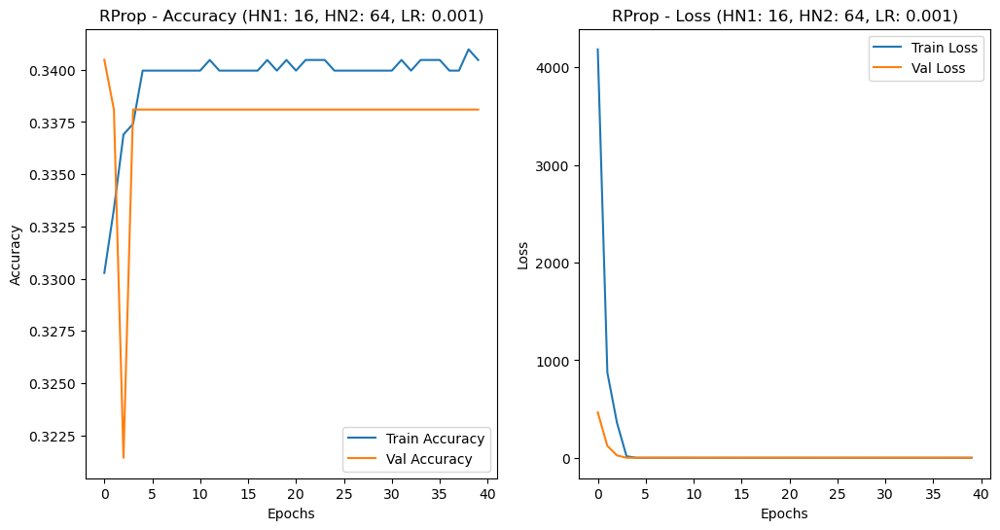

Adam Model - Test Loss: 1.0613, Test Accuracy: 0.4252
RProp Model - Test Loss: 1.0988, Test Accuracy: 0.3159
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
Hybrid Model - Test Accuracy: 0.4204

[INFO] Training models with HN1: 16, HN2: 64, LR: 0.01
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 69ms/step - accuracy: 0.3543 - loss: 3124.7002 - val_accuracy: 0.3929 - val_loss: 34.4039
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3667 - loss: 73.3854 - val_accuracy: 0.3238 - val_loss: 1.2491
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3211 - loss: 1.1037 - val_accuracy: 0.3333 - val_loss: 1.1591
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 68ms/step - accuracy: 0.3481 - loss: 1.0991 - val_accuracy: 0.3333 - val_loss: 1.1433
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - accuracy: 0.3221 - loss: 1.0994 - val_accuracy: 0.3333 - val_loss: 1.1426
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3493 - loss: 1.

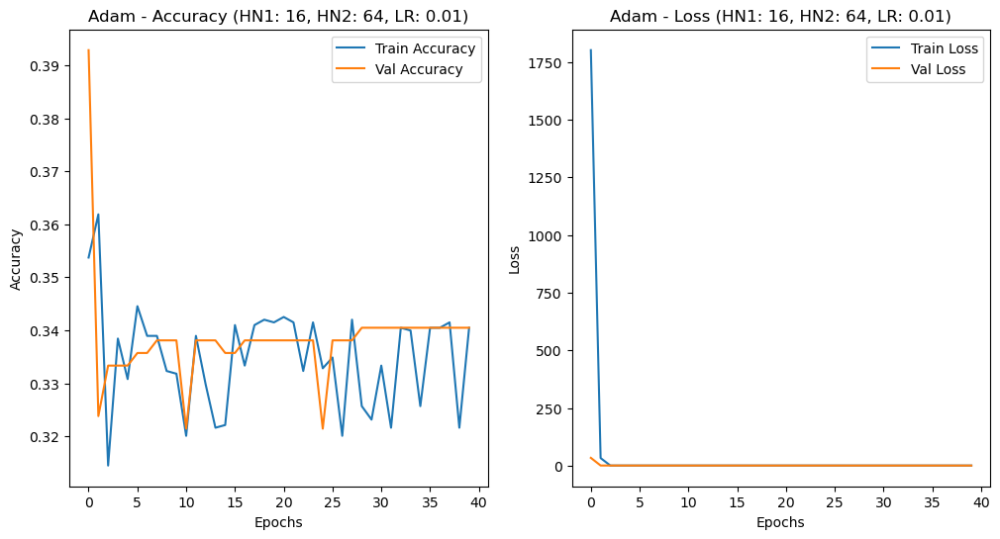

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3113 - loss: 6558.7021 - val_accuracy: 0.3405 - val_loss: 243.4634
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3741 - loss: 253.4639 - val_accuracy: 0.3643 - val_loss: 2.2499
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3505 - loss: 2.2755 - val_accuracy: 0.3524 - val_loss: 1.6518
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3546 - loss: 3.0472 - val_accuracy: 0.3667 - val_loss: 1.4436
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3470 - loss: 1.7106 - val_accuracy: 0.3667 - val_loss: 1.4748
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3587 - loss: 1.6557 - val_accuracy: 0.4000 - val_loss: 1.4524
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3457 - loss: 2.1695 - val_accuracy: 0.4048 - val_loss: 1.4650
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 50ms/step - accuracy: 0.3786 - loss: 1.9857 - val_accuracy: 0.4

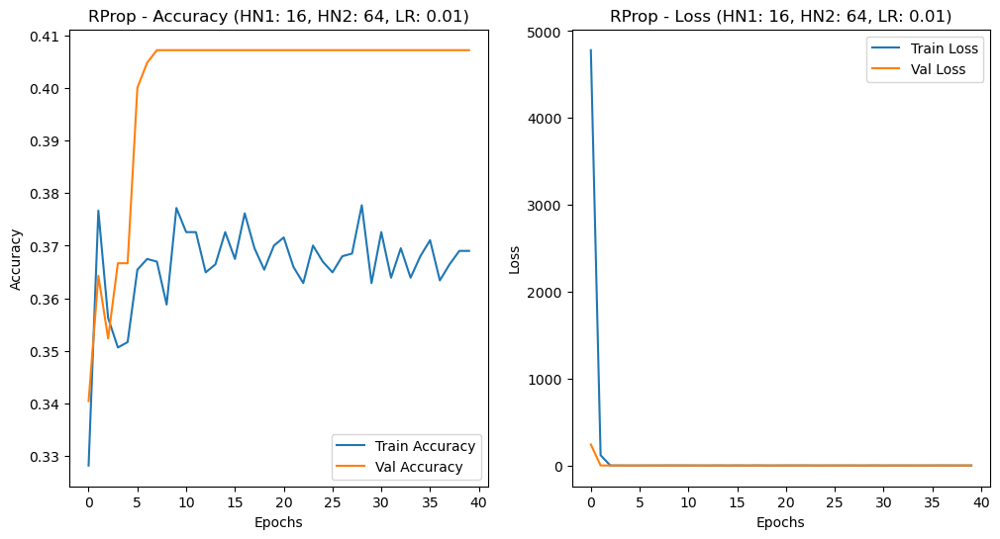

Adam Model - Test Loss: 1.0998, Test Accuracy: 0.3159
RProp Model - Test Loss: 1.2623, Test Accuracy: 0.3634
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
Hybrid Model - Test Accuracy: 0.3634

[INFO] Training models with HN1: 16, HN2: 64, LR: 0.1
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - accuracy: 0.3542 - loss: 2679.6794 - val_accuracy: 0.3381 - val_loss: 1.0988
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3131 - loss: 1.1031 - val_accuracy: 0.3405 - val_loss: 1.1017
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 72ms/step - accuracy: 0.3215 - loss: 1.0995 - val_accuracy: 0.3381 - val_loss: 1.1024
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 71ms/step - accuracy: 0.3248 - loss: 1.1027 - val_accuracy: 0.3381 - val_loss: 1.1017
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3357 - loss: 1.1022 - val_accuracy: 0.3381 - val_loss: 1.1007
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3226 - loss: 1.103

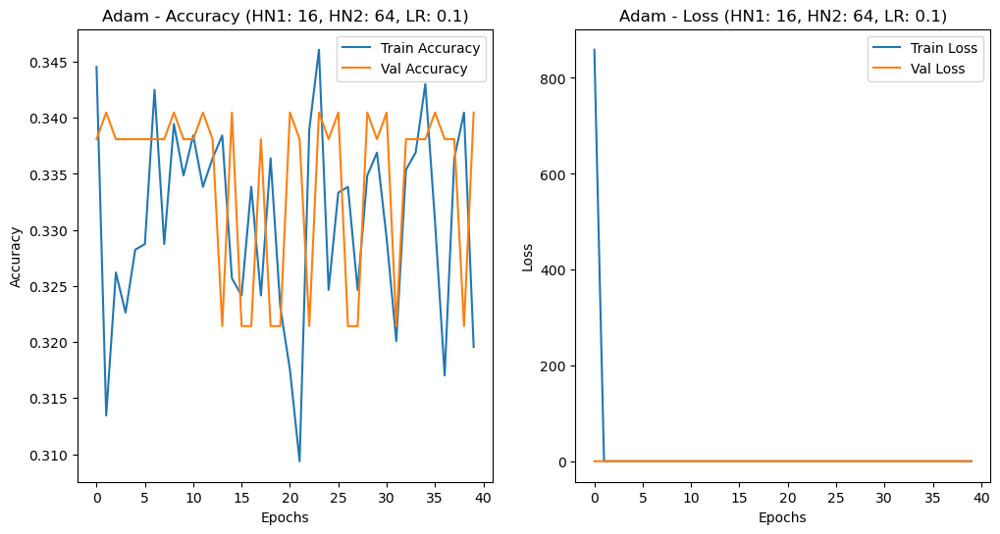

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3281 - loss: 4159.5117 - val_accuracy: 0.3762 - val_loss: 101.5550
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 51ms/step - accuracy: 0.4092 - loss: 257.1442 - val_accuracy: 0.5000 - val_loss: 22.8671
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 49ms/step - accuracy: 0.4558 - loss: 53.1547 - val_accuracy: 0.4500 - val_loss: 8.0632
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.4208 - loss: 15.4099 - val_accuracy: 0.4667 - val_loss: 6.6653
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.4133 - loss: 9.9073 - val_accuracy: 0.4357 - val_loss: 1.3733
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3785 - loss: 2.9768 - val_accuracy: 0.4190 - val_loss: 1.3011
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3790 - loss: 2.3791 - val_accuracy: 0.4167 - val_loss: 1.3342
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3624 - loss: 2.3787 - val_accuracy: 

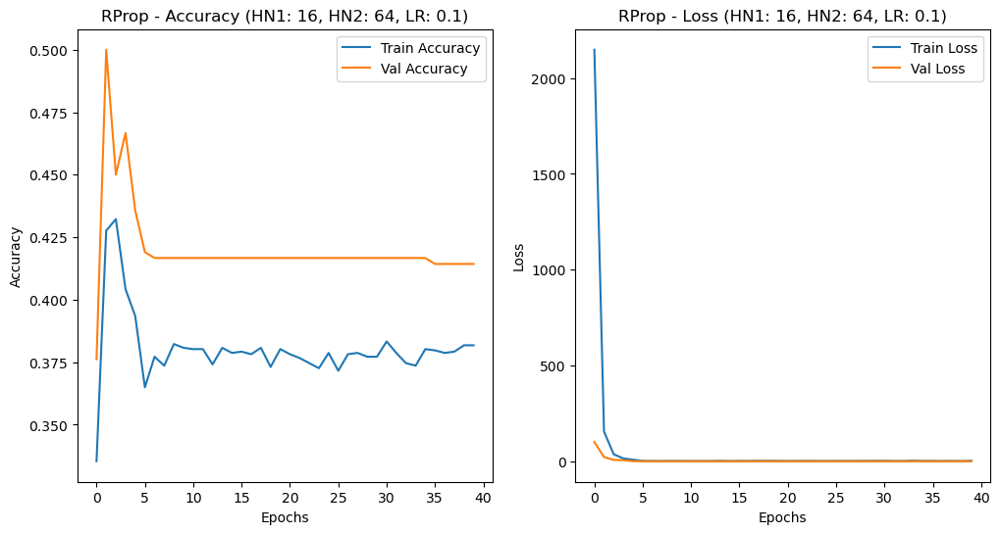

Adam Model - Test Loss: 1.0996, Test Accuracy: 0.3159
RProp Model - Test Loss: 1.1489, Test Accuracy: 0.4157
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
Hybrid Model - Test Accuracy: 0.4157

[INFO] Training models with HN1: 16, HN2: 128, LR: 0.0001
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 71ms/step - accuracy: 0.3365 - loss: 5004.9731 - val_accuracy: 0.3214 - val_loss: 787.8336
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 69ms/step - accuracy: 0.3182 - loss: 5028.5581 - val_accuracy: 0.3357 - val_loss: 770.5571
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - accuracy: 0.3481 - loss: 4228.2534 - val_accuracy: 0.3381 - val_loss: 708.3260
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 68ms/step - accuracy: 0.3379 - loss: 4753.3691 - val_accuracy: 0.3381 - val_loss: 712.6786
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3352 - loss: 4371.5615 - val_accuracy: 0.3381 - val_loss: 658.2045
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 72ms/step - accu

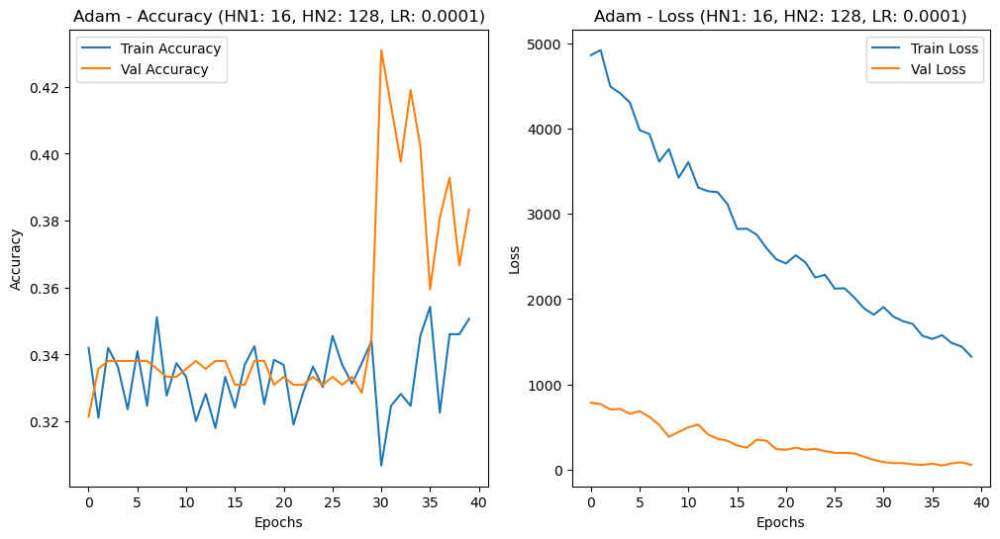

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 52ms/step - accuracy: 0.3450 - loss: 6456.6602 - val_accuracy: 0.3405 - val_loss: 2275.8792
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3346 - loss: 4544.3105 - val_accuracy: 0.4048 - val_loss: 475.4294
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3186 - loss: 2931.5090 - val_accuracy: 0.3952 - val_loss: 353.7740
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3540 - loss: 1550.1205 - val_accuracy: 0.3738 - val_loss: 173.9162
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3244 - loss: 741.2120 - val_accuracy: 0.4310 - val_loss: 90.0005
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3672 - loss: 496.4275 - val_accuracy: 0.3738 - val_loss: 47.0750
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3450 - loss: 323.9327 - val_accuracy: 0.3429 - val_loss: 70.6911
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3807 - loss: 282

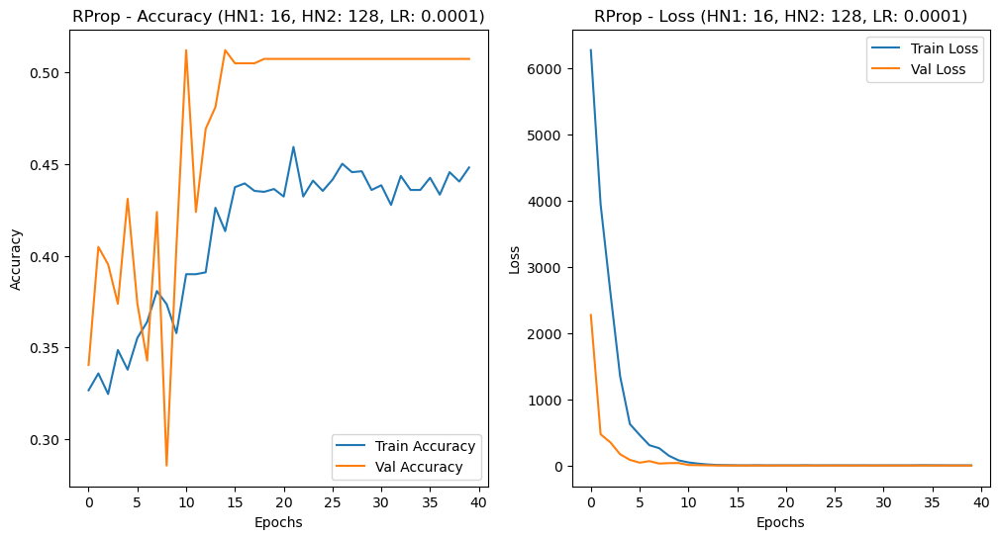

Adam Model - Test Loss: 66.4627, Test Accuracy: 0.3587
RProp Model - Test Loss: 3.8867, Test Accuracy: 0.5036
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
Hybrid Model - Test Accuracy: 0.3990

[INFO] Training models with HN1: 16, HN2: 128, LR: 0.001
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 75ms/step - accuracy: 0.3198 - loss: 2938.7585 - val_accuracy: 0.3310 - val_loss: 229.1820
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 78ms/step - accuracy: 0.3434 - loss: 1720.1396 - val_accuracy: 0.2857 - val_loss: 122.8020
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3227 - loss: 1318.0994 - val_accuracy: 0.3405 - val_loss: 102.4231
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - accuracy: 0.3271 - loss: 880.3619 - val_accuracy: 0.3976 - val_loss: 86.9667
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - accuracy: 0.3529 - loss: 571.8921 - val_accuracy: 0.4024 - val_loss: 54.0094
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy

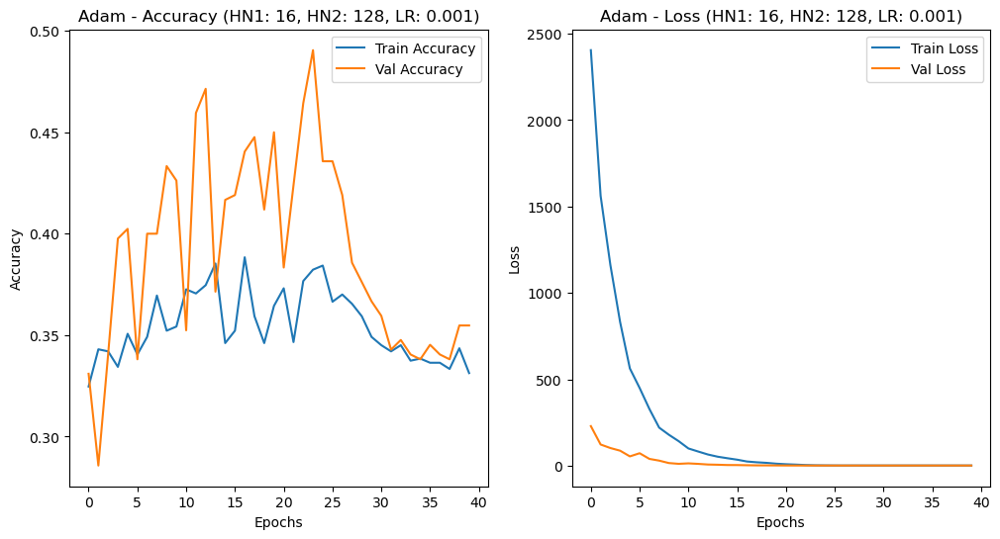

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 48ms/step - accuracy: 0.3177 - loss: 3795.6533 - val_accuracy: 0.3262 - val_loss: 269.0262
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 48ms/step - accuracy: 0.3375 - loss: 1034.1304 - val_accuracy: 0.3452 - val_loss: 145.3442
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 48ms/step - accuracy: 0.3264 - loss: 482.2884 - val_accuracy: 0.3190 - val_loss: 35.5079
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3751 - loss: 29.5081 - val_accuracy: 0.3548 - val_loss: 1.1571
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3282 - loss: 1.6359 - val_accuracy: 0.3357 - val_loss: 1.1768
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3271 - loss: 1.5080 - val_accuracy: 0.3357 - val_loss: 1.1487
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3273 - loss: 1.2299 - val_accuracy: 0.3238 - val_loss: 1.1643
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3333 - loss: 1.2663 - val_accura

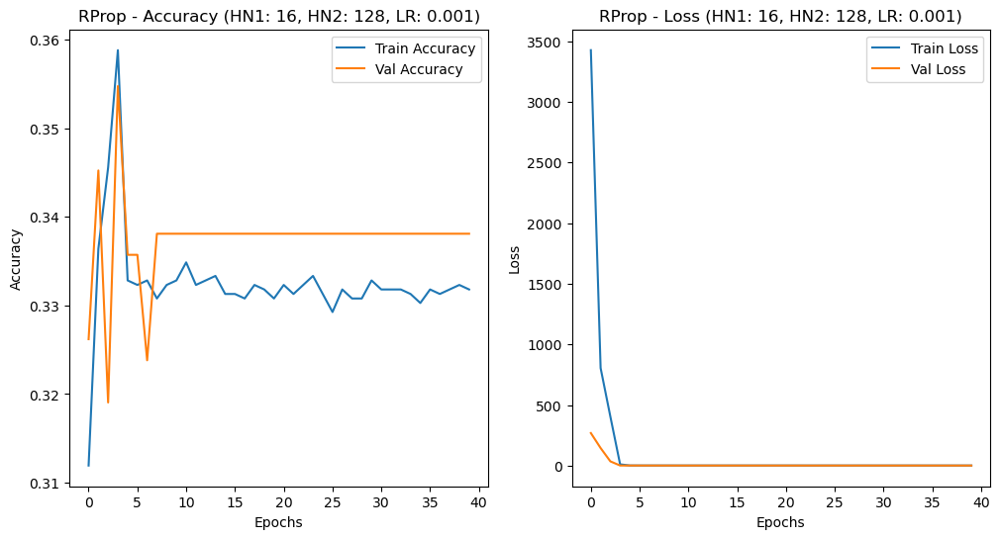

Adam Model - Test Loss: 1.0921, Test Accuracy: 0.3230
RProp Model - Test Loss: 1.0943, Test Accuracy: 0.3444
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
Hybrid Model - Test Accuracy: 0.3515

[INFO] Training models with HN1: 16, HN2: 128, LR: 0.01
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 77ms/step - accuracy: 0.3244 - loss: 2551.1084 - val_accuracy: 0.3690 - val_loss: 25.3575
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3783 - loss: 64.2595 - val_accuracy: 0.4429 - val_loss: 1.1600
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3485 - loss: 1.2604 - val_accuracy: 0.3405 - val_loss: 1.1071
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3279 - loss: 1.1191 - val_accuracy: 0.3405 - val_loss: 1.1050
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3473 - loss: 1.1487 - val_accuracy: 0.3429 - val_loss: 1.1000
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3243 - loss: 1

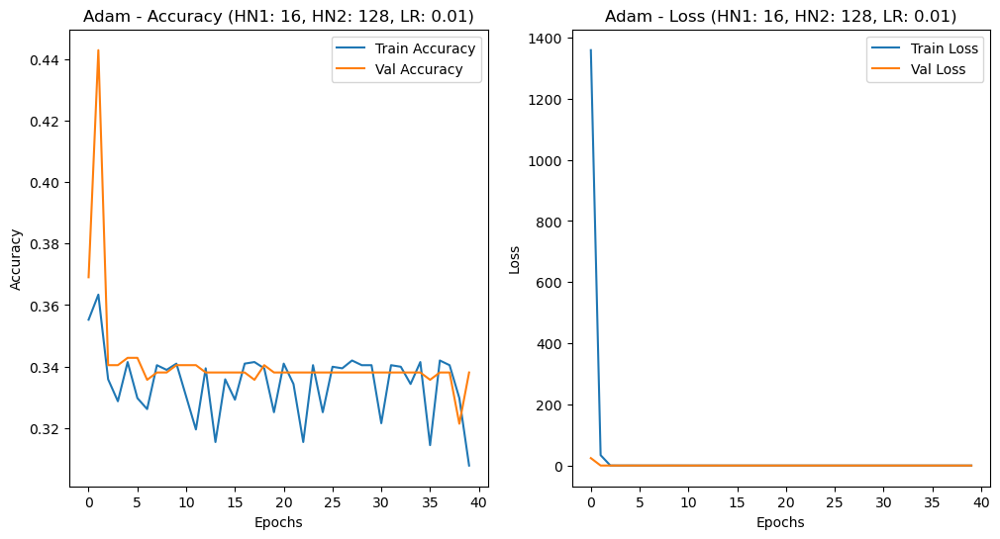

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 51ms/step - accuracy: 0.3196 - loss: 6101.0840 - val_accuracy: 0.3333 - val_loss: 319.8680
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 49ms/step - accuracy: 0.3551 - loss: 1451.1262 - val_accuracy: 0.3381 - val_loss: 106.9968
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3687 - loss: 306.8086 - val_accuracy: 0.5000 - val_loss: 40.9739
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3830 - loss: 203.5800 - val_accuracy: 0.5643 - val_loss: 36.0906
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 50ms/step - accuracy: 0.3390 - loss: 145.2155 - val_accuracy: 0.6143 - val_loss: 24.0141
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3802 - loss: 99.4434 - val_accuracy: 0.3810 - val_loss: 15.1960
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3211 - loss: 85.4125 - val_accuracy: 0.3952 - val_loss: 13.8923
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3525 - loss: 65.9870 - 

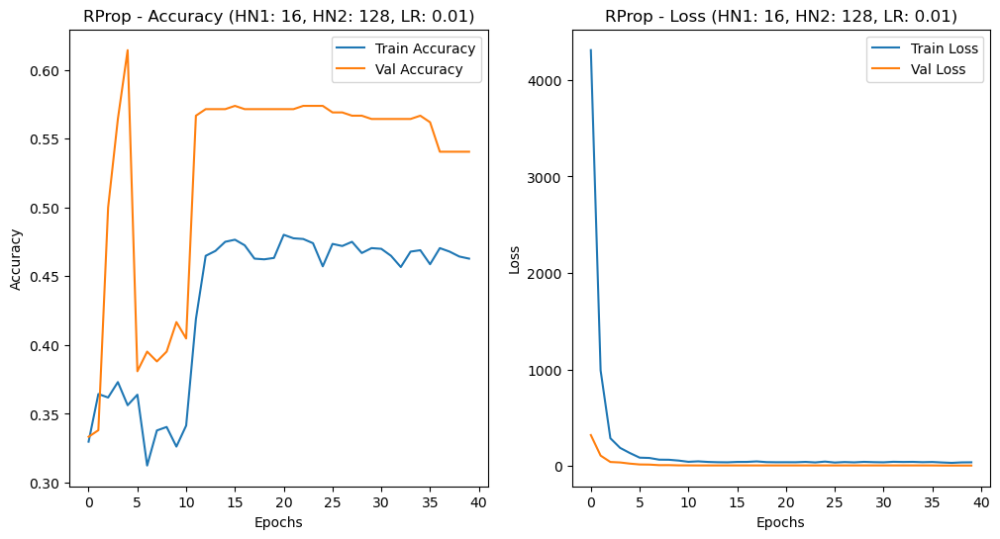

Adam Model - Test Loss: 1.0993, Test Accuracy: 0.3159
RProp Model - Test Loss: 4.7612, Test Accuracy: 0.5368
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
Hybrid Model - Test Accuracy: 0.5368

[INFO] Training models with HN1: 16, HN2: 128, LR: 0.1
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3291 - loss: 2495.3267 - val_accuracy: 0.3381 - val_loss: 1.0985
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3298 - loss: 1.1026 - val_accuracy: 0.3381 - val_loss: 1.0985
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3280 - loss: 1.0996 - val_accuracy: 0.3405 - val_loss: 1.0994
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3469 - loss: 1.1011 - val_accuracy: 0.3381 - val_loss: 1.0988
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - accuracy: 0.3298 - loss: 1.1021 - val_accuracy: 0.3214 - val_loss: 1.1025
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - accuracy: 0.3480 - loss: 1.10

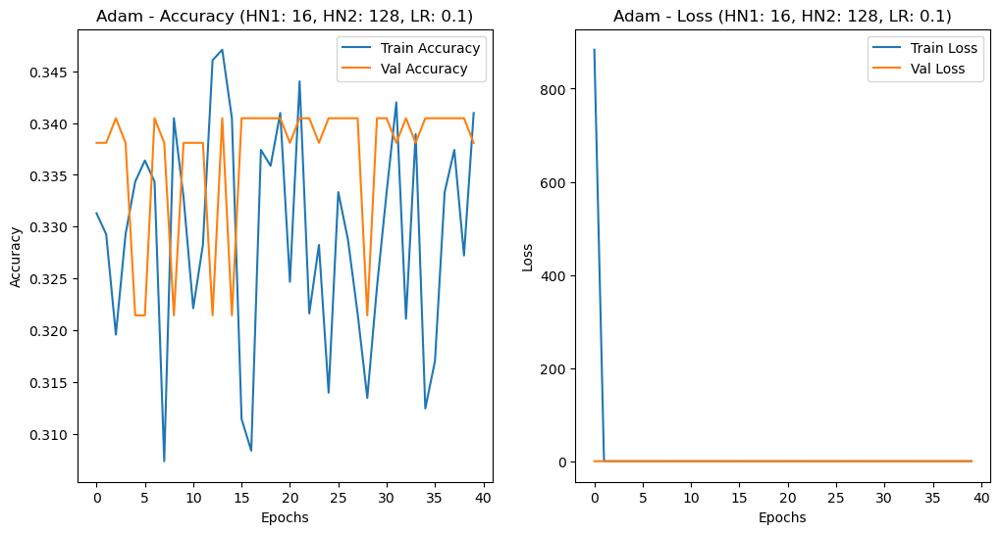

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 69ms/step - accuracy: 0.3193 - loss: 3749.5620 - val_accuracy: 0.4905 - val_loss: 17.7159
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3778 - loss: 90.2808 - val_accuracy: 0.3905 - val_loss: 1.5354
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3433 - loss: 3.9004 - val_accuracy: 0.3643 - val_loss: 1.3961
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3446 - loss: 2.7494 - val_accuracy: 0.3667 - val_loss: 1.3101
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 50ms/step - accuracy: 0.3528 - loss: 2.6806 - val_accuracy: 0.3643 - val_loss: 1.2435
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3379 - loss: 1.6473 - val_accuracy: 0.3690 - val_loss: 1.2280
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 50ms/step - accuracy: 0.3657 - loss: 2.5023 - val_accuracy: 0.3714 - val_loss: 1.2166
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 53ms/step - accuracy: 0.3714 - loss: 2.5728 - val_accuracy: 0.371

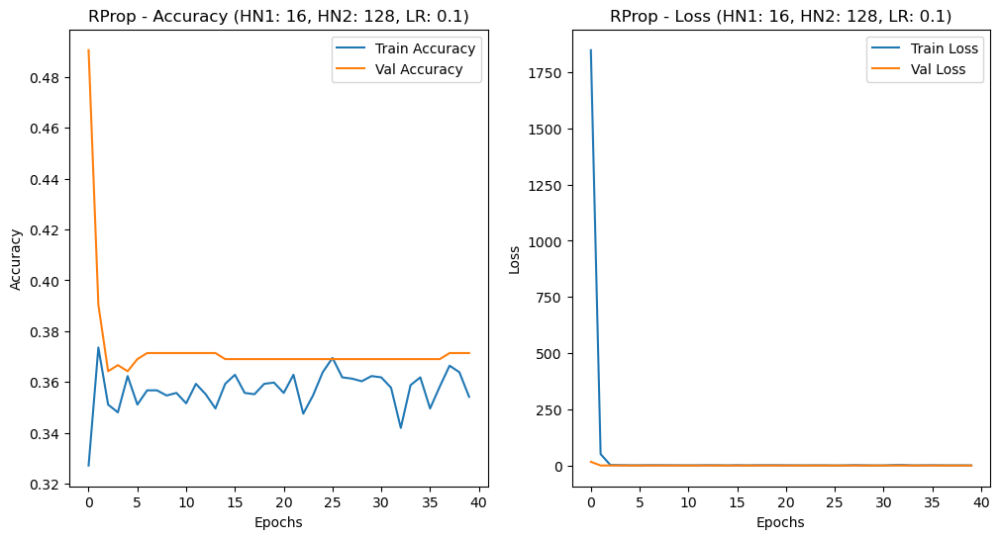

Adam Model - Test Loss: 1.0999, Test Accuracy: 0.3444
RProp Model - Test Loss: 1.1948, Test Accuracy: 0.3800
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
Hybrid Model - Test Accuracy: 0.3444

[INFO] Training models with HN1: 32, HN2: 16, LR: 0.0001
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 69ms/step - accuracy: 0.3358 - loss: 13781.6250 - val_accuracy: 0.3405 - val_loss: 10202.7285
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 69ms/step - accuracy: 0.3493 - loss: 13643.4707 - val_accuracy: 0.3405 - val_loss: 8960.9082
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3162 - loss: 12756.0127 - val_accuracy: 0.3405 - val_loss: 7861.4243
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3506 - loss: 11371.7686 - val_accuracy: 0.3405 - val_loss: 6948.3481
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3407 - loss: 10561.2441 - val_accuracy: 0.3405 - val_loss: 6058.5352
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 68ms/s

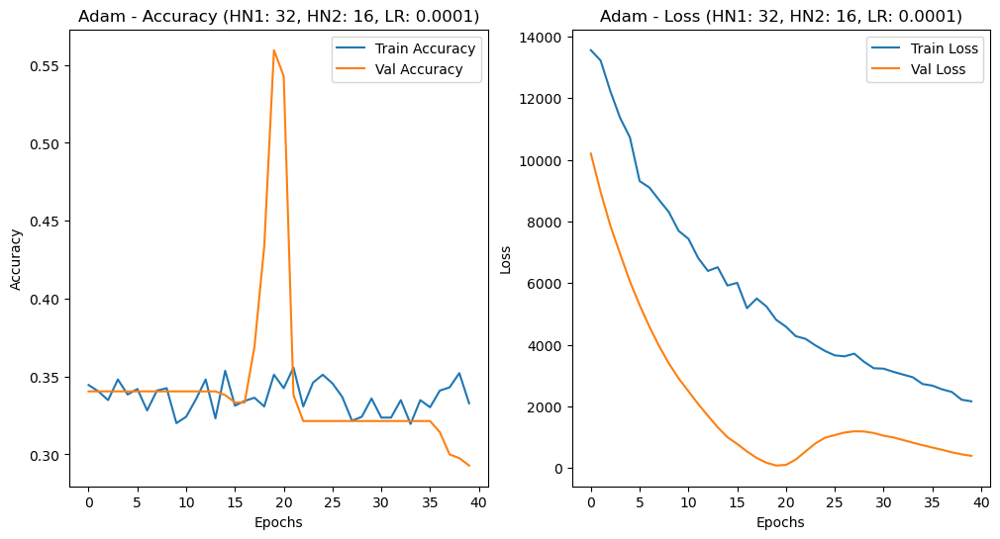

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3309 - loss: 13976.3838 - val_accuracy: 0.3214 - val_loss: 7915.6226
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3490 - loss: 5142.7310 - val_accuracy: 0.4000 - val_loss: 1.8747
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 58ms/step - accuracy: 0.3295 - loss: 822.4156 - val_accuracy: 0.3405 - val_loss: 1.1014
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 53ms/step - accuracy: 0.3180 - loss: 516.3932 - val_accuracy: 0.3405 - val_loss: 1.1014
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 52ms/step - accuracy: 0.3240 - loss: 436.7957 - val_accuracy: 0.3405 - val_loss: 1.1039
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 51ms/step - accuracy: 0.3271 - loss: 311.9818 - val_accuracy: 0.3405 - val_loss: 1.5895
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 51ms/step - accuracy: 0.3135 - loss: 292.7599 - val_accuracy: 0.3381 - val_loss: 1.3720
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 52ms/step - accuracy: 0.3439 - loss: 223.8206 - va

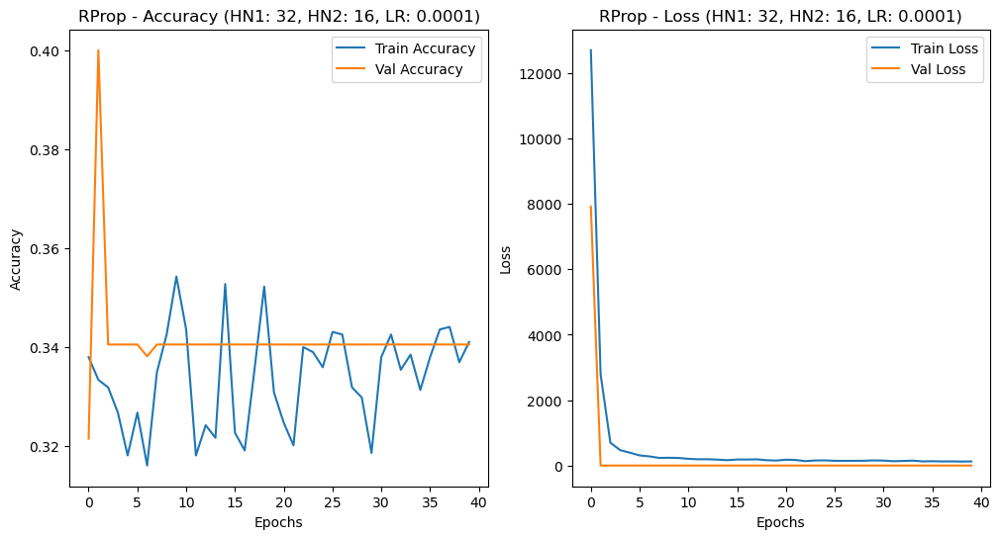

Adam Model - Test Loss: 376.4308, Test Accuracy: 0.3135
RProp Model - Test Loss: 1.1065, Test Accuracy: 0.3159
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
Hybrid Model - Test Accuracy: 0.3135

[INFO] Training models with HN1: 32, HN2: 16, LR: 0.001
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3337 - loss: 6175.7627 - val_accuracy: 0.3405 - val_loss: 1947.3933
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - accuracy: 0.3449 - loss: 3939.6682 - val_accuracy: 0.3405 - val_loss: 512.0948
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 72ms/step - accuracy: 0.3455 - loss: 2273.4556 - val_accuracy: 0.3238 - val_loss: 32.3770
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 69ms/step - accuracy: 0.3096 - loss: 1443.1213 - val_accuracy: 0.3405 - val_loss: 1.0999
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - accuracy: 0.3177 - loss: 701.2955 - val_accuracy: 0.3381 - val_loss: 1.1049
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy:

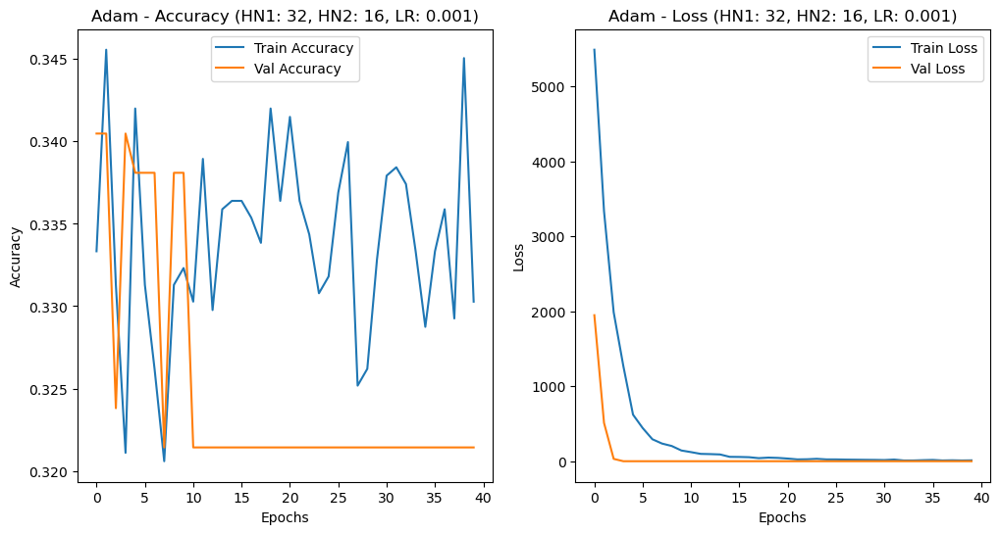

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 48ms/step - accuracy: 0.3465 - loss: 6768.0220 - val_accuracy: 0.3238 - val_loss: 206.8877
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 49ms/step - accuracy: 0.3484 - loss: 3404.4749 - val_accuracy: 0.3214 - val_loss: 612.2143
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 48ms/step - accuracy: 0.3276 - loss: 3309.0305 - val_accuracy: 0.4143 - val_loss: 530.7403
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3373 - loss: 1715.4907 - val_accuracy: 0.3619 - val_loss: 258.2321
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3369 - loss: 1215.7260 - val_accuracy: 0.5214 - val_loss: 152.6723
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3385 - loss: 923.0300 - val_accuracy: 0.5238 - val_loss: 117.7906
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 50ms/step - accuracy: 0.3837 - loss: 722.1129 - val_accuracy: 0.3881 - val_loss: 68.8414
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 51ms/step - accuracy: 0.3521 - loss: 6

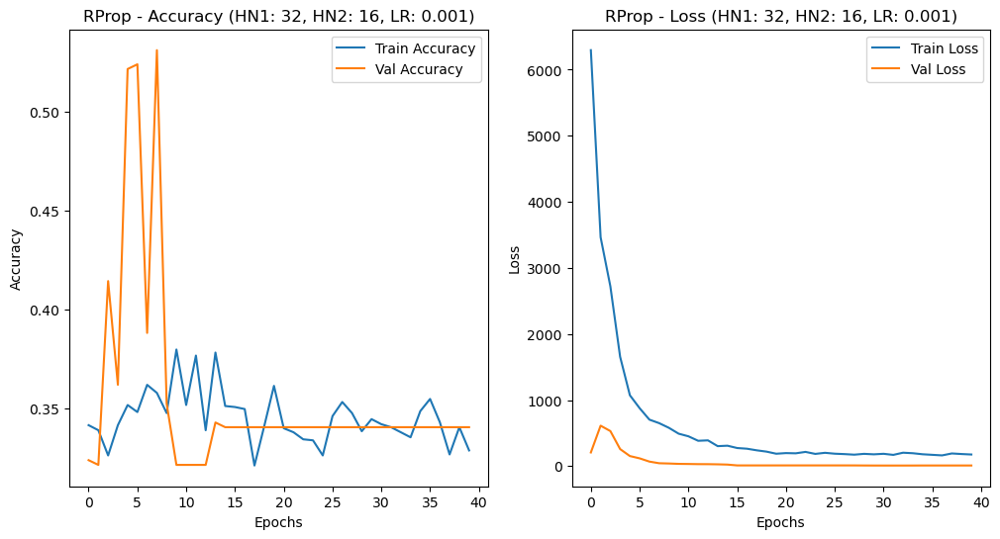

Adam Model - Test Loss: 1.0985, Test Accuracy: 0.3397
RProp Model - Test Loss: 10.4063, Test Accuracy: 0.3159
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
Hybrid Model - Test Accuracy: 0.3159

[INFO] Training models with HN1: 32, HN2: 16, LR: 0.01
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 71ms/step - accuracy: 0.3506 - loss: 2059.6189 - val_accuracy: 0.3405 - val_loss: 1.1002
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 71ms/step - accuracy: 0.3116 - loss: 36.6044 - val_accuracy: 0.3405 - val_loss: 1.1156
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 76ms/step - accuracy: 0.3396 - loss: 10.9128 - val_accuracy: 0.3405 - val_loss: 1.1079
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 70ms/step - accuracy: 0.3348 - loss: 5.1298 - val_accuracy: 0.3214 - val_loss: 1.1072
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3629 - loss: 2.9770 - val_accuracy: 0.3405 - val_loss: 1.1089
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - accuracy: 0.3092 - loss: 1

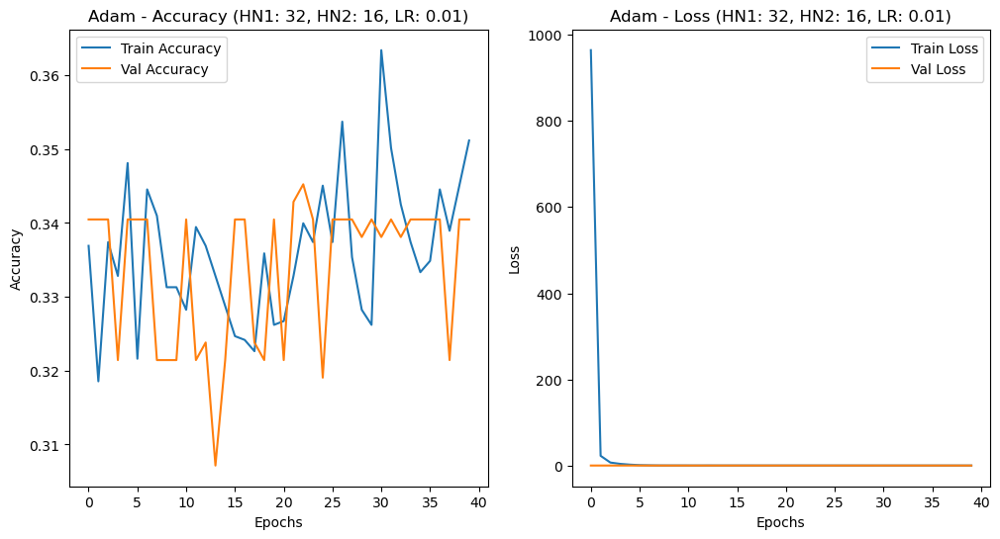

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 68ms/step - accuracy: 0.3341 - loss: 6920.4712 - val_accuracy: 0.3405 - val_loss: 281.0209
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3400 - loss: 1041.1776 - val_accuracy: 0.4500 - val_loss: 9.1142
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3401 - loss: 636.3561 - val_accuracy: 0.3119 - val_loss: 1.1130
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3315 - loss: 434.6922 - val_accuracy: 0.3405 - val_loss: 1.1069
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 51ms/step - accuracy: 0.3517 - loss: 311.8468 - val_accuracy: 0.3405 - val_loss: 1.1077
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3488 - loss: 258.6186 - val_accuracy: 0.3405 - val_loss: 1.1077
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 48ms/step - accuracy: 0.3400 - loss: 173.5711 - val_accuracy: 0.3405 - val_loss: 1.1077
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3334 - loss: 191.8333 - val_

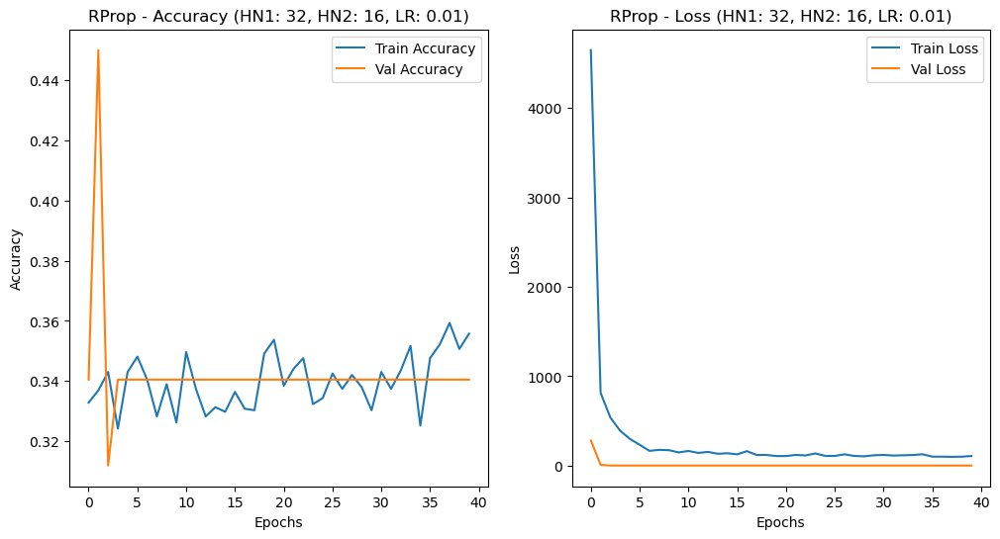

Adam Model - Test Loss: 1.0996, Test Accuracy: 0.3159
RProp Model - Test Loss: 1.1154, Test Accuracy: 0.3159
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
Hybrid Model - Test Accuracy: 0.3159

[INFO] Training models with HN1: 32, HN2: 16, LR: 0.1
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 70ms/step - accuracy: 0.3368 - loss: 1076.3563 - val_accuracy: 0.3214 - val_loss: 1.1074
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - accuracy: 0.3332 - loss: 1.1048 - val_accuracy: 0.3405 - val_loss: 1.0985
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3353 - loss: 1.1004 - val_accuracy: 0.3405 - val_loss: 1.1001
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 68ms/step - accuracy: 0.3210 - loss: 1.1009 - val_accuracy: 0.3405 - val_loss: 1.0991
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - accuracy: 0.3504 - loss: 1.1007 - val_accuracy: 0.3405 - val_loss: 1.0992
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3305 - loss: 1.102

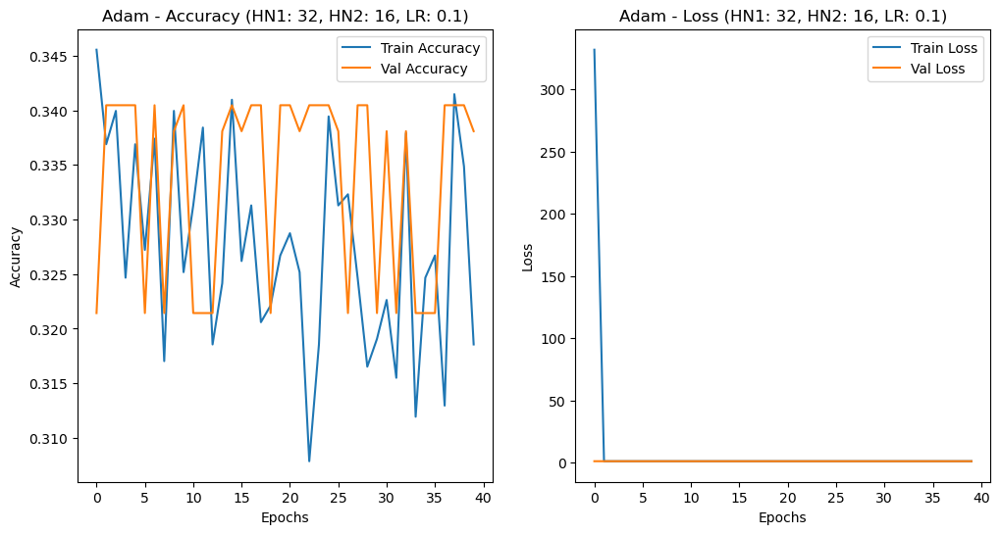

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3338 - loss: 2726.8220 - val_accuracy: 0.3381 - val_loss: 1.1057
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3311 - loss: 33.8120 - val_accuracy: 0.3381 - val_loss: 1.1020
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 48ms/step - accuracy: 0.3366 - loss: 21.3722 - val_accuracy: 0.3381 - val_loss: 1.1005
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 48ms/step - accuracy: 0.3290 - loss: 18.4900 - val_accuracy: 0.3381 - val_loss: 1.1001
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 54ms/step - accuracy: 0.3260 - loss: 23.9773 - val_accuracy: 0.3381 - val_loss: 1.1001
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 51ms/step - accuracy: 0.3377 - loss: 9.5723 - val_accuracy: 0.3381 - val_loss: 1.1001
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 54ms/step - accuracy: 0.3215 - loss: 11.1733 - val_accuracy: 0.3381 - val_loss: 1.1001
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3279 - loss: 14.8010 - val_accuracy: 0

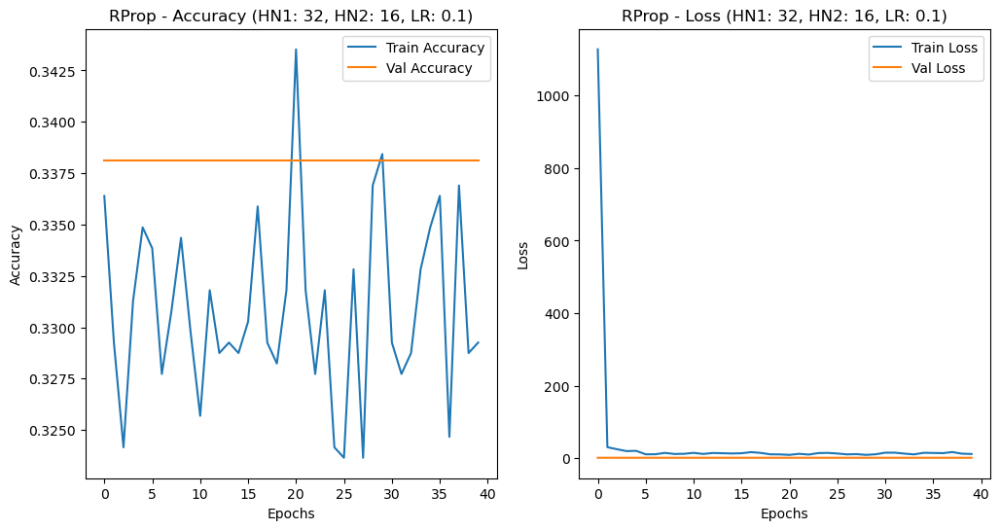

Adam Model - Test Loss: 1.0988, Test Accuracy: 0.3444
RProp Model - Test Loss: 1.1015, Test Accuracy: 0.3444
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Hybrid Model - Test Accuracy: 0.3444

[INFO] Training models with HN1: 32, HN2: 32, LR: 0.0001
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 72ms/step - accuracy: 0.3430 - loss: 9308.2549 - val_accuracy: 0.3405 - val_loss: 3396.7893
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3340 - loss: 8308.4297 - val_accuracy: 0.3405 - val_loss: 2639.9094
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 69ms/step - accuracy: 0.3296 - loss: 7955.1523 - val_accuracy: 0.3405 - val_loss: 2083.0554
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 72ms/step - accuracy: 0.3260 - loss: 7551.7026 - val_accuracy: 0.3405 - val_loss: 1557.4930
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 69ms/step - accuracy: 0.3461 - loss: 6965.1567 - val_accuracy: 0.3405 - val_loss: 1200.4740
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 72ms/step - 

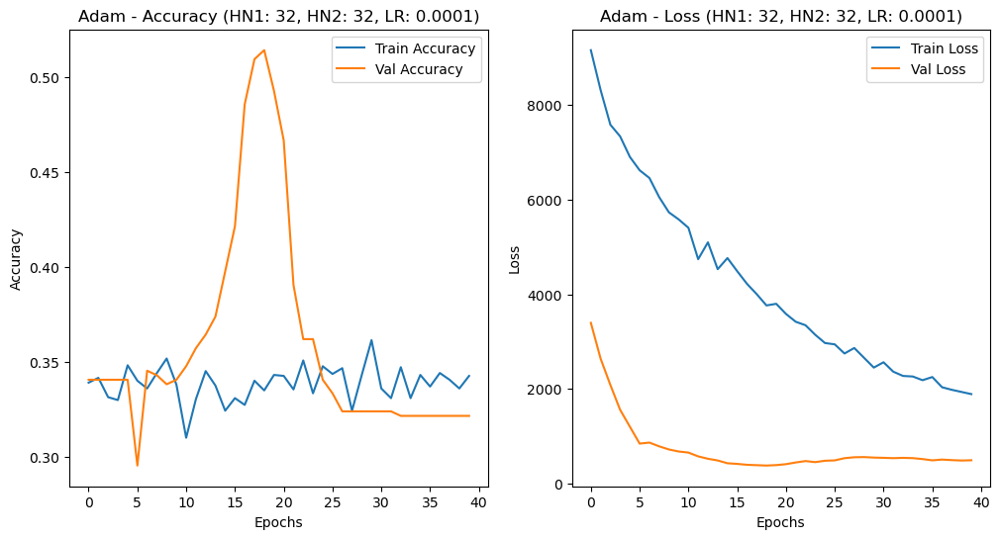

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 51ms/step - accuracy: 0.3356 - loss: 9432.5439 - val_accuracy: 0.3405 - val_loss: 2929.2776
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 55ms/step - accuracy: 0.3657 - loss: 4974.8037 - val_accuracy: 0.3214 - val_loss: 395.1946
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3247 - loss: 3097.8369 - val_accuracy: 0.3214 - val_loss: 397.3103
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3450 - loss: 2606.8313 - val_accuracy: 0.3214 - val_loss: 559.5623
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3170 - loss: 2485.0161 - val_accuracy: 0.3214 - val_loss: 457.3593
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 54ms/step - accuracy: 0.3164 - loss: 2269.2039 - val_accuracy: 0.1976 - val_loss: 182.1380
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 49ms/step - accuracy: 0.2988 - loss: 2002.1346 - val_accuracy: 0.2881 - val_loss: 272.7863
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3302 - los

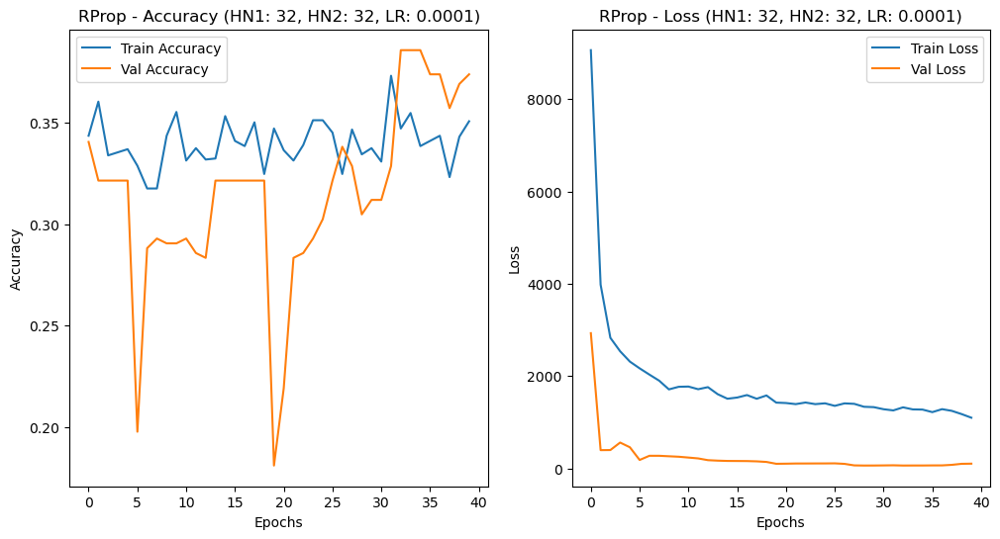

Adam Model - Test Loss: 472.6434, Test Accuracy: 0.3397
RProp Model - Test Loss: 104.0906, Test Accuracy: 0.3682
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
Hybrid Model - Test Accuracy: 0.3705

[INFO] Training models with HN1: 32, HN2: 32, LR: 0.001
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 18s 580ms/step - accuracy: 0.3138 - loss: 5487.2549 - val_accuracy: 0.4214 - val_loss: 169.2967
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 78ms/step - accuracy: 0.3506 - loss: 2963.8169 - val_accuracy: 0.3381 - val_loss: 306.3457
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 76ms/step - accuracy: 0.3349 - loss: 2000.2975 - val_accuracy: 0.3381 - val_loss: 172.7144
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 74ms/step - accuracy: 0.3691 - loss: 1280.2517 - val_accuracy: 0.3667 - val_loss: 105.4419
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 70ms/step - accuracy: 0.3338 - loss: 815.7971 - val_accuracy: 0.4167 - val_loss: 50.0851
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 83ms/step - ac

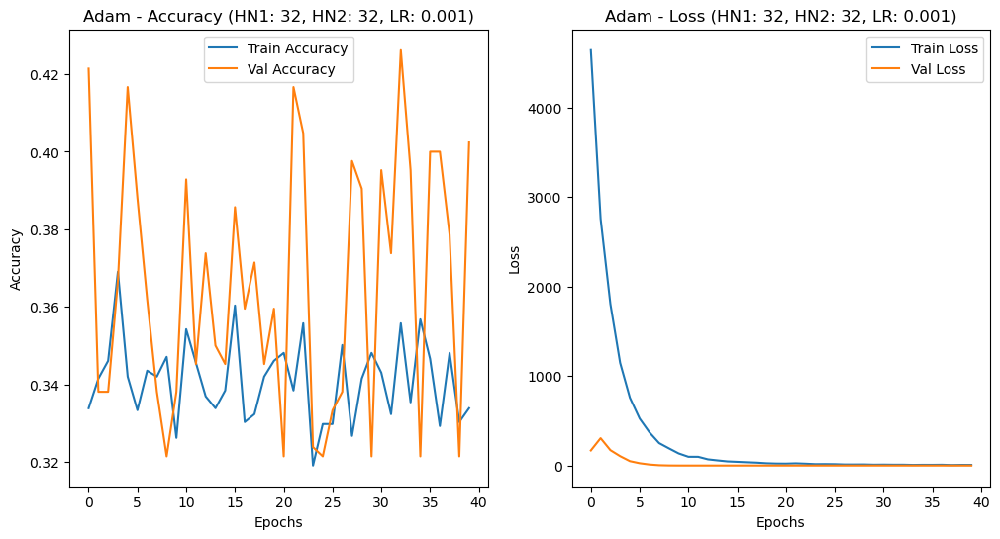

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 69ms/step - accuracy: 0.3327 - loss: 10934.7266 - val_accuracy: 0.3262 - val_loss: 300.0801
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 53ms/step - accuracy: 0.3618 - loss: 3823.6389 - val_accuracy: 0.4929 - val_loss: 536.5767
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3364 - loss: 2413.6592 - val_accuracy: 0.4333 - val_loss: 308.3255
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 56ms/step - accuracy: 0.3404 - loss: 1435.0608 - val_accuracy: 0.3667 - val_loss: 167.3822
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3205 - loss: 1116.4624 - val_accuracy: 0.3833 - val_loss: 230.1265
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 57ms/step - accuracy: 0.3602 - loss: 803.8905 - val_accuracy: 0.4762 - val_loss: 129.8451
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 57ms/step - accuracy: 0.3662 - loss: 711.9473 - val_accuracy: 0.4762 - val_loss: 129.3947
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 57ms/step - accuracy: 0.3670 - loss:

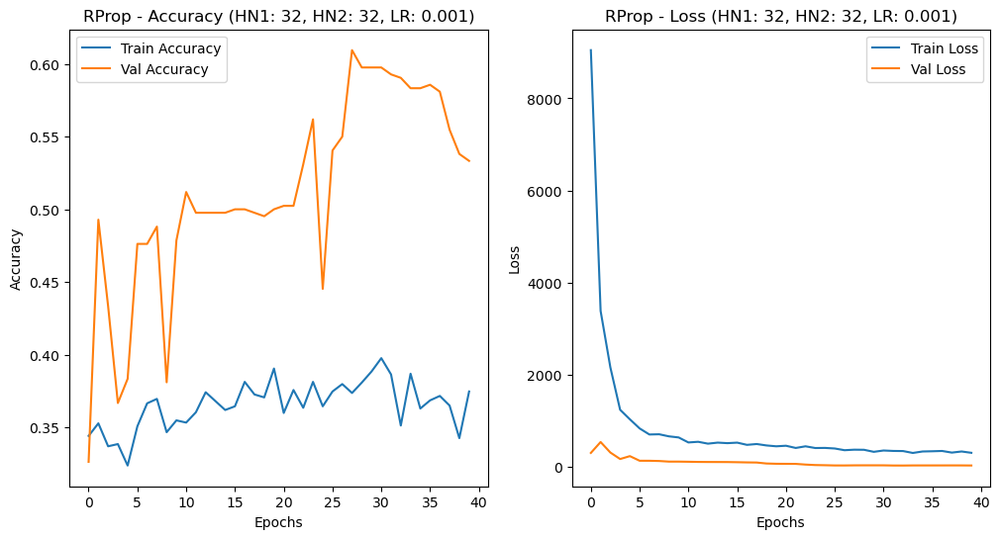

Adam Model - Test Loss: 1.0899, Test Accuracy: 0.3943
RProp Model - Test Loss: 26.1198, Test Accuracy: 0.5249
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
Hybrid Model - Test Accuracy: 0.5344

[INFO] Training models with HN1: 32, HN2: 32, LR: 0.01
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 84ms/step - accuracy: 0.3179 - loss: 5168.6899 - val_accuracy: 0.4048 - val_loss: 5.2758
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 98ms/step - accuracy: 0.3463 - loss: 88.2141 - val_accuracy: 0.3214 - val_loss: 1.1052
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 98ms/step - accuracy: 0.3132 - loss: 13.3106 - val_accuracy: 0.3405 - val_loss: 1.1062
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 102ms/step - accuracy: 0.3278 - loss: 6.1774 - val_accuracy: 0.3214 - val_loss: 1.1015
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 91ms/step - accuracy: 0.3453 - loss: 4.3873 - val_accuracy: 0.3405 - val_loss: 1.0994
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 81ms/step - accuracy: 0.3324 - loss: 

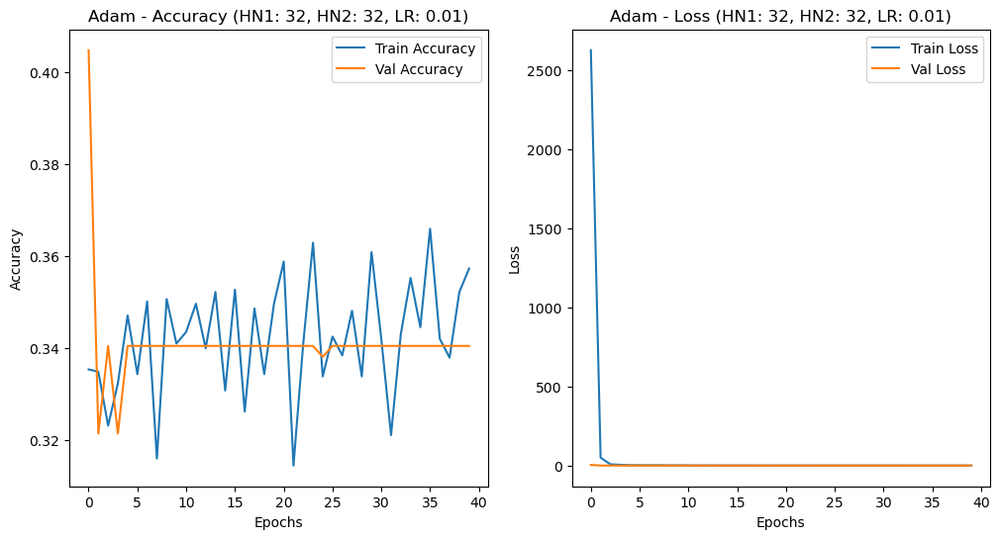

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 54ms/step - accuracy: 0.3353 - loss: 8772.0068 - val_accuracy: 0.3024 - val_loss: 214.2645
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - accuracy: 0.3431 - loss: 1613.2252 - val_accuracy: 0.3381 - val_loss: 337.1434
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3399 - loss: 909.9056 - val_accuracy: 0.4643 - val_loss: 132.7251
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3777 - loss: 544.3696 - val_accuracy: 0.4667 - val_loss: 107.3778
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 52ms/step - accuracy: 0.3647 - loss: 500.2185 - val_accuracy: 0.4952 - val_loss: 59.3243
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3999 - loss: 425.2804 - val_accuracy: 0.5119 - val_loss: 46.2996
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3843 - loss: 419.4599 - val_accuracy: 0.5143 - val_loss: 45.1880
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 92ms/step - accuracy: 0.3921 - loss: 406.97

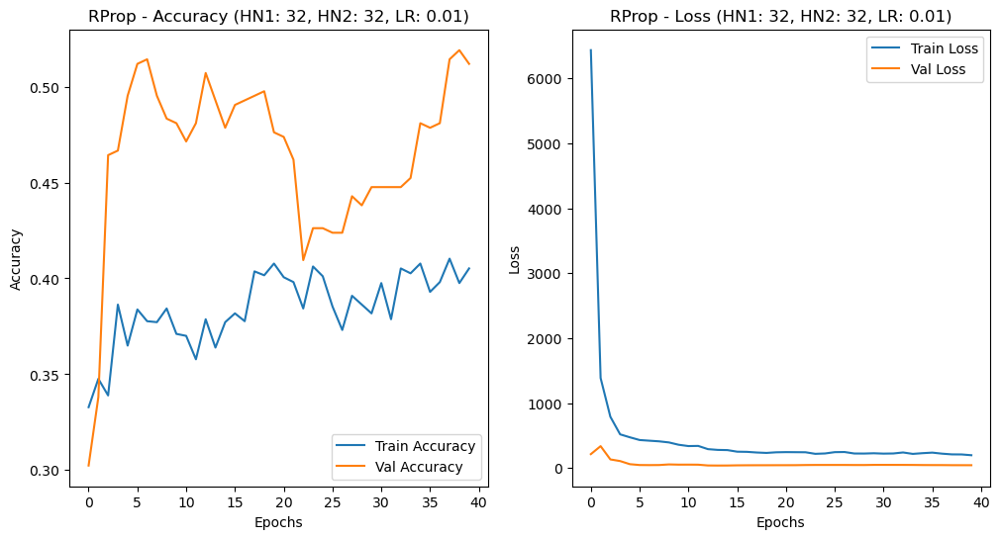

Adam Model - Test Loss: 1.1001, Test Accuracy: 0.3159
RProp Model - Test Loss: 40.6142, Test Accuracy: 0.5321
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Hybrid Model - Test Accuracy: 0.5321

[INFO] Training models with HN1: 32, HN2: 32, LR: 0.1
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 80ms/step - accuracy: 0.3440 - loss: 3207.0100 - val_accuracy: 0.3381 - val_loss: 1.1020
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 72ms/step - accuracy: 0.3323 - loss: 1.1024 - val_accuracy: 0.3381 - val_loss: 1.0998
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 77ms/step - accuracy: 0.3034 - loss: 1.1028 - val_accuracy: 0.3405 - val_loss: 1.0986
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 77ms/step - accuracy: 0.3256 - loss: 1.1003 - val_accuracy: 0.3405 - val_loss: 1.0995
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 77ms/step - accuracy: 0.3788 - loss: 1.0975 - val_accuracy: 0.3381 - val_loss: 1.1047
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 72ms/step - accuracy: 0.3249 - loss: 1.10

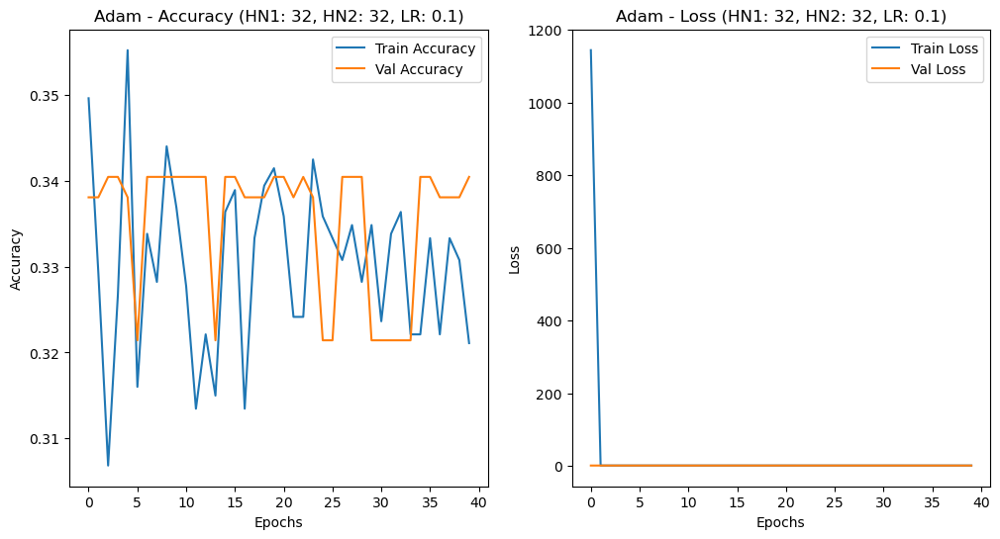

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 49ms/step - accuracy: 0.3286 - loss: 2927.4661 - val_accuracy: 0.5286 - val_loss: 17.5657
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 50ms/step - accuracy: 0.3637 - loss: 165.0770 - val_accuracy: 0.4976 - val_loss: 22.5989
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3811 - loss: 58.5806 - val_accuracy: 0.4762 - val_loss: 12.5329
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.4205 - loss: 37.5179 - val_accuracy: 0.4833 - val_loss: 11.4924
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.4084 - loss: 29.5223 - val_accuracy: 0.4643 - val_loss: 8.8155
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 57ms/step - accuracy: 0.4161 - loss: 25.6497 - val_accuracy: 0.4548 - val_loss: 8.0041
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.4175 - loss: 22.3861 - val_accuracy: 0.4857 - val_loss: 6.9318
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.4516 - loss: 17.8307 - val_accur

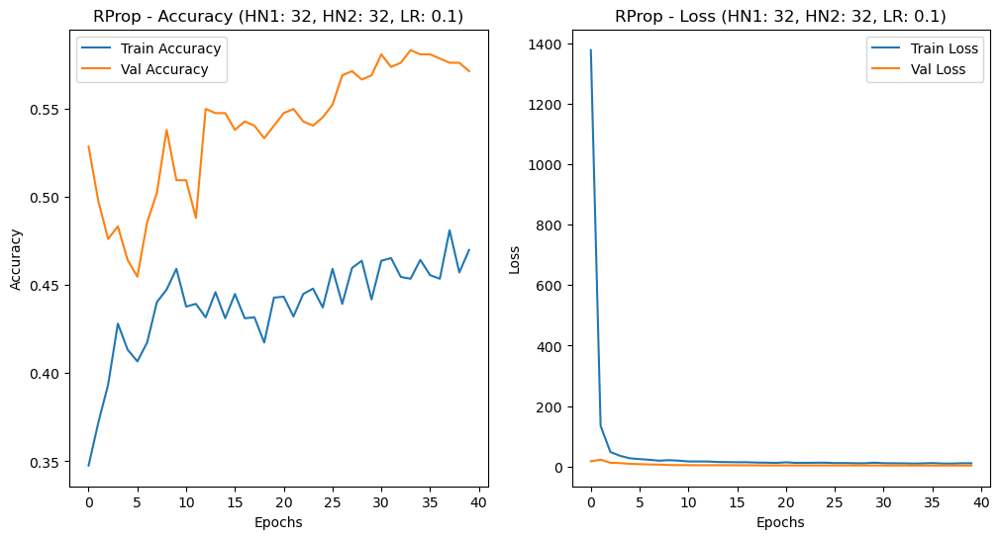

Adam Model - Test Loss: 1.1005, Test Accuracy: 0.3159
RProp Model - Test Loss: 3.0482, Test Accuracy: 0.5463
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
Hybrid Model - Test Accuracy: 0.5439

[INFO] Training models with HN1: 32, HN2: 64, LR: 0.0001
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3583 - loss: 7503.9624 - val_accuracy: 0.3381 - val_loss: 3579.3970
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3482 - loss: 7025.1406 - val_accuracy: 0.3381 - val_loss: 2454.2158
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3485 - loss: 6621.1982 - val_accuracy: 0.3381 - val_loss: 1712.2650
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 71ms/step - accuracy: 0.3262 - loss: 6696.2603 - val_accuracy: 0.3381 - val_loss: 1146.7238
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 71ms/step - accuracy: 0.3497 - loss: 5823.6572 - val_accuracy: 0.3381 - val_loss: 718.4235
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 69ms/step - a

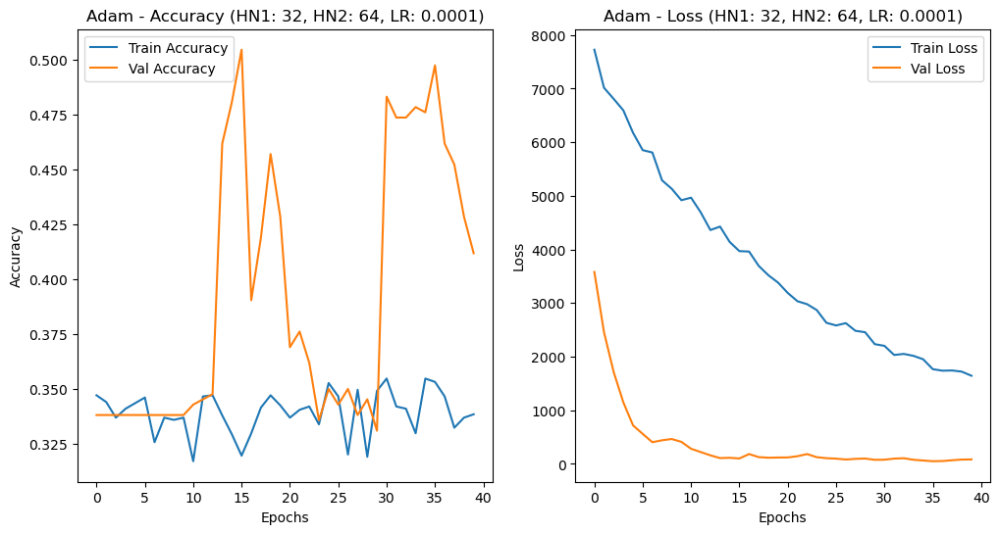

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3119 - loss: 8735.8291 - val_accuracy: 0.3381 - val_loss: 1625.1809
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 51ms/step - accuracy: 0.3156 - loss: 6033.8540 - val_accuracy: 0.3214 - val_loss: 1008.4697
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 54ms/step - accuracy: 0.3426 - loss: 3419.3669 - val_accuracy: 0.3214 - val_loss: 699.7277
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 56ms/step - accuracy: 0.3556 - loss: 2337.6926 - val_accuracy: 0.3214 - val_loss: 417.7512
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 49ms/step - accuracy: 0.3210 - loss: 1901.7719 - val_accuracy: 0.3214 - val_loss: 270.9643
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 49ms/step - accuracy: 0.3278 - loss: 1729.2012 - val_accuracy: 0.3310 - val_loss: 205.0435
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 48ms/step - accuracy: 0.3402 - loss: 1229.6919 - val_accuracy: 0.3905 - val_loss: 206.2650
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 51ms/step - accuracy: 0.3192 - lo

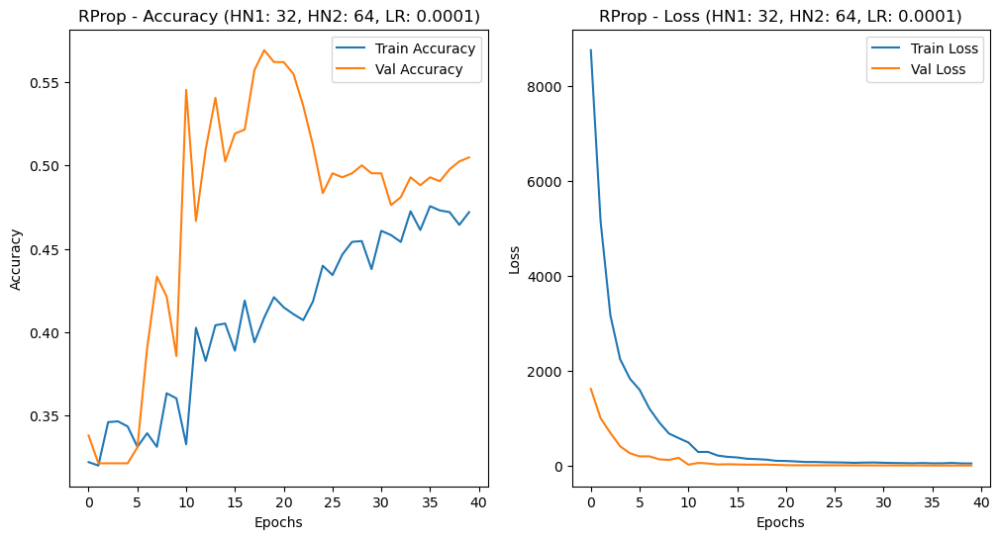

Adam Model - Test Loss: 80.8935, Test Accuracy: 0.4204
RProp Model - Test Loss: 13.7818, Test Accuracy: 0.4822
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
Hybrid Model - Test Accuracy: 0.4561

[INFO] Training models with HN1: 32, HN2: 64, LR: 0.001
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - accuracy: 0.3293 - loss: 7395.1270 - val_accuracy: 0.3214 - val_loss: 2040.0494
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3285 - loss: 4125.2930 - val_accuracy: 0.3190 - val_loss: 1113.3656
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3328 - loss: 2344.4849 - val_accuracy: 0.3214 - val_loss: 1071.6959
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3495 - loss: 1666.8481 - val_accuracy: 0.3214 - val_loss: 564.1867
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3517 - loss: 1125.0781 - val_accuracy: 0.3214 - val_loss: 319.7675
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - a

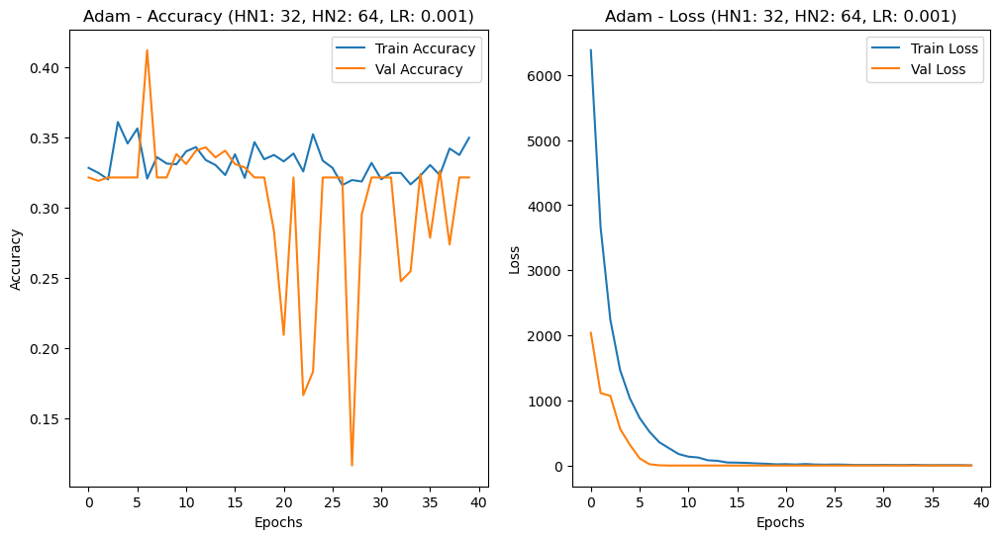

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3309 - loss: 6870.3965 - val_accuracy: 0.3381 - val_loss: 1062.8083
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3463 - loss: 2380.4385 - val_accuracy: 0.3405 - val_loss: 385.1587
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3395 - loss: 1289.4352 - val_accuracy: 0.4452 - val_loss: 309.6746
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3689 - loss: 497.0215 - val_accuracy: 0.3310 - val_loss: 166.9113
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3729 - loss: 337.5256 - val_accuracy: 0.4929 - val_loss: 108.3513
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.4306 - loss: 215.5560 - val_accuracy: 0.3952 - val_loss: 82.7405
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.4306 - loss: 133.5274 - val_accuracy: 0.3690 - val_loss: 80.9286
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.4409 - loss: 123

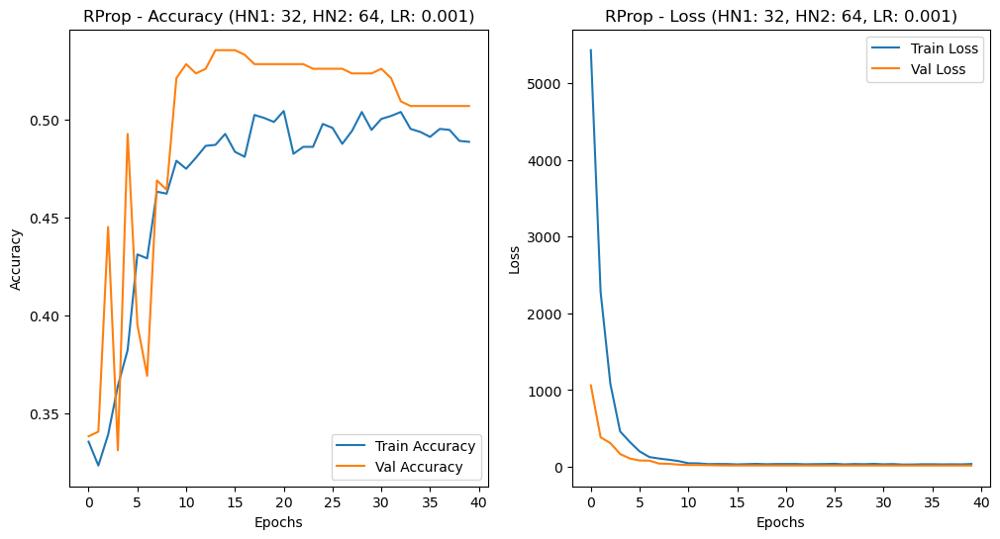

Adam Model - Test Loss: 1.1008, Test Accuracy: 0.3397
RProp Model - Test Loss: 13.9569, Test Accuracy: 0.5059
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
Hybrid Model - Test Accuracy: 0.5059

[INFO] Training models with HN1: 32, HN2: 64, LR: 0.01
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3460 - loss: 3238.8396 - val_accuracy: 0.3190 - val_loss: 10.0178
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3188 - loss: 61.3862 - val_accuracy: 0.4524 - val_loss: 1.1231
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3962 - loss: 2.2822 - val_accuracy: 0.3286 - val_loss: 1.1294
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3363 - loss: 1.1360 - val_accuracy: 0.3452 - val_loss: 1.0950
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3308 - loss: 1.0983 - val_accuracy: 0.3452 - val_loss: 1.0949
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3402 - loss: 1

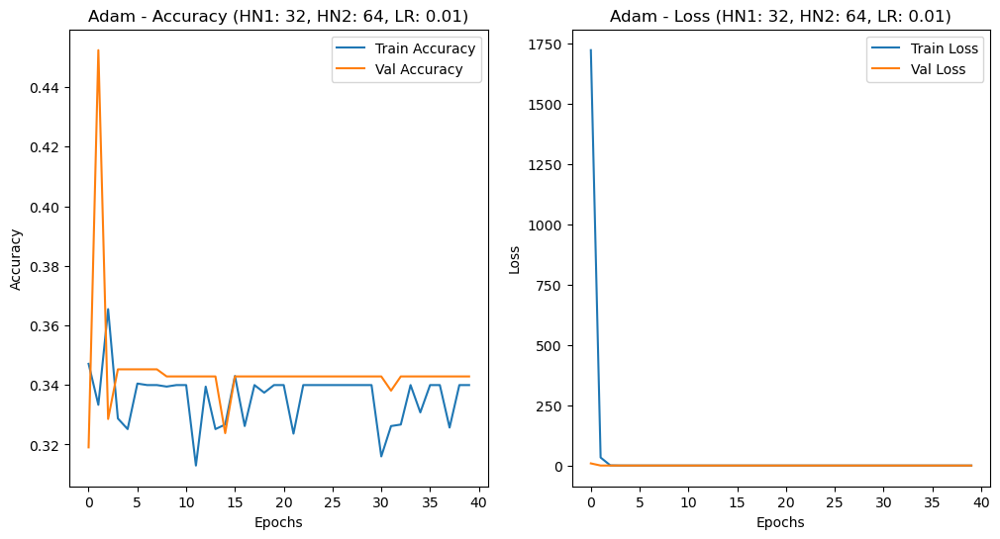

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 48ms/step - accuracy: 0.3285 - loss: 8398.3828 - val_accuracy: 0.3381 - val_loss: 1474.2103
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3512 - loss: 3263.6753 - val_accuracy: 0.4452 - val_loss: 486.2360
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3834 - loss: 2107.6191 - val_accuracy: 0.4905 - val_loss: 614.8751
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3808 - loss: 1580.8506 - val_accuracy: 0.4524 - val_loss: 699.9439
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 54ms/step - accuracy: 0.3838 - loss: 1355.0439 - val_accuracy: 0.5000 - val_loss: 487.6884
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.4156 - loss: 1062.6539 - val_accuracy: 0.5000 - val_loss: 423.9667
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.4054 - loss: 986.7394 - val_accuracy: 0.4929 - val_loss: 422.2526
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 49ms/step - accuracy: 0.4120 - loss

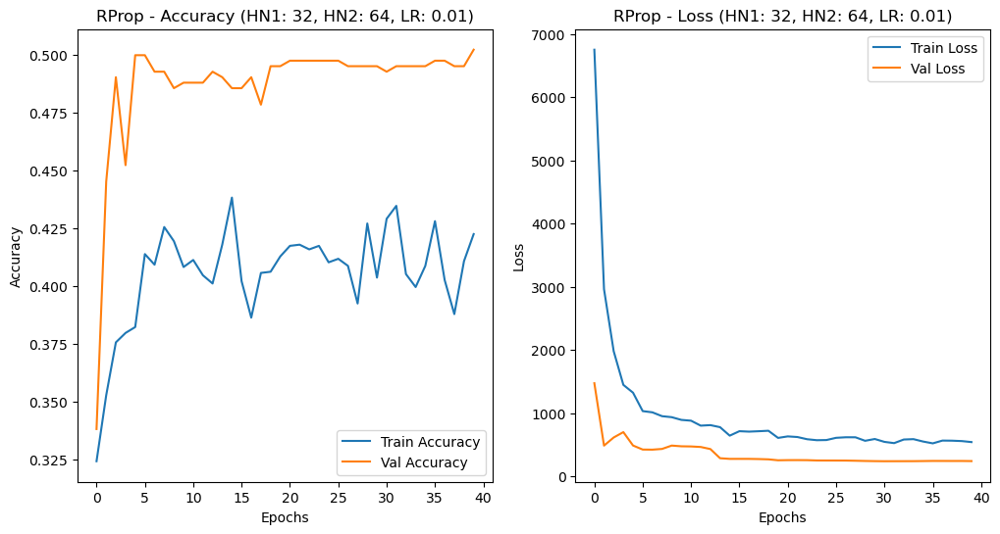

Adam Model - Test Loss: 1.0994, Test Accuracy: 0.3159
RProp Model - Test Loss: 252.7535, Test Accuracy: 0.4751
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
Hybrid Model - Test Accuracy: 0.4751

[INFO] Training models with HN1: 32, HN2: 64, LR: 0.1
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 73ms/step - accuracy: 0.3396 - loss: 2343.3303 - val_accuracy: 0.3405 - val_loss: 1.0968
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 69ms/step - accuracy: 0.3495 - loss: 1.0997 - val_accuracy: 0.3405 - val_loss: 1.0975
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3567 - loss: 1.0974 - val_accuracy: 0.3238 - val_loss: 1.1028
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 69ms/step - accuracy: 0.3421 - loss: 1.1002 - val_accuracy: 0.3405 - val_loss: 1.0991
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - accuracy: 0.3133 - loss: 1.1070 - val_accuracy: 0.3238 - val_loss: 1.1006
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - accuracy: 0.3558 - loss: 1.0

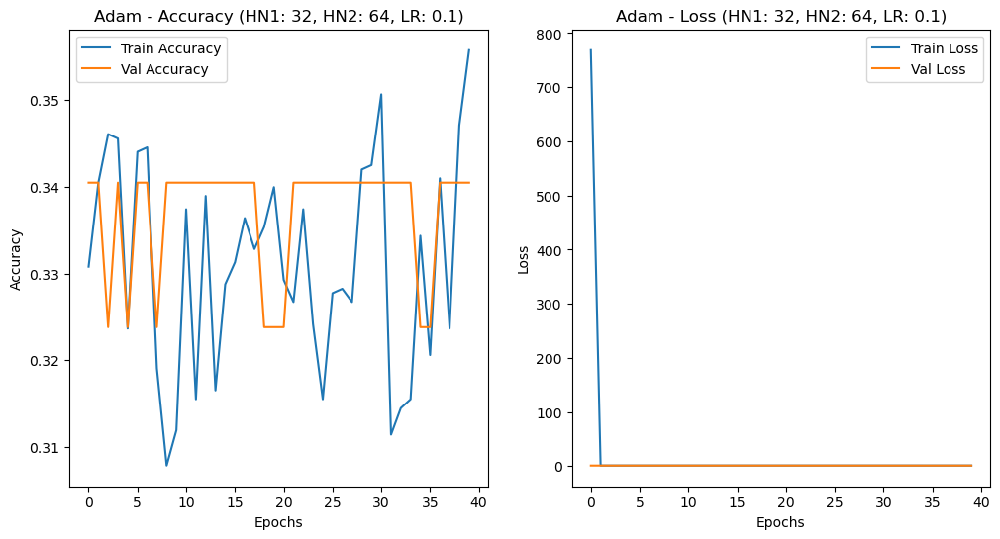

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 55ms/step - accuracy: 0.3604 - loss: 3254.3784 - val_accuracy: 0.4405 - val_loss: 31.4211
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 54ms/step - accuracy: 0.3808 - loss: 298.2435 - val_accuracy: 0.3905 - val_loss: 25.6268
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3667 - loss: 232.1280 - val_accuracy: 0.3238 - val_loss: 19.7263
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3767 - loss: 212.3383 - val_accuracy: 0.3786 - val_loss: 33.0484
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 49ms/step - accuracy: 0.3533 - loss: 209.4733 - val_accuracy: 0.3881 - val_loss: 32.2340
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 49ms/step - accuracy: 0.3768 - loss: 191.3292 - val_accuracy: 0.4857 - val_loss: 18.1756
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 49ms/step - accuracy: 0.3513 - loss: 193.3280 - val_accuracy: 0.5738 - val_loss: 14.9101
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 52ms/step - accuracy: 0.3671 - loss: 169.7915 - 

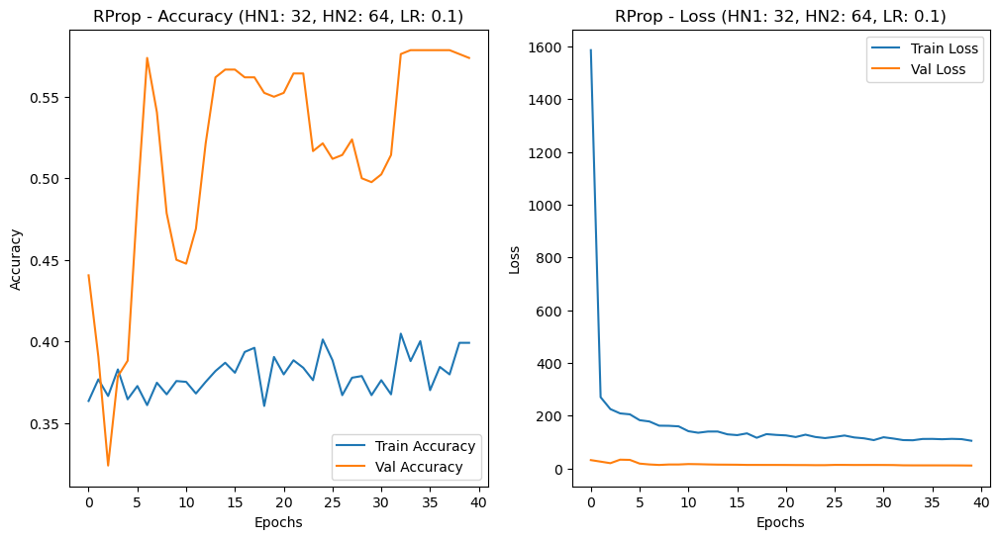

Adam Model - Test Loss: 1.0992, Test Accuracy: 0.3444
RProp Model - Test Loss: 12.2621, Test Accuracy: 0.5463
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
Hybrid Model - Test Accuracy: 0.5463

[INFO] Training models with HN1: 32, HN2: 128, LR: 0.0001
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 75ms/step - accuracy: 0.3428 - loss: 4727.2822 - val_accuracy: 0.3214 - val_loss: 2898.3860
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 71ms/step - accuracy: 0.3292 - loss: 3863.3154 - val_accuracy: 0.3214 - val_loss: 1876.8674
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 71ms/step - accuracy: 0.3275 - loss: 3192.2937 - val_accuracy: 0.3214 - val_loss: 1209.8739
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 71ms/step - accuracy: 0.2954 - loss: 3182.7578 - val_accuracy: 0.3214 - val_loss: 726.7319
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 68ms/step - accuracy: 0.3390 - loss: 2667.2720 - val_accuracy: 0.3286 - val_loss: 471.1949
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - 

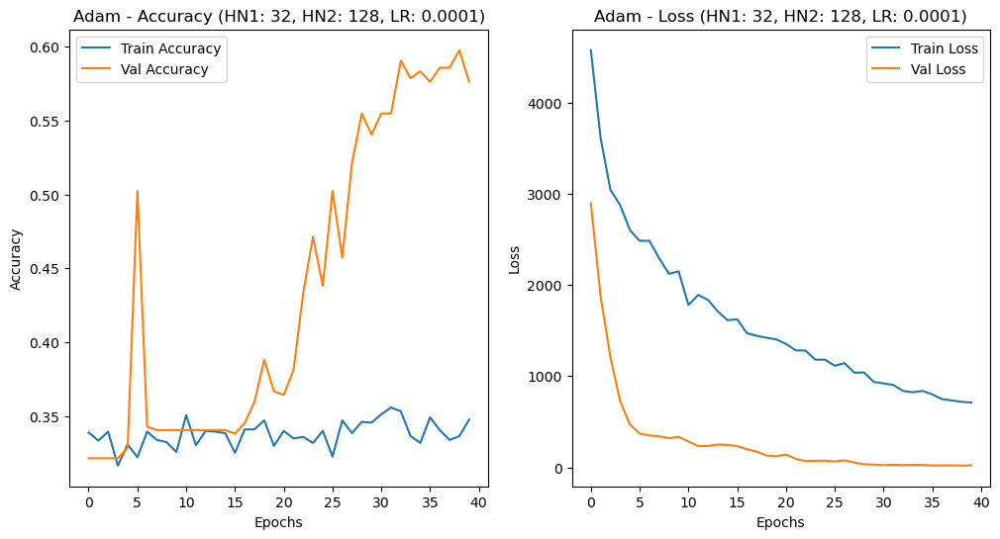

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3245 - loss: 7829.7368 - val_accuracy: 0.3381 - val_loss: 756.7443
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 54ms/step - accuracy: 0.3315 - loss: 4408.2944 - val_accuracy: 0.3381 - val_loss: 1483.8137
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 51ms/step - accuracy: 0.3454 - loss: 3333.9736 - val_accuracy: 0.3381 - val_loss: 1516.6989
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3510 - loss: 3031.9065 - val_accuracy: 0.3929 - val_loss: 864.3708
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 50ms/step - accuracy: 0.3587 - loss: 2709.7854 - val_accuracy: 0.4929 - val_loss: 643.7606
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 52ms/step - accuracy: 0.3204 - loss: 2291.0876 - val_accuracy: 0.3405 - val_loss: 495.8120
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 53ms/step - accuracy: 0.3342 - loss: 1822.6282 - val_accuracy: 0.3381 - val_loss: 682.7510
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 51ms/step - accuracy: 0.3527 - lo

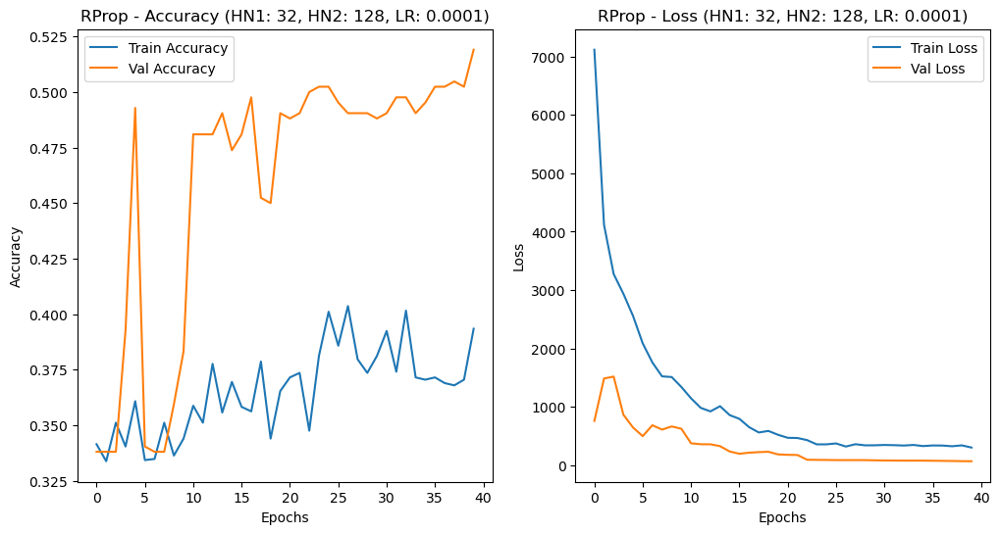

Adam Model - Test Loss: 24.3178, Test Accuracy: 0.5226
RProp Model - Test Loss: 63.8971, Test Accuracy: 0.4941
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
Hybrid Model - Test Accuracy: 0.5012

[INFO] Training models with HN1: 32, HN2: 128, LR: 0.001
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 82ms/step - accuracy: 0.3258 - loss: 4617.7974 - val_accuracy: 0.3381 - val_loss: 488.8380
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 68ms/step - accuracy: 0.3363 - loss: 2680.5022 - val_accuracy: 0.3595 - val_loss: 259.4045
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 72ms/step - accuracy: 0.3444 - loss: 1805.5199 - val_accuracy: 0.4071 - val_loss: 131.8781
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 68ms/step - accuracy: 0.3374 - loss: 1346.7035 - val_accuracy: 0.4762 - val_loss: 59.7642
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3387 - loss: 997.2039 - val_accuracy: 0.5024 - val_loss: 30.3849
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 71ms/step - accur

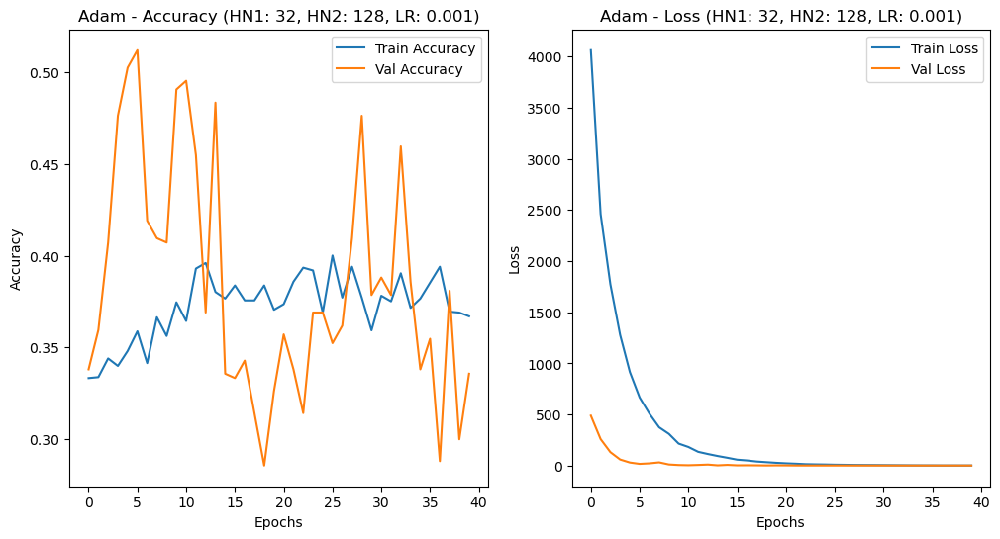

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 50ms/step - accuracy: 0.3133 - loss: 3089.0696 - val_accuracy: 0.3262 - val_loss: 124.8941
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 52ms/step - accuracy: 0.3100 - loss: 1247.9816 - val_accuracy: 0.4048 - val_loss: 198.9185
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 56ms/step - accuracy: 0.3319 - loss: 789.5887 - val_accuracy: 0.3381 - val_loss: 106.3427
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3527 - loss: 531.3025 - val_accuracy: 0.3643 - val_loss: 78.1726
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 53ms/step - accuracy: 0.3772 - loss: 384.7154 - val_accuracy: 0.3405 - val_loss: 139.0917
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 49ms/step - accuracy: 0.3638 - loss: 351.3410 - val_accuracy: 0.3452 - val_loss: 32.6149
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 57ms/step - accuracy: 0.3395 - loss: 347.2191 - val_accuracy: 0.3429 - val_loss: 103.9496
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 53ms/step - accuracy: 0.3709 - loss: 285.1

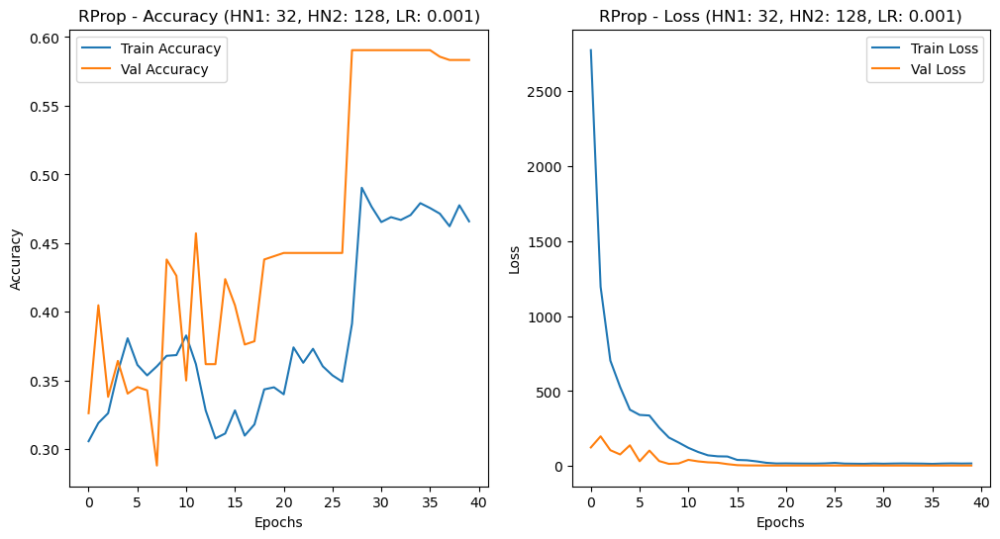

Adam Model - Test Loss: 1.1079, Test Accuracy: 0.3373
RProp Model - Test Loss: 4.1039, Test Accuracy: 0.5392
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
Hybrid Model - Test Accuracy: 0.5416

[INFO] Training models with HN1: 32, HN2: 128, LR: 0.01
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 76ms/step - accuracy: 0.3430 - loss: 3060.6636 - val_accuracy: 0.4190 - val_loss: 29.1928
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 70ms/step - accuracy: 0.3554 - loss: 70.0334 - val_accuracy: 0.3214 - val_loss: 1.1445
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 68ms/step - accuracy: 0.3224 - loss: 1.1651 - val_accuracy: 0.3214 - val_loss: 1.1019
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 75ms/step - accuracy: 0.3259 - loss: 1.1134 - val_accuracy: 0.3405 - val_loss: 1.0988
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 72ms/step - accuracy: 0.3260 - loss: 1.1008 - val_accuracy: 0.3405 - val_loss: 1.0989
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 73ms/step - accuracy: 0.3256 - loss: 1

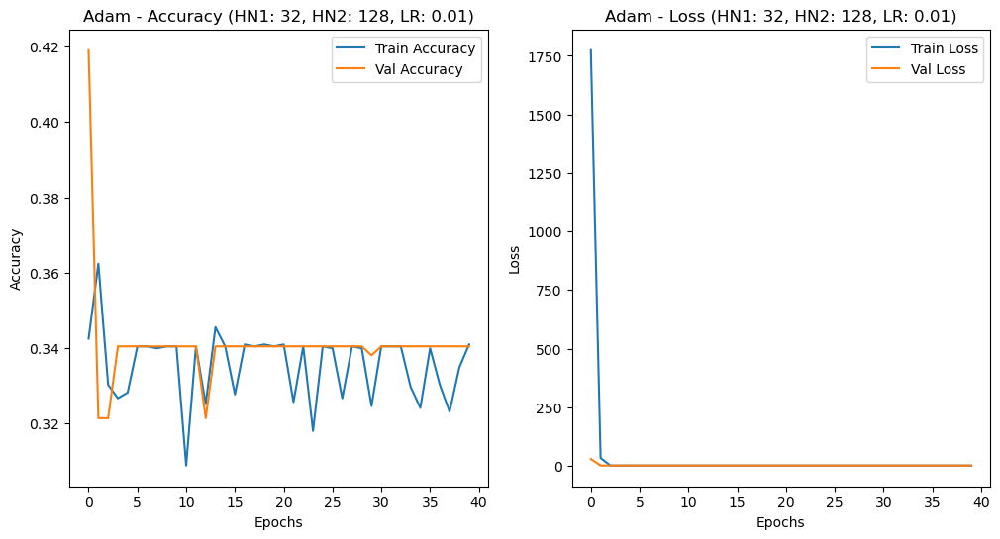

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 58ms/step - accuracy: 0.3410 - loss: 3969.4490 - val_accuracy: 0.4048 - val_loss: 266.5132
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 56ms/step - accuracy: 0.3703 - loss: 1763.2722 - val_accuracy: 0.3619 - val_loss: 213.0813
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 56ms/step - accuracy: 0.3759 - loss: 1208.2789 - val_accuracy: 0.5000 - val_loss: 118.0716
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3896 - loss: 976.2511 - val_accuracy: 0.5786 - val_loss: 157.9290
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3800 - loss: 802.8004 - val_accuracy: 0.5548 - val_loss: 170.8524
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.4091 - loss: 705.6194 - val_accuracy: 0.5452 - val_loss: 172.9856
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3985 - loss: 661.6414 - val_accuracy: 0.5429 - val_loss: 159.8872
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3835 - loss: 59

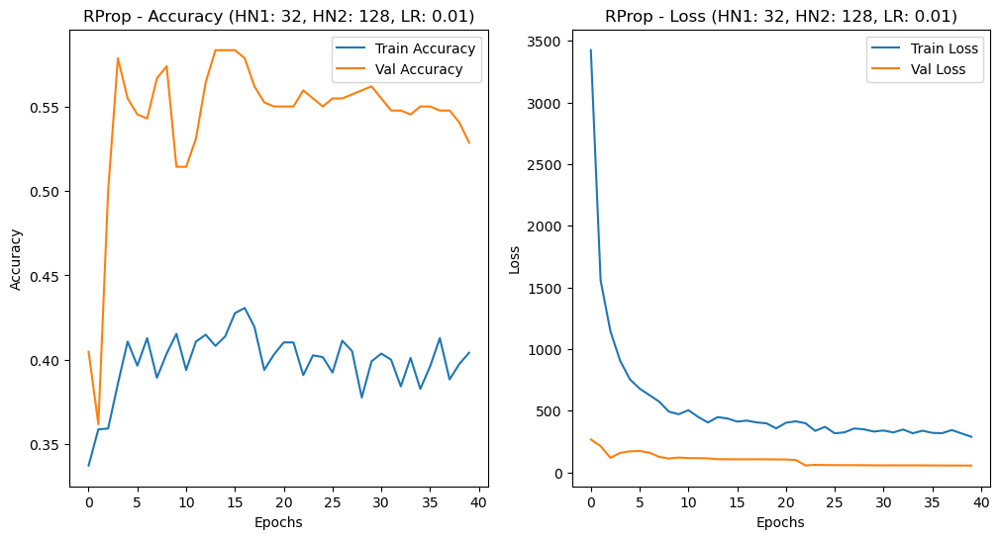

Adam Model - Test Loss: 1.0989, Test Accuracy: 0.3159
RProp Model - Test Loss: 58.3929, Test Accuracy: 0.5249
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
Hybrid Model - Test Accuracy: 0.5249

[INFO] Training models with HN1: 32, HN2: 128, LR: 0.1
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 75ms/step - accuracy: 0.3246 - loss: 3479.4746 - val_accuracy: 0.3405 - val_loss: 1.0984
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 70ms/step - accuracy: 0.3059 - loss: 1.1043 - val_accuracy: 0.3214 - val_loss: 1.1013
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 72ms/step - accuracy: 0.3587 - loss: 1.1100 - val_accuracy: 0.3405 - val_loss: 1.1013
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 73ms/step - accuracy: 0.3384 - loss: 1.1016 - val_accuracy: 0.3405 - val_loss: 1.1021
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 72ms/step - accuracy: 0.3190 - loss: 1.1064 - val_accuracy: 0.3405 - val_loss: 1.1014
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3609 - loss: 1.0

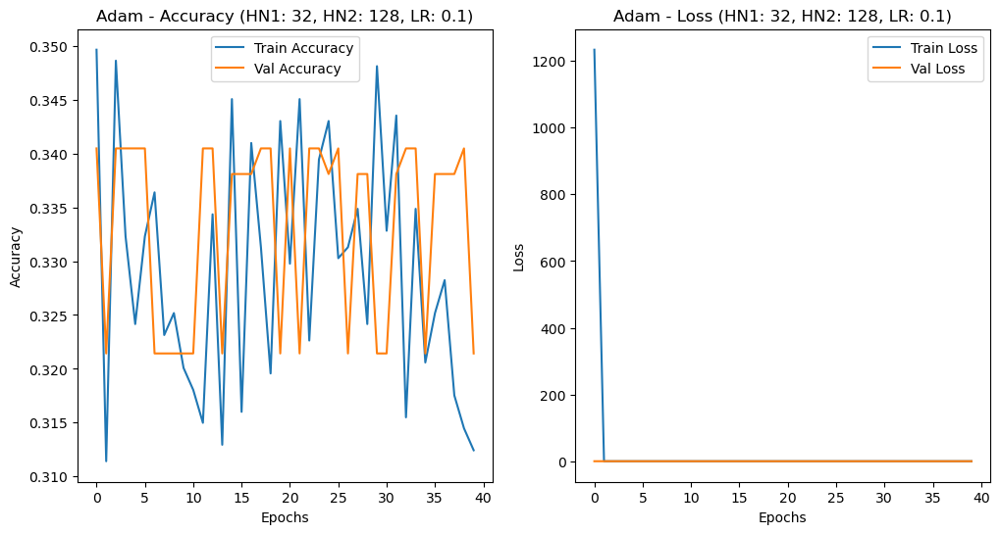

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3334 - loss: 1953.5110 - val_accuracy: 0.5381 - val_loss: 16.7921
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.4282 - loss: 24.3018 - val_accuracy: 0.4143 - val_loss: 4.6997
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3360 - loss: 3.4968 - val_accuracy: 0.3929 - val_loss: 1.8526
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3259 - loss: 3.2597 - val_accuracy: 0.3881 - val_loss: 1.4341
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 48ms/step - accuracy: 0.3624 - loss: 1.4980 - val_accuracy: 0.3881 - val_loss: 1.1910
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3530 - loss: 1.4461 - val_accuracy: 0.3857 - val_loss: 1.1636
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3465 - loss: 1.3418 - val_accuracy: 0.3857 - val_loss: 1.1388
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 50ms/step - accuracy: 0.3466 - loss: 1.2252 - val_accuracy: 0.385

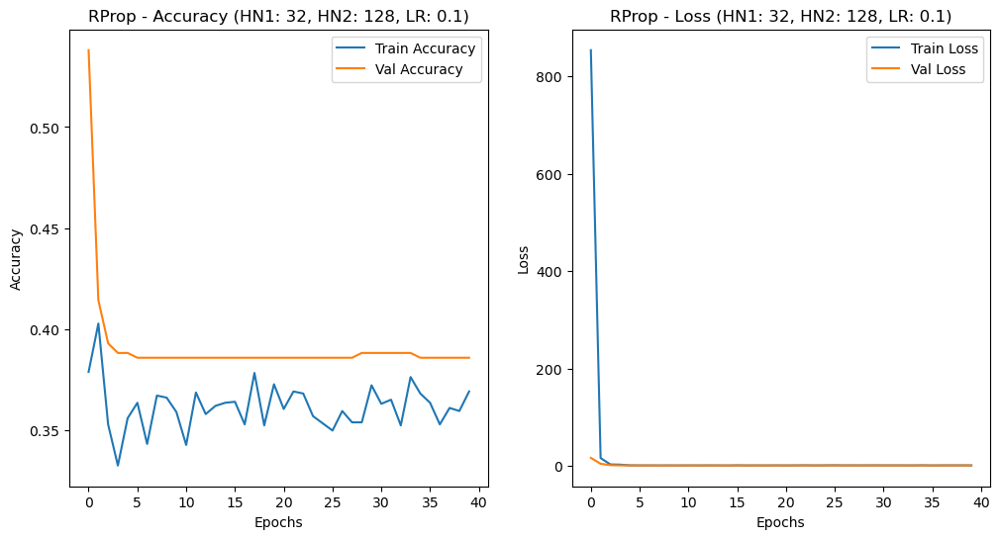

Adam Model - Test Loss: 1.1007, Test Accuracy: 0.3397
RProp Model - Test Loss: 1.1911, Test Accuracy: 0.3848
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
Hybrid Model - Test Accuracy: 0.3848

[INFO] Training models with HN1: 64, HN2: 16, LR: 0.0001
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3225 - loss: 6689.5796 - val_accuracy: 0.3405 - val_loss: 5068.2490
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3394 - loss: 5701.1631 - val_accuracy: 0.3405 - val_loss: 4083.1655
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3523 - loss: 5766.5884 - val_accuracy: 0.3405 - val_loss: 3252.5940
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3352 - loss: 5252.2773 - val_accuracy: 0.3405 - val_loss: 2667.1707
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3595 - loss: 4214.7368 - val_accuracy: 0.3405 - val_loss: 2145.0527
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - 

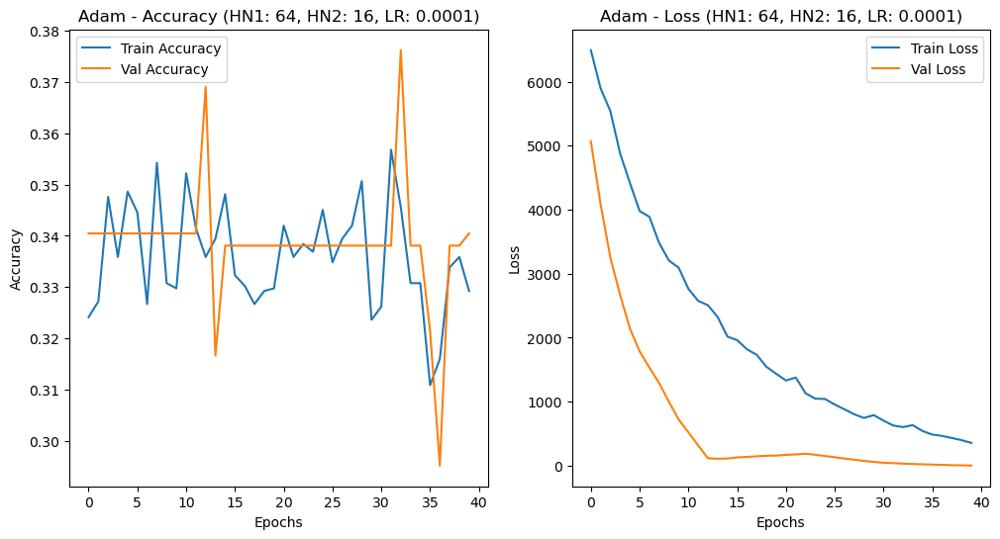

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3364 - loss: 12081.8682 - val_accuracy: 0.3381 - val_loss: 3054.6860
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3305 - loss: 4904.0605 - val_accuracy: 0.3405 - val_loss: 1059.2450
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3310 - loss: 2360.4866 - val_accuracy: 0.3405 - val_loss: 448.7724
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3453 - loss: 1269.9757 - val_accuracy: 0.3405 - val_loss: 170.5505
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3491 - loss: 954.6029 - val_accuracy: 0.3405 - val_loss: 69.4931
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3334 - loss: 821.7411 - val_accuracy: 0.3405 - val_loss: 58.3905
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3241 - loss: 746.4176 - val_accuracy: 0.3405 - val_loss: 31.8870
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3458 - loss: 4

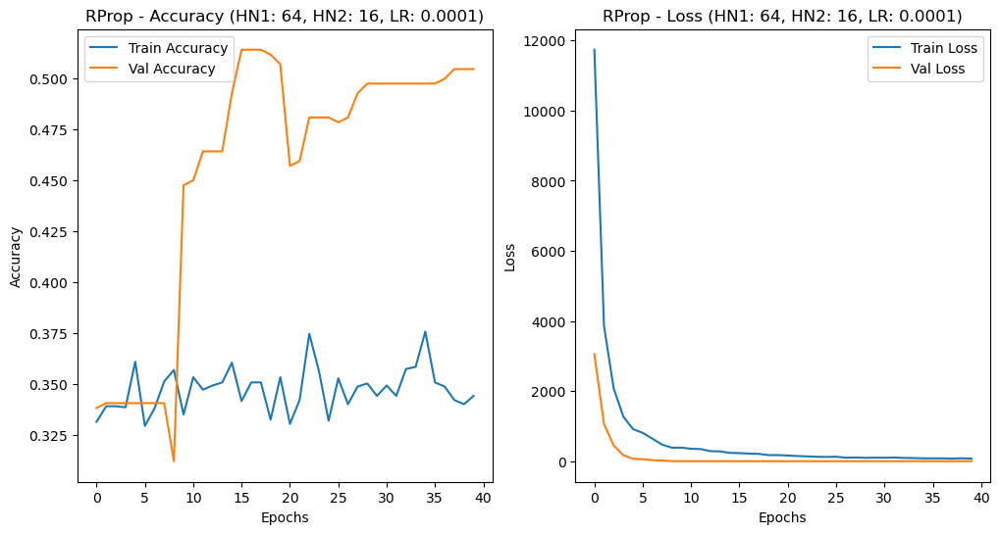

Adam Model - Test Loss: 1.2003, Test Accuracy: 0.3159
RProp Model - Test Loss: 1.0482, Test Accuracy: 0.4751
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
Hybrid Model - Test Accuracy: 0.4822

[INFO] Training models with HN1: 64, HN2: 16, LR: 0.001
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 73ms/step - accuracy: 0.3375 - loss: 5571.4531 - val_accuracy: 0.3071 - val_loss: 211.3777
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3082 - loss: 1968.7861 - val_accuracy: 0.3381 - val_loss: 193.7920
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 75ms/step - accuracy: 0.3107 - loss: 624.6873 - val_accuracy: 0.3214 - val_loss: 1.0989
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 71ms/step - accuracy: 0.3039 - loss: 222.1511 - val_accuracy: 0.3214 - val_loss: 1.0990
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - accuracy: 0.3308 - loss: 129.8775 - val_accuracy: 0.3214 - val_loss: 1.0992
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 84ms/step - accuracy: 0.350

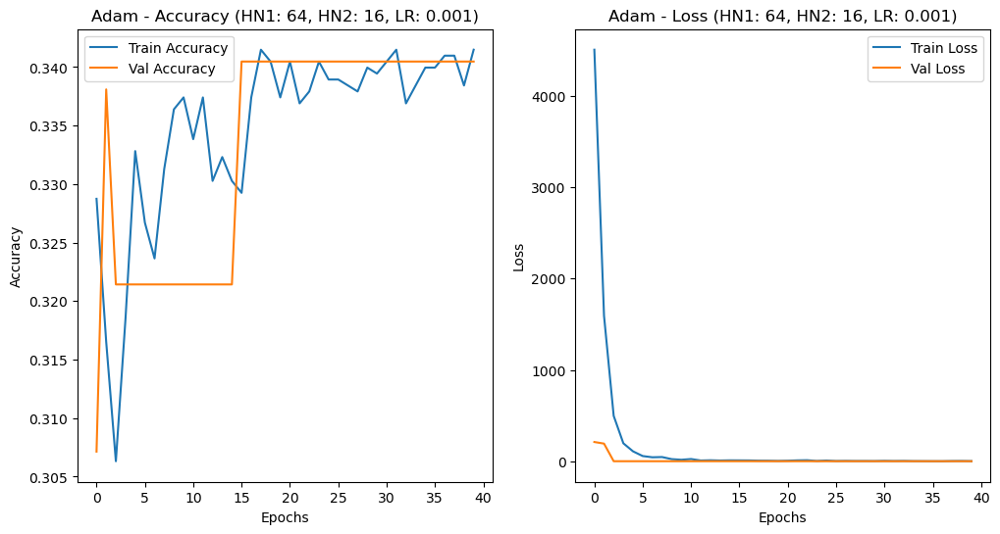

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 53ms/step - accuracy: 0.3378 - loss: 7255.3862 - val_accuracy: 0.3381 - val_loss: 1161.7430
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3429 - loss: 2855.9026 - val_accuracy: 0.5167 - val_loss: 517.7563
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 49ms/step - accuracy: 0.3202 - loss: 1427.9716 - val_accuracy: 0.3214 - val_loss: 74.7487
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 55ms/step - accuracy: 0.3287 - loss: 536.4528 - val_accuracy: 0.3214 - val_loss: 36.7332
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 53ms/step - accuracy: 0.3623 - loss: 236.8091 - val_accuracy: 0.3024 - val_loss: 10.4139
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 52ms/step - accuracy: 0.3280 - loss: 149.0742 - val_accuracy: 0.3381 - val_loss: 23.0912
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 48ms/step - accuracy: 0.3170 - loss: 125.8959 - val_accuracy: 0.3381 - val_loss: 17.8494
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 48ms/step - accuracy: 0.3162 - loss: 90.721

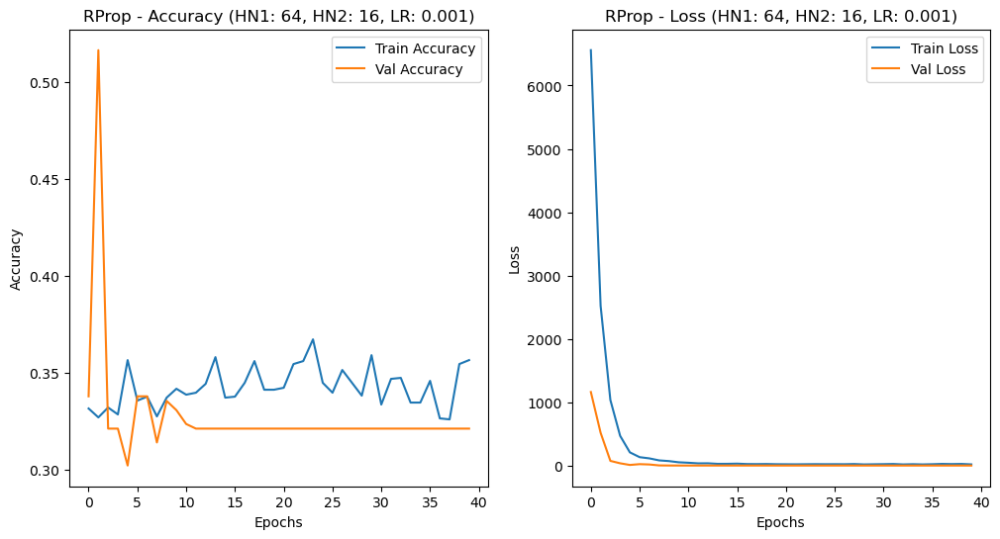

Adam Model - Test Loss: 1.0990, Test Accuracy: 0.3159
RProp Model - Test Loss: 1.1351, Test Accuracy: 0.3397
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
Hybrid Model - Test Accuracy: 0.3397

[INFO] Training models with HN1: 64, HN2: 16, LR: 0.01
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3078 - loss: 2595.0237 - val_accuracy: 0.3381 - val_loss: 1.1014
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3216 - loss: 8.9973 - val_accuracy: 0.3381 - val_loss: 1.0987
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3352 - loss: 5.7606 - val_accuracy: 0.3405 - val_loss: 1.0984
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3555 - loss: 1.6755 - val_accuracy: 0.3405 - val_loss: 1.0986
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3465 - loss: 3.2183 - val_accuracy: 0.3405 - val_loss: 1.0985
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3231 - loss: 1.50

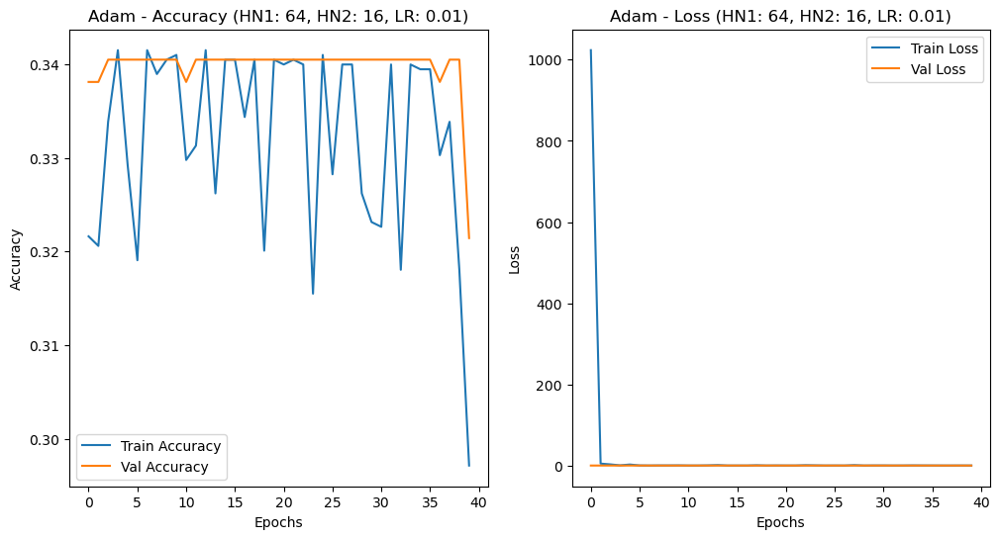

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3590 - loss: 5066.4326 - val_accuracy: 0.3381 - val_loss: 22.8411
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3282 - loss: 1030.9149 - val_accuracy: 0.3405 - val_loss: 1.3920
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3399 - loss: 525.0214 - val_accuracy: 0.3214 - val_loss: 1.0994
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3335 - loss: 359.9751 - val_accuracy: 0.3214 - val_loss: 1.1004
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3360 - loss: 271.6058 - val_accuracy: 0.3214 - val_loss: 1.1004
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3543 - loss: 166.9939 - val_accuracy: 0.3214 - val_loss: 1.1004
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 51ms/step - accuracy: 0.3301 - loss: 181.9358 - val_accuracy: 0.3214 - val_loss: 1.1004
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 52ms/step - accuracy: 0.3506 - loss: 126.6685 - val_a

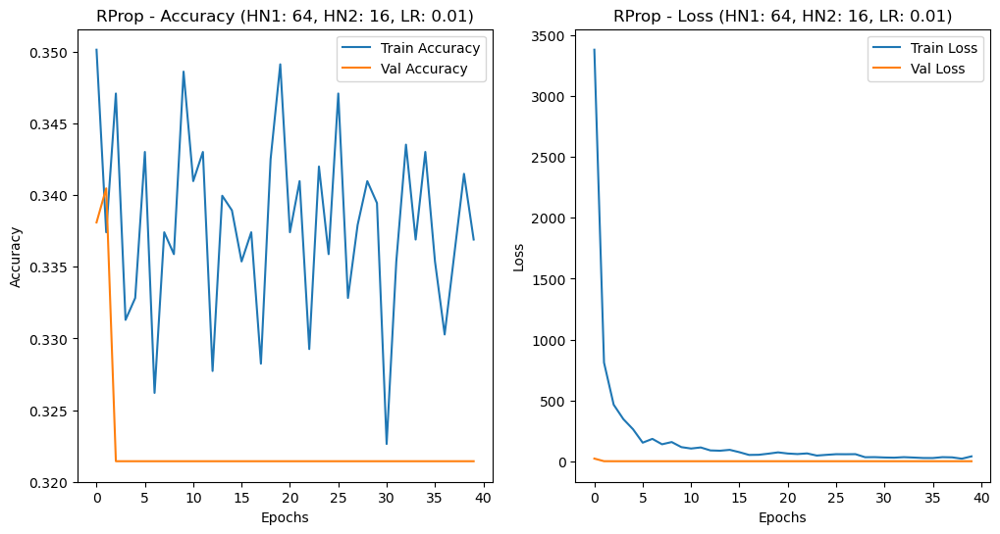

Adam Model - Test Loss: 1.0989, Test Accuracy: 0.3397
RProp Model - Test Loss: 1.0999, Test Accuracy: 0.3397
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
Hybrid Model - Test Accuracy: 0.3397

[INFO] Training models with HN1: 64, HN2: 16, LR: 0.1
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 71ms/step - accuracy: 0.3198 - loss: 2430.5183 - val_accuracy: 0.3381 - val_loss: 1.1002
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 72ms/step - accuracy: 0.3215 - loss: 26.5807 - val_accuracy: 0.3381 - val_loss: 1.0985
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3355 - loss: 1.0999 - val_accuracy: 0.3405 - val_loss: 1.0985
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - accuracy: 0.3483 - loss: 2.0290 - val_accuracy: 0.3381 - val_loss: 1.1061
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3322 - loss: 1.1008 - val_accuracy: 0.3381 - val_loss: 1.0995
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3362 - loss: 2.67

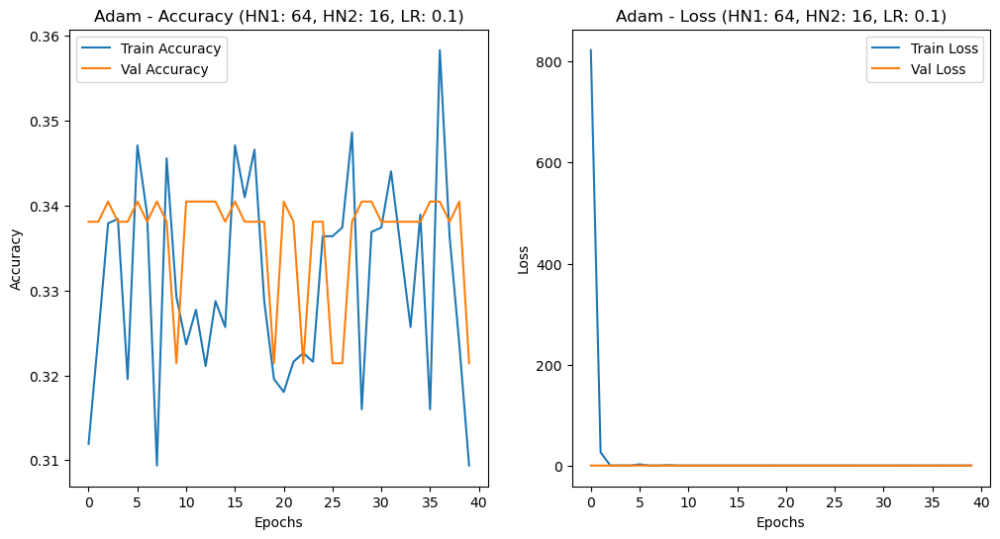

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3248 - loss: 1969.4667 - val_accuracy: 0.3381 - val_loss: 1.0991
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3422 - loss: 16.3906 - val_accuracy: 0.3381 - val_loss: 1.0991
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3466 - loss: 17.1501 - val_accuracy: 0.3381 - val_loss: 1.0991
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3526 - loss: 5.6970 - val_accuracy: 0.3381 - val_loss: 1.0991
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3336 - loss: 5.3575 - val_accuracy: 0.3381 - val_loss: 1.0991
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3291 - loss: 2.8015 - val_accuracy: 0.3381 - val_loss: 1.0991
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3358 - loss: 3.0307 - val_accuracy: 0.3381 - val_loss: 1.0991
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3525 - loss: 3.7811 - val_accuracy: 0.338

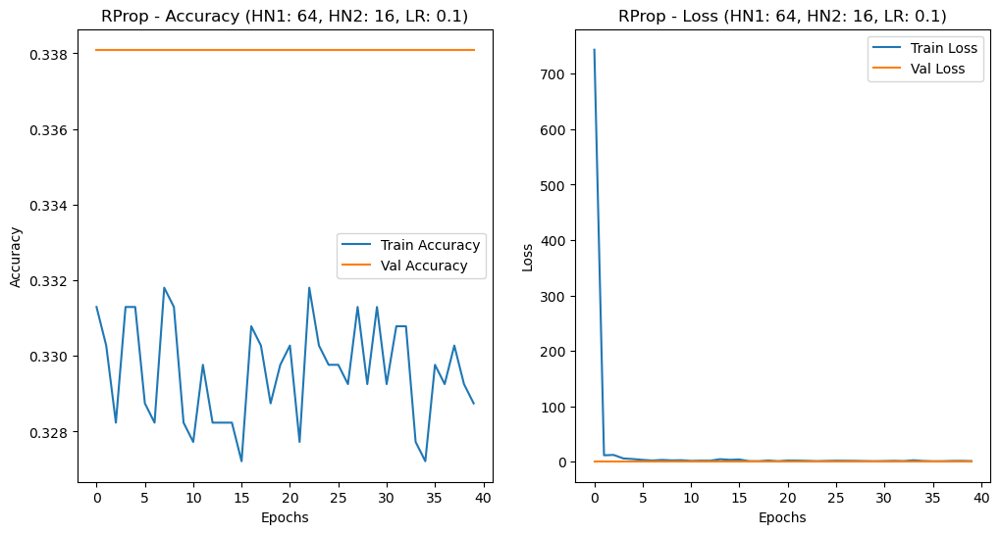

Adam Model - Test Loss: 1.0999, Test Accuracy: 0.3397
RProp Model - Test Loss: 1.0980, Test Accuracy: 0.3444
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
Hybrid Model - Test Accuracy: 0.3397

[INFO] Training models with HN1: 64, HN2: 32, LR: 0.0001
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3166 - loss: 8144.0171 - val_accuracy: 0.3214 - val_loss: 4925.6621
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3282 - loss: 7638.3418 - val_accuracy: 0.3214 - val_loss: 3495.4404
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3466 - loss: 6482.8198 - val_accuracy: 0.3214 - val_loss: 2371.5378
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3085 - loss: 6514.2383 - val_accuracy: 0.3214 - val_loss: 1651.5901
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 77ms/step - accuracy: 0.3229 - loss: 5956.4941 - val_accuracy: 0.3214 - val_loss: 1169.7203
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 71ms/step - 

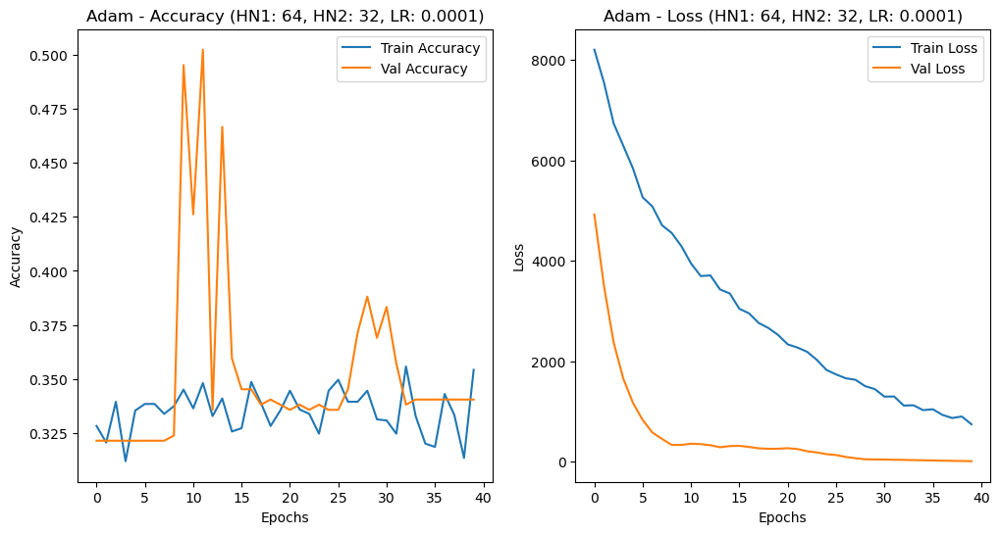

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3395 - loss: 7001.7119 - val_accuracy: 0.3405 - val_loss: 1998.5399
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3535 - loss: 6034.5693 - val_accuracy: 0.3667 - val_loss: 283.0243
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3342 - loss: 4103.9795 - val_accuracy: 0.4738 - val_loss: 338.7515
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3351 - loss: 3460.3130 - val_accuracy: 0.4571 - val_loss: 177.4962
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3443 - loss: 3287.7314 - val_accuracy: 0.4143 - val_loss: 111.4049
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3295 - loss: 3020.1589 - val_accuracy: 0.2571 - val_loss: 80.9089
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3489 - loss: 2753.8345 - val_accuracy: 0.3500 - val_loss: 125.2569
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3285 - loss

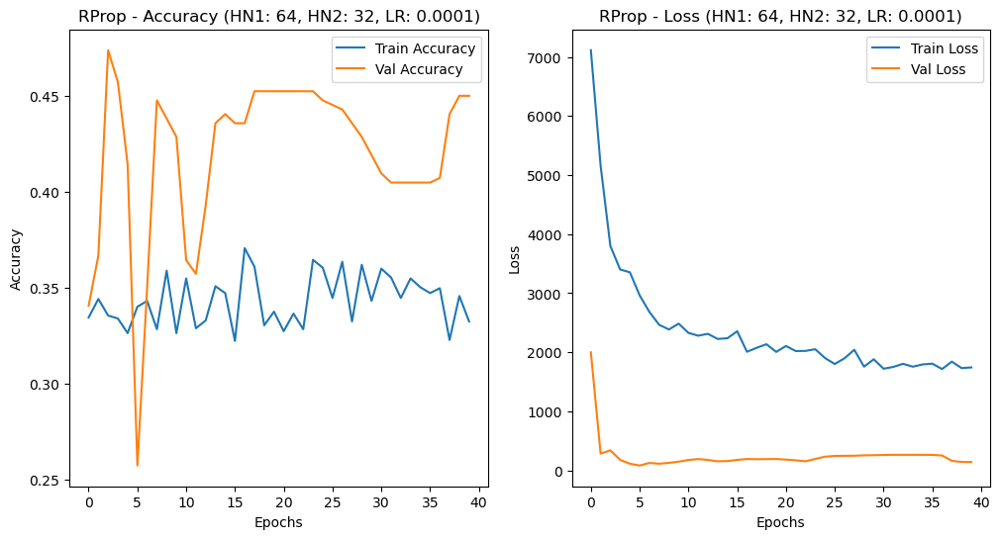

Adam Model - Test Loss: 10.4511, Test Accuracy: 0.3159
RProp Model - Test Loss: 132.7990, Test Accuracy: 0.4679
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
Hybrid Model - Test Accuracy: 0.4751

[INFO] Training models with HN1: 64, HN2: 32, LR: 0.001
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3471 - loss: 3786.2937 - val_accuracy: 0.3548 - val_loss: 181.8630
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3454 - loss: 2145.1318 - val_accuracy: 0.3381 - val_loss: 7.3123
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3420 - loss: 1054.2516 - val_accuracy: 0.3214 - val_loss: 1.1016
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3440 - loss: 467.8332 - val_accuracy: 0.3214 - val_loss: 1.1023
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3469 - loss: 295.0905 - val_accuracy: 0.3214 - val_loss: 1.1032
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3

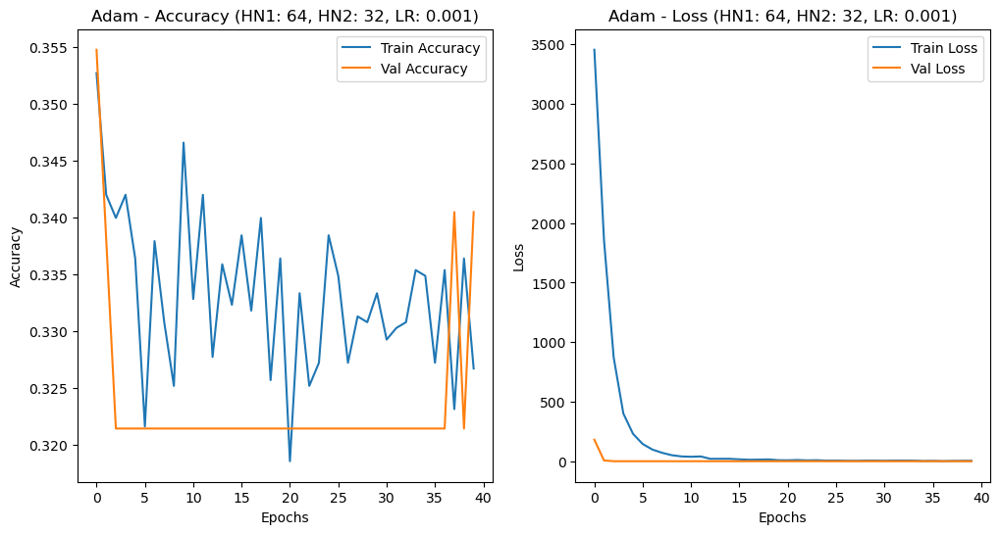

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3622 - loss: 8191.0537 - val_accuracy: 0.3381 - val_loss: 723.8529
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3227 - loss: 2332.3853 - val_accuracy: 0.3595 - val_loss: 143.8587
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3446 - loss: 1617.1957 - val_accuracy: 0.5357 - val_loss: 55.4738
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3362 - loss: 1414.0356 - val_accuracy: 0.4357 - val_loss: 52.1695
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3434 - loss: 1349.6038 - val_accuracy: 0.4167 - val_loss: 106.6231
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3370 - loss: 1174.9210 - val_accuracy: 0.3429 - val_loss: 135.0494
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3365 - loss: 1156.5724 - val_accuracy: 0.4214 - val_loss: 158.5619
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3400 - loss: 

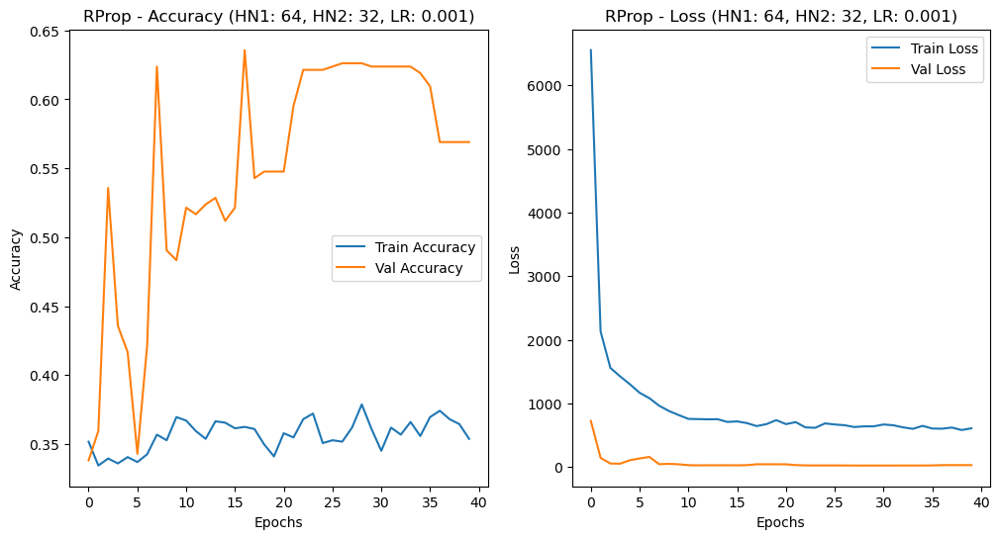

Adam Model - Test Loss: 1.0994, Test Accuracy: 0.3159
RProp Model - Test Loss: 31.4972, Test Accuracy: 0.5653
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
Hybrid Model - Test Accuracy: 0.5653

[INFO] Training models with HN1: 64, HN2: 32, LR: 0.01
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3278 - loss: 2842.9758 - val_accuracy: 0.3214 - val_loss: 1.1011
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3298 - loss: 6.8563 - val_accuracy: 0.3405 - val_loss: 1.1002
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 71ms/step - accuracy: 0.3528 - loss: 4.9444 - val_accuracy: 0.3405 - val_loss: 1.0992
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3508 - loss: 2.1215 - val_accuracy: 0.3381 - val_loss: 1.0985
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3415 - loss: 2.9177 - val_accuracy: 0.3405 - val_loss: 1.0988
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3518 - loss: 1.5

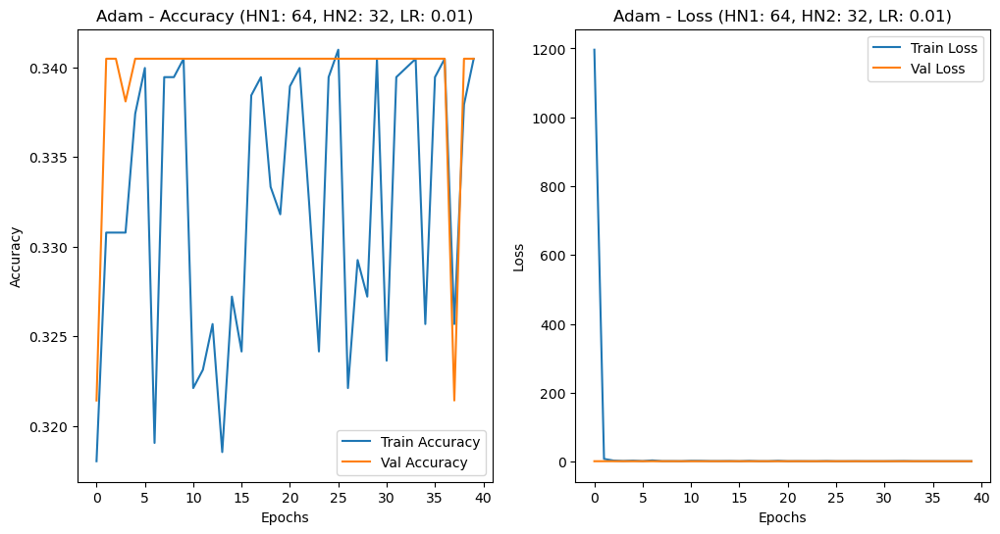

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3274 - loss: 5890.3477 - val_accuracy: 0.3405 - val_loss: 430.7146
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 47ms/step - accuracy: 0.3515 - loss: 1570.7532 - val_accuracy: 0.3333 - val_loss: 46.2622
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3186 - loss: 1287.9011 - val_accuracy: 0.3381 - val_loss: 36.8430
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3257 - loss: 1042.3903 - val_accuracy: 0.3381 - val_loss: 32.1843
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3359 - loss: 952.5502 - val_accuracy: 0.3429 - val_loss: 22.9207
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3314 - loss: 925.5701 - val_accuracy: 0.3429 - val_loss: 20.3774
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3383 - loss: 765.3970 - val_accuracy: 0.3429 - val_loss: 28.9991
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3596 - loss: 768.218

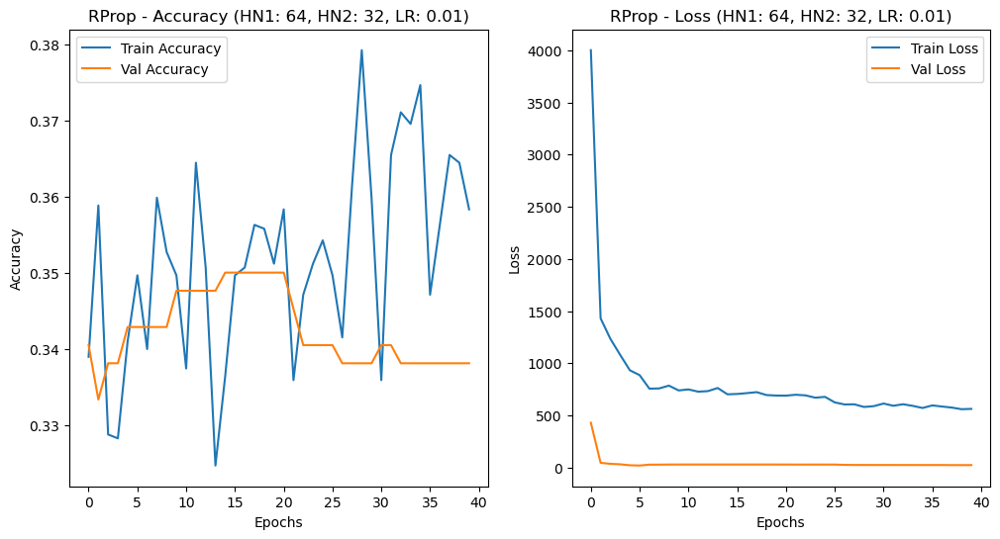

Adam Model - Test Loss: 1.0994, Test Accuracy: 0.3159
RProp Model - Test Loss: 26.2882, Test Accuracy: 0.3444
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
Hybrid Model - Test Accuracy: 0.3444

[INFO] Training models with HN1: 64, HN2: 32, LR: 0.1
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3204 - loss: 6591.7261 - val_accuracy: 0.3405 - val_loss: 1.1006
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3494 - loss: 1.0993 - val_accuracy: 0.3381 - val_loss: 1.1001
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3495 - loss: 1.1010 - val_accuracy: 0.3381 - val_loss: 1.0994
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3271 - loss: 1.1017 - val_accuracy: 0.3405 - val_loss: 1.1026
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3307 - loss: 1.1034 - val_accuracy: 0.3381 - val_loss: 1.0986
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3249 - loss: 1.10

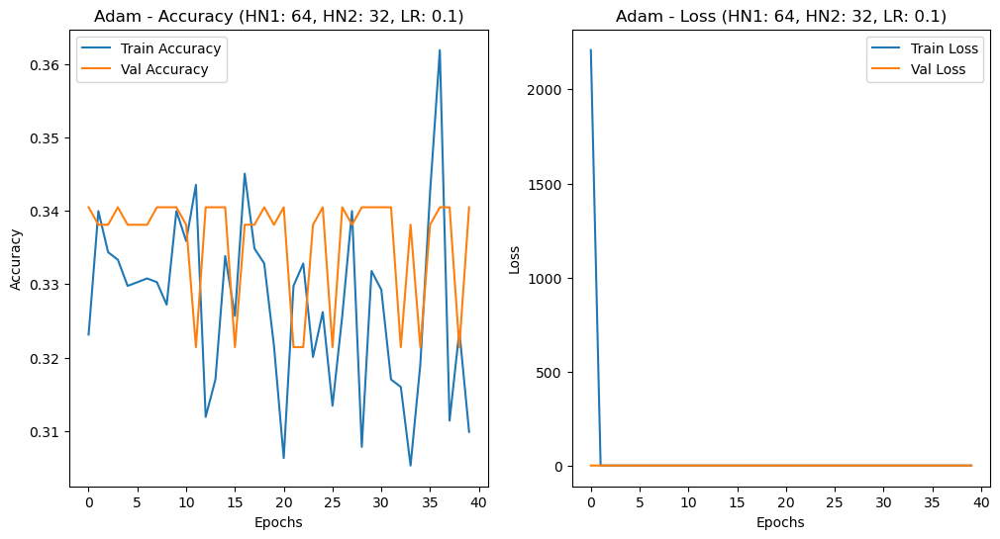

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3595 - loss: 3167.9443 - val_accuracy: 0.3881 - val_loss: 24.8523
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3284 - loss: 405.6190 - val_accuracy: 0.3690 - val_loss: 1.1883
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3343 - loss: 194.6149 - val_accuracy: 0.3619 - val_loss: 1.1096
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3406 - loss: 168.0007 - val_accuracy: 0.3381 - val_loss: 1.0993
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3343 - loss: 159.4173 - val_accuracy: 0.3381 - val_loss: 1.0994
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3142 - loss: 110.9434 - val_accuracy: 0.3381 - val_loss: 1.0993
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3637 - loss: 105.7744 - val_accuracy: 0.3381 - val_loss: 1.0993
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 40ms/step - accuracy: 0.3352 - loss: 81.6141 - val_acc

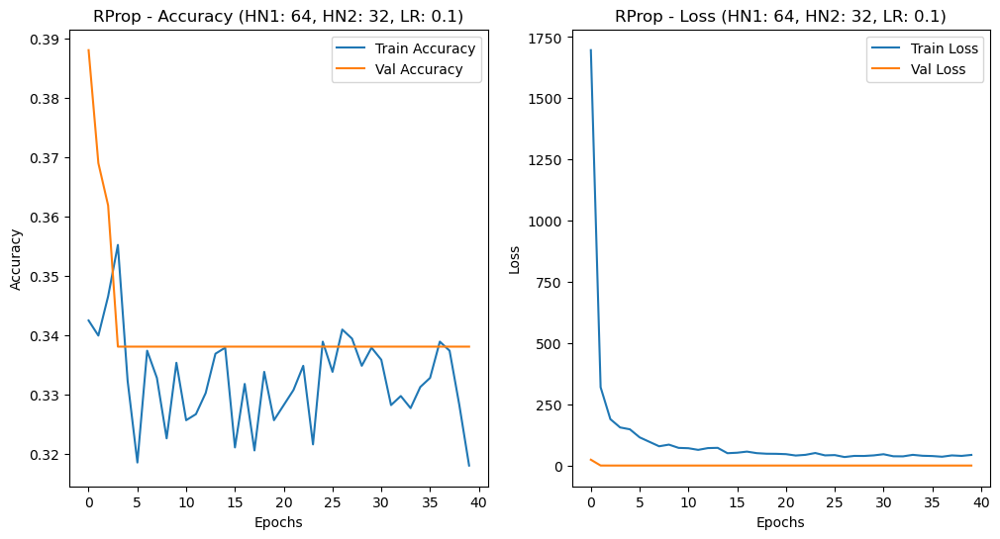

Adam Model - Test Loss: 1.1078, Test Accuracy: 0.3159
RProp Model - Test Loss: 1.0987, Test Accuracy: 0.3444
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
Hybrid Model - Test Accuracy: 0.3159

[INFO] Training models with HN1: 64, HN2: 64, LR: 0.0001
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 4s 118ms/step - accuracy: 0.3420 - loss: 8677.8096 - val_accuracy: 0.3214 - val_loss: 2596.1018
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 94ms/step - accuracy: 0.3430 - loss: 7014.4058 - val_accuracy: 0.3214 - val_loss: 1202.5707
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3245 - loss: 6561.2422 - val_accuracy: 0.3405 - val_loss: 197.1063
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3406 - loss: 6069.3960 - val_accuracy: 0.3381 - val_loss: 475.7926
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3510 - loss: 5528.2036 - val_accuracy: 0.3524 - val_loss: 763.5898
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - ac

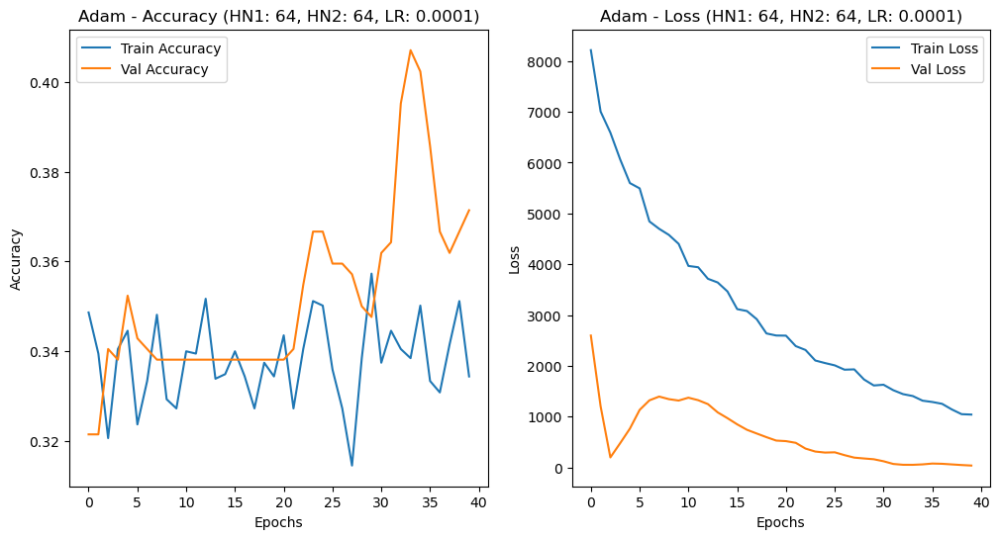

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3058 - loss: 6655.1250 - val_accuracy: 0.3190 - val_loss: 1924.0518
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3284 - loss: 5927.8369 - val_accuracy: 0.2095 - val_loss: 385.7744
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3364 - loss: 5008.6323 - val_accuracy: 0.3405 - val_loss: 798.1423
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.2988 - loss: 4605.2329 - val_accuracy: 0.3405 - val_loss: 795.6459
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3398 - loss: 4191.6294 - val_accuracy: 0.3405 - val_loss: 731.8539
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3126 - loss: 4398.6060 - val_accuracy: 0.3405 - val_loss: 660.9664
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3288 - loss: 4123.5044 - val_accuracy: 0.3405 - val_loss: 548.3378
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3101 - los

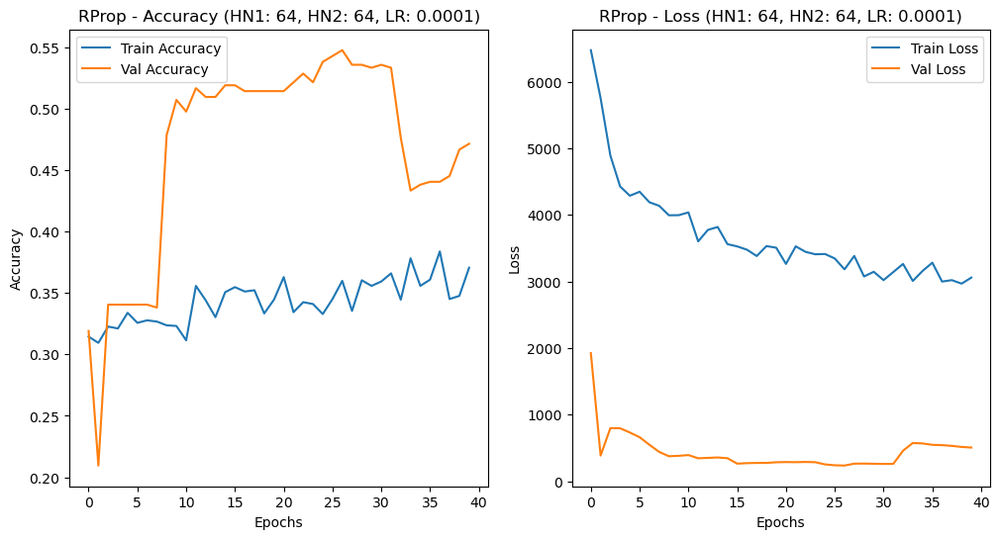

Adam Model - Test Loss: 39.5237, Test Accuracy: 0.3302
RProp Model - Test Loss: 581.4152, Test Accuracy: 0.4608
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
Hybrid Model - Test Accuracy: 0.4584

[INFO] Training models with HN1: 64, HN2: 64, LR: 0.001
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3488 - loss: 5507.6055 - val_accuracy: 0.3381 - val_loss: 925.7470
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3448 - loss: 2837.4238 - val_accuracy: 0.3405 - val_loss: 896.6693
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3501 - loss: 1849.1157 - val_accuracy: 0.3405 - val_loss: 176.4901
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3394 - loss: 1154.6719 - val_accuracy: 0.3500 - val_loss: 106.5671
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3582 - loss: 758.8982 - val_accuracy: 0.4714 - val_loss: 5.6148
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accura

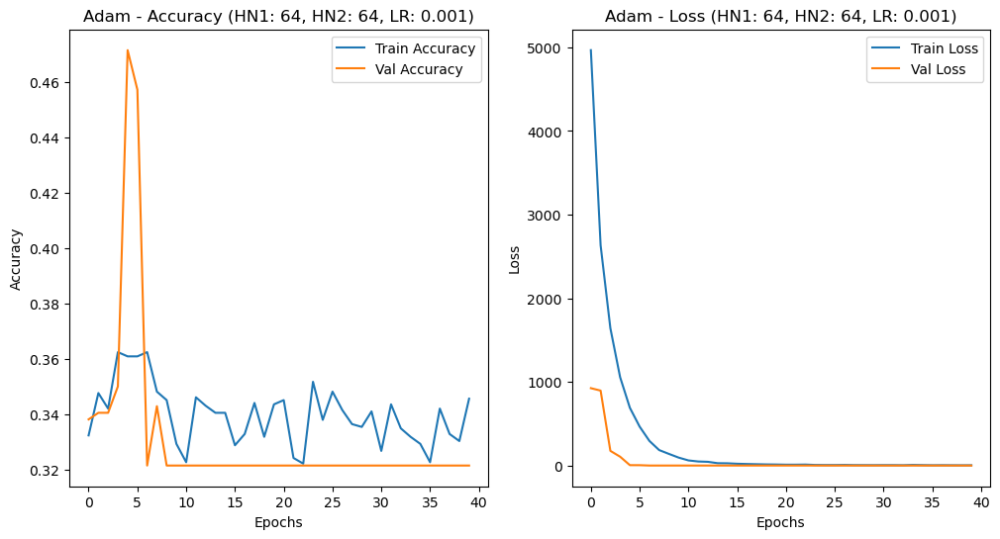

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3394 - loss: 5778.4014 - val_accuracy: 0.3381 - val_loss: 1666.9714
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3346 - loss: 4612.9077 - val_accuracy: 0.3976 - val_loss: 1003.5569
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3583 - loss: 3825.0957 - val_accuracy: 0.4786 - val_loss: 316.3513
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3575 - loss: 2740.2761 - val_accuracy: 0.5548 - val_loss: 338.4919
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3812 - loss: 2508.3528 - val_accuracy: 0.5762 - val_loss: 330.7495
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3616 - loss: 2572.0198 - val_accuracy: 0.4571 - val_loss: 379.7429
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3646 - loss: 2339.8469 - val_accuracy: 0.4929 - val_loss: 318.6554
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3590 - lo

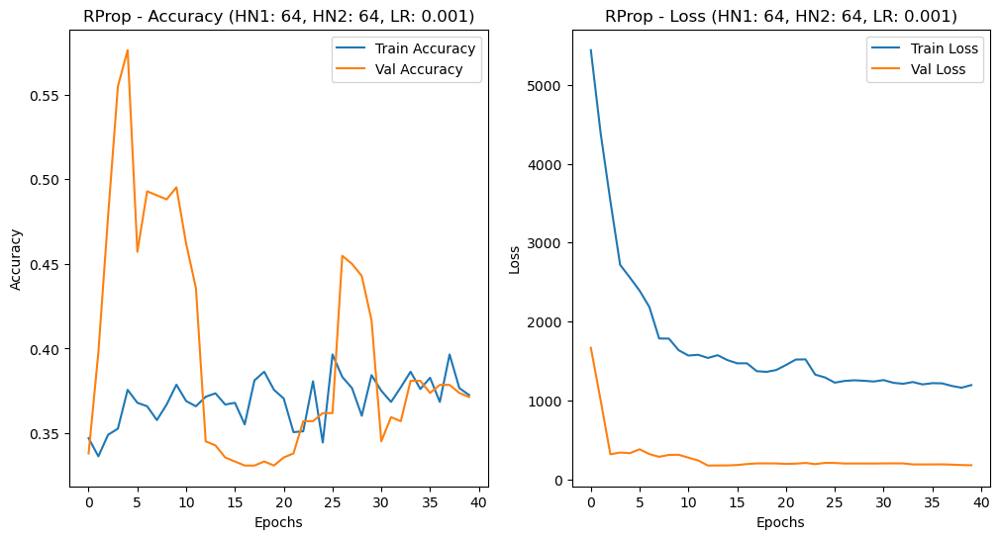

Adam Model - Test Loss: 1.0992, Test Accuracy: 0.3397
RProp Model - Test Loss: 178.9860, Test Accuracy: 0.3682
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
Hybrid Model - Test Accuracy: 0.3682

[INFO] Training models with HN1: 64, HN2: 64, LR: 0.01
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3371 - loss: 2351.5227 - val_accuracy: 0.3405 - val_loss: 3.3404
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3344 - loss: 19.9413 - val_accuracy: 0.3405 - val_loss: 1.0958
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3463 - loss: 6.4411 - val_accuracy: 0.3405 - val_loss: 1.0984
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3499 - loss: 2.2788 - val_accuracy: 0.3381 - val_loss: 1.0986
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3604 - loss: 2.4957 - val_accuracy: 0.3381 - val_loss: 1.0985
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3302 - loss: 2

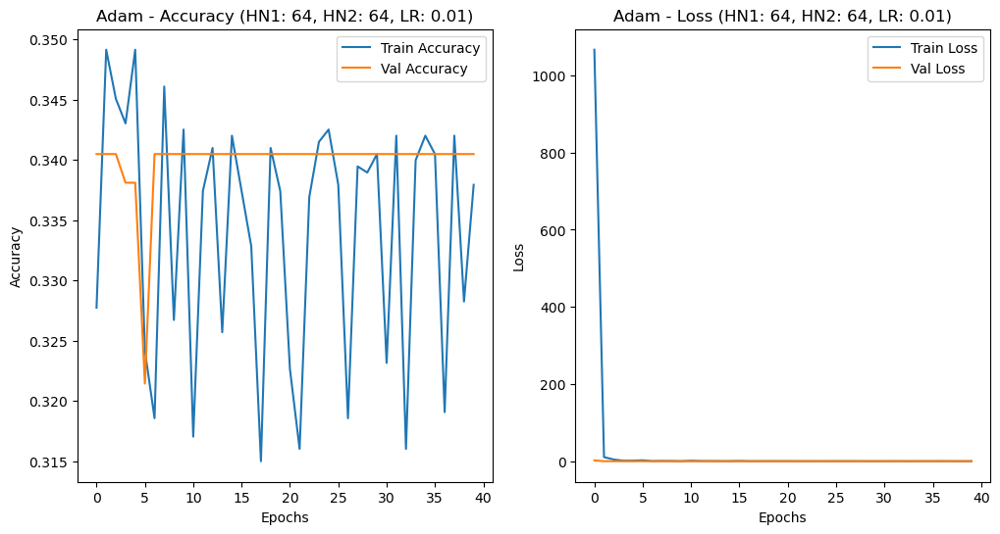

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3569 - loss: 6522.0264 - val_accuracy: 0.5000 - val_loss: 797.1472
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3135 - loss: 3111.8015 - val_accuracy: 0.4905 - val_loss: 343.3124
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 55ms/step - accuracy: 0.3755 - loss: 2445.6738 - val_accuracy: 0.4881 - val_loss: 335.2775
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3693 - loss: 2210.0229 - val_accuracy: 0.4881 - val_loss: 352.7661
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3525 - loss: 2355.8025 - val_accuracy: 0.4881 - val_loss: 362.7340
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3809 - loss: 2190.2388 - val_accuracy: 0.4881 - val_loss: 362.0764
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3700 - loss: 2228.3770 - val_accuracy: 0.4881 - val_loss: 350.6935
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3918 - loss

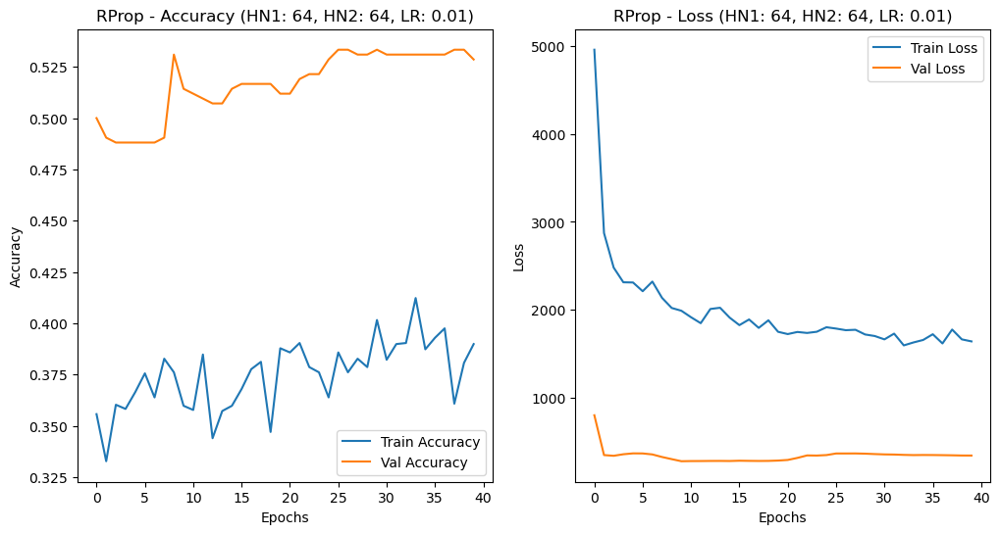

Adam Model - Test Loss: 1.0997, Test Accuracy: 0.3159
RProp Model - Test Loss: 343.9470, Test Accuracy: 0.4893
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
Hybrid Model - Test Accuracy: 0.4893

[INFO] Training models with HN1: 64, HN2: 64, LR: 0.1
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3557 - loss: 4828.2944 - val_accuracy: 0.3405 - val_loss: 1.0984
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3376 - loss: 1.1012 - val_accuracy: 0.3405 - val_loss: 1.0988
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3228 - loss: 1.0994 - val_accuracy: 0.3214 - val_loss: 1.1019
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3021 - loss: 1.1040 - val_accuracy: 0.3381 - val_loss: 1.1005
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3354 - loss: 1.1013 - val_accuracy: 0.3214 - val_loss: 1.1002
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - accuracy: 0.3200 - loss: 1.1

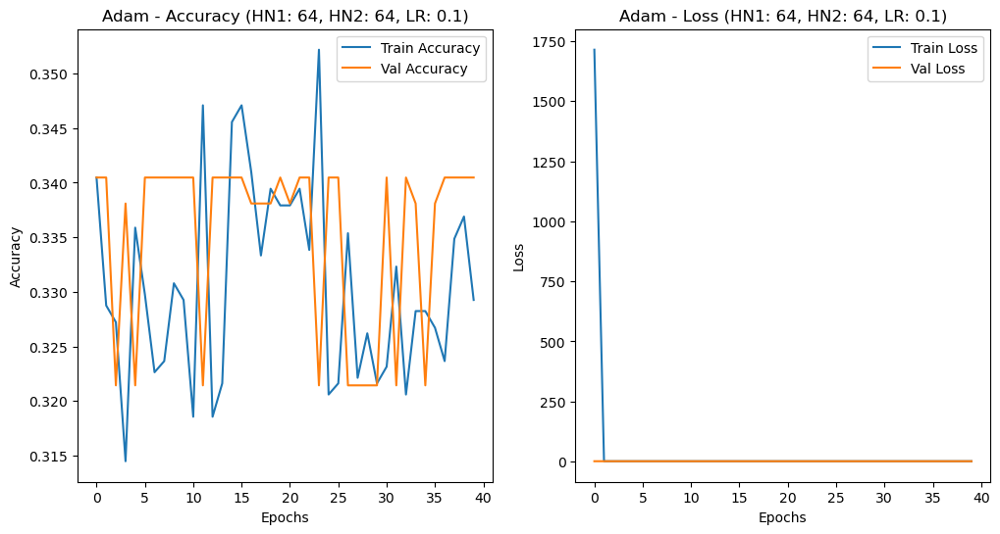

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3465 - loss: 2948.3667 - val_accuracy: 0.3595 - val_loss: 160.2770
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3612 - loss: 800.7703 - val_accuracy: 0.4548 - val_loss: 115.4688
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3744 - loss: 735.5200 - val_accuracy: 0.4238 - val_loss: 138.0539
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3461 - loss: 681.7515 - val_accuracy: 0.4190 - val_loss: 139.0689
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3929 - loss: 730.7495 - val_accuracy: 0.4167 - val_loss: 140.5618
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3334 - loss: 701.7223 - val_accuracy: 0.4238 - val_loss: 129.6563
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3659 - loss: 607.6993 - val_accuracy: 0.4405 - val_loss: 127.8078
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3959 - loss: 612.

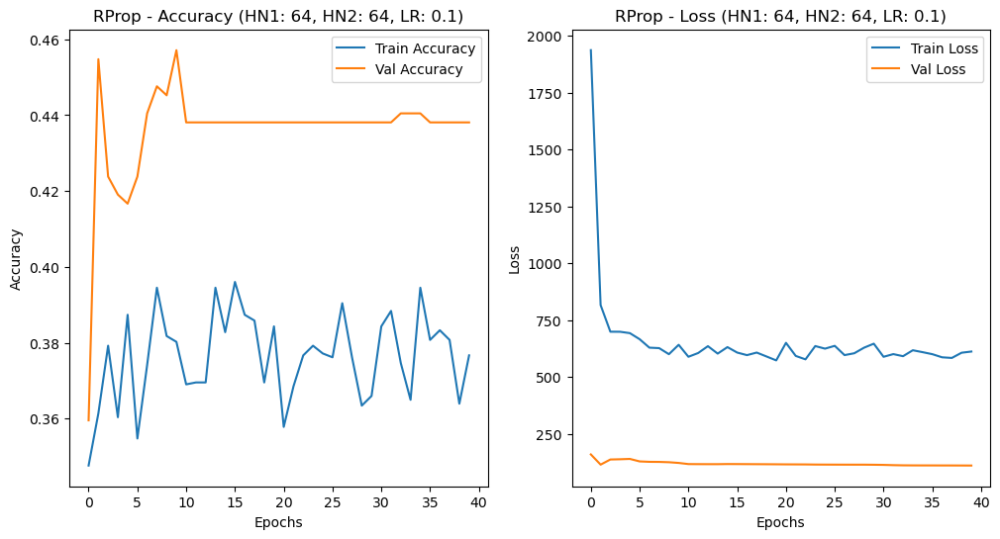

Adam Model - Test Loss: 1.1073, Test Accuracy: 0.3159
RProp Model - Test Loss: 120.1155, Test Accuracy: 0.4489
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
Hybrid Model - Test Accuracy: 0.4489

[INFO] Training models with HN1: 64, HN2: 128, LR: 0.0001
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3034 - loss: 6000.0938 - val_accuracy: 0.3405 - val_loss: 1572.9027
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3292 - loss: 4732.1709 - val_accuracy: 0.3405 - val_loss: 1443.3069
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3162 - loss: 4492.3584 - val_accuracy: 0.3405 - val_loss: 995.1217
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3050 - loss: 4164.0308 - val_accuracy: 0.3405 - val_loss: 829.2820
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3236 - loss: 3998.6414 - val_accuracy: 0.3405 - val_loss: 838.1050
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - 

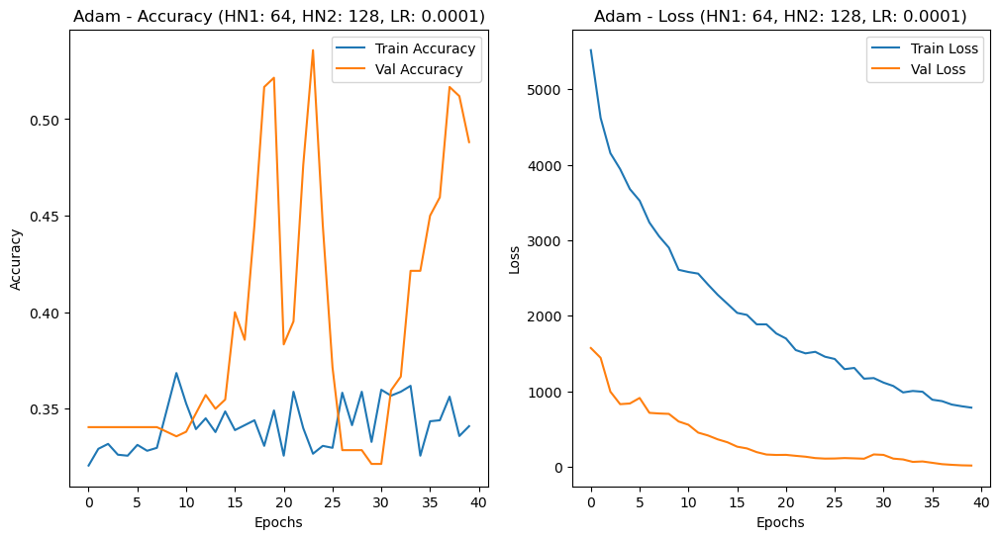

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3426 - loss: 4627.0049 - val_accuracy: 0.3405 - val_loss: 783.8076
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3466 - loss: 3186.5977 - val_accuracy: 0.3214 - val_loss: 850.0560
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3412 - loss: 2774.2800 - val_accuracy: 0.3214 - val_loss: 500.0227
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3430 - loss: 2760.1982 - val_accuracy: 0.3214 - val_loss: 373.1427
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3209 - loss: 2801.3447 - val_accuracy: 0.3214 - val_loss: 352.2106
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3307 - loss: 2511.0264 - val_accuracy: 0.3214 - val_loss: 405.6792
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3468 - loss: 2381.9136 - val_accuracy: 0.3214 - val_loss: 417.1224
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3361 - loss

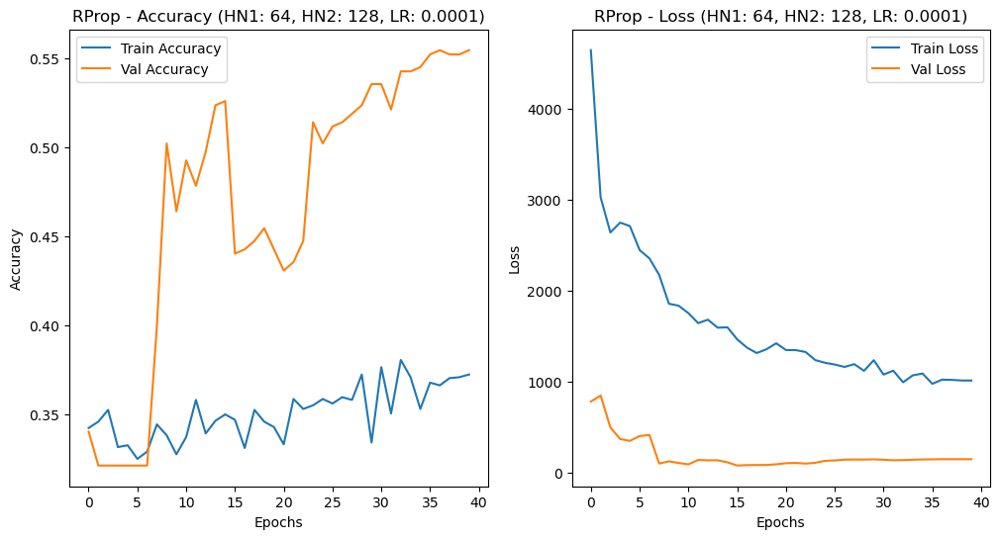

Adam Model - Test Loss: 18.3701, Test Accuracy: 0.4893
RProp Model - Test Loss: 150.1498, Test Accuracy: 0.5107
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
Hybrid Model - Test Accuracy: 0.5059

[INFO] Training models with HN1: 64, HN2: 128, LR: 0.001
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3374 - loss: 4058.0234 - val_accuracy: 0.3429 - val_loss: 623.3916
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3473 - loss: 2446.7764 - val_accuracy: 0.4619 - val_loss: 221.5758
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3392 - loss: 1388.9342 - val_accuracy: 0.3857 - val_loss: 161.9205
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3448 - loss: 928.9939 - val_accuracy: 0.5119 - val_loss: 12.1890
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3506 - loss: 595.0060 - val_accuracy: 0.3833 - val_loss: 25.6300
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accura

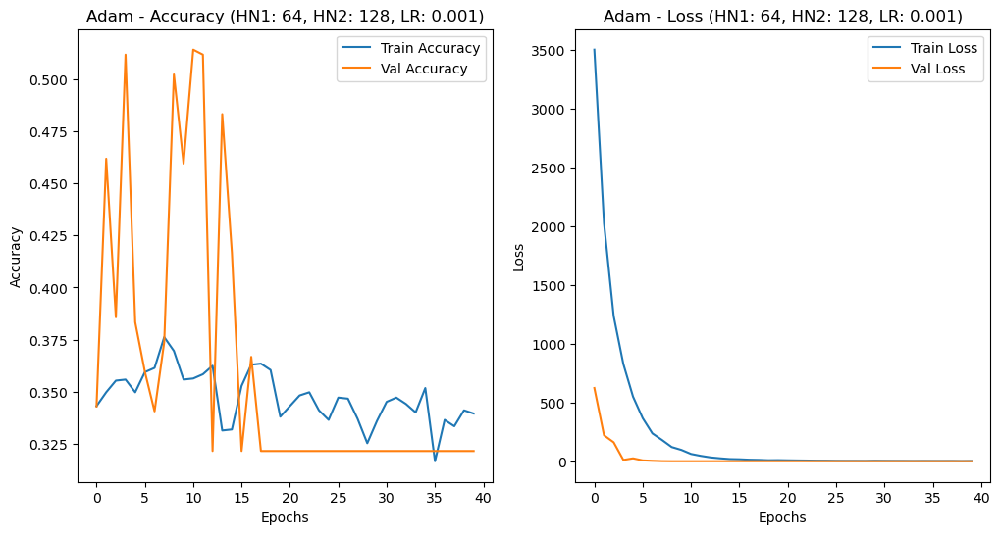

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3416 - loss: 6496.7598 - val_accuracy: 0.3405 - val_loss: 2138.5825
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3319 - loss: 4473.0952 - val_accuracy: 0.3405 - val_loss: 1737.2223
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3122 - loss: 3943.9617 - val_accuracy: 0.3405 - val_loss: 1390.0314
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3564 - loss: 3603.5386 - val_accuracy: 0.3405 - val_loss: 963.2007
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3328 - loss: 3729.4441 - val_accuracy: 0.3476 - val_loss: 883.7525
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3354 - loss: 3674.0176 - val_accuracy: 0.3071 - val_loss: 888.1949
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 50ms/step - accuracy: 0.3517 - loss: 3549.8818 - val_accuracy: 0.3405 - val_loss: 863.0284
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3635 - l

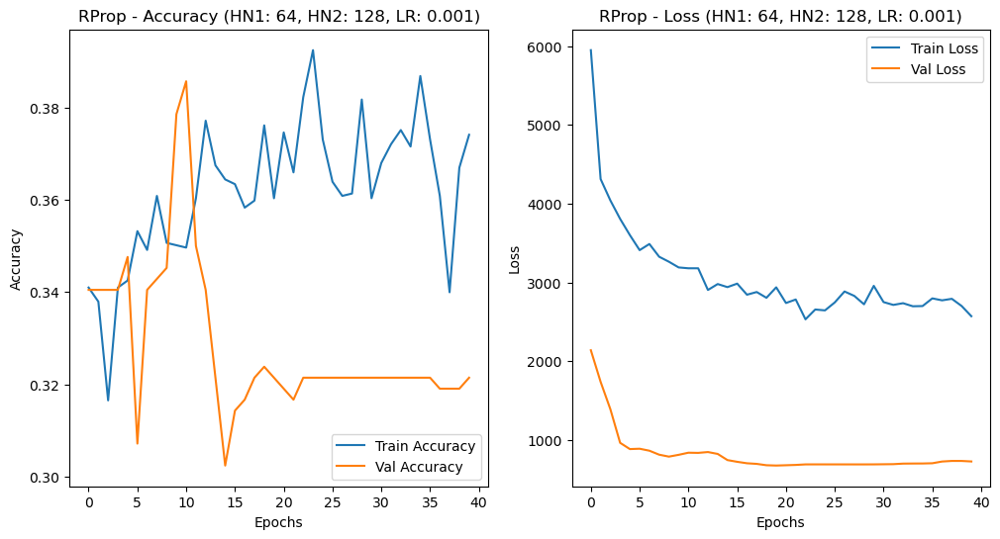

Adam Model - Test Loss: 1.0996, Test Accuracy: 0.3397
RProp Model - Test Loss: 813.9740, Test Accuracy: 0.2922
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
Hybrid Model - Test Accuracy: 0.2922

[INFO] Training models with HN1: 64, HN2: 128, LR: 0.01
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3396 - loss: 2545.7222 - val_accuracy: 0.5738 - val_loss: 7.8545
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3995 - loss: 20.6160 - val_accuracy: 0.3429 - val_loss: 1.0971
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3427 - loss: 1.0986 - val_accuracy: 0.3405 - val_loss: 1.0984
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3352 - loss: 1.0981 - val_accuracy: 0.3405 - val_loss: 1.0984
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3305 - loss: 1.0994 - val_accuracy: 0.3405 - val_loss: 1.0985
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3373 - loss: 

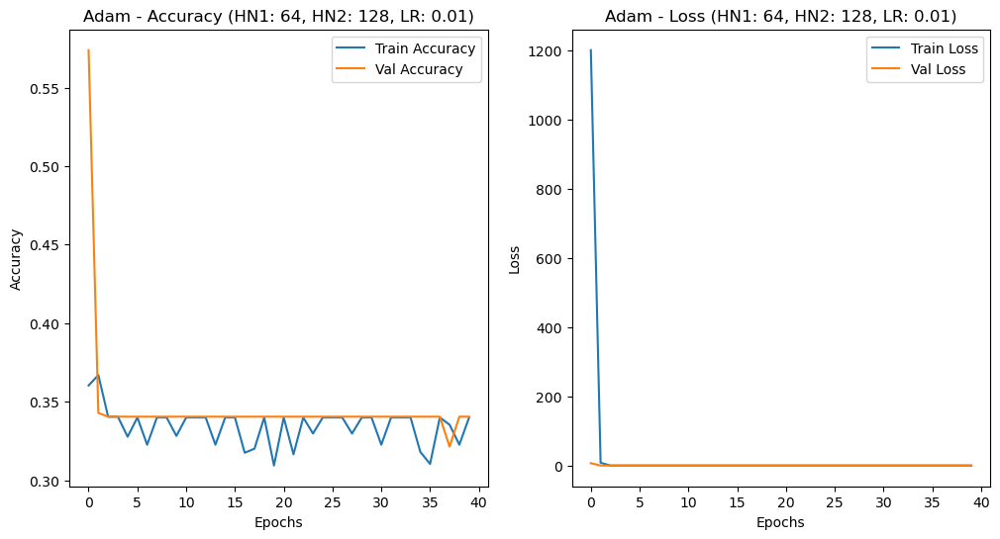

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3273 - loss: 4877.5024 - val_accuracy: 0.3405 - val_loss: 596.9500
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3333 - loss: 1714.4347 - val_accuracy: 0.4786 - val_loss: 73.9535
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3461 - loss: 1186.2922 - val_accuracy: 0.3405 - val_loss: 214.2496
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3716 - loss: 1019.0717 - val_accuracy: 0.3690 - val_loss: 190.6521
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3578 - loss: 967.9124 - val_accuracy: 0.3905 - val_loss: 142.3385
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3788 - loss: 945.2018 - val_accuracy: 0.4929 - val_loss: 117.8044
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3725 - loss: 905.5717 - val_accuracy: 0.5119 - val_loss: 105.9696
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3961 - loss: 88

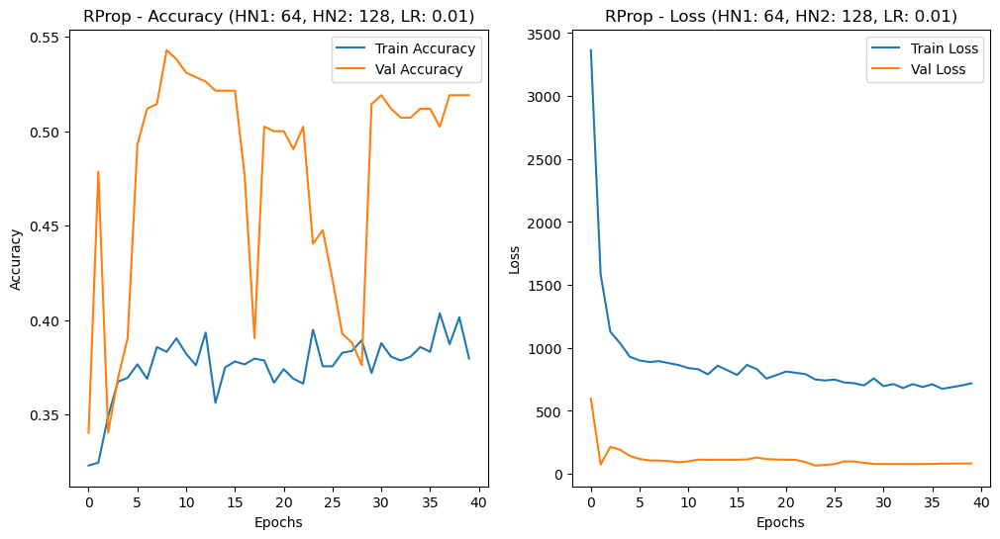

Adam Model - Test Loss: 1.0992, Test Accuracy: 0.3159
RProp Model - Test Loss: 88.6841, Test Accuracy: 0.4964
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
Hybrid Model - Test Accuracy: 0.4964

[INFO] Training models with HN1: 64, HN2: 128, LR: 0.1
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - accuracy: 0.3344 - loss: 6560.3413 - val_accuracy: 0.3405 - val_loss: 1.0992
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3252 - loss: 1.1028 - val_accuracy: 0.3381 - val_loss: 1.1016
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3187 - loss: 1.1066 - val_accuracy: 0.3381 - val_loss: 1.0992
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3295 - loss: 1.1015 - val_accuracy: 0.3405 - val_loss: 1.1011
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 71ms/step - accuracy: 0.3495 - loss: 1.1006 - val_accuracy: 0.3405 - val_loss: 1.1012
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 69ms/step - accuracy: 0.3144 - loss: 1.1

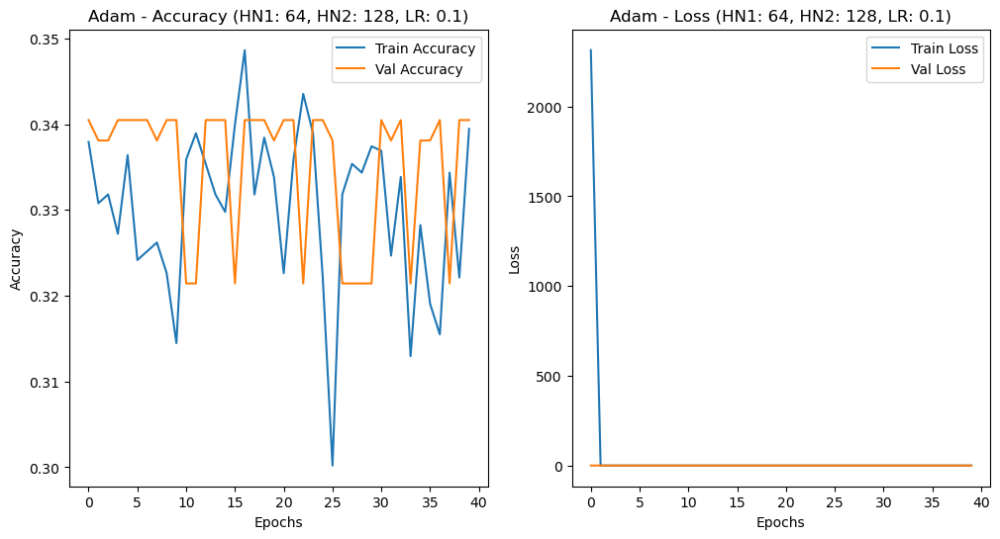

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3495 - loss: 2924.6548 - val_accuracy: 0.5881 - val_loss: 84.0855
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3910 - loss: 501.5958 - val_accuracy: 0.5738 - val_loss: 97.4160
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3694 - loss: 462.5400 - val_accuracy: 0.5214 - val_loss: 115.6942
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.4170 - loss: 463.3600 - val_accuracy: 0.5667 - val_loss: 111.8897
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3926 - loss: 441.7098 - val_accuracy: 0.5833 - val_loss: 106.3536
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.4087 - loss: 393.6562 - val_accuracy: 0.5738 - val_loss: 107.0271
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3891 - loss: 422.9716 - val_accuracy: 0.5714 - val_loss: 108.8244
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.4073 - loss: 411.75

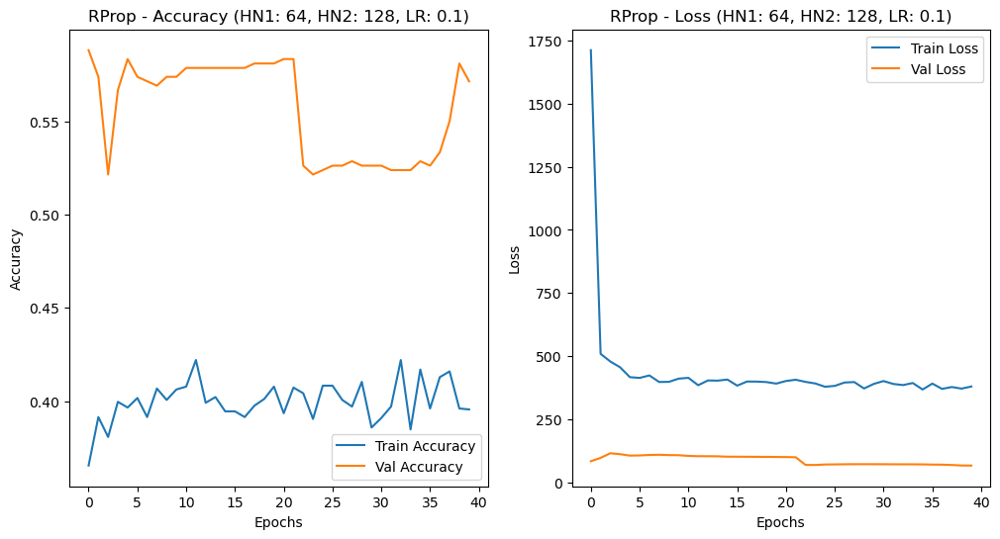

Adam Model - Test Loss: 1.1099, Test Accuracy: 0.3159
RProp Model - Test Loss: 68.5231, Test Accuracy: 0.5819
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
Hybrid Model - Test Accuracy: 0.5819

[INFO] Training models with HN1: 128, HN2: 16, LR: 0.0001
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3415 - loss: 7386.2256 - val_accuracy: 0.3381 - val_loss: 2623.8208
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3142 - loss: 6002.7417 - val_accuracy: 0.3548 - val_loss: 1823.1848
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3517 - loss: 5003.1948 - val_accuracy: 0.3762 - val_loss: 1146.0813
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3676 - loss: 3862.3369 - val_accuracy: 0.5048 - val_loss: 615.8397
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3439 - loss: 3560.1836 - val_accuracy: 0.4762 - val_loss: 311.6255
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - 

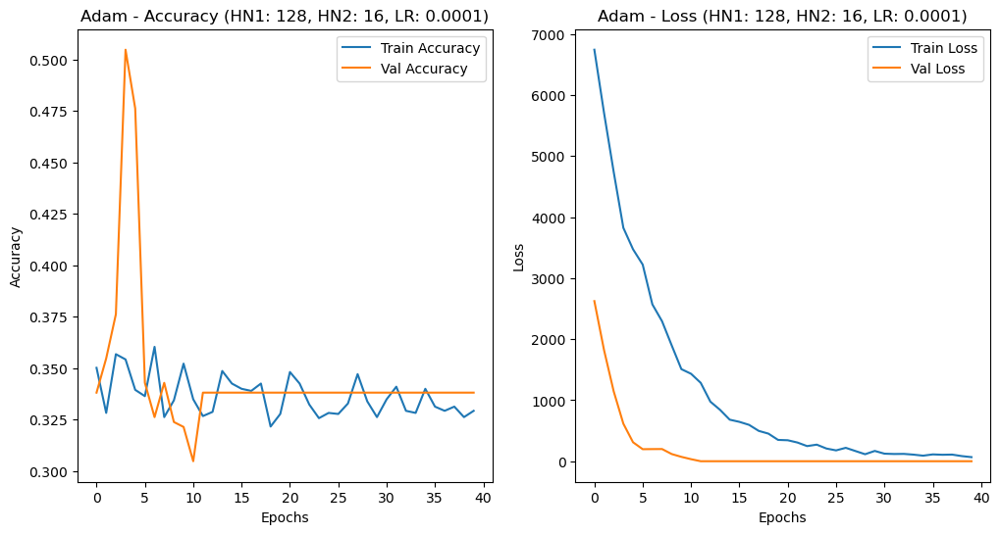

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3395 - loss: 7602.4360 - val_accuracy: 0.3381 - val_loss: 1724.7955
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3349 - loss: 2207.3457 - val_accuracy: 0.3214 - val_loss: 1.0994
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3417 - loss: 503.1769 - val_accuracy: 0.3214 - val_loss: 1.0993
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3095 - loss: 339.9793 - val_accuracy: 0.3214 - val_loss: 1.0993
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3442 - loss: 282.9940 - val_accuracy: 0.3214 - val_loss: 1.0993
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3435 - loss: 182.4731 - val_accuracy: 0.3214 - val_loss: 1.0993
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3623 - loss: 152.9444 - val_accuracy: 0.3214 - val_loss: 1.0993
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3320 - loss: 153.0978 - val

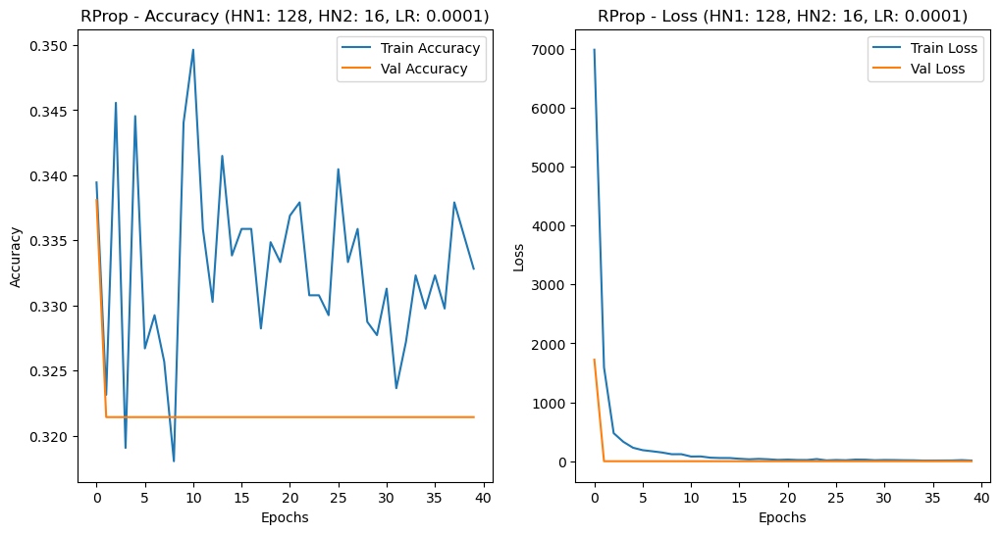

Adam Model - Test Loss: 1.0989, Test Accuracy: 0.3444
RProp Model - Test Loss: 1.0989, Test Accuracy: 0.3397
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
Hybrid Model - Test Accuracy: 0.3444

[INFO] Training models with HN1: 128, HN2: 16, LR: 0.001
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3354 - loss: 3184.3098 - val_accuracy: 0.3405 - val_loss: 277.7908
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3260 - loss: 649.3695 - val_accuracy: 0.3214 - val_loss: 1.0991
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.3401 - loss: 185.5753 - val_accuracy: 0.3214 - val_loss: 1.0996
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3431 - loss: 43.1321 - val_accuracy: 0.3214 - val_loss: 1.1000
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3444 - loss: 30.4321 - val_accuracy: 0.3214 - val_loss: 1.1001
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3406 - 

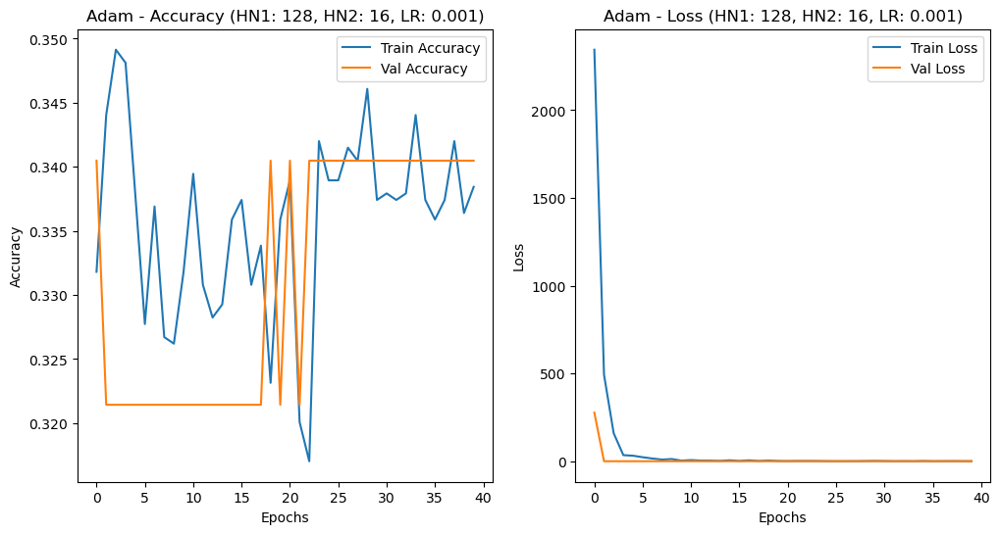

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3262 - loss: 8515.1758 - val_accuracy: 0.3405 - val_loss: 29.2991
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3218 - loss: 973.9047 - val_accuracy: 0.5714 - val_loss: 1.1878
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3347 - loss: 207.7019 - val_accuracy: 0.4571 - val_loss: 1.1232
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3122 - loss: 72.0789 - val_accuracy: 0.3405 - val_loss: 1.0737
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3126 - loss: 61.3625 - val_accuracy: 0.3405 - val_loss: 1.0986
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3213 - loss: 44.7007 - val_accuracy: 0.3405 - val_loss: 1.0986
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.3563 - loss: 21.0385 - val_accuracy: 0.3405 - val_loss: 1.0986
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3376 - loss: 26.5118 - val_accurac

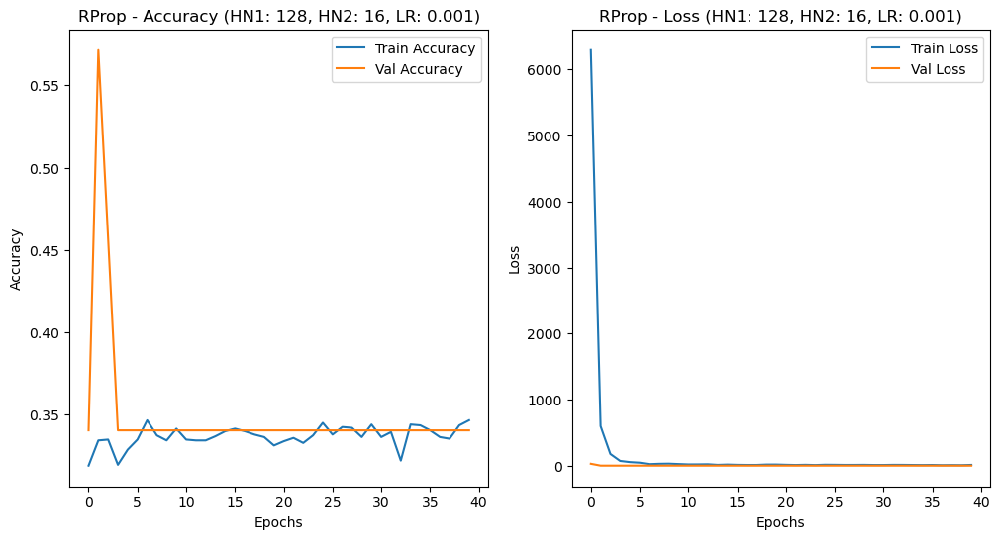

Adam Model - Test Loss: 1.0992, Test Accuracy: 0.3159
RProp Model - Test Loss: 1.0988, Test Accuracy: 0.3159
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
Hybrid Model - Test Accuracy: 0.3159

[INFO] Training models with HN1: 128, HN2: 16, LR: 0.01
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3421 - loss: 1369.5748 - val_accuracy: 0.3214 - val_loss: 1.0992
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3389 - loss: 1.1045 - val_accuracy: 0.3405 - val_loss: 1.0990
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3355 - loss: 2.3733 - val_accuracy: 0.3381 - val_loss: 1.0985
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3495 - loss: 1.0986 - val_accuracy: 0.3405 - val_loss: 1.0984
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3429 - loss: 1.0985 - val_accuracy: 0.3405 - val_loss: 1.0987
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3527 - loss: 1.0

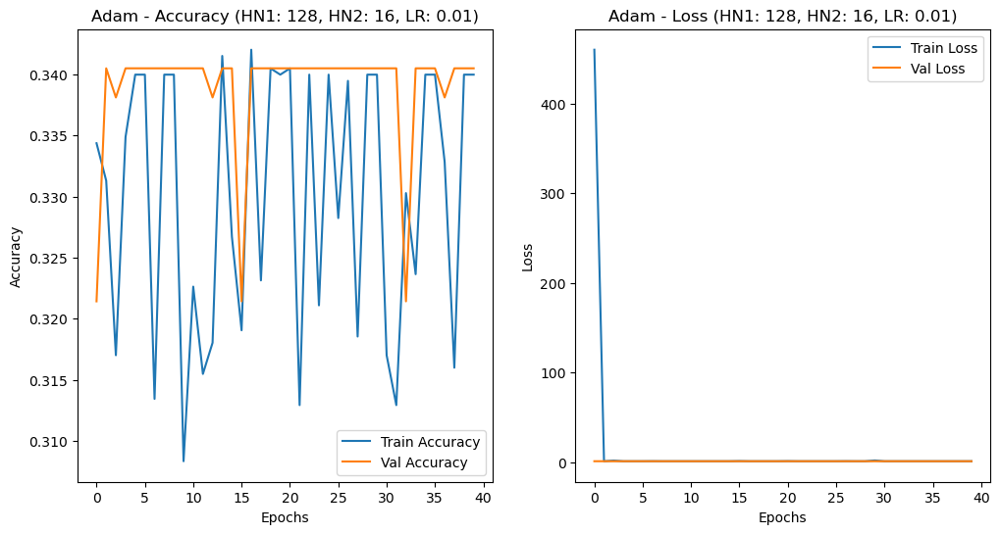

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3383 - loss: 4117.1899 - val_accuracy: 0.3381 - val_loss: 1.0985
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3303 - loss: 318.4709 - val_accuracy: 0.3381 - val_loss: 1.0985
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3201 - loss: 124.7688 - val_accuracy: 0.3381 - val_loss: 1.0985
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3246 - loss: 83.9896 - val_accuracy: 0.3381 - val_loss: 1.0985
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3446 - loss: 57.5442 - val_accuracy: 0.3381 - val_loss: 1.0985
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3193 - loss: 32.4897 - val_accuracy: 0.3381 - val_loss: 1.0985
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3414 - loss: 49.3981 - val_accuracy: 0.3381 - val_loss: 1.0985
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3452 - loss: 23.3563 - val_accuracy

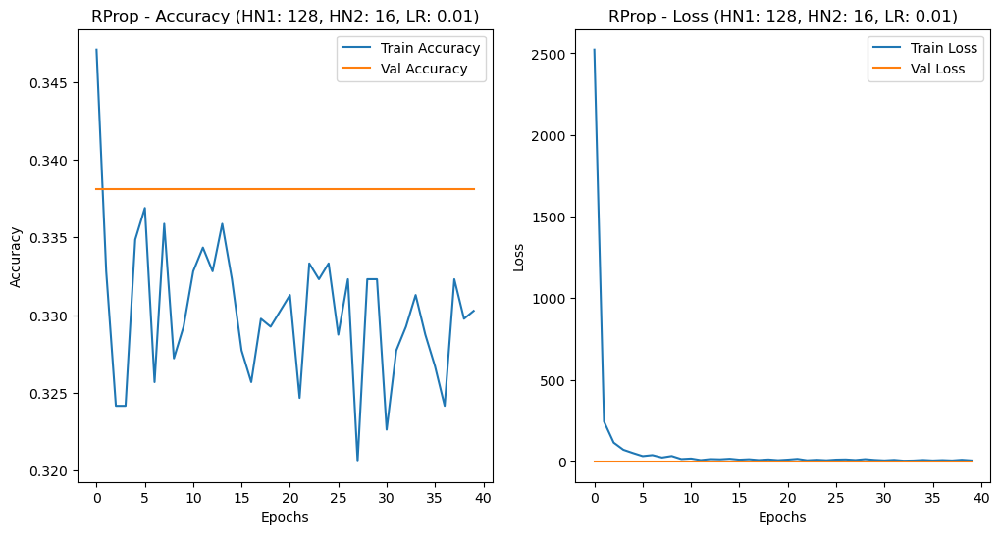

Adam Model - Test Loss: 1.0991, Test Accuracy: 0.3159
RProp Model - Test Loss: 1.0985, Test Accuracy: 0.3444
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
Hybrid Model - Test Accuracy: 0.3159

[INFO] Training models with HN1: 128, HN2: 16, LR: 0.1
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3378 - loss: 2444.9941 - val_accuracy: 0.3214 - val_loss: 1.1079
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3481 - loss: 16.5177 - val_accuracy: 0.3405 - val_loss: 1.0984
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3376 - loss: 13.7667 - val_accuracy: 0.3214 - val_loss: 1.1047
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3241 - loss: 3.0543 - val_accuracy: 0.3405 - val_loss: 1.1085
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3391 - loss: 1.1028 - val_accuracy: 0.3214 - val_loss: 1.1039
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.3260 - loss: 1.

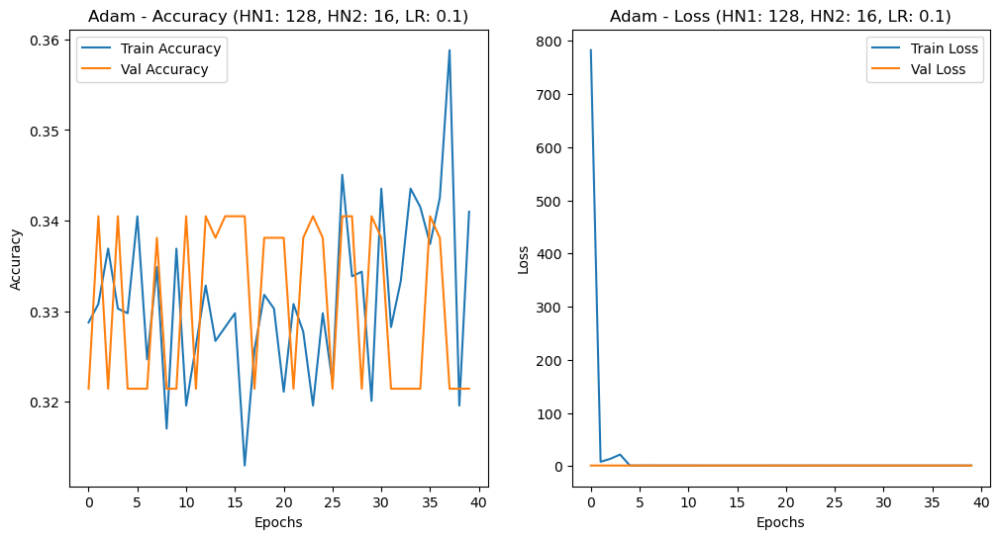

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3185 - loss: 2360.9900 - val_accuracy: 0.3381 - val_loss: 1.0985
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3285 - loss: 5.4626 - val_accuracy: 0.3381 - val_loss: 1.0985
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3192 - loss: 6.0165 - val_accuracy: 0.3381 - val_loss: 1.0985
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3237 - loss: 3.7887 - val_accuracy: 0.3381 - val_loss: 1.0985
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3437 - loss: 1.4314 - val_accuracy: 0.3381 - val_loss: 1.0985
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3217 - loss: 1.4483 - val_accuracy: 0.3381 - val_loss: 1.0985
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3429 - loss: 1.2093 - val_accuracy: 0.3381 - val_loss: 1.0985
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3232 - loss: 1.5526 - val_accuracy: 0.3381 

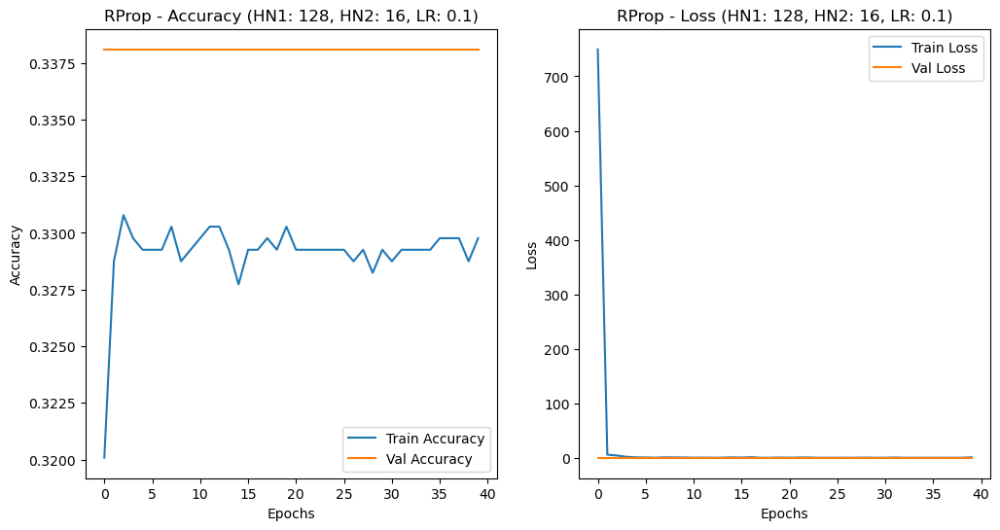

Adam Model - Test Loss: 1.1035, Test Accuracy: 0.3397
RProp Model - Test Loss: 1.0984, Test Accuracy: 0.3444
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
Hybrid Model - Test Accuracy: 0.3397

[INFO] Training models with HN1: 128, HN2: 32, LR: 0.0001
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 70ms/step - accuracy: 0.3302 - loss: 4750.4717 - val_accuracy: 0.3214 - val_loss: 534.6157
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3318 - loss: 3800.1631 - val_accuracy: 0.3381 - val_loss: 172.3845
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - accuracy: 0.3125 - loss: 3625.0498 - val_accuracy: 0.3786 - val_loss: 147.6199
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3525 - loss: 3174.3630 - val_accuracy: 0.3452 - val_loss: 132.6924
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3274 - loss: 2908.3774 - val_accuracy: 0.3667 - val_loss: 288.3911
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accu

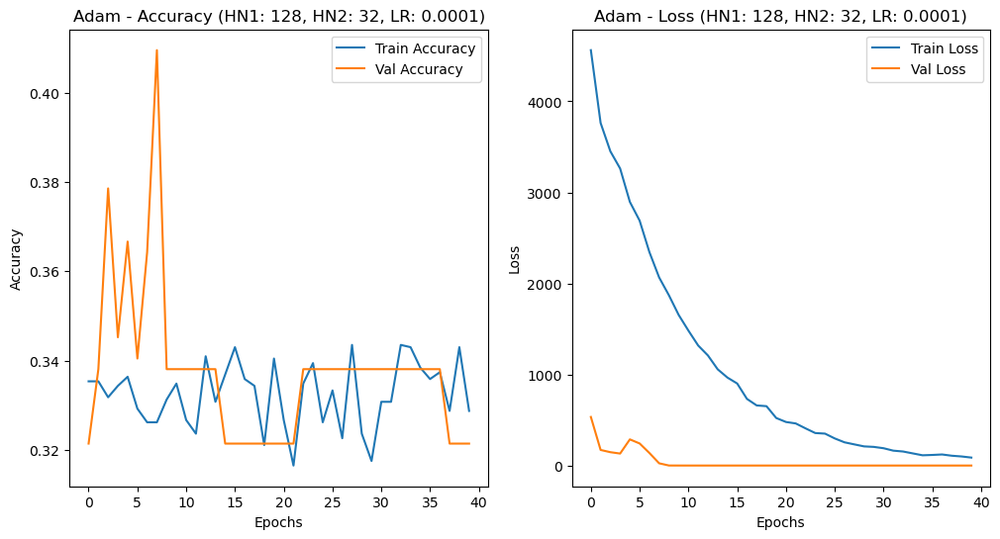

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3325 - loss: 6638.9248 - val_accuracy: 0.3214 - val_loss: 1896.8843
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3039 - loss: 4684.9233 - val_accuracy: 0.3405 - val_loss: 1335.3146
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 48ms/step - accuracy: 0.3204 - loss: 3157.1289 - val_accuracy: 0.3405 - val_loss: 1309.8467
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3432 - loss: 2631.7939 - val_accuracy: 0.3405 - val_loss: 611.6215
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3503 - loss: 2097.2092 - val_accuracy: 0.3405 - val_loss: 435.2669
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3317 - loss: 2113.0859 - val_accuracy: 0.3405 - val_loss: 359.0460
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3746 - loss: 1925.2961 - val_accuracy: 0.3405 - val_loss: 309.1627
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3395 - l

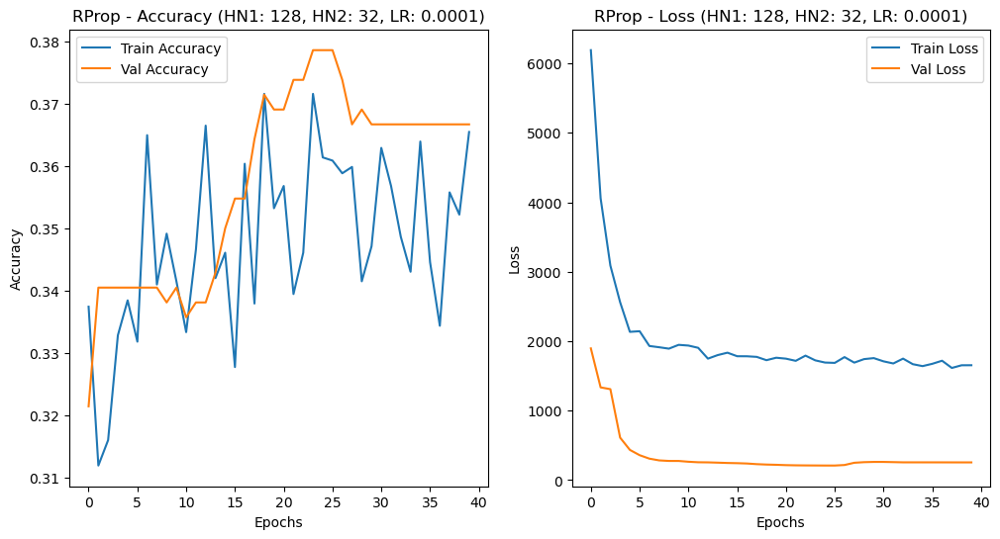

Adam Model - Test Loss: 1.0985, Test Accuracy: 0.3397
RProp Model - Test Loss: 288.8560, Test Accuracy: 0.3539
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
Hybrid Model - Test Accuracy: 0.3539

[INFO] Training models with HN1: 128, HN2: 32, LR: 0.001
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - accuracy: 0.3257 - loss: 5402.1777 - val_accuracy: 0.3524 - val_loss: 485.9615
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3436 - loss: 2310.2810 - val_accuracy: 0.3405 - val_loss: 195.1362
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3506 - loss: 971.2531 - val_accuracy: 0.3214 - val_loss: 1.1820
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.3475 - loss: 345.2640 - val_accuracy: 0.3214 - val_loss: 1.0989
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3396 - loss: 127.2822 - val_accuracy: 0.3214 - val_loss: 1.0988
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.

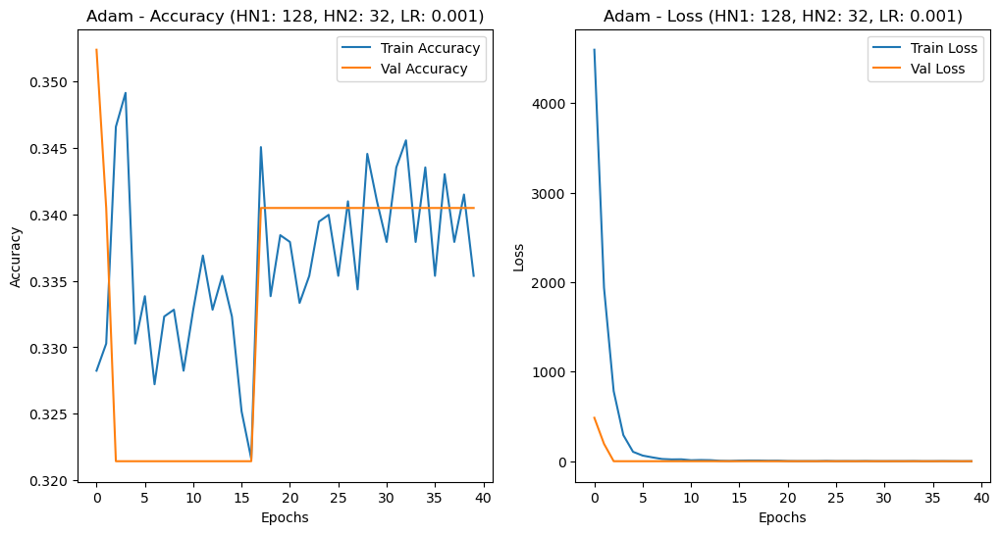

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3245 - loss: 5947.9146 - val_accuracy: 0.3405 - val_loss: 955.3497
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3242 - loss: 3540.1538 - val_accuracy: 0.3524 - val_loss: 556.7993
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3083 - loss: 2301.3647 - val_accuracy: 0.3381 - val_loss: 520.6613
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3713 - loss: 2030.8621 - val_accuracy: 0.3643 - val_loss: 389.7159
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3589 - loss: 1871.6616 - val_accuracy: 0.3786 - val_loss: 332.4001
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3572 - loss: 1803.3862 - val_accuracy: 0.3762 - val_loss: 331.9478
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3532 - loss: 1748.7410 - val_accuracy: 0.3833 - val_loss: 346.4713
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3453 - loss

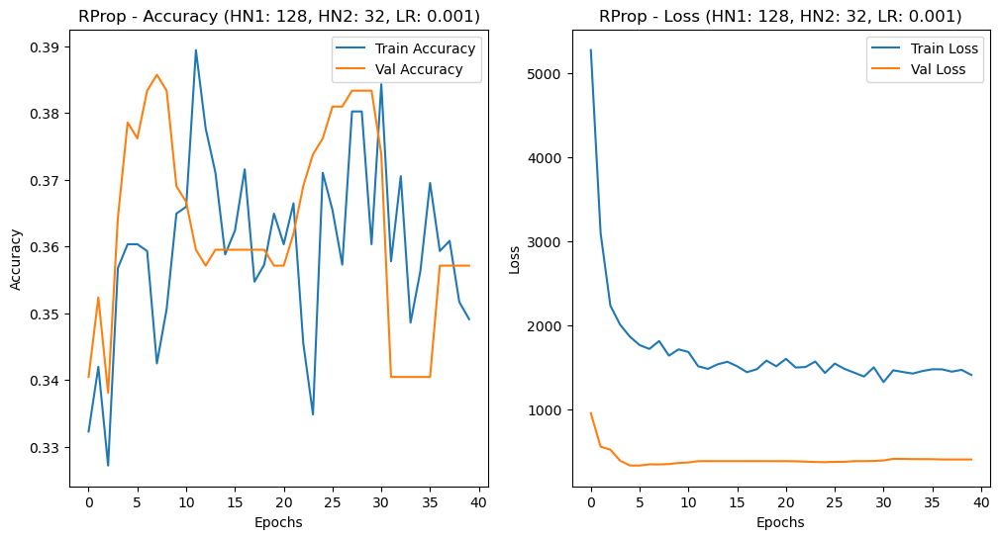

Adam Model - Test Loss: 1.0992, Test Accuracy: 0.3159
RProp Model - Test Loss: 436.5933, Test Accuracy: 0.3254
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
Hybrid Model - Test Accuracy: 0.3254

[INFO] Training models with HN1: 128, HN2: 32, LR: 0.01
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3447 - loss: 1788.8618 - val_accuracy: 0.3405 - val_loss: 1.0985
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3668 - loss: 3.7096 - val_accuracy: 0.3405 - val_loss: 1.0988
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.2894 - loss: 1.3290 - val_accuracy: 0.3405 - val_loss: 1.0986
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3747 - loss: 1.1289 - val_accuracy: 0.3405 - val_loss: 1.0985
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3153 - loss: 1.3586 - val_accuracy: 0.3214 - val_loss: 1.0989
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3345 - loss: 1

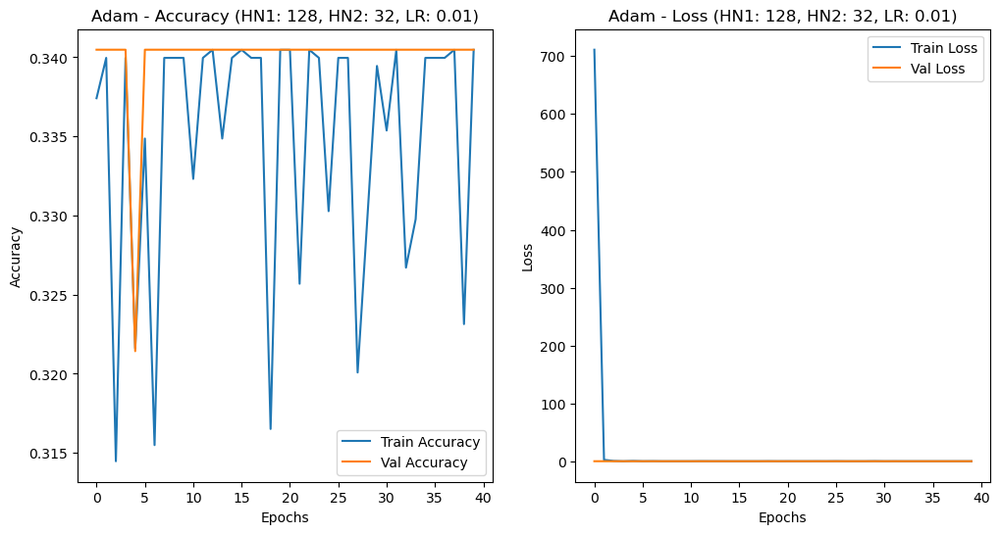

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 48ms/step - accuracy: 0.3372 - loss: 3831.9509 - val_accuracy: 0.4381 - val_loss: 241.3429
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3366 - loss: 1576.0223 - val_accuracy: 0.3214 - val_loss: 246.7640
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3052 - loss: 1423.6379 - val_accuracy: 0.2238 - val_loss: 123.1533
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3582 - loss: 1277.0527 - val_accuracy: 0.1381 - val_loss: 124.1051
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3469 - loss: 1327.3497 - val_accuracy: 0.1357 - val_loss: 138.6261
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3544 - loss: 1086.3220 - val_accuracy: 0.3262 - val_loss: 150.5189
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3377 - loss: 1168.3455 - val_accuracy: 0.3262 - val_loss: 150.9664
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3472 - loss

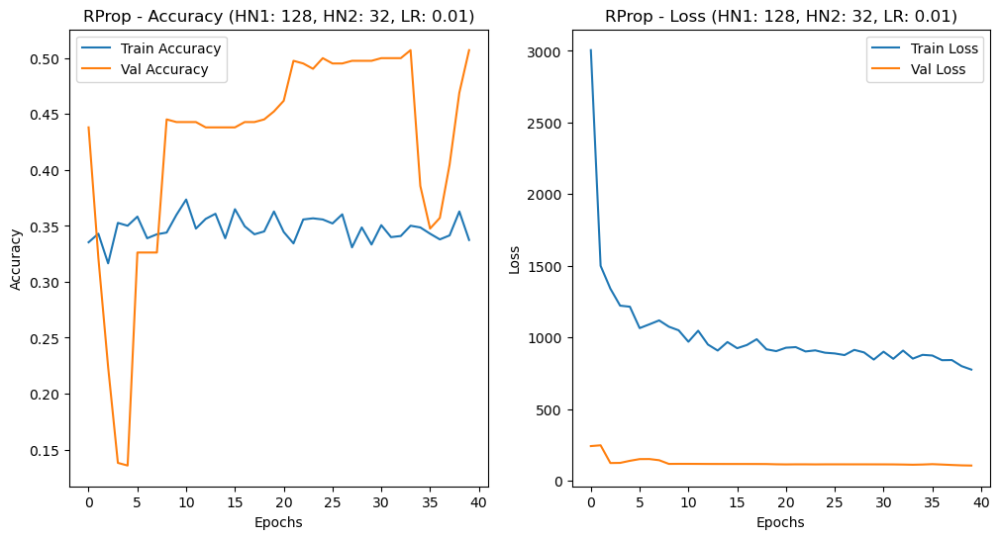

Adam Model - Test Loss: 1.0994, Test Accuracy: 0.3159
RProp Model - Test Loss: 108.4138, Test Accuracy: 0.4656
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
Hybrid Model - Test Accuracy: 0.4656

[INFO] Training models with HN1: 128, HN2: 32, LR: 0.1
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - accuracy: 0.3269 - loss: 4919.4189 - val_accuracy: 0.3405 - val_loss: 1.0987
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3087 - loss: 1.1009 - val_accuracy: 0.3405 - val_loss: 1.0992
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3190 - loss: 1.1011 - val_accuracy: 0.3405 - val_loss: 1.0986
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3506 - loss: 1.1003 - val_accuracy: 0.3381 - val_loss: 1.1013
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3369 - loss: 1.1066 - val_accuracy: 0.3405 - val_loss: 1.1039
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3550 - loss: 1.

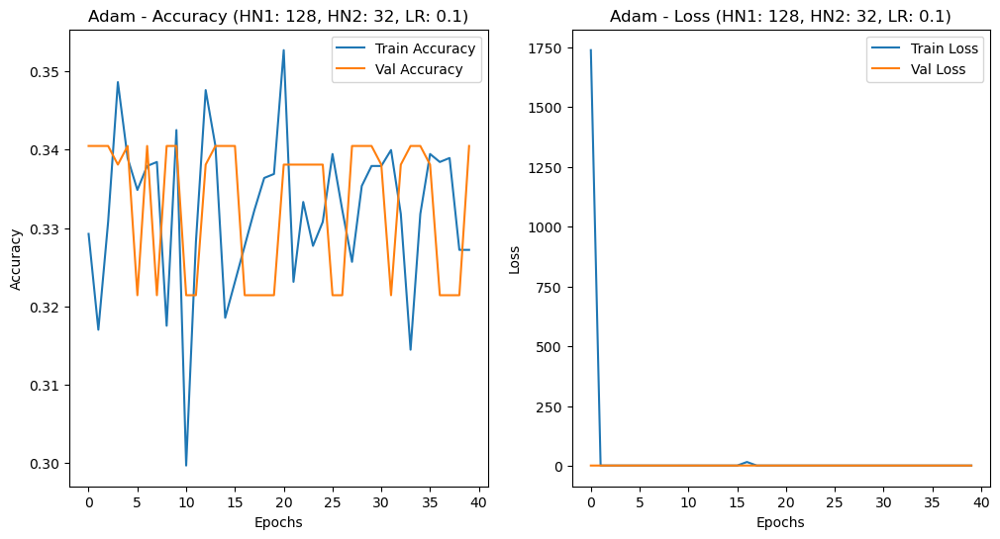

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3350 - loss: 2008.1985 - val_accuracy: 0.3214 - val_loss: 1.0990
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3226 - loss: 29.8761 - val_accuracy: 0.3214 - val_loss: 1.0990
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3598 - loss: 15.0632 - val_accuracy: 0.3214 - val_loss: 1.0990
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3325 - loss: 7.4686 - val_accuracy: 0.3214 - val_loss: 1.0990
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3243 - loss: 11.6319 - val_accuracy: 0.3214 - val_loss: 1.0990
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3406 - loss: 6.1675 - val_accuracy: 0.3214 - val_loss: 1.0990
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3151 - loss: 7.1753 - val_accuracy: 0.3214 - val_loss: 1.0990
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3236 - loss: 3.8198 - val_accuracy: 0.32

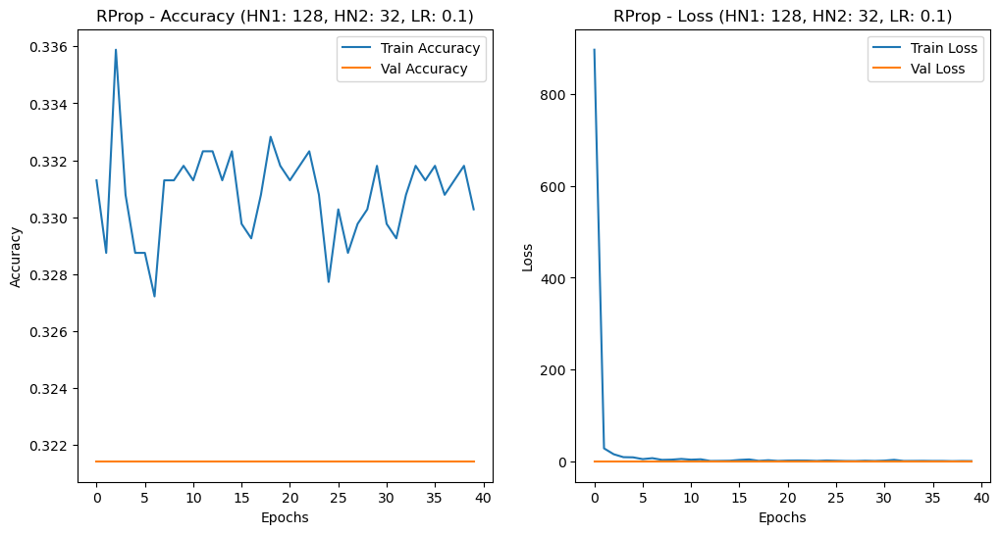

Adam Model - Test Loss: 1.1124, Test Accuracy: 0.3159
RProp Model - Test Loss: 1.0983, Test Accuracy: 0.3397
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
Hybrid Model - Test Accuracy: 0.3159

[INFO] Training models with HN1: 128, HN2: 64, LR: 0.0001
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3336 - loss: 5415.3955 - val_accuracy: 0.3405 - val_loss: 2547.4048
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3376 - loss: 4718.9917 - val_accuracy: 0.3405 - val_loss: 1568.6019
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3352 - loss: 4094.4116 - val_accuracy: 0.3405 - val_loss: 1211.2115
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3290 - loss: 3648.9331 - val_accuracy: 0.3405 - val_loss: 1098.7198
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3474 - loss: 3317.8447 - val_accuracy: 0.3405 - val_loss: 935.7909
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - 

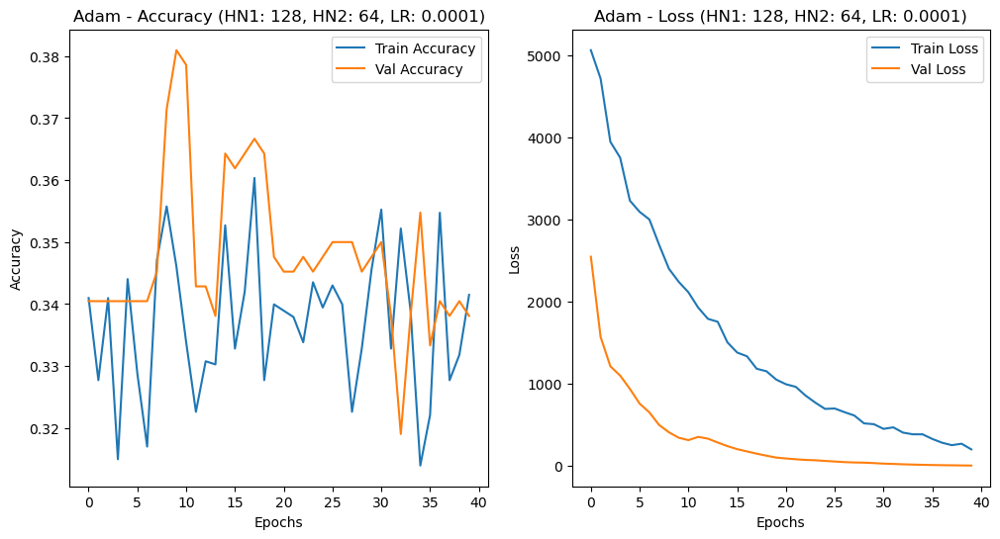

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3210 - loss: 5947.0864 - val_accuracy: 0.3405 - val_loss: 1642.3292
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3775 - loss: 5014.6738 - val_accuracy: 0.3381 - val_loss: 664.2212
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3223 - loss: 4797.1333 - val_accuracy: 0.4167 - val_loss: 255.1280
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3278 - loss: 4113.2983 - val_accuracy: 0.5167 - val_loss: 198.2629
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3362 - loss: 3882.1641 - val_accuracy: 0.4857 - val_loss: 193.2353
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3265 - loss: 4178.0688 - val_accuracy: 0.5381 - val_loss: 219.6000
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3451 - loss: 3830.4709 - val_accuracy: 0.5524 - val_loss: 322.7888
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3395 - los

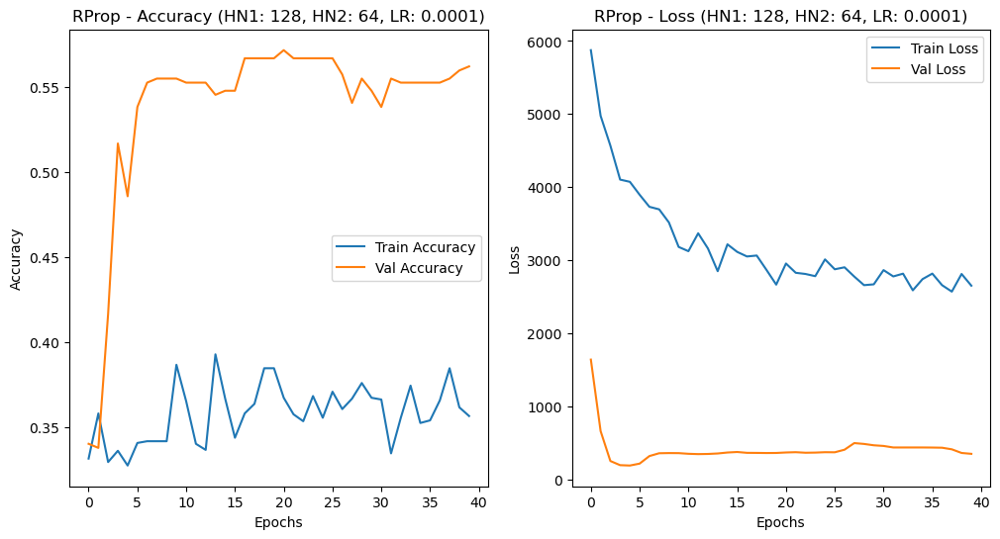

Adam Model - Test Loss: 1.7376, Test Accuracy: 0.3444
RProp Model - Test Loss: 361.3730, Test Accuracy: 0.5558
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
Hybrid Model - Test Accuracy: 0.5534

[INFO] Training models with HN1: 128, HN2: 64, LR: 0.001
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - accuracy: 0.3050 - loss: 6165.2344 - val_accuracy: 0.3214 - val_loss: 891.2274
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - accuracy: 0.3177 - loss: 2562.6467 - val_accuracy: 0.3405 - val_loss: 400.6012
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3425 - loss: 1264.8085 - val_accuracy: 0.3405 - val_loss: 50.2524
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3383 - loss: 640.8619 - val_accuracy: 0.3214 - val_loss: 1.0990
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3492 - loss: 313.2321 - val_accuracy: 0.3214 - val_loss: 1.0990
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 

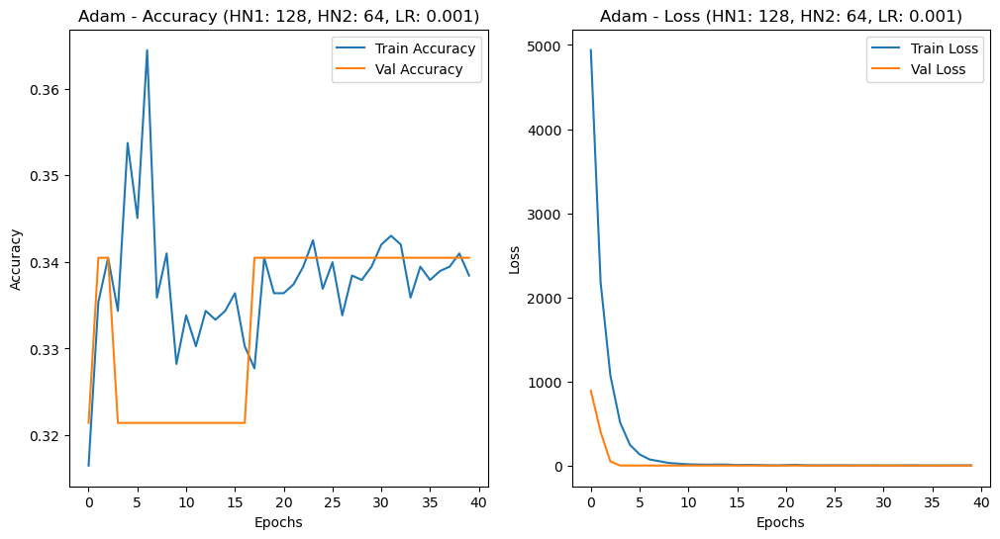

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3291 - loss: 5062.1318 - val_accuracy: 0.3071 - val_loss: 643.0318
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3342 - loss: 4055.8550 - val_accuracy: 0.3214 - val_loss: 985.4944
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3378 - loss: 3676.3013 - val_accuracy: 0.3214 - val_loss: 972.5551
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3537 - loss: 3202.1331 - val_accuracy: 0.3214 - val_loss: 1037.9667
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3303 - loss: 3274.5427 - val_accuracy: 0.3214 - val_loss: 1038.9458
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3285 - loss: 3301.9436 - val_accuracy: 0.3214 - val_loss: 1013.6852
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3527 - loss: 2934.5732 - val_accuracy: 0.3214 - val_loss: 969.3892
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3805 - l

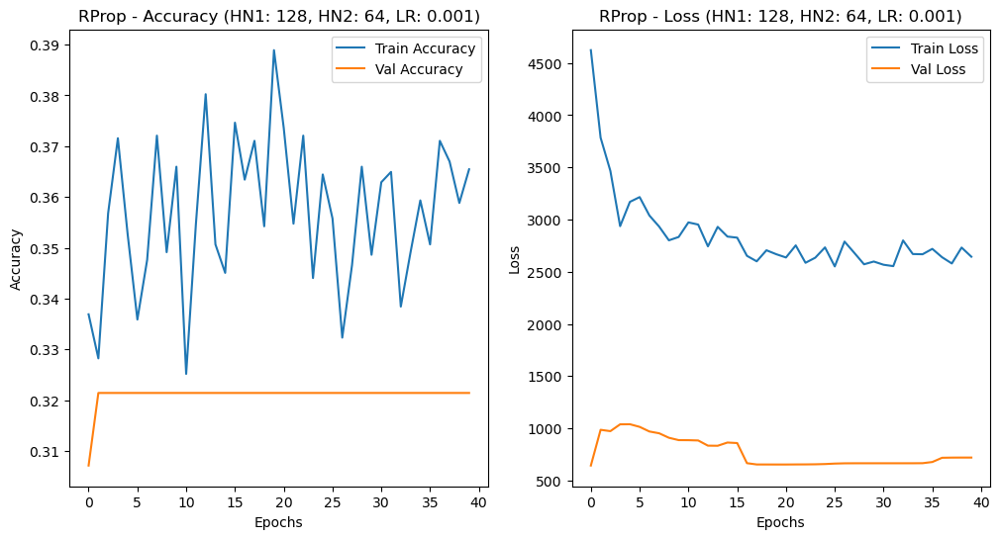

Adam Model - Test Loss: 1.0993, Test Accuracy: 0.3159
RProp Model - Test Loss: 716.4089, Test Accuracy: 0.3397
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
Hybrid Model - Test Accuracy: 0.3397

[INFO] Training models with HN1: 128, HN2: 64, LR: 0.01
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 70ms/step - accuracy: 0.3560 - loss: 3536.8225 - val_accuracy: 0.3405 - val_loss: 1.1001
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3521 - loss: 6.8029 - val_accuracy: 0.3214 - val_loss: 1.0997
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3065 - loss: 2.0245 - val_accuracy: 0.3405 - val_loss: 1.0985
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - accuracy: 0.3414 - loss: 2.1917 - val_accuracy: 0.3405 - val_loss: 1.0985
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - accuracy: 0.3402 - loss: 2.0550 - val_accuracy: 0.3214 - val_loss: 1.0988
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3352 - loss: 2

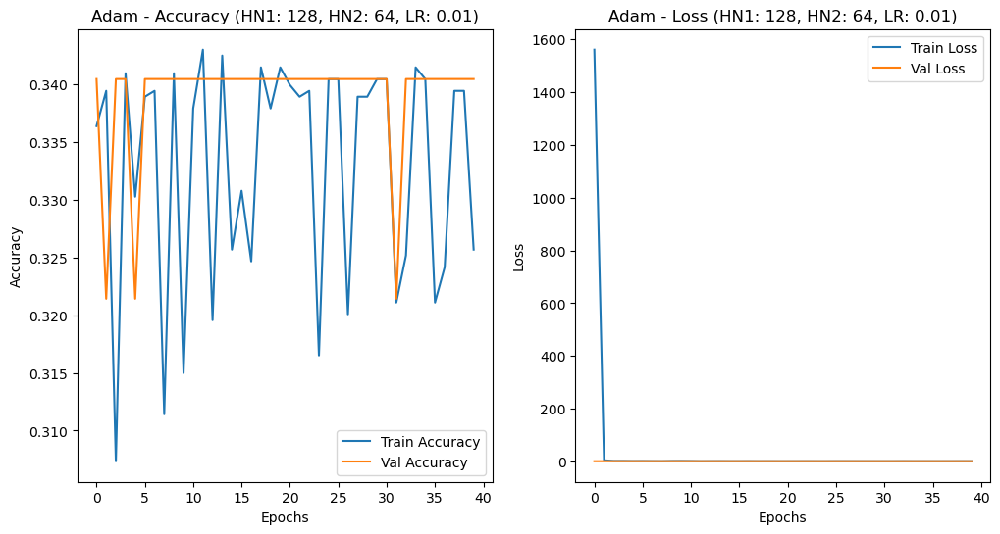

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3458 - loss: 5442.1470 - val_accuracy: 0.3452 - val_loss: 204.7973
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3726 - loss: 1781.3967 - val_accuracy: 0.3929 - val_loss: 139.1842
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3507 - loss: 1711.1210 - val_accuracy: 0.4024 - val_loss: 135.7205
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3518 - loss: 1575.6635 - val_accuracy: 0.4119 - val_loss: 130.3571
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3182 - loss: 1790.7006 - val_accuracy: 0.5238 - val_loss: 104.4142
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3767 - loss: 1492.0806 - val_accuracy: 0.5190 - val_loss: 102.3811
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3405 - loss: 1597.2838 - val_accuracy: 0.5190 - val_loss: 102.0751
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3452 - loss

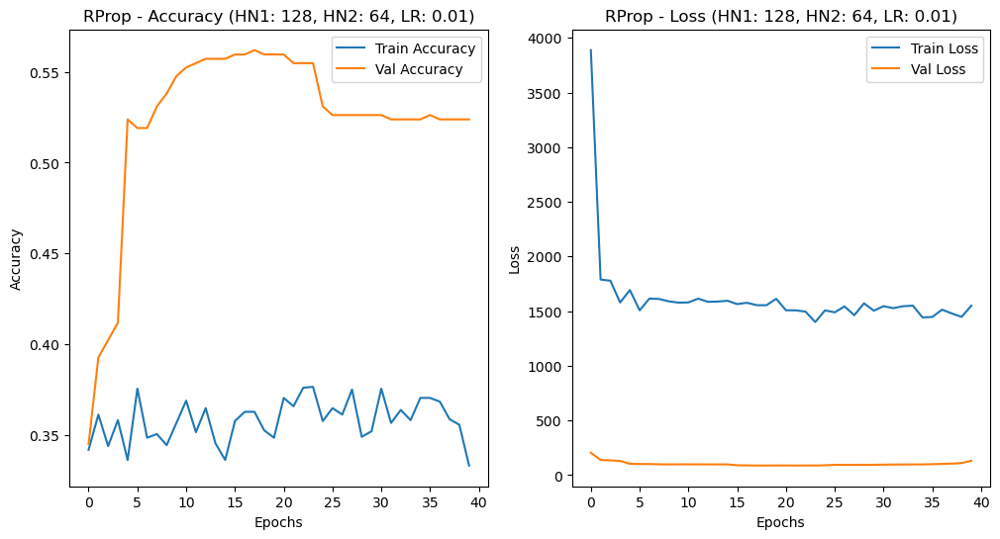

Adam Model - Test Loss: 1.0992, Test Accuracy: 0.3159
RProp Model - Test Loss: 143.0949, Test Accuracy: 0.5107
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
Hybrid Model - Test Accuracy: 0.5107

[INFO] Training models with HN1: 128, HN2: 64, LR: 0.1
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 69ms/step - accuracy: 0.3462 - loss: 6624.9126 - val_accuracy: 0.3381 - val_loss: 1.1003
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 70ms/step - accuracy: 0.3309 - loss: 1.1034 - val_accuracy: 0.3214 - val_loss: 1.0993
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 68ms/step - accuracy: 0.3280 - loss: 1.1010 - val_accuracy: 0.3381 - val_loss: 1.1001
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - accuracy: 0.3231 - loss: 1.1009 - val_accuracy: 0.3214 - val_loss: 1.0995
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3274 - loss: 1.1021 - val_accuracy: 0.3405 - val_loss: 1.0987
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.3294 - loss: 1.

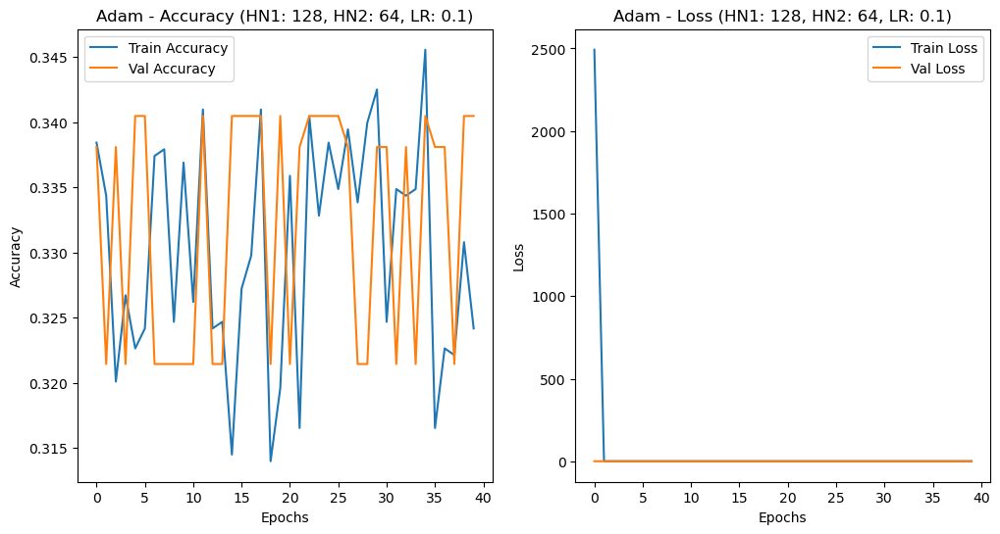

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 48ms/step - accuracy: 0.3466 - loss: 2025.4060 - val_accuracy: 0.5238 - val_loss: 6.4238
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3177 - loss: 343.1554 - val_accuracy: 0.3405 - val_loss: 3.5978
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3636 - loss: 232.9117 - val_accuracy: 0.3381 - val_loss: 1.0842
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3464 - loss: 199.4116 - val_accuracy: 0.3381 - val_loss: 1.0985
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3552 - loss: 165.7382 - val_accuracy: 0.3357 - val_loss: 1.0979
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3589 - loss: 143.5626 - val_accuracy: 0.3381 - val_loss: 1.0985
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3468 - loss: 150.1787 - val_accuracy: 0.3381 - val_loss: 1.0985
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3645 - loss: 138.5038 - val_acc

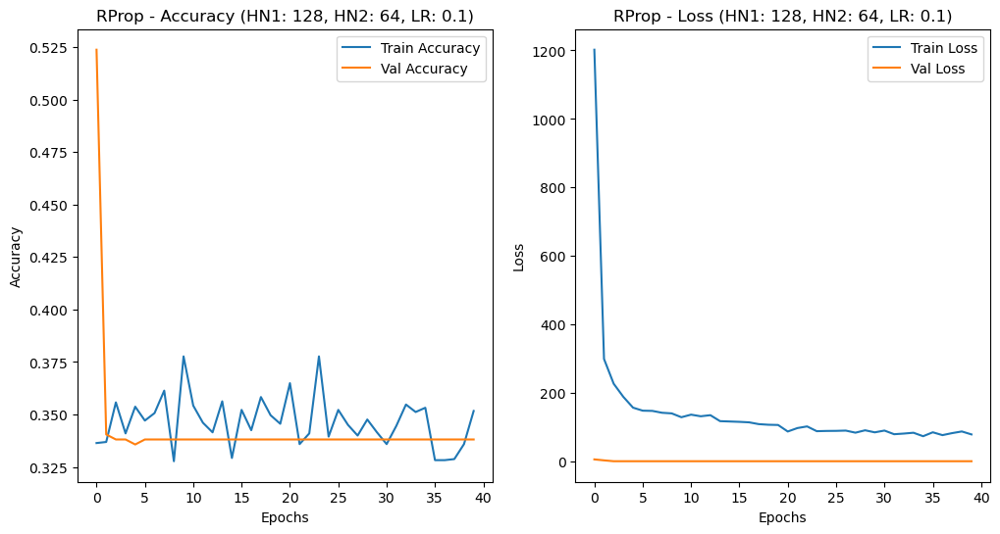

Adam Model - Test Loss: 1.1000, Test Accuracy: 0.3159
RProp Model - Test Loss: 1.0986, Test Accuracy: 0.3444
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
Hybrid Model - Test Accuracy: 0.3159

[INFO] Training models with HN1: 128, HN2: 128, LR: 0.0001
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - accuracy: 0.3475 - loss: 4928.6792 - val_accuracy: 0.3595 - val_loss: 575.8228
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 68ms/step - accuracy: 0.3266 - loss: 4700.3257 - val_accuracy: 0.4095 - val_loss: 567.2368
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 71ms/step - accuracy: 0.3353 - loss: 4075.9099 - val_accuracy: 0.3929 - val_loss: 614.4842
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 73ms/step - accuracy: 0.3454 - loss: 3950.0393 - val_accuracy: 0.3762 - val_loss: 719.2996
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - accuracy: 0.3307 - loss: 3563.7817 - val_accuracy: 0.3952 - val_loss: 483.0711
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - acc

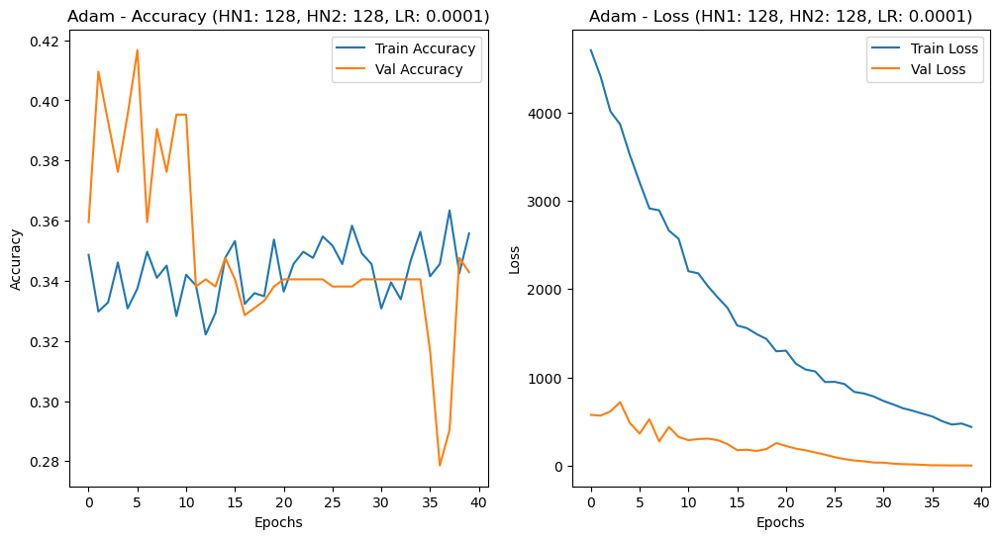

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 48ms/step - accuracy: 0.3316 - loss: 5928.5132 - val_accuracy: 0.3405 - val_loss: 526.5117
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3401 - loss: 4278.0396 - val_accuracy: 0.3214 - val_loss: 1907.4730
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 54ms/step - accuracy: 0.3168 - loss: 4016.2996 - val_accuracy: 0.3214 - val_loss: 2044.9421
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 48ms/step - accuracy: 0.3340 - loss: 3530.4719 - val_accuracy: 0.3214 - val_loss: 2047.2697
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 49ms/step - accuracy: 0.3601 - loss: 3398.8364 - val_accuracy: 0.3214 - val_loss: 2002.8491
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3566 - loss: 3471.5479 - val_accuracy: 0.3214 - val_loss: 1310.8881
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3555 - loss: 3095.1589 - val_accuracy: 0.3214 - val_loss: 1075.4121
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 48ms/step - accuracy: 0.3283 

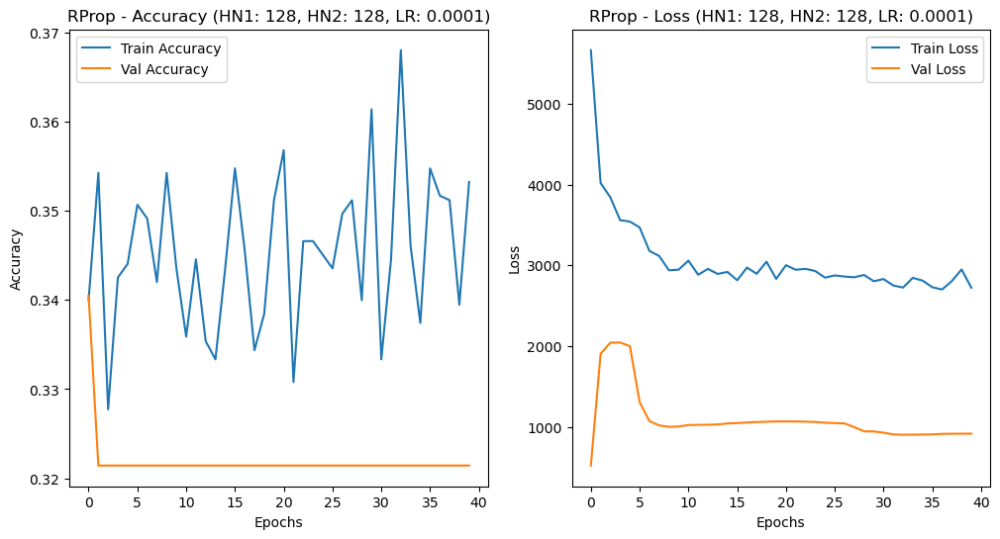

Adam Model - Test Loss: 1.4448, Test Accuracy: 0.3753
RProp Model - Test Loss: 918.5472, Test Accuracy: 0.3397
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
Hybrid Model - Test Accuracy: 0.3397

[INFO] Training models with HN1: 128, HN2: 128, LR: 0.001
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3547 - loss: 4492.3682 - val_accuracy: 0.3238 - val_loss: 476.0119
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3489 - loss: 1957.1146 - val_accuracy: 0.3690 - val_loss: 288.5815
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3447 - loss: 1048.6783 - val_accuracy: 0.3381 - val_loss: 185.9765
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3457 - loss: 588.9409 - val_accuracy: 0.3381 - val_loss: 66.0550
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3649 - loss: 330.6815 - val_accuracy: 0.3381 - val_loss: 12.8102
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 71ms/step - accura

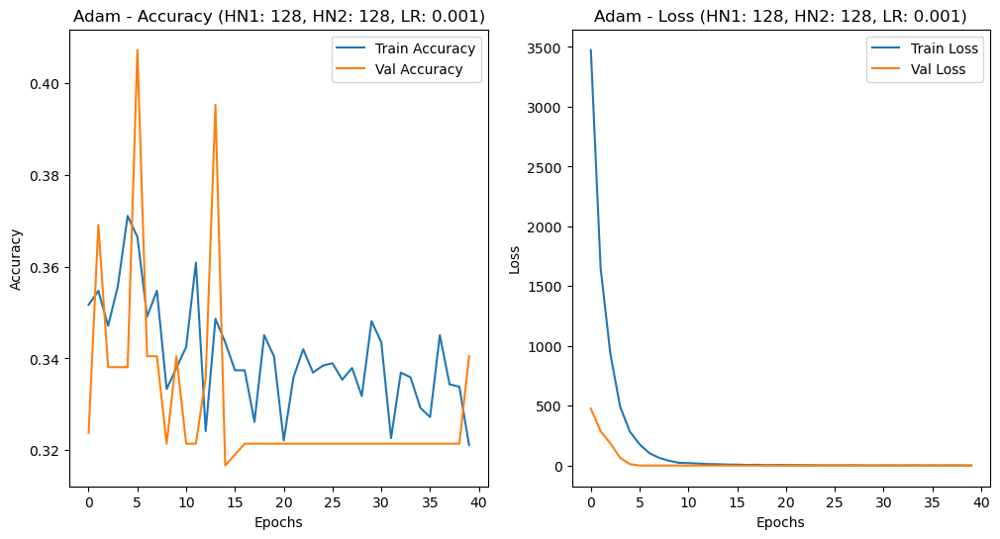

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 48ms/step - accuracy: 0.3335 - loss: 5853.2329 - val_accuracy: 0.3643 - val_loss: 525.9855
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3349 - loss: 3402.4673 - val_accuracy: 0.5262 - val_loss: 294.4198
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3365 - loss: 3131.6067 - val_accuracy: 0.5214 - val_loss: 355.4350
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3457 - loss: 3098.7393 - val_accuracy: 0.3929 - val_loss: 362.4690
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.3942 - loss: 2836.6418 - val_accuracy: 0.4048 - val_loss: 359.1592
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 48ms/step - accuracy: 0.3530 - loss: 2858.4399 - val_accuracy: 0.4119 - val_loss: 355.8121
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3679 - loss: 2787.1511 - val_accuracy: 0.5095 - val_loss: 334.4362
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3680 - loss

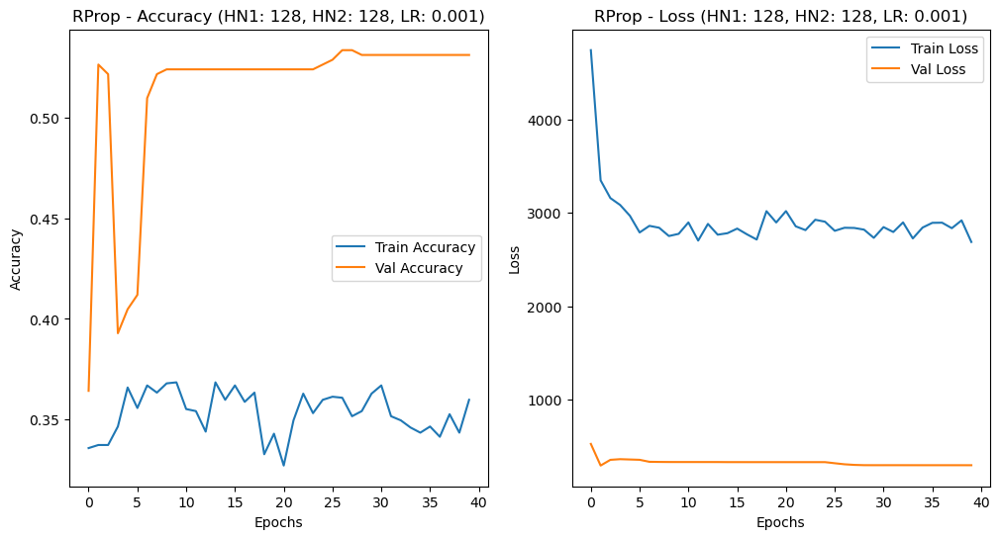

Adam Model - Test Loss: 1.0996, Test Accuracy: 0.3159
RProp Model - Test Loss: 306.6419, Test Accuracy: 0.5083
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
Hybrid Model - Test Accuracy: 0.5083

[INFO] Training models with HN1: 128, HN2: 128, LR: 0.01
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3383 - loss: 3086.1511 - val_accuracy: 0.3214 - val_loss: 1.0988
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - accuracy: 0.3100 - loss: 17.8681 - val_accuracy: 0.3214 - val_loss: 1.0996
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 71ms/step - accuracy: 0.3040 - loss: 2.9565 - val_accuracy: 0.3214 - val_loss: 1.0991
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 28s 937ms/step - accuracy: 0.3308 - loss: 1.7447 - val_accuracy: 0.3214 - val_loss: 1.0988
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 77ms/step - accuracy: 0.3498 - loss: 2.0014 - val_accuracy: 0.3405 - val_loss: 1.0988
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 10s 341ms/step - accuracy: 0.3223 - l

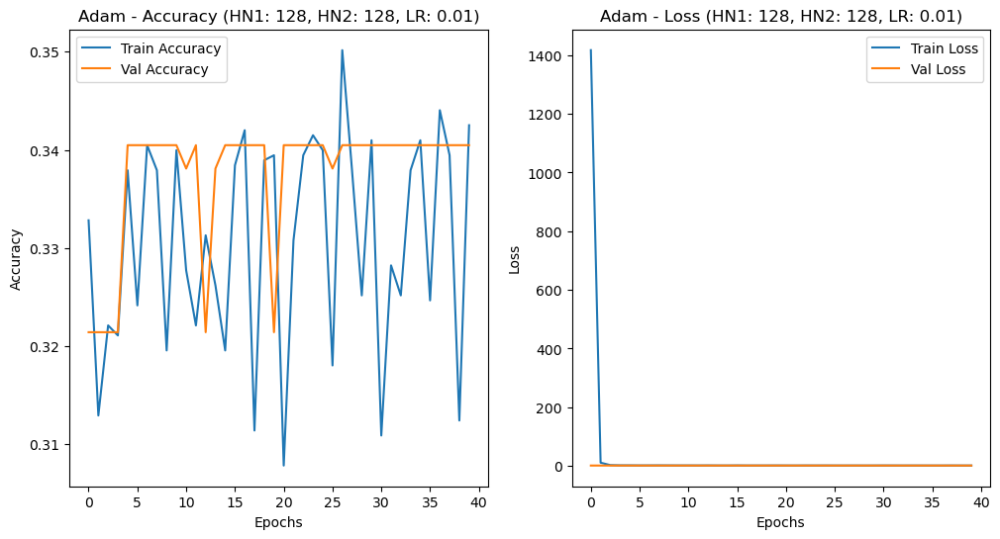

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 51ms/step - accuracy: 0.3422 - loss: 3277.2529 - val_accuracy: 0.3381 - val_loss: 1016.3699
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - accuracy: 0.3309 - loss: 1332.0858 - val_accuracy: 0.3381 - val_loss: 910.6981
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3487 - loss: 1203.6123 - val_accuracy: 0.3381 - val_loss: 754.1331
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.3583 - loss: 1145.2074 - val_accuracy: 0.3381 - val_loss: 750.7375
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3670 - loss: 1090.9879 - val_accuracy: 0.3381 - val_loss: 730.5651
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3642 - loss: 1003.5789 - val_accuracy: 0.3381 - val_loss: 728.0447
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3722 - loss: 1040.4011 - val_accuracy: 0.3381 - val_loss: 688.0213
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3869 - los

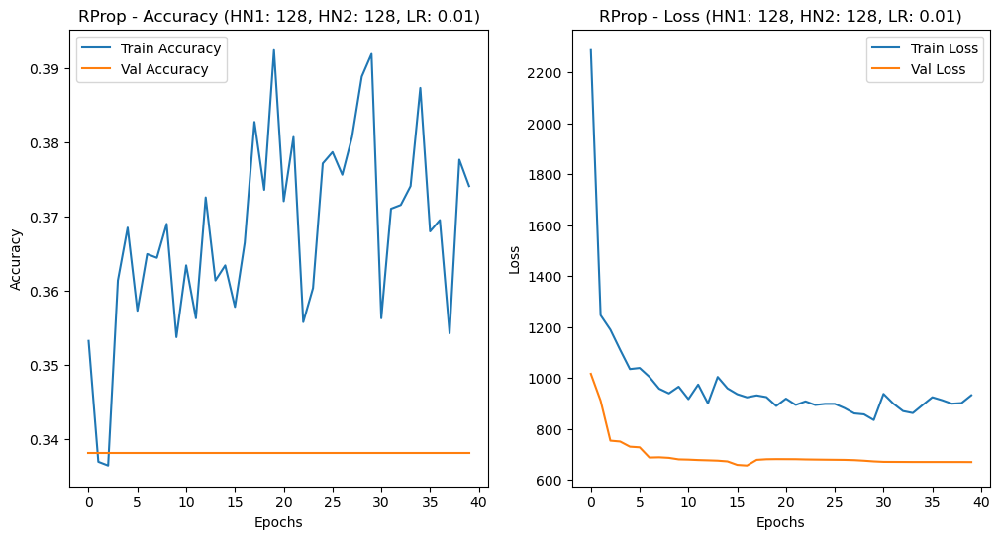

Adam Model - Test Loss: 1.0996, Test Accuracy: 0.3159
RProp Model - Test Loss: 693.0599, Test Accuracy: 0.3444
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
Hybrid Model - Test Accuracy: 0.3444

[INFO] Training models with HN1: 128, HN2: 128, LR: 0.1
Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 78ms/step - accuracy: 0.3189 - loss: 18921.0430 - val_accuracy: 0.3405 - val_loss: 1.0985
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3307 - loss: 1.0995 - val_accuracy: 0.3381 - val_loss: 1.0983
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3210 - loss: 1.1000 - val_accuracy: 0.3405 - val_loss: 1.0991
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.3493 - loss: 1.0993 - val_accuracy: 0.3214 - val_loss: 1.1006
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3251 - loss: 1.1011 - val_accuracy: 0.3405 - val_loss: 1.1004
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - accuracy: 0.3348 - loss: 

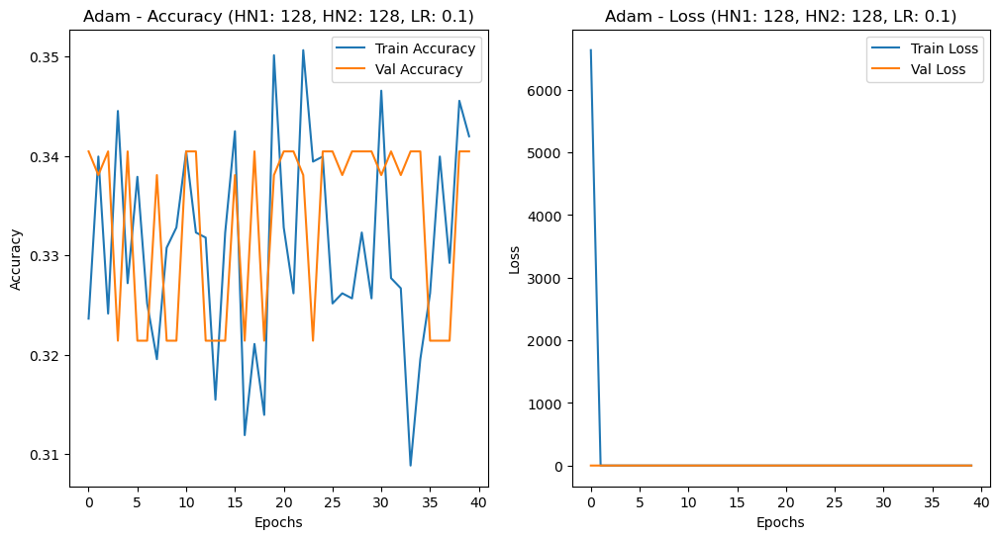

Epoch 1/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - accuracy: 0.3490 - loss: 3797.3762 - val_accuracy: 0.3976 - val_loss: 268.3877
Epoch 2/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3821 - loss: 1019.0482 - val_accuracy: 0.4524 - val_loss: 228.6859
Epoch 3/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3830 - loss: 872.4001 - val_accuracy: 0.4619 - val_loss: 221.8544
Epoch 4/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3676 - loss: 1037.0911 - val_accuracy: 0.4643 - val_loss: 220.2241
Epoch 5/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3767 - loss: 958.8862 - val_accuracy: 0.4738 - val_loss: 200.6402
Epoch 6/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.3671 - loss: 938.8989 - val_accuracy: 0.4714 - val_loss: 196.5828
Epoch 7/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3721 - loss: 1021.6474 - val_accuracy: 0.4714 - val_loss: 196.1769
Epoch 8/40
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.3598 - loss: 9

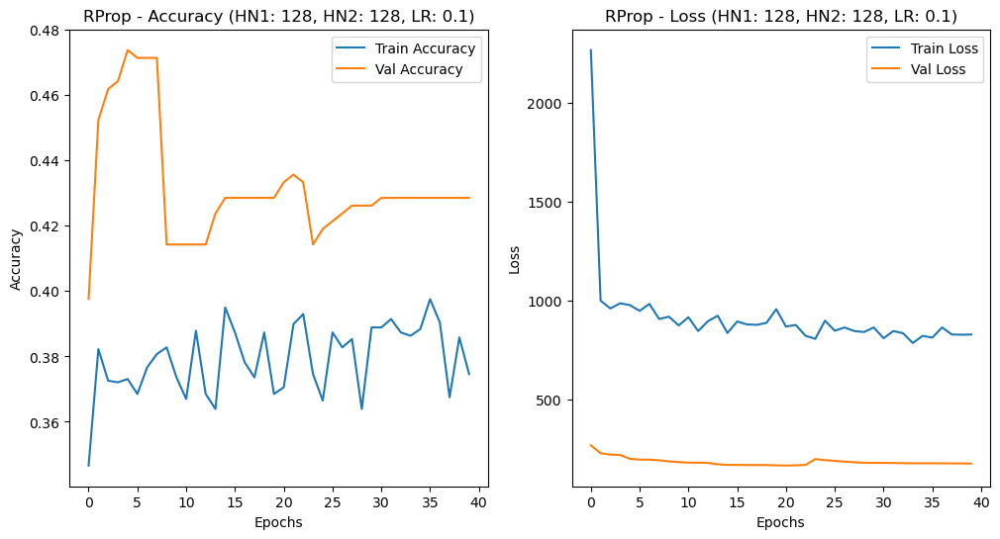

Adam Model - Test Loss: 1.1000, Test Accuracy: 0.3159
RProp Model - Test Loss: 179.7727, Test Accuracy: 0.4537
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
Hybrid Model - Test Accuracy: 0.4537

[INFO] Total execution time: 9478.47 seconds
[INFO] Results saved to 'results_hybrid.csv'.


In [74]:
import tensorflow as tf
from tensorflow.keras.optimizers import Adam
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import time

# Assuming 'create_model' and 'RPropOptimizer' are defined elsewhere
# Also assuming that data preparation steps and the dataset splits are already handled

# Hyperparameter options
hidden_neurons_1_options = [16, 32, 64, 128]
hidden_neurons_2_options = [16, 32, 64, 128]
learning_rate_options = [0.0001, 0.001, 0.01, 0.1]
epochs = 40
batch_size = 64

results_hybrid = []

start_time = time.time()
for hidden_neurons_1 in hidden_neurons_1_options:
    for hidden_neurons_2 in hidden_neurons_2_options:
        for learning_rate in learning_rate_options:
            print(f"\n[INFO] Training models with HN1: {hidden_neurons_1}, HN2: {hidden_neurons_2}, LR: {learning_rate}")

            # Train with Adam optimizer
            model_adam = create_model(hidden_neurons_1, hidden_neurons_2, X_train.shape[1])
            optimizer_adam = Adam(learning_rate=learning_rate)
            model_adam.compile(optimizer=optimizer_adam, loss='sparse_categorical_crossentropy', metrics=['accuracy'])

            history_adam = model_adam.fit(
                X_train, y_train_encoded,
                validation_data=(X_val, y_val_encoded),
                epochs=epochs,
                batch_size=batch_size,
                verbose=1
            )

            # Plot training history for Adam
            plt.figure(figsize=(12, 6))
            plt.subplot(1, 2, 1)
            plt.plot(history_adam.history['accuracy'], label='Train Accuracy')
            plt.plot(history_adam.history['val_accuracy'], label='Val Accuracy')
            plt.title(f'Adam - Accuracy (HN1: {hidden_neurons_1}, HN2: {hidden_neurons_2}, LR: {learning_rate})')
            plt.xlabel('Epochs')
            plt.ylabel('Accuracy')
            plt.legend()

            plt.subplot(1, 2, 2)
            plt.plot(history_adam.history['loss'], label='Train Loss')
            plt.plot(history_adam.history['val_loss'], label='Val Loss')
            plt.title(f'Adam - Loss (HN1: {hidden_neurons_1}, HN2: {hidden_neurons_2}, LR: {learning_rate})')
            plt.xlabel('Epochs')
            plt.ylabel('Loss')
            plt.legend()

            plt.show()

            # Train with RProp optimizer
            model_rprop = create_model(hidden_neurons_1, hidden_neurons_2, X_train.shape[1])
            optimizer_rprop = RPropOptimizer(learning_rate=learning_rate)
            model_rprop.compile(optimizer=optimizer_rprop, loss='sparse_categorical_crossentropy', metrics=['accuracy'])

            history_rprop = model_rprop.fit(
                X_train, y_train_encoded,
                validation_data=(X_val, y_val_encoded),
                epochs=epochs,
                batch_size=batch_size,
                verbose=1
            )

            # Plot training history for RProp
            plt.figure(figsize=(12, 6))
            plt.subplot(1, 2, 1)
            plt.plot(history_rprop.history['accuracy'], label='Train Accuracy')
            plt.plot(history_rprop.history['val_accuracy'], label='Val Accuracy')
            plt.title(f'RProp - Accuracy (HN1: {hidden_neurons_1}, HN2: {hidden_neurons_2}, LR: {learning_rate})')
            plt.xlabel('Epochs')
            plt.ylabel('Accuracy')
            plt.legend()

            plt.subplot(1, 2, 2)
            plt.plot(history_rprop.history['loss'], label='Train Loss')
            plt.plot(history_rprop.history['val_loss'], label='Val Loss')
            plt.title(f'RProp - Loss (HN1: {hidden_neurons_1}, HN2: {hidden_neurons_2}, LR: {learning_rate})')
            plt.xlabel('Epochs')
            plt.ylabel('Loss')
            plt.legend()

            plt.show()

            # Evaluate individual models
            test_loss_adam, test_accuracy_adam = model_adam.evaluate(X_test, y_test_encoded, verbose=0)
            print(f"Adam Model - Test Loss: {test_loss_adam:.4f}, Test Accuracy: {test_accuracy_adam:.4f}")

            test_loss_rprop, test_accuracy_rprop = model_rprop.evaluate(X_test, y_test_encoded, verbose=0)
            print(f"RProp Model - Test Loss: {test_loss_rprop:.4f}, Test Accuracy: {test_accuracy_rprop:.4f}")

            # Combine predictions
            predictions_adam = model_adam.predict(X_test)
            predictions_rprop = model_rprop.predict(X_test)
            predictions_hybrid = (predictions_adam + predictions_rprop) / 2
            predicted_classes = np.argmax(predictions_hybrid, axis=1)
            hybrid_accuracy = np.mean(predicted_classes == y_test_encoded)
            print(f"Hybrid Model - Test Accuracy: {hybrid_accuracy:.4f}")

            # Record the results
            results_hybrid.append({
                'optimizer': 'Hybrid',
                'hidden_neurons_1': hidden_neurons_1,
                'hidden_neurons_2': hidden_neurons_2,
                'learning_rate': learning_rate,
                'adam_test_accuracy': test_accuracy_adam,
                'rprop_test_accuracy': test_accuracy_rprop,
                'hybrid_test_accuracy': hybrid_accuracy
            })

execution_time = time.time() - start_time
print(f"\n[INFO] Total execution time: {execution_time:.2f} seconds")

# Convert results to DataFrame and save
results_df_hybrid = pd.DataFrame(results_hybrid)
results_df_hybrid.to_csv('results_hybrid.csv', index=False)
print("[INFO] Results saved to 'results_hybrid.csv'.")


In [ ]:
# -------------------------------
# Phase 3: Analytics and Visualization
# -------------------------------

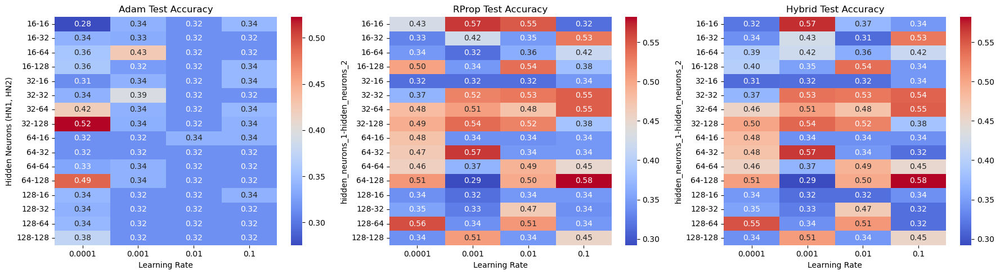

In [77]:
import seaborn as sns

# Convert results to a DataFrame
results_df = pd.DataFrame(results_hybrid)

# Pivot data for heatmap display
accuracy_pivot = results_df.pivot_table(values='hybrid_test_accuracy', index=['hidden_neurons_1', 'hidden_neurons_2'], columns='learning_rate')
adam_accuracy_pivot = results_df.pivot_table(values='adam_test_accuracy', index=['hidden_neurons_1', 'hidden_neurons_2'], columns='learning_rate')
rprop_accuracy_pivot = results_df.pivot_table(values='rprop_test_accuracy', index=['hidden_neurons_1', 'hidden_neurons_2'], columns='learning_rate')

plt.figure(figsize=(18, 5))
plt.subplot(1, 3, 1)
sns.heatmap(adam_accuracy_pivot, annot=True, fmt=".2f", cmap="coolwarm")
plt.title('Adam Test Accuracy')
plt.ylabel('Hidden Neurons (HN1, HN2)')
plt.xlabel('Learning Rate')

plt.subplot(1, 3, 2)
sns.heatmap(rprop_accuracy_pivot, annot=True, fmt=".2f", cmap="coolwarm")
plt.title('RProp Test Accuracy')
plt.xlabel('Learning Rate')

plt.subplot(1, 3, 3)
sns.heatmap(accuracy_pivot, annot=True, fmt=".2f", cmap="coolwarm")
plt.title('Hybrid Test Accuracy')
plt.xlabel('Learning Rate')

plt.tight_layout()
plt.show()


Results DataFrame:
  optimizer  hidden_neurons_1  hidden_neurons_2  learning_rate  \
0    Hybrid                16                16         0.0001   
1    Hybrid                16                16         0.0010   
2    Hybrid                16                16         0.0100   
3    Hybrid                16                16         0.1000   
4    Hybrid                16                32         0.0001   

   adam_test_accuracy  rprop_test_accuracy  hybrid_test_accuracy  
0            0.275534             0.427553              0.320665  
1            0.339667             0.565321              0.570071  
2            0.315914             0.548694              0.372922  
3            0.344418             0.315914              0.344418  
4            0.339667             0.330166              0.339667  

Basic Statistics:
       hidden_neurons_1  hidden_neurons_2  learning_rate  adam_test_accuracy  \
count         64.000000         64.000000      64.000000           64.000000   
mea

/Users/frankoswanepoel/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/frankoswanepoel/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/frankoswanepoel/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/frankoswanepoel/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and wil

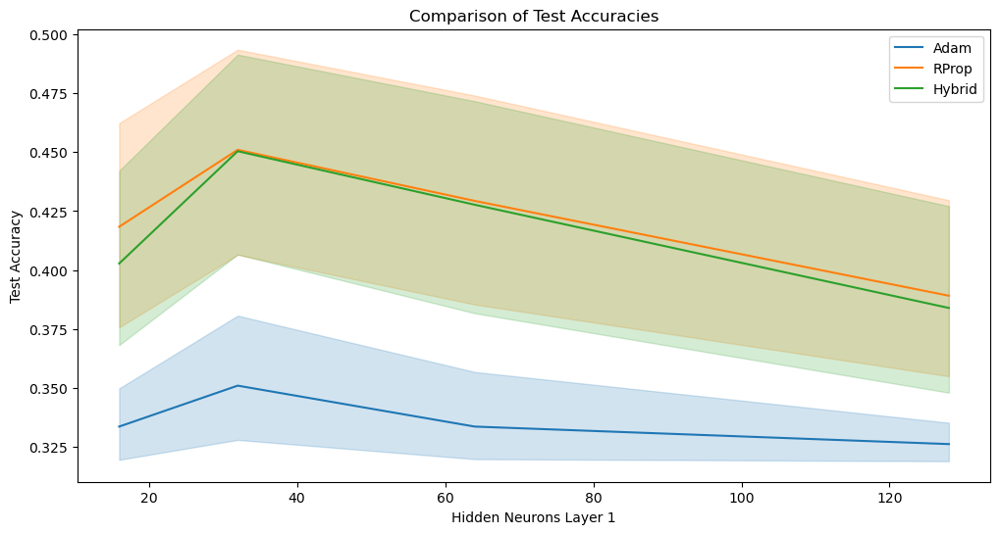


T-test between Adam and Hybrid test accuracies:
T-statistic: -6.6088, P-value: 0.0000

T-test between RProp and Hybrid test accuracies:
T-statistic: 0.3664, P-value: 0.7147


In [81]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy.stats as stats

results_df = pd.read_csv('results_hybrid.csv')

print("Results DataFrame:")
print(results_df.head())

print("\nBasic Statistics:")
print(results_df.describe())

# Finding the best results for each optimizer
best_adam = results_df.loc[results_df['adam_test_accuracy'].idxmax()]
best_rprop = results_df.loc[results_df['rprop_test_accuracy'].idxmax()]
best_hybrid = results_df.loc[results_df['hybrid_test_accuracy'].idxmax()]

print("\nBest Test Accuracy for Adam:")
print(f"Hidden Neurons Layer 1: {best_adam['hidden_neurons_1']}, Layer 2: {best_adam['hidden_neurons_2']}")
print(f"Learning Rate: {best_adam['learning_rate']}")
print(f"Test Accuracy: {best_adam['adam_test_accuracy']:.4f}")

print("\nBest Test Accuracy for RProp:")
print(f"Hidden Neurons Layer 1: {best_rprop['hidden_neurons_1']}, Layer 2: {best_rprop['hidden_neurons_2']}")
print(f"Learning Rate: {best_rprop['learning_rate']}")
print(f"Test Accuracy: {best_rprop['rprop_test_accuracy']:.4f}")

print("\nBest Test Accuracy for Hybrid:")
print(f"Hidden Neurons Layer 1: {best_hybrid['hidden_neurons_1']}, Layer 2: {best_hybrid['hidden_neurons_2']}")
print(f"Learning Rate: {best_hybrid['learning_rate']}")
print(f"Test Accuracy: {best_hybrid['hybrid_test_accuracy']:.4f}")

# Plotting Test Accuracies for each optimizer model
plt.figure(figsize=(12, 6))
sns.lineplot(data=results_df, x='hidden_neurons_1', y='adam_test_accuracy', label='Adam')
sns.lineplot(data=results_df, x='hidden_neurons_1', y='rprop_test_accuracy', label='RProp')
sns.lineplot(data=results_df, x='hidden_neurons_1', y='hybrid_test_accuracy', label='Hybrid')
plt.title('Comparison of Test Accuracies')
plt.xlabel('Hidden Neurons Layer 1')
plt.ylabel('Test Accuracy')
plt.legend()
plt.show()

# Statistical Tests
# T-tests between optimizers' accuracies
adam_accuracies = results_df['adam_test_accuracy']
rprop_accuracies = results_df['rprop_test_accuracy']
hybrid_accuracies = results_df['hybrid_test_accuracy']

# T-test between Adam and Hybrid
t_stat_adam_hybrid, p_value_adam_hybrid = stats.ttest_ind(adam_accuracies, hybrid_accuracies)
print("\nT-test between Adam and Hybrid test accuracies:")
print(f"T-statistic: {t_stat_adam_hybrid:.4f}, P-value: {p_value_adam_hybrid:.4f}")

# T-test between RProp and Hybrid
t_stat_rprop_hybrid, p_value_rprop_hybrid = stats.ttest_ind(rprop_accuracies, hybrid_accuracies)
print("\nT-test between RProp and Hybrid test accuracies:")
print(f"T-statistic: {t_stat_rprop_hybrid:.4f}, P-value: {p_value_rprop_hybrid:.4f}")


In [86]:
# Load the results DataFrame again to check column names
results_df = pd.read_csv('results_hybrid.csv')

# Print all column names to verify if 'test_accuracy' is present
print("Column Names in DataFrame:")
print(results_df.columns)


Column Names in DataFrame:
Index(['optimizer', 'hidden_neurons_1', 'hidden_neurons_2', 'learning_rate',
       'adam_test_accuracy', 'rprop_test_accuracy', 'hybrid_test_accuracy'],
      dtype='object')


In [87]:
# Display the unique values in the 'optimizer' column to check for 'Hybrid'
print("Unique optimizers:", results_df['optimizer'].unique())

# Count the number of entries for 'Hybrid'
hybrid_entries = results_df[results_df['optimizer'] == 'Hybrid']
print("\nNumber of Hybrid entries:", len(hybrid_entries))

# Display entries for 'Hybrid' to inspect them
print("\nHybrid entries:")
print(hybrid_entries)


KeyError: 'optimizer'